# Transfomer(年齢予測)

## import ライブラリー

In [1]:
"""%%bash
python3 -m pip install --user torch
python3 -m pip install --user scikit-learn"""

'%%bash\npython3 -m pip install --user torch\npython3 -m pip install --user scikit-learn'

In [2]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold

from scipy.stats import pearsonr
from scipy.stats import norm

import torch
import torch.nn as nn

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
torch.cuda.device_count()
#torch.set_default_tensor_type('torch.cuda.FloatTensor')

1

## Data定義

In [3]:
%%time
#6分ぐらいかかる
df_aal = pd.read_csv('../02_data_analysis/roi_timeseries/timeseries_aal.csv')
df_ho = pd.read_csv('../02_data_analysis/roi_timeseries/timeseries_ho.csv')

#df_dynamic_aal = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_aal.csv')
#df_dynamic_ho = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_ho.csv')

df_subjects_info = pd.read_csv('../02_data_analysis/subjects_info/subjects_info.csv')

CPU times: user 3.23 s, sys: 214 ms, total: 3.44 s
Wall time: 3.58 s


In [4]:
def make_info_data(df = df_subjects_info,col = ['Age','Sex','やる気スコア(Apathy scale)']):
    subID = np.array(df.subID)
    subjects_info_list = []
    for ID in subID:
        data = np.array(df[df.subID == ID][col])[0]
        if 'Sex' in col:
            idx_sex = col.index('Sex')
            if data[idx_sex] == '男':
                data[idx_sex] = 0
            else:
                data[idx_sex] = 1
        
        subjects_info_list.append(data)
    subjects_info = np.array(subjects_info_list)
    
    if 'Age' in col:
        idx_age = col.index('Age')
    for i in range(len(col)):
        if i == idx_age:
            subjects_info[:,i] = (subjects_info[:,i] - \
                                  np.mean(subjects_info[:,i]))/np.std(subjects_info[:,i])
    return subjects_info.astype(np.float)

def make_data(df, subID = df_subjects_info.subID ,remove_list = ['time','subID']):
    data_list = []
    df_cols = list(df.columns)
    for r in remove_list:
        try:
            df_cols.remove(r)
        except:
            pass
    for ID in df_subjects_info.subID:
        data = df[df.subID == ID][df_cols]
        data = np.array(data)
        data_list.append(data)
    data = np.array(data_list)
    return data

In [5]:
%%time
data_label = make_info_data()
data_aal = make_data(df_aal)
data_ho = make_data(df_ho)

age_mean = df_subjects_info.Age.mean()
age_std = df_subjects_info.Age.std()

CPU times: user 10 s, sys: 72.4 ms, total: 10.1 s
Wall time: 10.1 s


In [6]:
data_label.shape
data_aal.shape
data_ho.shape

(615, 3)

(615, 140, 116)

(615, 140, 110)

In [7]:
#30秒ぐらいかかる
#data_dynamic_aal = make_data(df_dynamic_aal)
#data_dynamic_ho = make_data(df_dynamic_ho)

#data_dynamic_aal.shape
#data_dynamic_ho.shape

## Model作成

In [8]:
import math
class PositionalEncoding(nn.Module):

    def __init__(self, d_model: int, dropout: float = 0.1, max_len: int = 5000):
        super(PositionalEncoding, self).__init__()
        
        self.dropout = nn.Dropout(p=dropout)
        # Not a parameter
        self.register_buffer('pe', self._pe_table(d_model, max_len))

    def _pe_table(self, d_model: int, max_len: int) -> torch.Tensor:
        pos = torch.arange(0, max_len).unsqueeze(1)
        pe_denominator = torch.exp(
            torch.arange(0, d_model, 2) * math.log(10000) / d_model
        )

        pe = torch.zeros(max_len, d_model)
        pe[:, 0::2] = torch.sin(pos / pe_denominator)  # 偶数項にはsin
        pe[:, 1::2] = torch.cos(pos / pe_denominator)  # 奇数項にはcos

        pe = pe.unsqueeze(0)  # バッチに対応するため
        return pe

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.dropout(x + self.pe[:, :x.size(1)].clone().detach())

In [9]:
class Model(nn.Module):    
    def __init__(self,
                 input_dim,
                 d_model,
                 hidden_dim,
                 time_len,
                 nhead,
                 output_dim,
                 hidden_dim_transformer,
                 pos_drop,
                 trans_drop,
                 fc_drop
                ):
        super(Model, self).__init__()
        self.fc0  = nn.Linear(input_dim,d_model)
        self.pos  = PositionalEncoding(d_model = d_model,dropout=pos_drop)
        self.transformer_encoder_layer = nn.TransformerEncoderLayer(d_model,
                                                                    nhead,
                                                                    dropout=trans_drop,
                                                                    dim_feedforward=hidden_dim,
                                                                    batch_first=True)
        self.transformer_encoder       = nn.TransformerEncoder(self.transformer_encoder_layer,
                                                               num_layers=hidden_dim_transformer)
        self.fc_age1  = nn.Linear(d_model,1)
        self.fc_sex1  = nn.Linear(d_model,1)
        self.fc_age2  = nn.Linear(time_len,1)
        self.fc_sex2  = nn.Linear(time_len,1)
        self.drop  = nn.Dropout(fc_drop)
        self.time_len = time_len
        self.sigmoid = nn.Sigmoid()
        
    def forward(self,x):
        x = self.fc0(x)
        x = self.pos(x)
        x = self.transformer_encoder(x)
        age = self.fc_age1(x)
        sex = self.fc_sex1(x)
        
        age = self.drop(age)
        sex = self.drop(sex)
        
        age = torch.reshape(age, (-1, self.time_len))
        sex = torch.reshape(sex, (-1, self.time_len))
        
        age = self.fc_age2(age)
        sex = self.fc_sex2(sex)
        sex = self.sigmoid(sex)
        return age,sex

In [10]:
class MyDataset(torch.utils.data.Dataset):
    def __init__(self, data, label=None):
        self.data = data
        self.label = label
        self.test = label is None
        self.length = data.shape[0]
    def __len__(self):
        return self.length
    def __getitem__(self,idx):
        if self.test:
            data = torch.tensor(self.data[idx])
            return data
        else:
            data = torch.tensor(self.data[idx])
            label = torch.tensor(self.label[idx])
            return data, label

In [11]:
def compute_loss_age(y, t):
    criterion = nn.MSELoss()
    return criterion(y, t)

def compute_loss_sex(y, t):
    criterion = nn.BCELoss()
    return criterion(y, t)

def train_step(x,t,model,optimizer):
    model.train()
    preds_age,preds_sex = model(x)
    age = t[:,0:1]
    sex = t[:,1:]
    loss_age = compute_loss_age(preds_age, age)
    loss_sex = compute_loss_sex(preds_sex, sex)
    loss = (4/5) * loss_age + (1/4) * loss_sex

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    return loss, preds_age, preds_sex

def val_step(x,t,model):
    model.eval()
    preds_age,preds_sex = model(x)
    age = t[:,0:1]
    sex = t[:,1:]
    loss_age = compute_loss_age(preds_age, age)
    loss_sex = compute_loss_sex(preds_sex, sex)
    loss = loss_age
    
    return loss, preds_age, preds_sex

def test_step(x,model):
    model.eval()
    preds_age,preds_sex = model(x)
    return preds_age, preds_sex

def seed_worker(seed=0):
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

In [12]:
def train_model(data,
                label,
                train_idx,
                test_idx,
                n_splits,
                epochs     = 750,
                d_model    = 128,
                hidden_dim = 512,
                nhead      = 32,
                hidden_dim_transformer = 2,
                pos_drop    = 0.1,
                trans_drop = 0.1,
                fc_drop = 0.1,
                title = ''
                ):
    
    epochs = epochs
    seed_worker()
    label = label[:,0:2]

    train_all = data[train_idx]
    test  = data[test_idx]
    
    train_label_all = label[train_idx]
    test_label  = label[test_idx]
    
    input_dim  = data.shape[2]
    time_len   = data.shape[1]
    output_dim = data_label.shape[1]
    d_model    = d_model
    hidden_dim = hidden_dim
    nhead      = nhead
    hidden_dim_transformer = hidden_dim_transformer
    pos_drop    = pos_drop
    trans_drop = trans_drop
    fc_drop = fc_drop
    
    test_dataset = MyDataset(test)
    test_dataloader = torch.utils.data.DataLoader(test_dataset,batch_size=32)
    
    kf = KFold(n_splits=n_splits,shuffle=False)
    test_pred_all = []
    test_pred_all_inverse = []
    
    for i, (train_index, val_index) in enumerate(kf.split(train_all)):
        
        early_stopping = 1e5
        save_epochs = 0
        
        train_loss_plot = []
        val_loss_plot = []
        
        train, train_label = train_all[train_index], train_label_all[train_index]
        val,   val_label   = train_all[val_index],   train_label_all[val_index]
        
        train_dataset    = MyDataset(train,train_label)
        train_dataloader = torch.utils.data.DataLoader(train_dataset,batch_size=32,shuffle=True)

        val_dataset      = MyDataset(val,val_label)
        val_dataloader   = torch.utils.data.DataLoader(val_dataset,batch_size=32)
        
        model = Model(input_dim = input_dim,
                      d_model  = d_model,
                      hidden_dim = hidden_dim,
                      time_len = time_len,
                      nhead = nhead,
                      output_dim = output_dim,
                      hidden_dim_transformer = hidden_dim_transformer,
                      pos_drop = pos_drop,
                      trans_drop = trans_drop,
                      fc_drop = fc_drop
                     ).to(device)
        
        optimizer = torch.optim.AdamW(model.parameters(),lr=1e-4)
        for epoch in range(epochs):
            train_loss = 0.
            val_loss = 0.

            for (x, t) in train_dataloader:
                x, t = x.to(device), t.to(device)
                x = x.float()
                t = t.float()
                loss, preds_age, preds_sex = train_step(x,t,model,optimizer)
                train_loss += loss.item()
            train_loss /= len(train_dataloader)
            
            for (x, t) in val_dataloader:
                x, t = x.to(device), t.to(device)
                x = x.float()
                t = t.float()
                loss, preds_age, preds_sex = val_step(x,t,model)
                val_loss += loss.item()
            val_loss /= len(val_dataloader)
            
            if (epoch+1) % 100 == 0:
                print(f'Kfold: {i+1} ::: epoch: {epoch+1}, loss: {train_loss}, val loss: {val_loss}')
            
            if epoch+1 >= 250:
                if early_stopping >= val_loss:
                    early_stopping = val_loss
                    model_path = '../02_data_analysis/model/model_.pth'
                    torch.save(model.state_dict(), model_path)
                    save_epochs = epoch+1
                    best_val_loss = val_loss
        
            train_loss_plot.append(train_loss)
            val_loss_plot.append(val_loss)
        
        model.load_state_dict(torch.load(model_path))
        print(f'save_epochs:{save_epochs}')
        print(f'best val loss:{best_val_loss}')
        
        train_loss_plot = np.array(train_loss_plot)
        val_loss_plot   = np.array(val_loss_plot)
        x               = np.linspace(0, len(train_loss_plot), len(train_loss_plot))
        
        plt.figure(figsize=(6, 4), dpi=80)
        plt.plot(x, train_loss_plot, label="train loss")
        plt.plot(x, val_loss_plot, label="val loss")
        plt.title('Loss Curves' + ' ' + title, fontsize=14)   # 図のタイトル
        plt.xlabel('Epochs',fontsize=14) # x軸のラベル
        plt.ylabel('MSELoss',fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()

        train_pred_age = []
        train_pred_sex = []
        train_label = []
        
        for (x, t) in train_dataloader:
            x, t = x.to(device), t.to(device)
            x = x.float()
            t = t.float()
            loss, preds_age, preds_sex= val_step(x,t,model)
            train_pred_age.append(preds_age)
            train_pred_sex.append(preds_sex)
            train_label.append(t)
        
        val_pred_age = []
        val_pred_sex = []
        for (x, t) in val_dataloader:
            x, t = x.to(device), t.to(device)
            x = x.float()
            t = t.float()
            loss, preds_age, preds_sex= val_step(x,t,model)
            val_pred_age.append(preds_age)
            val_pred_sex.append(preds_sex)
        
        train_pred_age = torch.cat(train_pred_age)
        train_pred_age = train_pred_age.to('cpu').detach().numpy().copy()
        train_pred_sex = torch.cat(train_pred_sex)
        train_pred_sex = train_pred_sex.to('cpu').detach().numpy().copy()
        
        train_label = torch.cat(train_label)
        train_label = train_label.to('cpu').detach().numpy().copy()
        
        val_pred_age = torch.cat(val_pred_age)
        val_pred_age = val_pred_age.to('cpu').detach().numpy().copy()
        val_pred_sex = torch.cat(val_pred_sex)
        val_pred_sex = val_pred_sex.to('cpu').detach().numpy().copy()
        
        new_line = '\n'
        
        corr,p = pearsonr(train_label[:,0],np.array(train_pred_age[:,0]))
        
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter((train_label[:,0]*age_std)+age_mean,(np.array(train_pred_age[:,0])*age_std)+age_mean,
                   label = f'corrcoef : {corr:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'scatter train', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological age', fontsize=14) # x軸のラベル
        plt.ylabel('predicted age', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        print('r^2 train data: ', r2_score(train_label[:,0],np.array(train_pred_age[:,0])))
        
        corr,p = pearsonr(val_label[:,0],np.array(val_pred_age[:,0]))
        
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter((val_label[:,0]*age_std)+age_mean,(np.array(val_pred_age[:,0])*age_std)+age_mean,
                   label = f'corrcoef : {corr:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'scatter val', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological age', fontsize=14) # x軸のラベル
        plt.ylabel('predicted age', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        print('r^2 val data: ', r2_score(val_label[:,0],np.array(val_pred_age[:,0])))
        
        acc = 0
        for i,c in enumerate(train_label[:,1]):
            if c == 1:
                if train_pred_sex[:,0][i] >= 0.5:
                    acc += 1
            else:
                if train_pred_sex[:,0][i] < 0.5:
                    acc += 1
        q = 1/2
        n = len(train_label[:,1])
        z = (acc - n*q)/np.sqrt(n*q*(1-q))
        p = norm.sf(z)
        acc = acc/len(train_label[:,1])
        
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter(train_label[:,1],train_pred_sex[:,0],
                   label = f'train accuracy : {acc:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'sex train', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological sex', fontsize=14) # x軸のラベル
        plt.ylabel('predicted probability', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        
        acc = 0
        for i,c in enumerate(val_label[:,1]):
            if c == 1:
                if val_pred_sex[:,0][i] >= 0.5:
                    acc += 1
            else:
                if val_pred_sex[:,0][i] < 0.5:
                    acc += 1
        q = 1/2
        n = len(val_label[:,1])
        z = (acc - n*q)/np.sqrt(n*q*(1-q))
        p = norm.sf(z)
        acc = acc/len(val_label[:,1])
                    
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter(val_label[:,1],val_pred_sex[:,0],
                   label = f'val accuracy : {acc:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'sex val', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological sex', fontsize=14) # x軸のラベル
        plt.ylabel('predicted probability', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        
        lr = LinearRegression()
        lr.fit(val_label[:,0:1]*age_std+age_mean,val_pred_age[:,0]*age_std+age_mean)
        corr,p = pearsonr(val_label[:,0],np.array(val_pred_age[:,0]))
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter(val_label[:,0]*age_std+age_mean,val_pred_age[:,0]*age_std+age_mean,
                   label = f'corrcoef : {corr:.3f}{new_line}p value : {p}')#散布図をプロット
        plt.plot(val_label[:,0]*age_std + age_mean,
                 lr.predict(val_label[:,0:1]*age_std+age_mean), color = 'red',#回帰直線をプロット
                label = f'y = {lr.coef_[0]:.3f}x + {lr.intercept_:.3f}')#回帰直線をプロット
        
        plt.title(title + ' ' + 'val', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological age', fontsize=14) # x軸のラベル
        plt.ylabel('predicted age', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()  # グリッド線を表示
        plt.show()  # 図の表示
        print('切片:', lr.intercept_)
        print('傾き:', lr.coef_[0])
                
        test_pred_age = []
        test_pred_sex = []
        
        for x in test_dataloader:
            x = x.to(device)
            x = x.float()
            preds_age, preds_sex = test_step(x,model)
            test_pred_age.append(preds_age)
            test_pred_sex.append(preds_sex)
        test_pred_age = torch.cat(test_pred_age)
        test_pred_sex = torch.cat(test_pred_sex)
        test_pred_age = test_pred_age.to('cpu').detach().numpy().copy()
        test_pred_sex = test_pred_sex.to('cpu').detach().numpy().copy()
        test_pred_age_inverse = test_pred_age * (1 / lr.coef_[0])
        test_pred     = np.concatenate([test_pred_age, test_pred_sex],1)
        test_pred_all.append(test_pred)
        test_pred_inverse  = np.concatenate([test_pred_age_inverse, test_pred_sex],1)
        test_pred_all_inverse.append(test_pred_inverse)
        
    return np.array(test_pred_all),np.array(test_pred_all_inverse),test_label

In [13]:
n_splits = 5

## 学習(AAL)

### Bold 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.044506256396953874, val loss: 0.7920579314231873
Kfold: 1 ::: epoch: 200, loss: 0.018247158624804936, val loss: 0.7122512757778168
Kfold: 1 ::: epoch: 300, loss: 0.016140851442917034, val loss: 0.6599588245153427
Kfold: 1 ::: epoch: 400, loss: 0.023314641788601875, val loss: 0.6388407200574875
Kfold: 1 ::: epoch: 500, loss: 0.00917471579920787, val loss: 0.6410790830850601
Kfold: 1 ::: epoch: 600, loss: 0.007705067069484637, val loss: 0.6325946301221848
Kfold: 1 ::: epoch: 700, loss: 0.006725296091574889, val loss: 0.6051582545042038
Kfold: 1 ::: epoch: 800, loss: 0.005171544581221847, val loss: 0.6050339117646217
Kfold: 1 ::: epoch: 900, loss: 0.004947919273175872, val loss: 0.5928604751825333
Kfold: 1 ::: epoch: 1000, loss: 0.004854581300885632, val loss: 0.5842592641711235
save_epochs:915
best val loss:0.5740669965744019


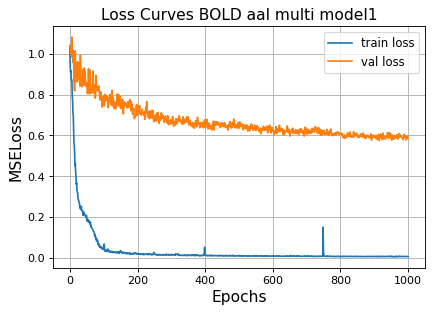

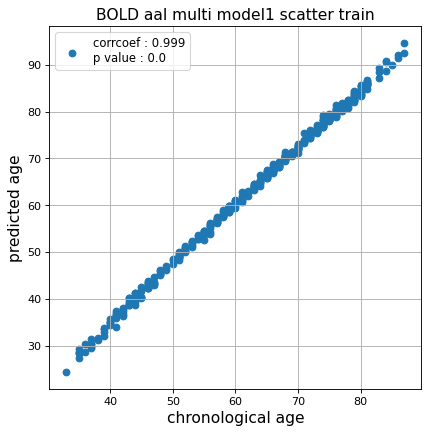

r^2 train data:  0.9366859949513442


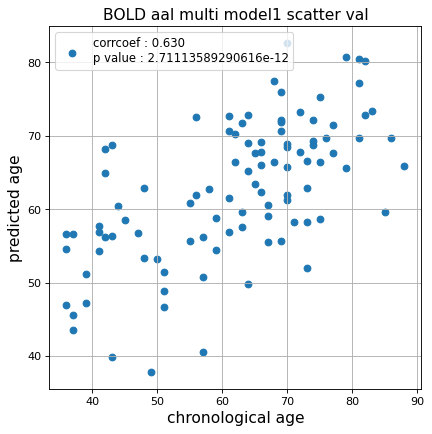

r^2 val data:  0.3910392658549515


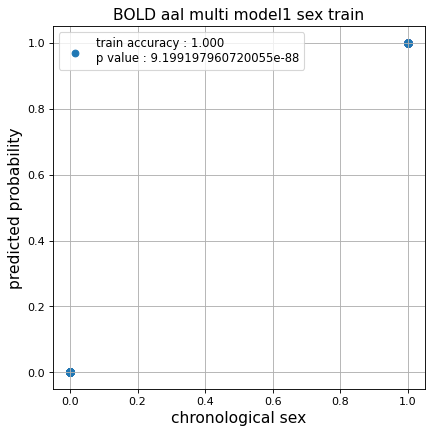

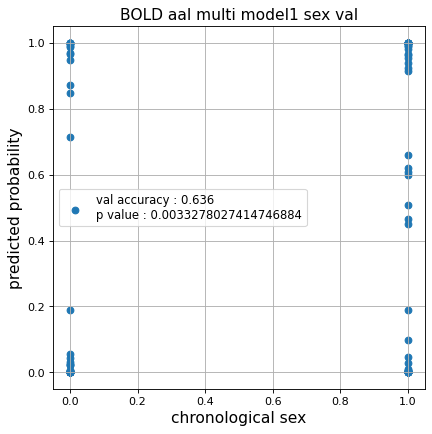

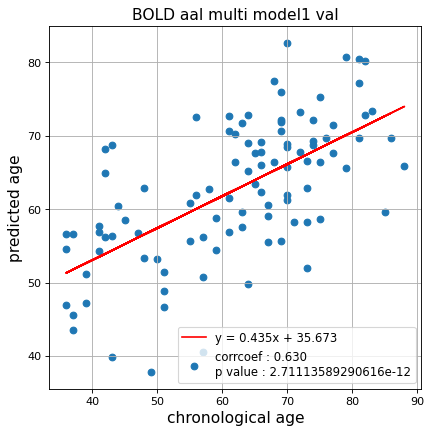

切片: 35.67253569239493
傾き: 0.4353027331223934
Kfold: 2 ::: epoch: 100, loss: 0.04087057394477037, val loss: 0.5758006200194359
Kfold: 2 ::: epoch: 200, loss: 0.016166519875136707, val loss: 0.5681183189153671
Kfold: 2 ::: epoch: 300, loss: 0.011954132467508316, val loss: 0.5422361344099045
Kfold: 2 ::: epoch: 400, loss: 0.010555323016328307, val loss: 0.5052986443042755
Kfold: 2 ::: epoch: 500, loss: 0.007571529203022902, val loss: 0.4836568683385849
Kfold: 2 ::: epoch: 600, loss: 0.008922137749882845, val loss: 0.4928179532289505
Kfold: 2 ::: epoch: 700, loss: 0.007355313389920271, val loss: 0.48349928110837936
Kfold: 2 ::: epoch: 800, loss: 0.0062271710485219955, val loss: 0.45396558195352554
Kfold: 2 ::: epoch: 900, loss: 0.004870595894037531, val loss: 0.45627205818891525
Kfold: 2 ::: epoch: 1000, loss: 0.0053011677944316314, val loss: 0.4666900262236595
save_epochs:929
best val loss:0.4329831451177597


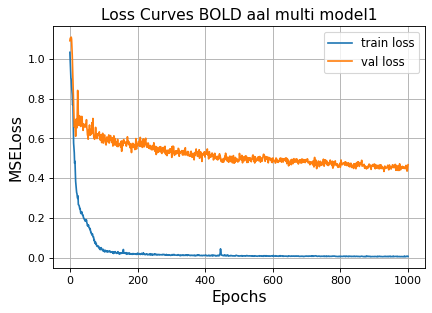

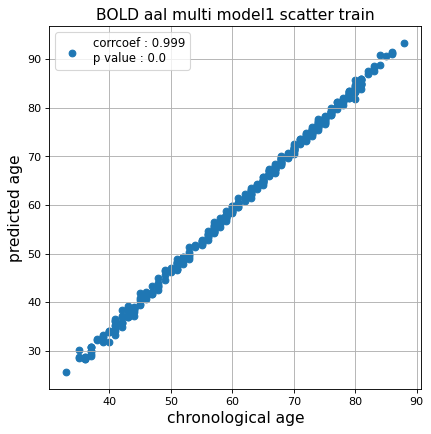

r^2 train data:  0.9326165707962633


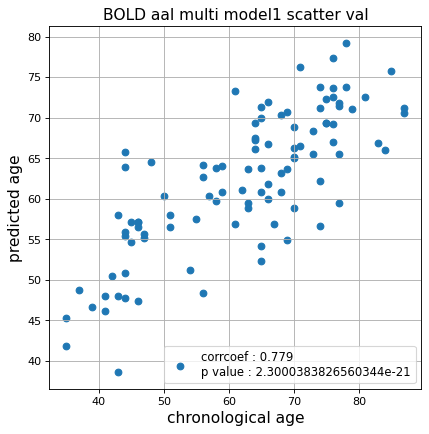

r^2 val data:  0.5873103765869678


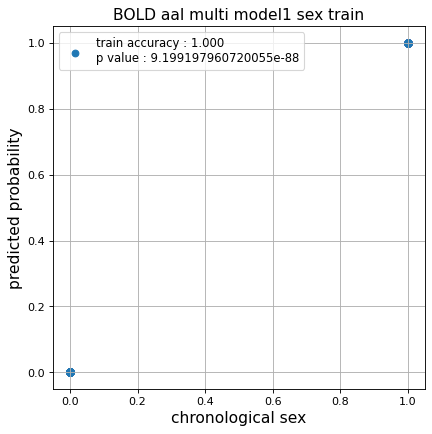

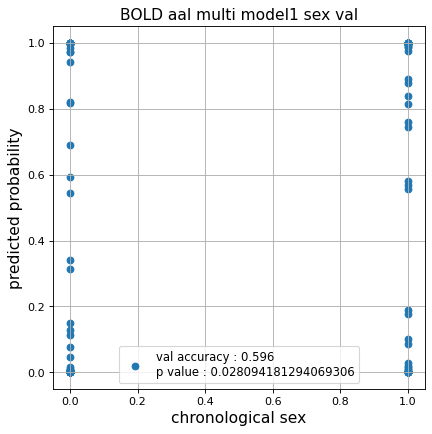

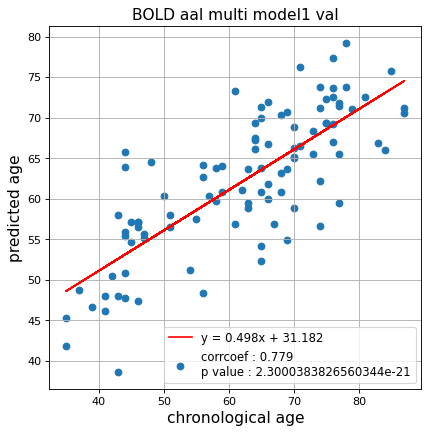

切片: 31.182109953622046
傾き: 0.4984083480951299
Kfold: 3 ::: epoch: 100, loss: 0.03388006025208877, val loss: 0.6986086666584015
Kfold: 3 ::: epoch: 200, loss: 0.02101670291561347, val loss: 0.6716780066490173
Kfold: 3 ::: epoch: 300, loss: 0.013164069288625168, val loss: 0.6661255657672882
Kfold: 3 ::: epoch: 400, loss: 0.009171517530026345, val loss: 0.7051586359739304
Kfold: 3 ::: epoch: 500, loss: 0.008968013679035582, val loss: 0.6429451406002045
Kfold: 3 ::: epoch: 600, loss: 0.006551249167666986, val loss: 0.6643287688493729
Kfold: 3 ::: epoch: 700, loss: 0.00552371171159813, val loss: 0.6481181085109711
Kfold: 3 ::: epoch: 800, loss: 0.0050019897484722044, val loss: 0.6160924434661865
Kfold: 3 ::: epoch: 900, loss: 0.005040734612311308, val loss: 0.6497339308261871
Kfold: 3 ::: epoch: 1000, loss: 0.0050011788351604575, val loss: 0.6367371678352356
save_epochs:669
best val loss:0.6110631674528122


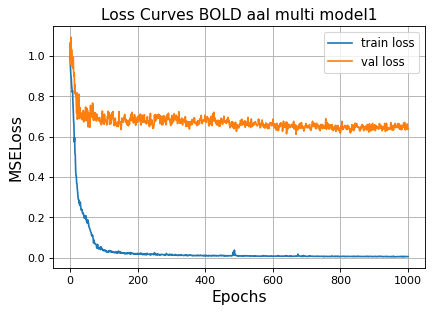

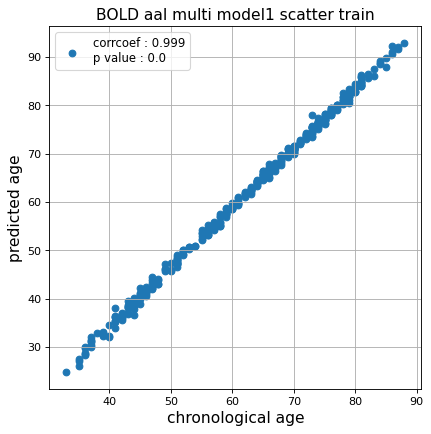

r^2 train data:  0.9416303250852512


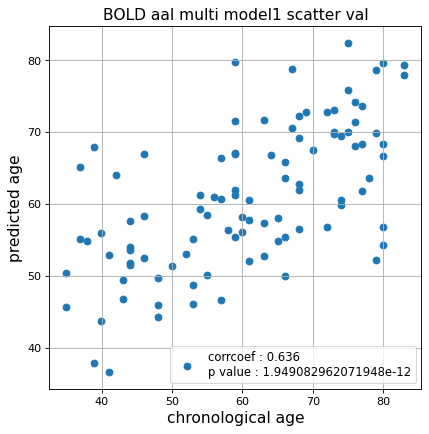

r^2 val data:  0.3938064069172852


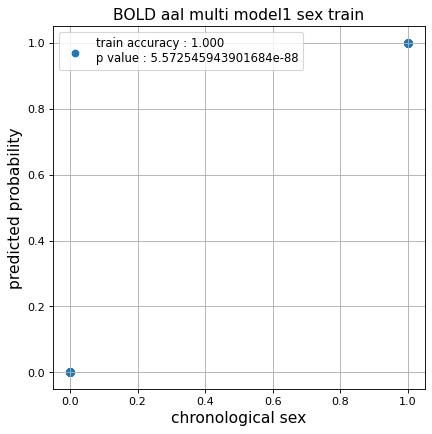

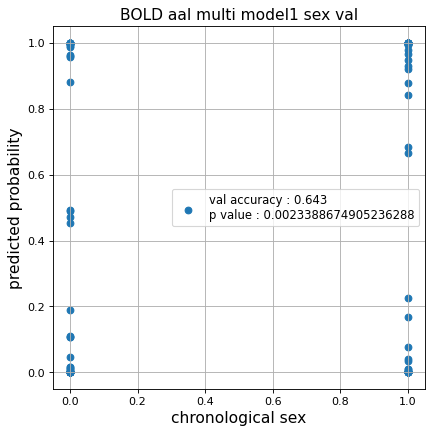

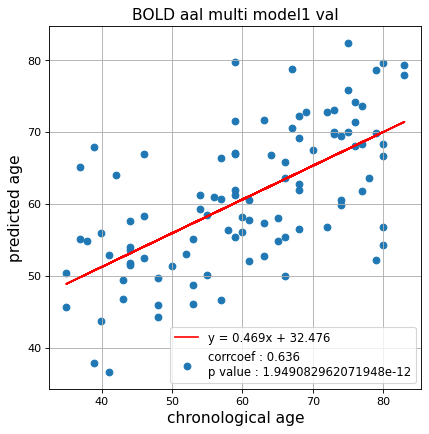

切片: 32.47602539473155
傾き: 0.4692795780217536
Kfold: 4 ::: epoch: 100, loss: 0.034689679312018246, val loss: 0.8684235215187073
Kfold: 4 ::: epoch: 200, loss: 0.01650424036555565, val loss: 0.8343421369791031
Kfold: 4 ::: epoch: 300, loss: 0.010891902367942609, val loss: 0.872202455997467
Kfold: 4 ::: epoch: 400, loss: 0.012293754575344233, val loss: 0.9305121451616287
Kfold: 4 ::: epoch: 500, loss: 0.00874354224652052, val loss: 0.9187700748443604
Kfold: 4 ::: epoch: 600, loss: 0.006046585667018707, val loss: 0.9403104484081268
Kfold: 4 ::: epoch: 700, loss: 0.005002573472805894, val loss: 0.888086348772049
Kfold: 4 ::: epoch: 800, loss: 0.004636155656323983, val loss: 0.9198168367147446
Kfold: 4 ::: epoch: 900, loss: 0.004197407119835799, val loss: 0.9215731918811798
Kfold: 4 ::: epoch: 1000, loss: 0.0037086760410322593, val loss: 0.9095730036497116
save_epochs:274
best val loss:0.8255691379308701


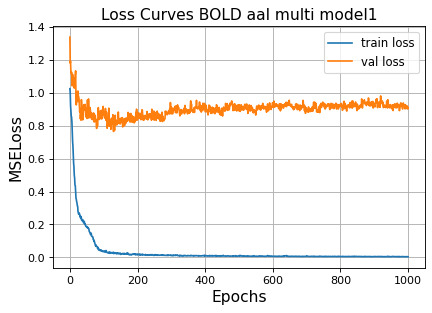

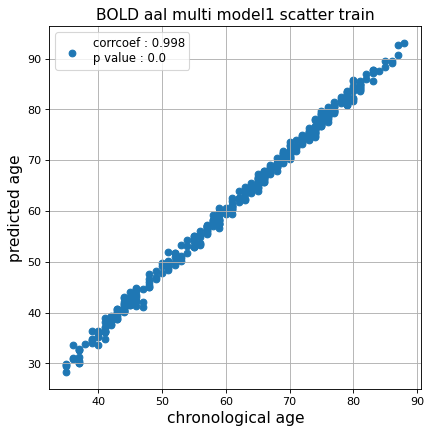

r^2 train data:  0.9597166793553304


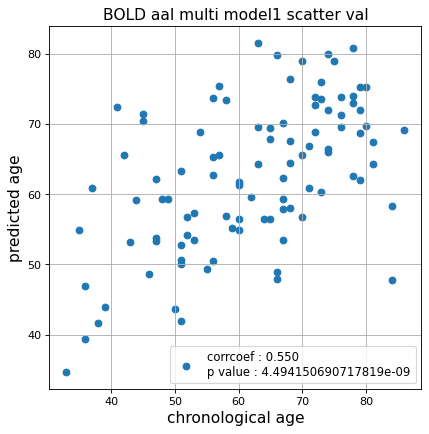

r^2 val data:  0.2507239646606332


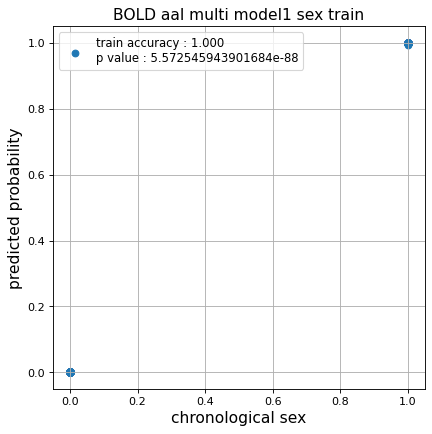

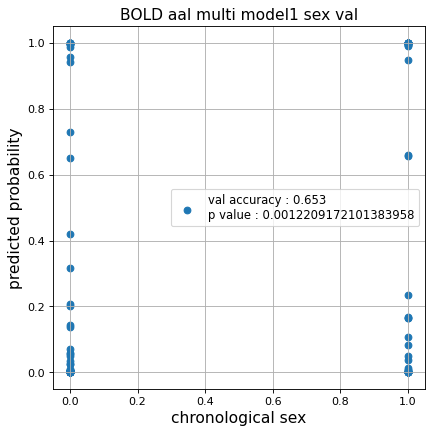

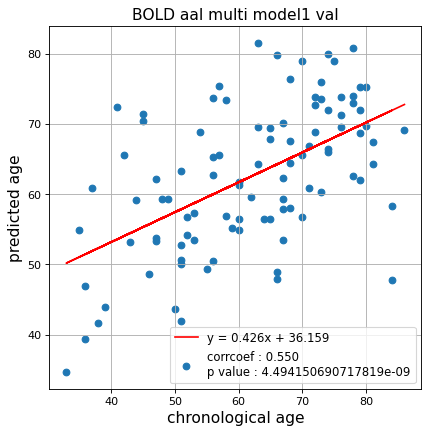

切片: 36.158642151310616
傾き: 0.4255584217716435
Kfold: 5 ::: epoch: 100, loss: 0.04059076789193428, val loss: 0.8953603506088257
Kfold: 5 ::: epoch: 200, loss: 0.017927535737936314, val loss: 0.8387298882007599
Kfold: 5 ::: epoch: 300, loss: 0.012011625230885468, val loss: 0.8231161832809448
Kfold: 5 ::: epoch: 400, loss: 0.009209481641077079, val loss: 0.8161682188510895
Kfold: 5 ::: epoch: 500, loss: 0.007757232381174197, val loss: 0.7808895707130432
Kfold: 5 ::: epoch: 600, loss: 0.008177655211721476, val loss: 0.7569402605295181
Kfold: 5 ::: epoch: 700, loss: 0.007062877707469922, val loss: 0.7353005036711693
Kfold: 5 ::: epoch: 800, loss: 0.0053229531488166405, val loss: 0.7285693883895874
Kfold: 5 ::: epoch: 900, loss: 0.0045475522235322455, val loss: 0.7111215367913246
Kfold: 5 ::: epoch: 1000, loss: 0.004206958262679668, val loss: 0.6944692581892014
save_epochs:922
best val loss:0.6812910810112953


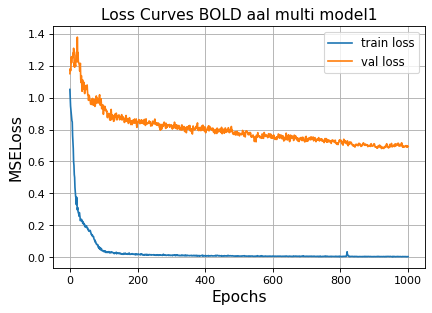

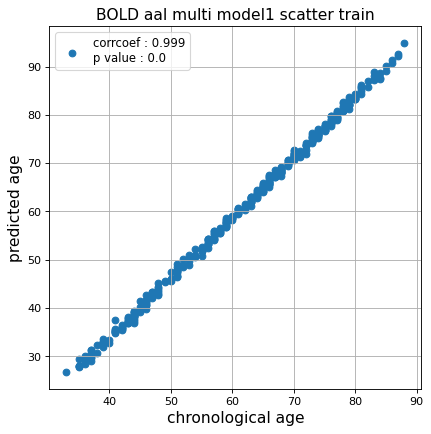

r^2 train data:  0.933695219140144


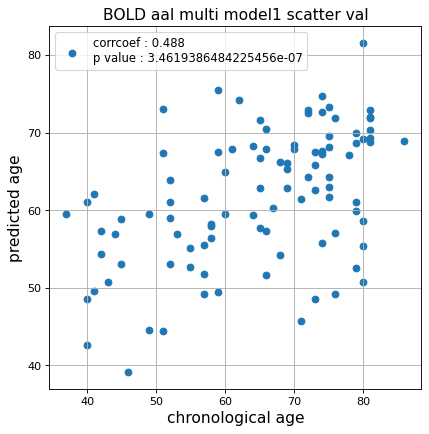

r^2 val data:  0.15245306654928392


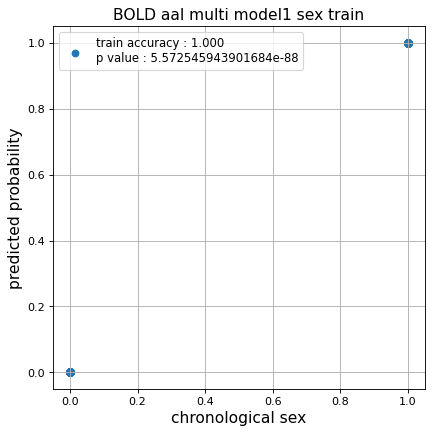

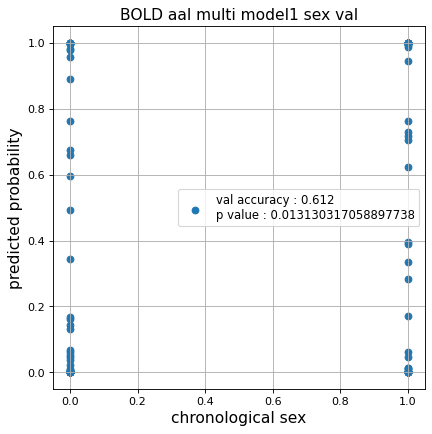

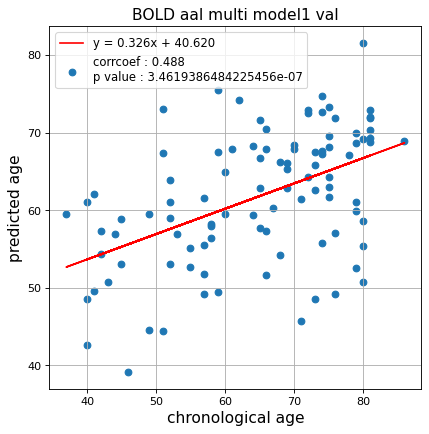

切片: 40.61985183157715
傾き: 0.32630699299527494
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.04181099754686539, val loss: 0.7833229154348373
Kfold: 1 ::: epoch: 200, loss: 0.016265250670795258, val loss: 0.6943104118108749
Kfold: 1 ::: epoch: 300, loss: 0.015337493342275802, val loss: 0.7096129059791565
Kfold: 1 ::: epoch: 400, loss: 0.009139721174366199, val loss: 0.6566999852657318
Kfold: 1 ::: epoch: 500, loss: 0.008758985831473883, val loss: 0.669402614235878
Kfold: 1 ::: epoch: 600, loss: 0.008777544941180028, val loss: 0.6698576509952545
Kfold: 1 ::: epoch: 700, loss: 0.00628734530451206, val loss: 0.6475484520196915
Kfold: 1 ::: epoch: 800, loss: 0.0052323061614655535, val loss: 0.6573721617460251
Kfold: 1 ::: epoch: 900, loss: 0.004862919825917253, val loss: 0.6433047279715538
Kfold: 1 ::: epoch: 1000, loss: 0.004392532004903142, val loss: 0.5975187346339226
save_epochs:1000
best val loss:0.5975187346339226


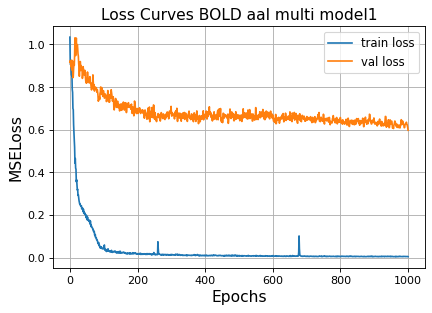

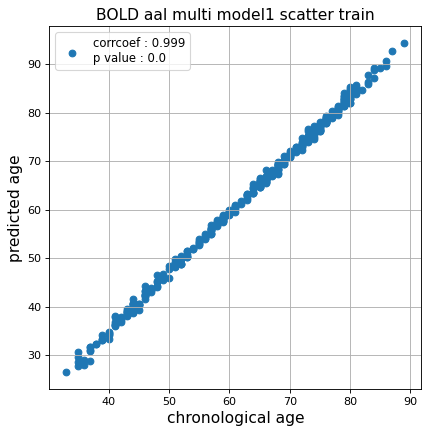

r^2 train data:  0.95434250617922


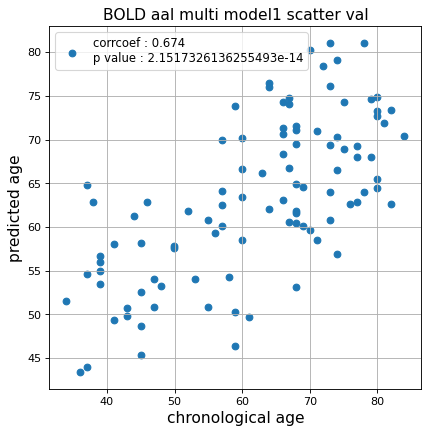

r^2 val data:  0.4447286477646025


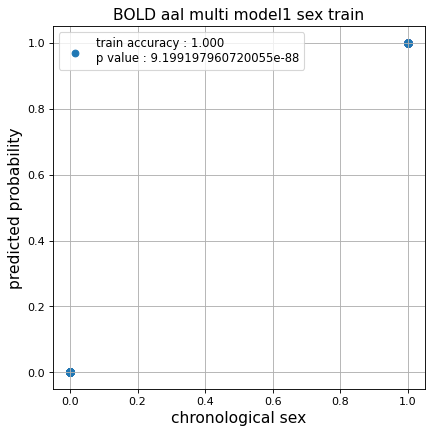

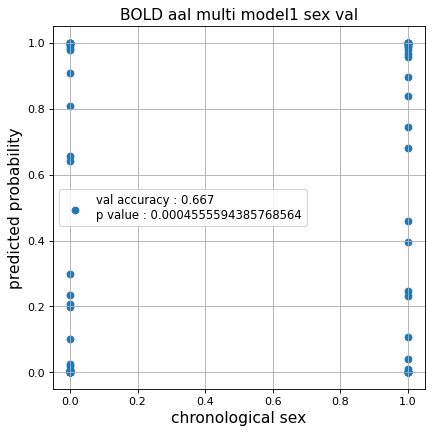

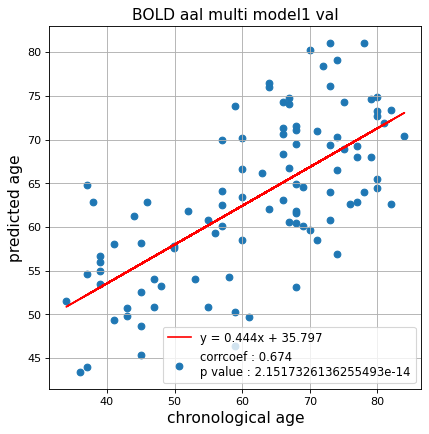

切片: 35.79692148644672
傾き: 0.44362995865418736
Kfold: 2 ::: epoch: 100, loss: 0.03251010337128089, val loss: 0.8312070965766907
Kfold: 2 ::: epoch: 200, loss: 0.018564514600886747, val loss: 0.7856424748897552
Kfold: 2 ::: epoch: 300, loss: 0.015180628675107773, val loss: 0.7696690857410431
Kfold: 2 ::: epoch: 400, loss: 0.00997802482631344, val loss: 0.7270312011241913
Kfold: 2 ::: epoch: 500, loss: 0.008842127648397135, val loss: 0.6839274764060974
Kfold: 2 ::: epoch: 600, loss: 0.010267706731191048, val loss: 0.6862898245453835
Kfold: 2 ::: epoch: 700, loss: 0.007531745717502558, val loss: 0.6510106027126312
Kfold: 2 ::: epoch: 800, loss: 0.005636124817941051, val loss: 0.605169951915741
Kfold: 2 ::: epoch: 900, loss: 0.005514970962674572, val loss: 0.6292300745844841
Kfold: 2 ::: epoch: 1000, loss: 0.005985761831442897, val loss: 0.611632913351059
save_epochs:809
best val loss:0.5804555267095566


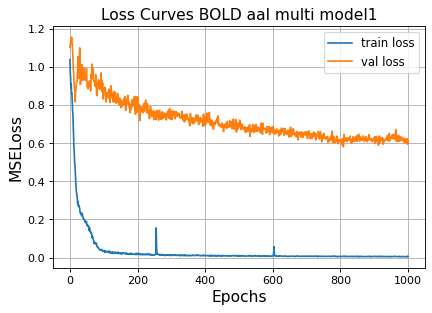

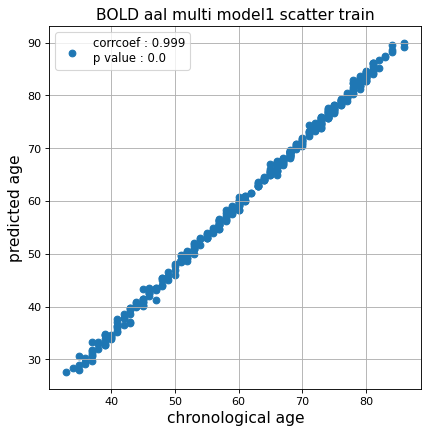

r^2 train data:  0.9514822984682434


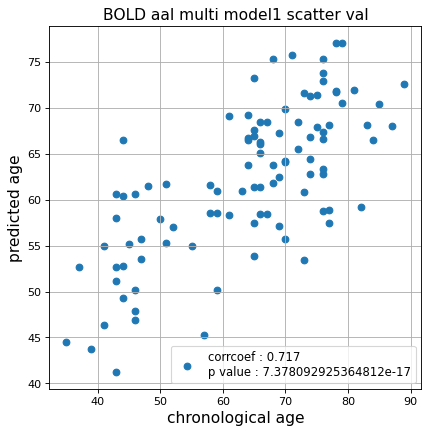

r^2 val data:  0.4849095760767006


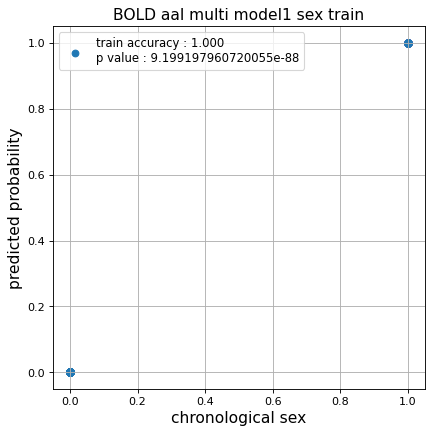

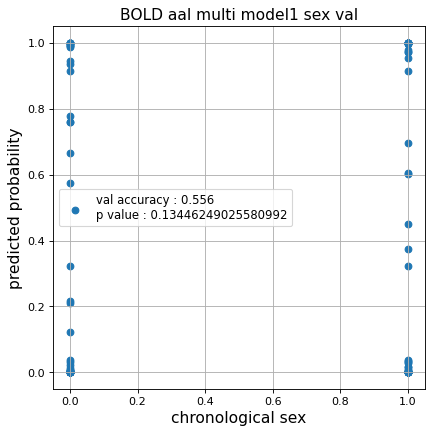

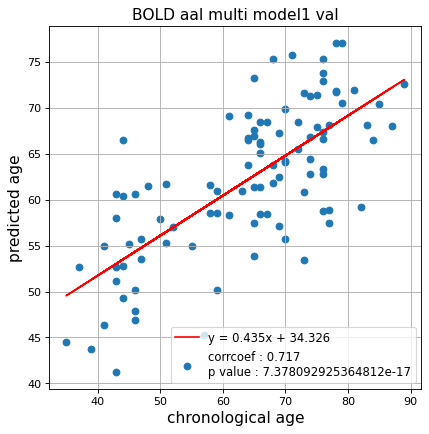

切片: 34.326189775191594
傾き: 0.43514675685771276
Kfold: 3 ::: epoch: 100, loss: 0.03461528641100113, val loss: 0.8020149171352386
Kfold: 3 ::: epoch: 200, loss: 0.019234485637683135, val loss: 0.6522018760442734
Kfold: 3 ::: epoch: 300, loss: 0.012316878347729262, val loss: 0.6363412439823151
Kfold: 3 ::: epoch: 400, loss: 0.009433890943630384, val loss: 0.6218959242105484
Kfold: 3 ::: epoch: 500, loss: 0.008340918190347461, val loss: 0.55735944211483
Kfold: 3 ::: epoch: 600, loss: 0.006848536037768309, val loss: 0.5915118008852005
Kfold: 3 ::: epoch: 700, loss: 0.0065618393799433345, val loss: 0.5701909065246582
Kfold: 3 ::: epoch: 800, loss: 0.005022910262386386, val loss: 0.5575001686811447
Kfold: 3 ::: epoch: 900, loss: 0.5236365755016987, val loss: 0.5764474719762802
Kfold: 3 ::: epoch: 1000, loss: 0.004967424463337431, val loss: 0.5632418990135193
save_epochs:879
best val loss:0.5119845122098923


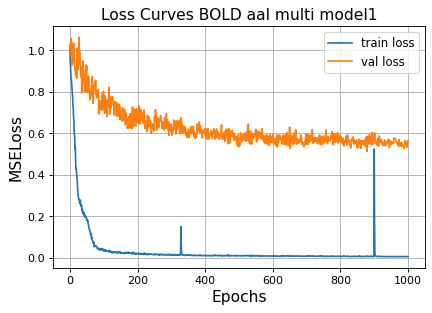

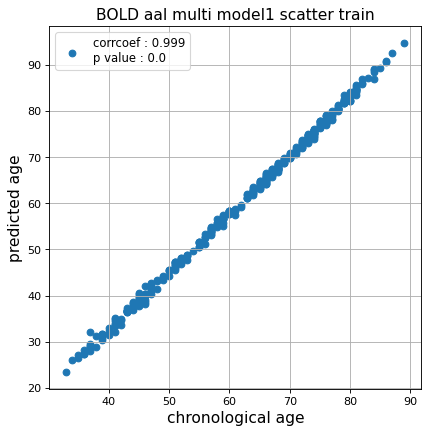

r^2 train data:  0.9186226450547144


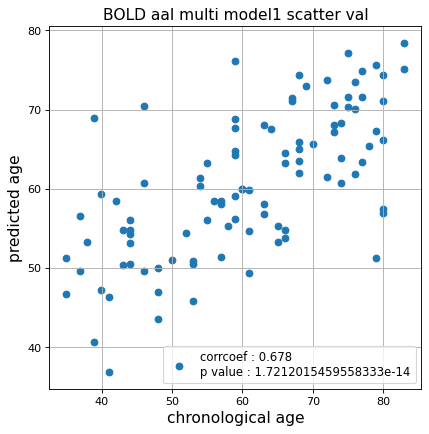

r^2 val data:  0.4597778172420516


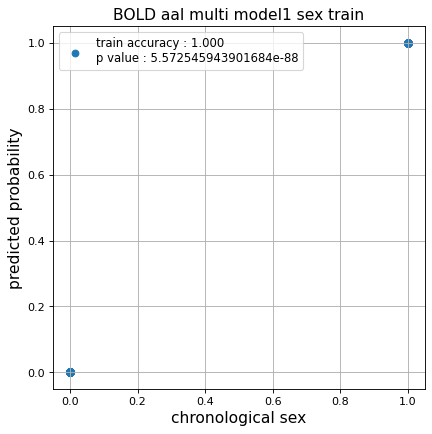

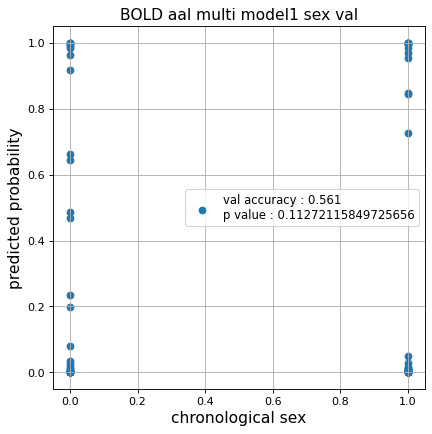

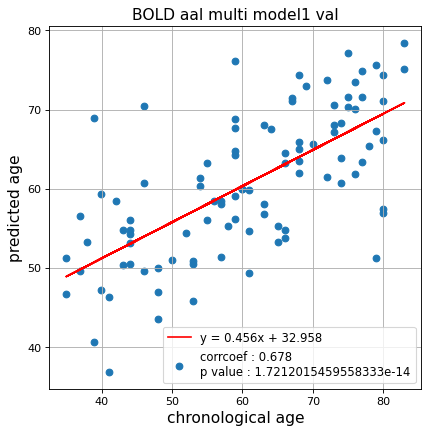

切片: 32.95756657864596
傾き: 0.4564045063552688
Kfold: 4 ::: epoch: 100, loss: 0.03166707691091757, val loss: 1.0808225125074387
Kfold: 4 ::: epoch: 200, loss: 0.014876901960143676, val loss: 1.193578764796257
Kfold: 4 ::: epoch: 300, loss: 0.012209551838728098, val loss: 1.2156201601028442
Kfold: 4 ::: epoch: 400, loss: 0.00963572713618095, val loss: 1.2050436735153198
Kfold: 4 ::: epoch: 500, loss: 0.006807890989316197, val loss: 1.2040229439735413
Kfold: 4 ::: epoch: 600, loss: 0.006642473252633443, val loss: 1.213307335972786
Kfold: 4 ::: epoch: 700, loss: 0.006237915358864344, val loss: 1.1313336938619614
Kfold: 4 ::: epoch: 800, loss: 0.004724543559579895, val loss: 1.1653095483779907
Kfold: 4 ::: epoch: 900, loss: 0.005530605701586375, val loss: 1.142172709107399
Kfold: 4 ::: epoch: 1000, loss: 0.0038250483250102173, val loss: 1.1146299690008163
save_epochs:994
best val loss:1.0848041772842407


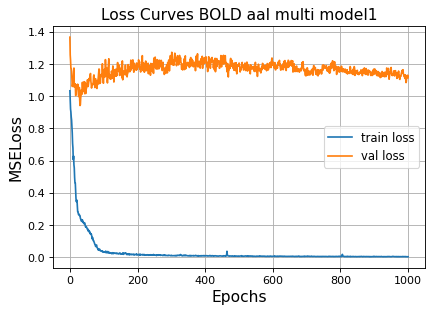

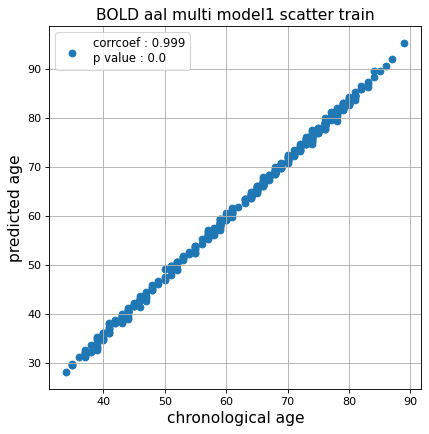

r^2 train data:  0.9598900577871798


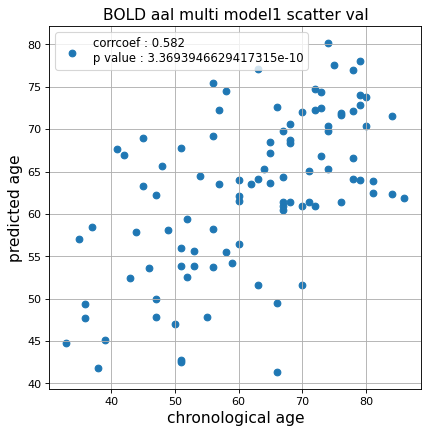

r^2 val data:  0.3231704075959777


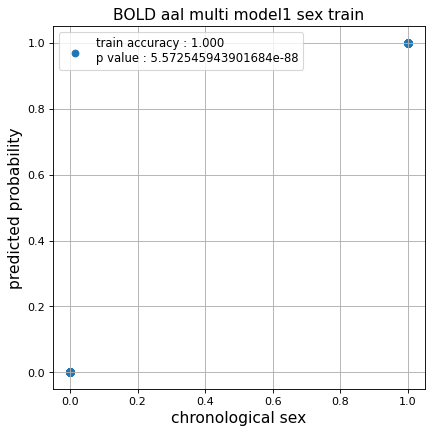

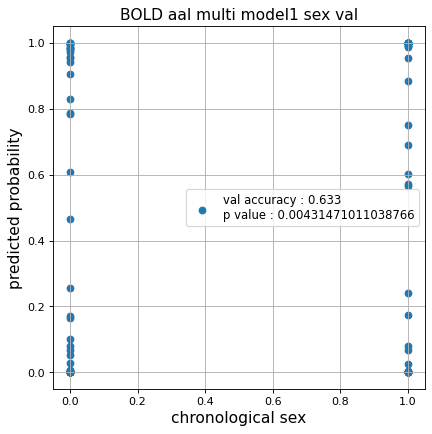

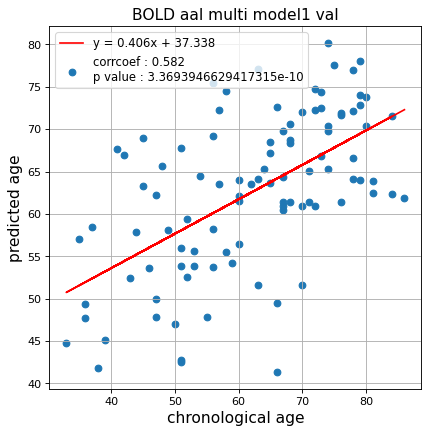

切片: 37.33843571602985
傾き: 0.40638236049969123
Kfold: 5 ::: epoch: 100, loss: 0.041897523718384594, val loss: 0.8917780667543411
Kfold: 5 ::: epoch: 200, loss: 0.016850376430039223, val loss: 0.8271510452032089
Kfold: 5 ::: epoch: 300, loss: 0.012427840310220536, val loss: 0.8221181184053421
Kfold: 5 ::: epoch: 400, loss: 0.008583712964676894, val loss: 0.8038688600063324
Kfold: 5 ::: epoch: 500, loss: 0.007165047411735241, val loss: 0.7854102849960327
Kfold: 5 ::: epoch: 600, loss: 0.006516032261200822, val loss: 0.7428765296936035
Kfold: 5 ::: epoch: 700, loss: 0.005656340428126546, val loss: 0.7243749797344208
Kfold: 5 ::: epoch: 800, loss: 0.005349556664721324, val loss: 0.7097983360290527
Kfold: 5 ::: epoch: 900, loss: 0.004976904682385234, val loss: 0.688377283513546
Kfold: 5 ::: epoch: 1000, loss: 0.004189390348843657, val loss: 0.6855316087603569
save_epochs:927
best val loss:0.6718676090240479


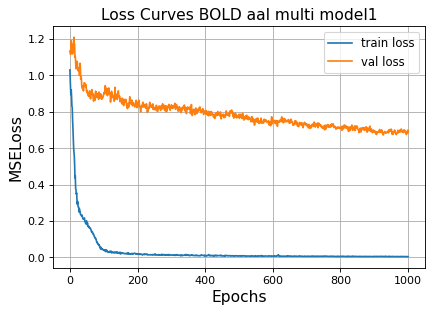

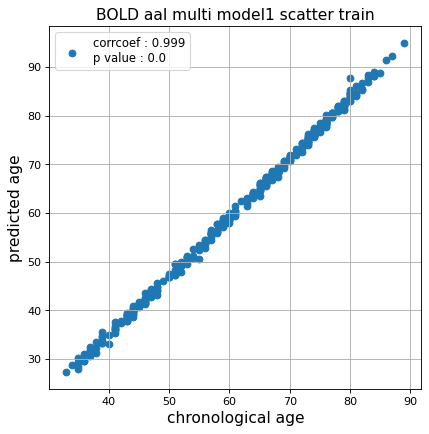

r^2 train data:  0.9503893246559294


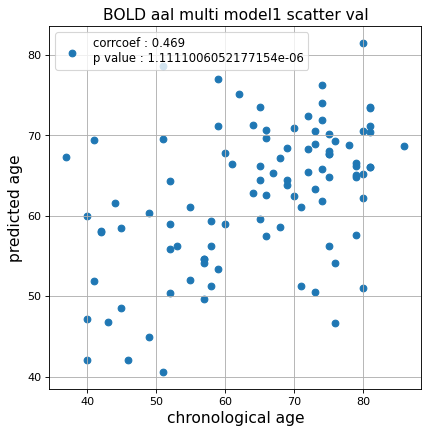

r^2 val data:  0.14516860191708503


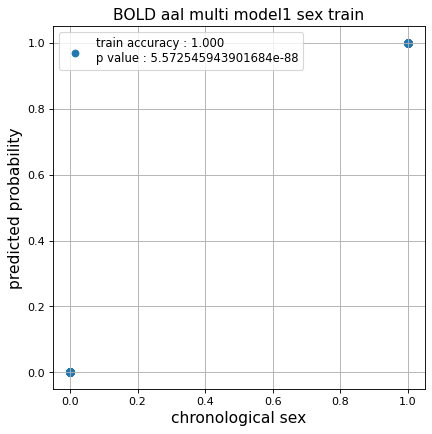

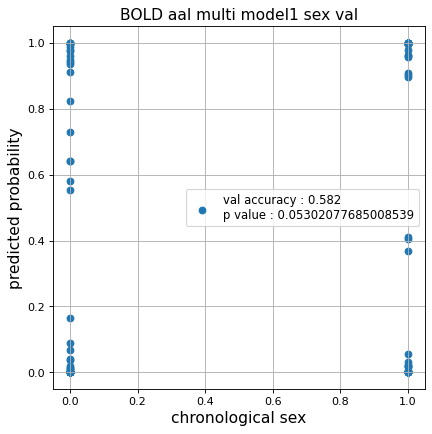

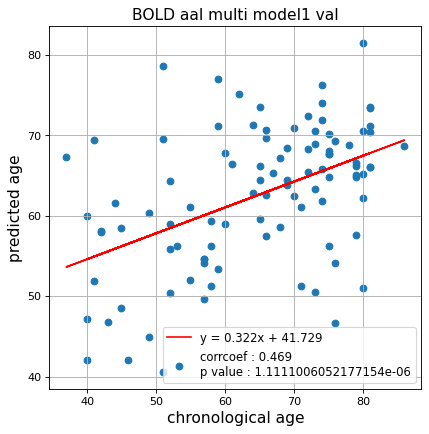

切片: 41.72867508930476
傾き: 0.3216820052726631
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.04662369005382061, val loss: 0.7449979558587074
Kfold: 1 ::: epoch: 200, loss: 0.019121452807807006, val loss: 0.6684882491827011
Kfold: 1 ::: epoch: 300, loss: 0.012751226922353873, val loss: 0.6512426286935806
Kfold: 1 ::: epoch: 400, loss: 0.010138761395445237, val loss: 0.6209555193781853
Kfold: 1 ::: epoch: 500, loss: 0.008544717736255664, val loss: 0.5839327052235603
Kfold: 1 ::: epoch: 600, loss: 0.008098302426962899, val loss: 0.5950556769967079
Kfold: 1 ::: epoch: 700, loss: 0.006347752068764889, val loss: 0.599864050745964
Kfold: 1 ::: epoch: 800, loss: 0.005761350827434888, val loss: 0.5837705880403519
Kfold: 1 ::: epoch: 900, loss: 0.013985251954111915, val loss: 0.5897030830383301
Kfold: 1 ::: epoch: 1000, loss: 0.0043096518000731105, val loss: 0.5688607767224312
save_epochs:917
best val loss:0.5645550340414047


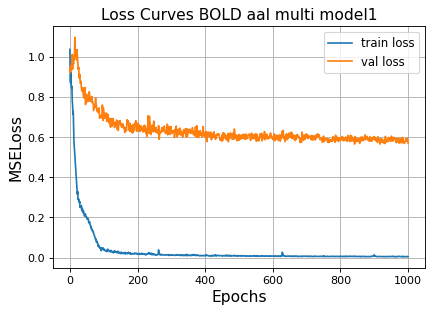

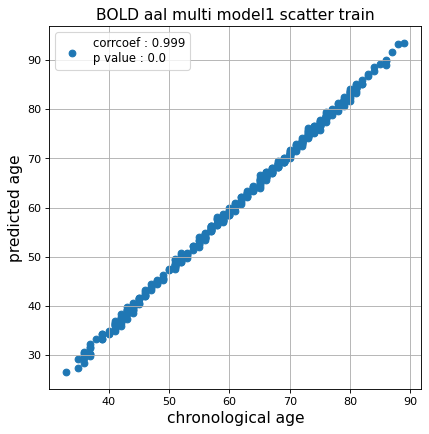

r^2 train data:  0.956654258891267


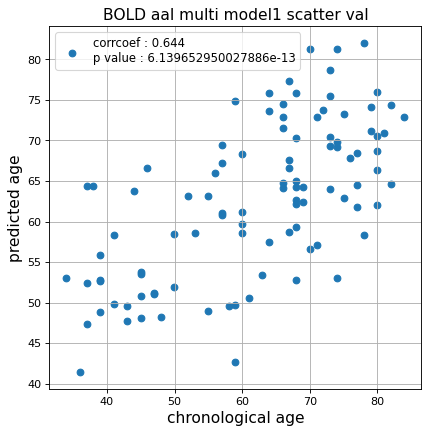

r^2 val data:  0.41035698696547507


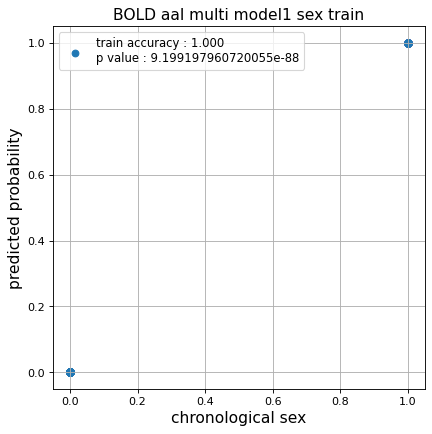

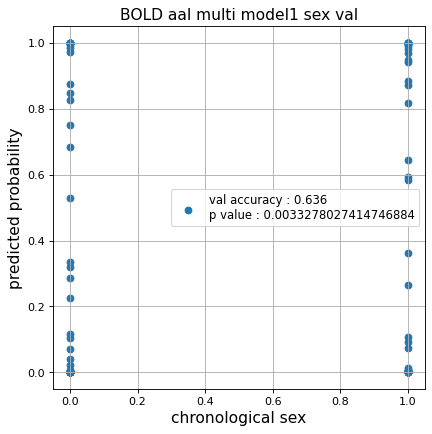

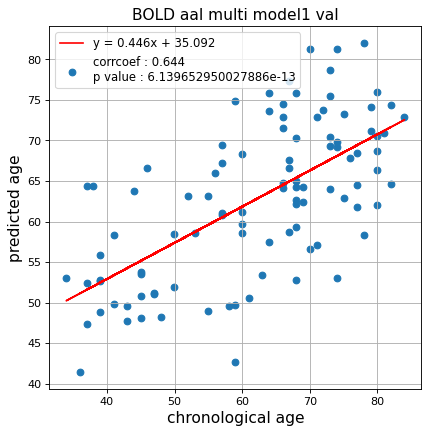

切片: 35.09231880635224
傾き: 0.44569939239477746
Kfold: 2 ::: epoch: 100, loss: 0.031106368423654482, val loss: 0.6448777914047241
Kfold: 2 ::: epoch: 200, loss: 0.017199183957507976, val loss: 0.5928379781544209
Kfold: 2 ::: epoch: 300, loss: 0.01662730533056534, val loss: 0.5667073540389538
Kfold: 2 ::: epoch: 400, loss: 0.010576822687513553, val loss: 0.5587021838873625
Kfold: 2 ::: epoch: 500, loss: 0.008143567605517231, val loss: 0.5454436428844929
Kfold: 2 ::: epoch: 600, loss: 0.007480970243565165, val loss: 0.5391470324248075
Kfold: 2 ::: epoch: 700, loss: 0.006990418447038302, val loss: 0.5320510268211365
Kfold: 2 ::: epoch: 800, loss: 0.005934318581309456, val loss: 0.5389183945953846
Kfold: 2 ::: epoch: 900, loss: 0.005637687272750414, val loss: 0.5170886516571045
Kfold: 2 ::: epoch: 1000, loss: 0.005132034474697251, val loss: 0.5180085506290197
save_epochs:996
best val loss:0.5140254832804203


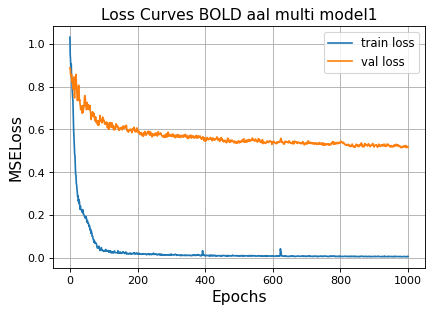

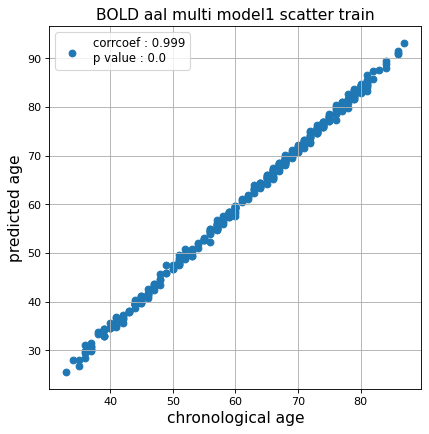

r^2 train data:  0.9435807930476154


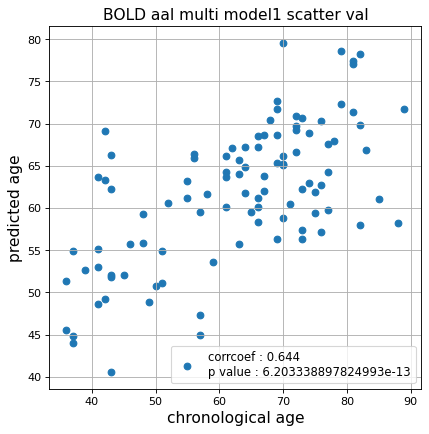

r^2 val data:  0.40776952001584266


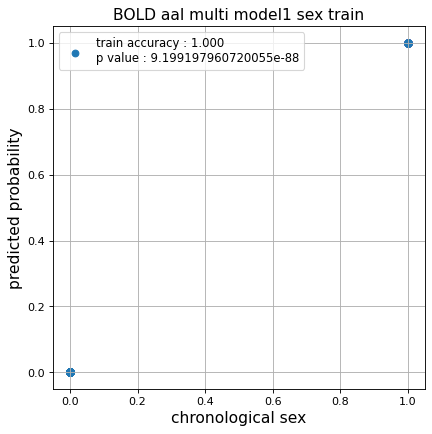

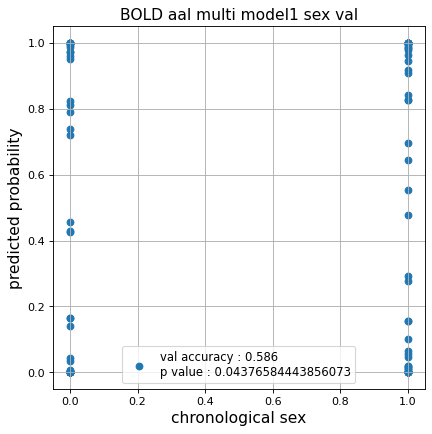

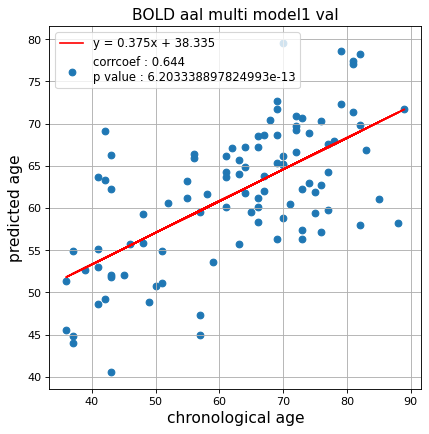

切片: 38.335375818352894
傾き: 0.37475044296713667
Kfold: 3 ::: epoch: 100, loss: 0.03951617688513719, val loss: 0.9034324586391449
Kfold: 3 ::: epoch: 200, loss: 0.02110920660197735, val loss: 0.739640049636364
Kfold: 3 ::: epoch: 300, loss: 0.014311309044177715, val loss: 0.6662107557058334
Kfold: 3 ::: epoch: 400, loss: 0.009044068901298137, val loss: 0.6734370216727257
Kfold: 3 ::: epoch: 500, loss: 0.01190301886974619, val loss: 0.6379594281315804
Kfold: 3 ::: epoch: 600, loss: 0.008443795072917756, val loss: 0.646015040576458
Kfold: 3 ::: epoch: 700, loss: 0.007291153753892734, val loss: 0.6383882611989975
Kfold: 3 ::: epoch: 800, loss: 0.0064118650312033985, val loss: 0.6555401831865311
Kfold: 3 ::: epoch: 900, loss: 0.005190683725791482, val loss: 0.6194966435432434
Kfold: 3 ::: epoch: 1000, loss: 0.005012843005645733, val loss: 0.6025540828704834
save_epochs:840
best val loss:0.5830461233854294


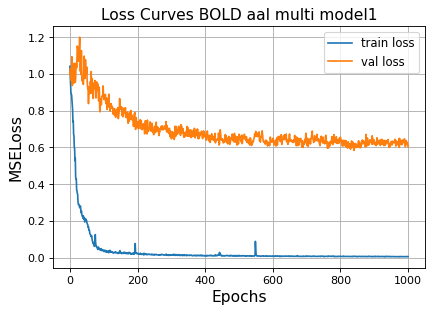

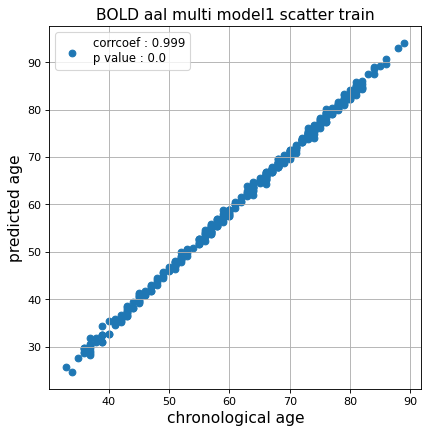

r^2 train data:  0.9383268268645858


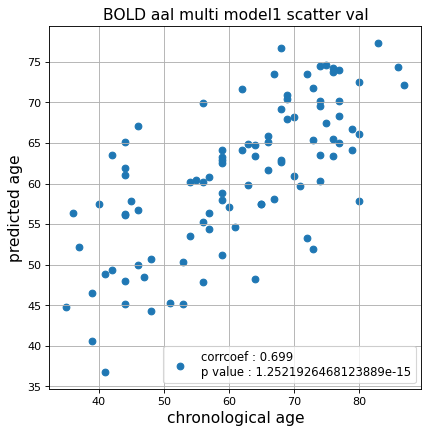

r^2 val data:  0.4862723130626516


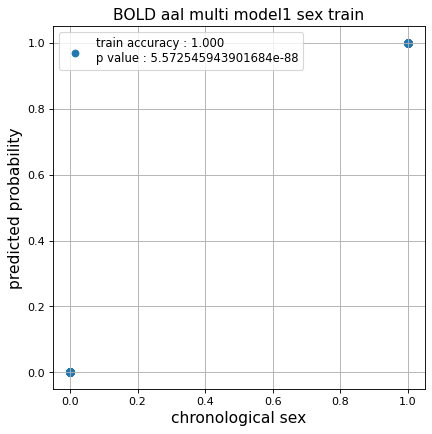

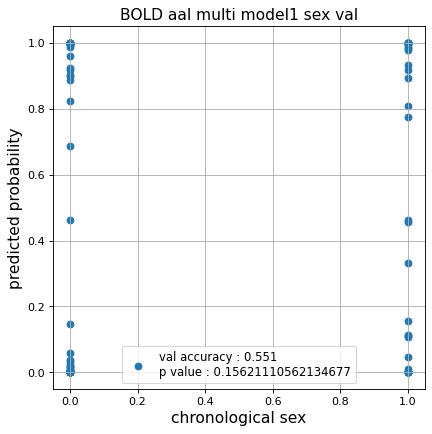

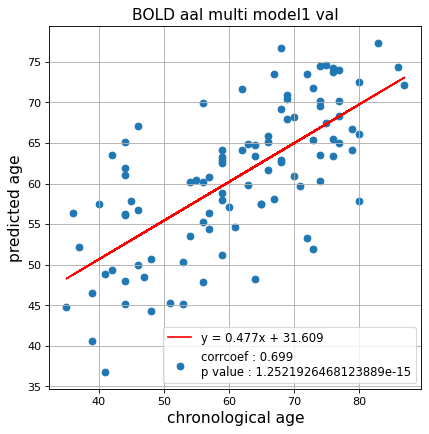

切片: 31.609470232946528
傾き: 0.47652567599436857
Kfold: 4 ::: epoch: 100, loss: 0.03449608285266619, val loss: 0.7970171719789505
Kfold: 4 ::: epoch: 200, loss: 0.019882899709045887, val loss: 0.8288238197565079
Kfold: 4 ::: epoch: 300, loss: 0.011551843741192268, val loss: 0.8716965466737747
Kfold: 4 ::: epoch: 400, loss: 0.011752106285152527, val loss: 0.8779360502958298
Kfold: 4 ::: epoch: 500, loss: 0.007558739135185113, val loss: 0.9087577760219574
Kfold: 4 ::: epoch: 600, loss: 0.006697081136875427, val loss: 0.8936176598072052
Kfold: 4 ::: epoch: 700, loss: 0.005682815385695834, val loss: 0.908405214548111
Kfold: 4 ::: epoch: 800, loss: 0.004606712716989792, val loss: 0.929389476776123
Kfold: 4 ::: epoch: 900, loss: 0.004469089380178887, val loss: 0.9109734147787094
Kfold: 4 ::: epoch: 1000, loss: 0.0067405836083568055, val loss: 0.9164590835571289
save_epochs:256
best val loss:0.8110273629426956


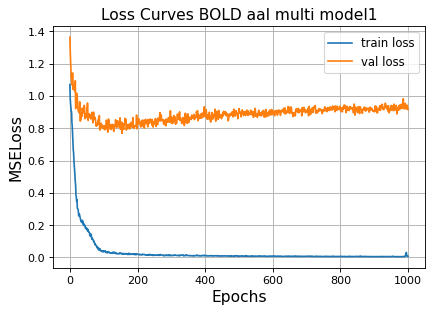

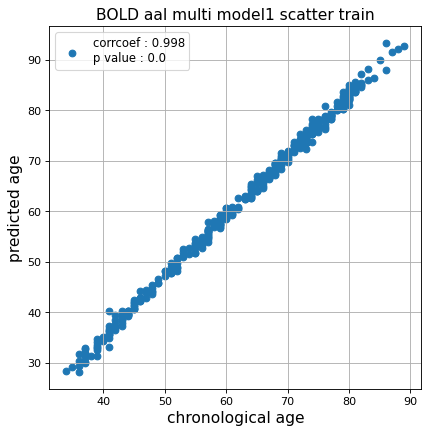

r^2 train data:  0.9561367379313803


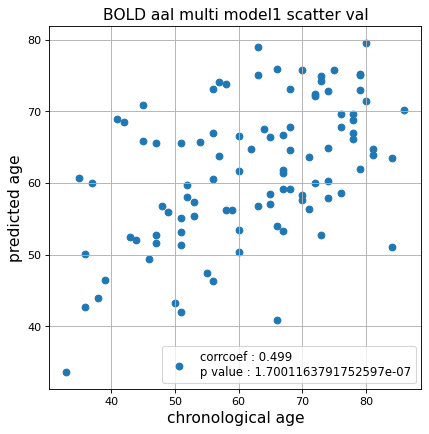

r^2 val data:  0.1977938443927495


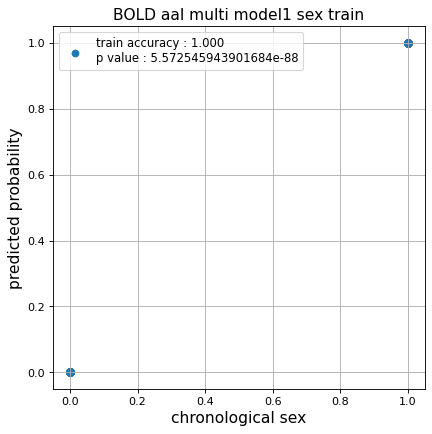

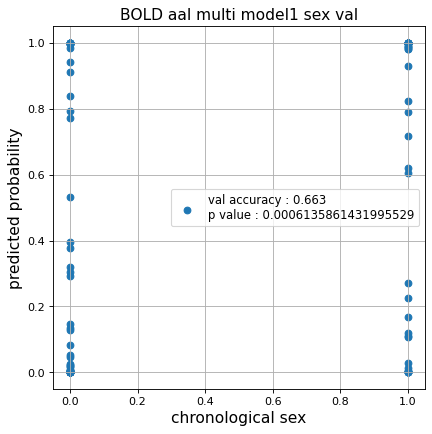

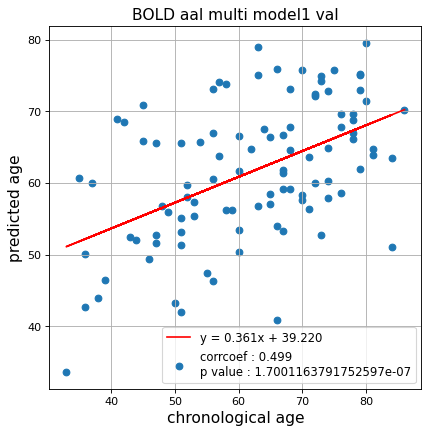

切片: 39.219790413263894
傾き: 0.36060031269043646
Kfold: 5 ::: epoch: 100, loss: 0.046155813794869646, val loss: 0.6898507624864578
Kfold: 5 ::: epoch: 200, loss: 0.017062211265930764, val loss: 0.6282194778323174
Kfold: 5 ::: epoch: 300, loss: 0.013243372122255655, val loss: 0.6157916337251663
Kfold: 5 ::: epoch: 400, loss: 0.010914901199822243, val loss: 0.6175279393792152
Kfold: 5 ::: epoch: 500, loss: 0.008420515805482864, val loss: 0.6071368977427483
Kfold: 5 ::: epoch: 600, loss: 0.0065876186753694825, val loss: 0.5929744467139244
Kfold: 5 ::: epoch: 700, loss: 0.006455816507626038, val loss: 0.5809151735156775
Kfold: 5 ::: epoch: 800, loss: 0.00567693467466877, val loss: 0.5827775672078133
Kfold: 5 ::: epoch: 900, loss: 0.005107969224739533, val loss: 0.570017920807004
Kfold: 5 ::: epoch: 1000, loss: 0.004659182195050212, val loss: 0.5820186957716942
save_epochs:889
best val loss:0.5622618272900581


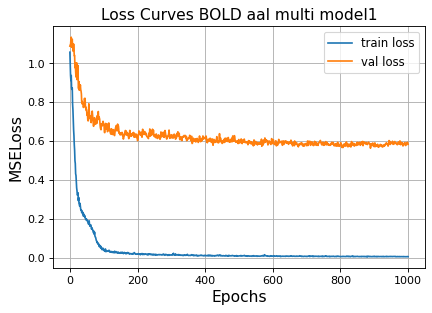

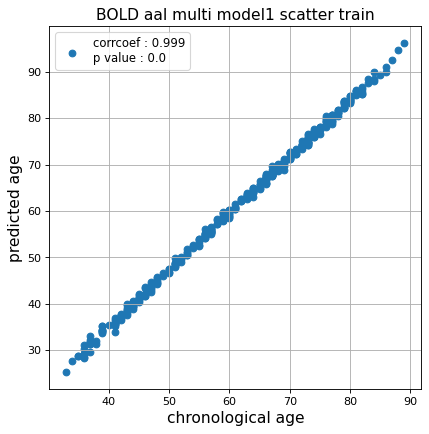

r^2 train data:  0.9472217865870985


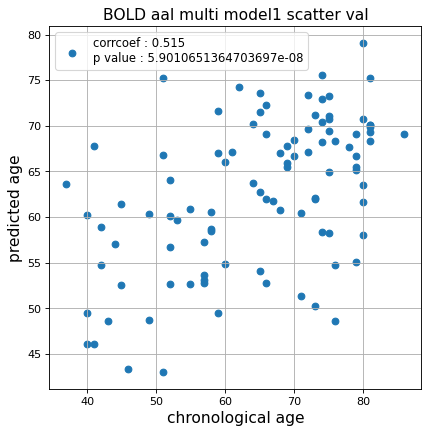

r^2 val data:  0.2236931149403052


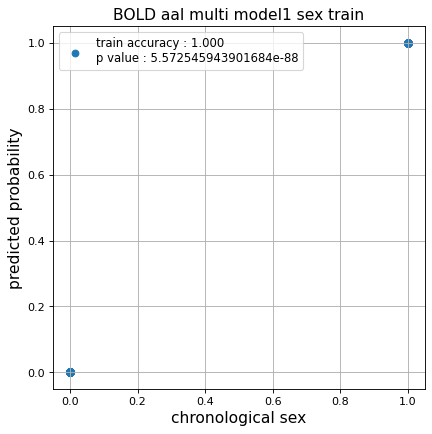

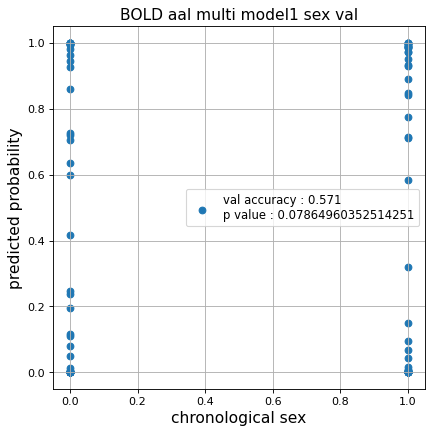

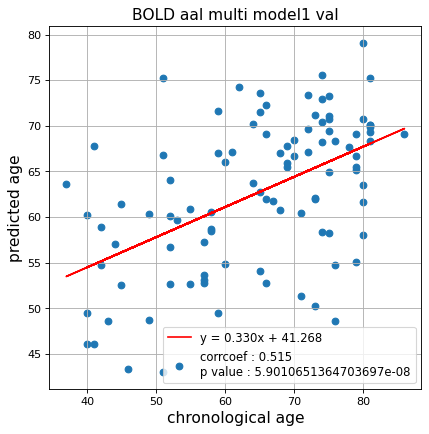

切片: 41.26793070614133
傾き: 0.33047744935862366
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.034119551141674705, val loss: 0.6488743051886559
Kfold: 1 ::: epoch: 200, loss: 0.019917223530893143, val loss: 0.5659233257174492
Kfold: 1 ::: epoch: 300, loss: 0.010985641346241418, val loss: 0.5536215901374817
Kfold: 1 ::: epoch: 400, loss: 0.010889037189861903, val loss: 0.5365548059344292
Kfold: 1 ::: epoch: 500, loss: 0.008549403900710436, val loss: 0.5400377810001373
Kfold: 1 ::: epoch: 600, loss: 0.008664396054183062, val loss: 0.5327572375535965
Kfold: 1 ::: epoch: 700, loss: 0.007290486747828813, val loss: 0.549275130033493
Kfold: 1 ::: epoch: 800, loss: 0.005605333538439412, val loss: 0.5465300232172012
Kfold: 1 ::: epoch: 900, loss: 0.004860768864790981, val loss: 0.5447717383503914
Kfold: 1 ::: epoch: 1000, loss: 0.0051123842847748445, val loss: 0.5126809999346733
save_epochs:999
best val loss:0.5057825744152069


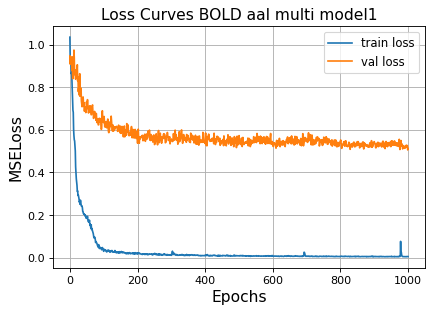

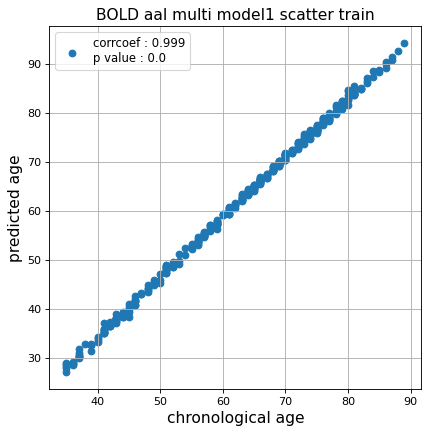

r^2 train data:  0.9476643640531185


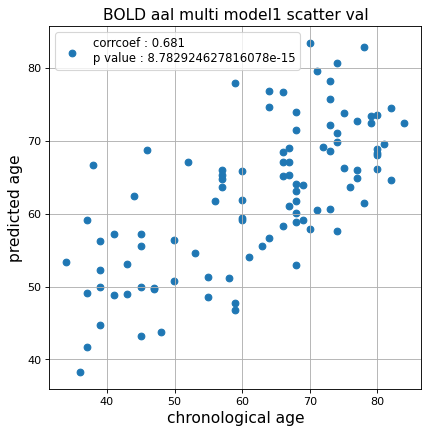

r^2 val data:  0.46147995799499175


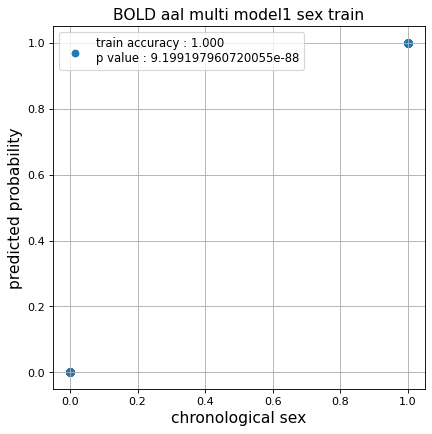

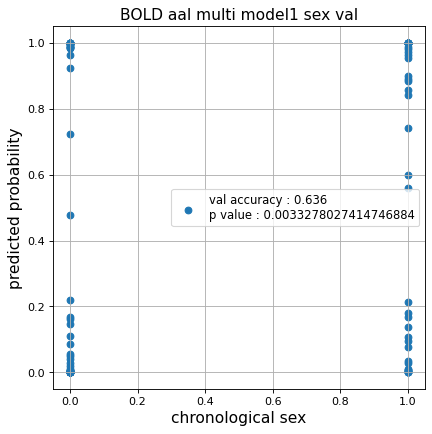

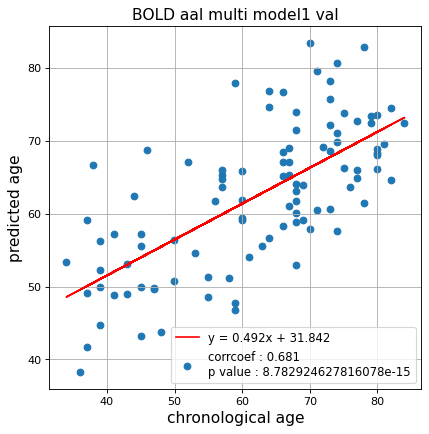

切片: 31.841898394283827
傾き: 0.49184554413325476
Kfold: 2 ::: epoch: 100, loss: 0.030483094688791495, val loss: 0.614376014098525
Kfold: 2 ::: epoch: 200, loss: 0.017261708011993997, val loss: 0.5855045076459646
Kfold: 2 ::: epoch: 300, loss: 0.01386653295216652, val loss: 0.5705844350159168
Kfold: 2 ::: epoch: 400, loss: 0.008815979907432428, val loss: 0.5616665259003639
Kfold: 2 ::: epoch: 500, loss: 0.009602640397273578, val loss: 0.5550703667104244
Kfold: 2 ::: epoch: 600, loss: 0.007357363230907, val loss: 0.5541382879018784
Kfold: 2 ::: epoch: 700, loss: 0.006941499116902168, val loss: 0.5543785057961941
Kfold: 2 ::: epoch: 800, loss: 0.005541254999116063, val loss: 0.5568609200417995
Kfold: 2 ::: epoch: 900, loss: 0.005114094103471591, val loss: 0.5528960786759853
Kfold: 2 ::: epoch: 1000, loss: 0.0048015625753368325, val loss: 0.5520266741514206
save_epochs:519
best val loss:0.5376460682600737


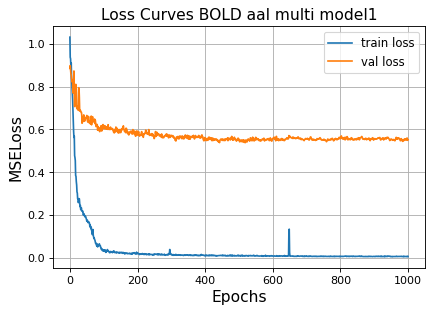

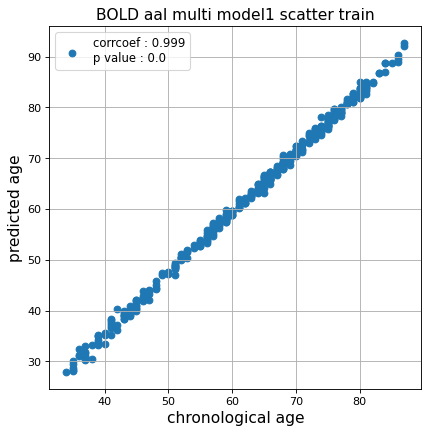

r^2 train data:  0.9595205712457844


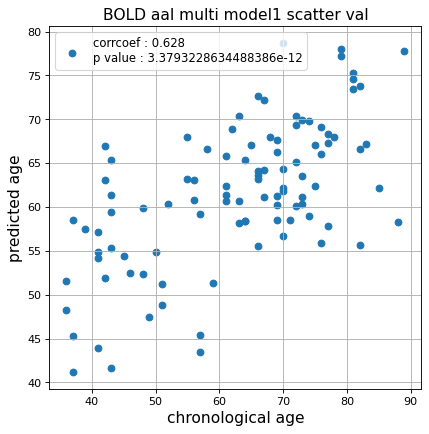

r^2 val data:  0.38598792141541216


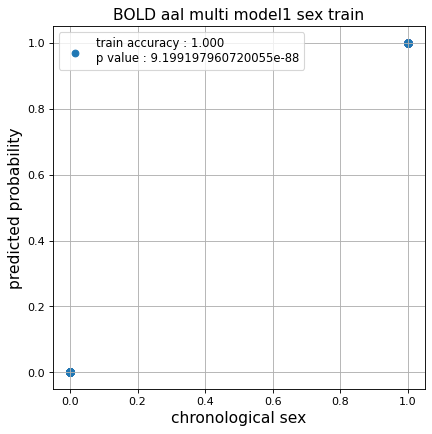

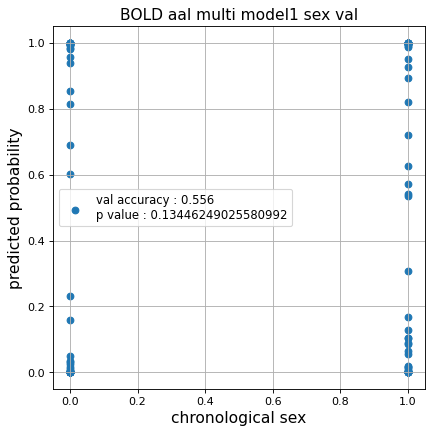

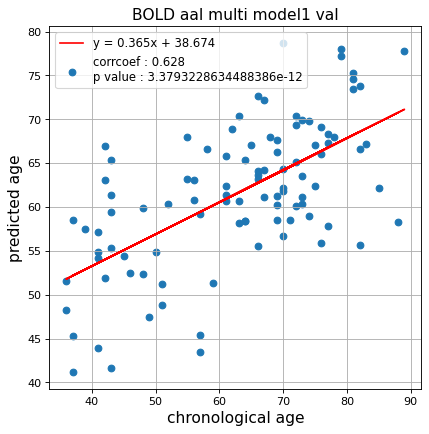

切片: 38.67409398210788
傾き: 0.3646215216145694
Kfold: 3 ::: epoch: 100, loss: 0.03392748778256086, val loss: 0.6666921973228455
Kfold: 3 ::: epoch: 200, loss: 0.01885325963107439, val loss: 0.558545708656311
Kfold: 3 ::: epoch: 300, loss: 0.01494259129350002, val loss: 0.534025564789772
Kfold: 3 ::: epoch: 400, loss: 0.009842482574570637, val loss: 0.4874018020927906
Kfold: 3 ::: epoch: 500, loss: 0.009486325407544008, val loss: 0.48388034850358963
Kfold: 3 ::: epoch: 600, loss: 0.00887727766082837, val loss: 0.462952870875597
Kfold: 3 ::: epoch: 700, loss: 0.0061405508134227535, val loss: 0.4553680904209614
Kfold: 3 ::: epoch: 800, loss: 0.006062334564586098, val loss: 0.4429697170853615
Kfold: 3 ::: epoch: 900, loss: 0.005608007007350142, val loss: 0.43975676223635674
Kfold: 3 ::: epoch: 1000, loss: 0.0053598989660923295, val loss: 0.4377752561122179
save_epochs:976
best val loss:0.42324548214673996


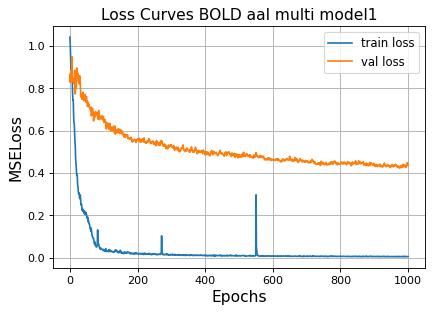

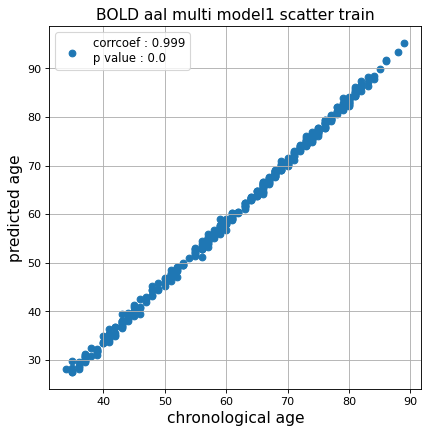

r^2 train data:  0.9356746478747217


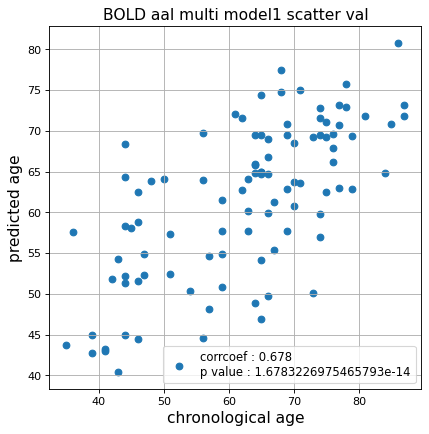

r^2 val data:  0.45385908640935024


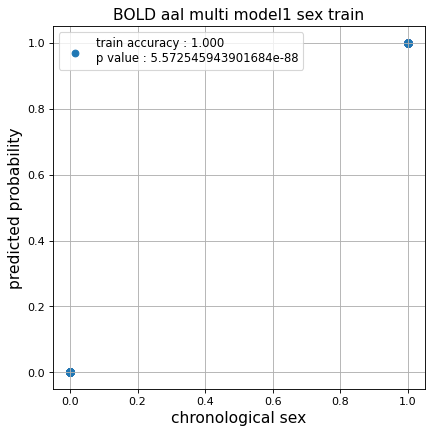

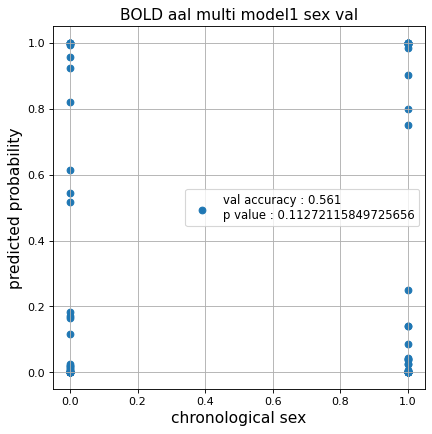

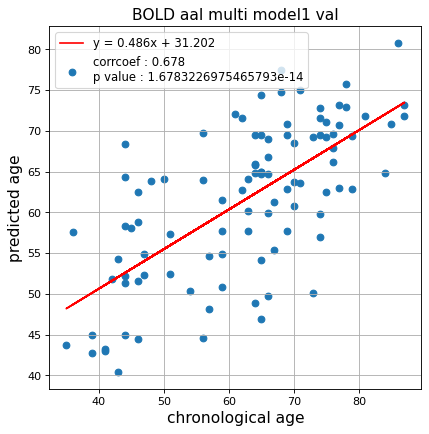

切片: 31.202453171266267
傾き: 0.48571224554303133
Kfold: 4 ::: epoch: 100, loss: 0.032873213004607424, val loss: 0.8610461503267288
Kfold: 4 ::: epoch: 200, loss: 0.017393941919390973, val loss: 0.8546693176031113
Kfold: 4 ::: epoch: 300, loss: 0.012140145883537255, val loss: 0.8595915734767914
Kfold: 4 ::: epoch: 400, loss: 0.012496067784153499, val loss: 0.864575520157814
Kfold: 4 ::: epoch: 500, loss: 0.007992376716664204, val loss: 0.8746899217367172
Kfold: 4 ::: epoch: 600, loss: 0.00707980331320029, val loss: 0.8712715208530426
Kfold: 4 ::: epoch: 700, loss: 0.005611697426782205, val loss: 0.868677169084549
Kfold: 4 ::: epoch: 800, loss: 0.0048211779481229875, val loss: 0.865270659327507
Kfold: 4 ::: epoch: 900, loss: 0.004438523041944091, val loss: 0.8769564107060432
Kfold: 4 ::: epoch: 1000, loss: 0.0038478146844471875, val loss: 0.9315400496125221
save_epochs:285
best val loss:0.7909787744283676


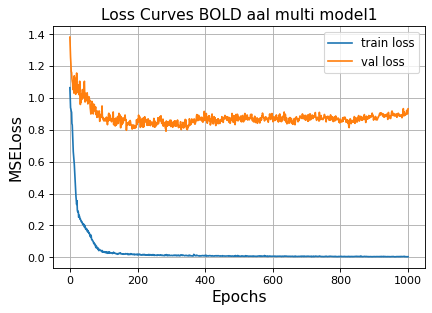

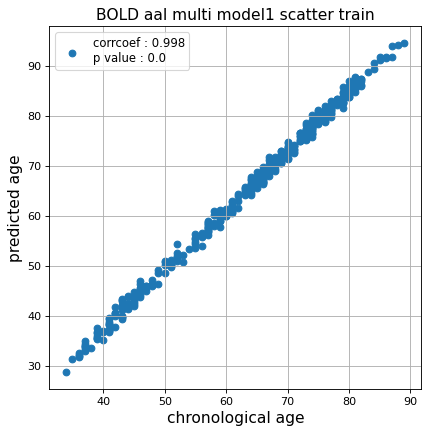

r^2 train data:  0.9431313522400241


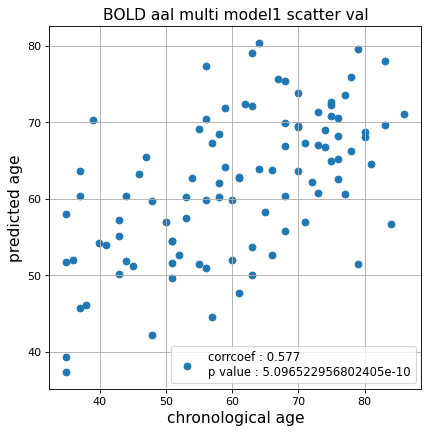

r^2 val data:  0.3160844621588593


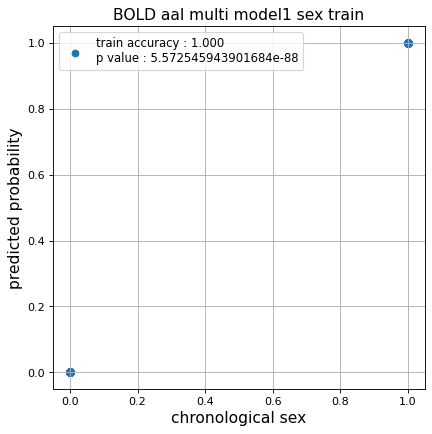

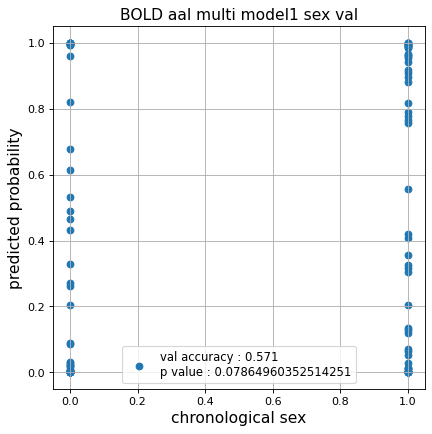

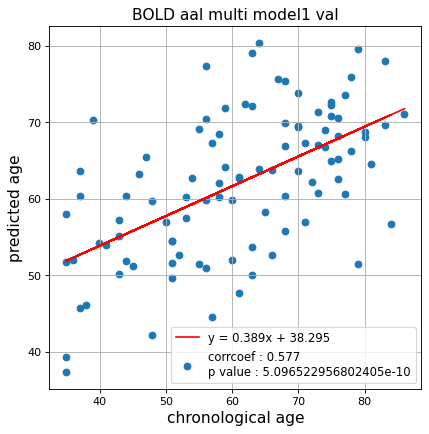

切片: 38.294584443989606
傾き: 0.3894785774598532
Kfold: 5 ::: epoch: 100, loss: 0.041996814167270295, val loss: 0.7350485175848007
Kfold: 5 ::: epoch: 200, loss: 0.016827410015349206, val loss: 0.7213299609720707
Kfold: 5 ::: epoch: 300, loss: 0.015317869229385486, val loss: 0.7120417803525925
Kfold: 5 ::: epoch: 400, loss: 0.009738629146550711, val loss: 0.6619047671556473
Kfold: 5 ::: epoch: 500, loss: 0.009670185140119148, val loss: 0.6749315336346626
Kfold: 5 ::: epoch: 600, loss: 0.006848301075828763, val loss: 0.6701739132404327
Kfold: 5 ::: epoch: 700, loss: 0.007892830601821724, val loss: 0.6576350703835487
Kfold: 5 ::: epoch: 800, loss: 0.005608119572011324, val loss: 0.6538615822792053
Kfold: 5 ::: epoch: 900, loss: 0.005338684745276203, val loss: 0.6395670920610428
Kfold: 5 ::: epoch: 1000, loss: 0.005954376941260237, val loss: 0.6558935455977917
save_epochs:993
best val loss:0.6299193985760212


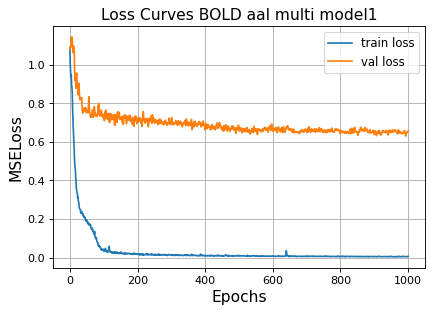

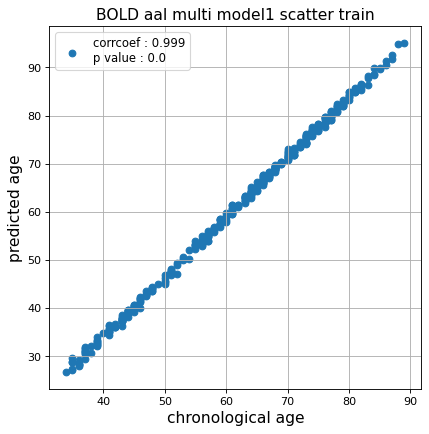

r^2 train data:  0.9371859919248664


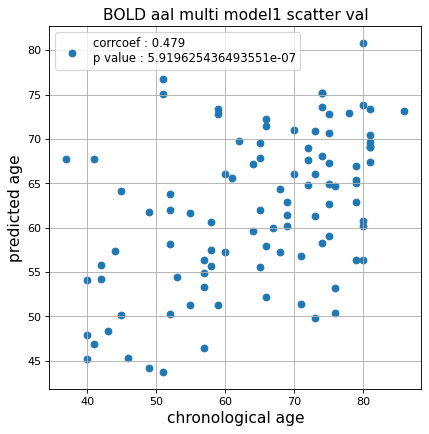

r^2 val data:  0.14882972503419378


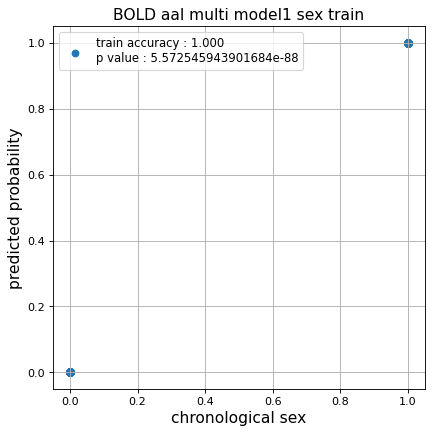

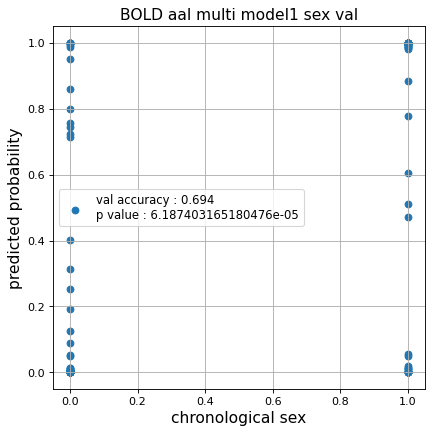

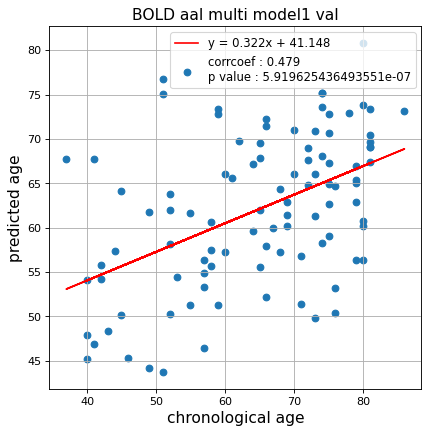

切片: 41.14782095799541
傾き: 0.3222685142731847
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.03568675111119564, val loss: 0.5805391222238541
Kfold: 1 ::: epoch: 200, loss: 0.017771235165687706, val loss: 0.5106867849826813
Kfold: 1 ::: epoch: 300, loss: 0.01126295611119041, val loss: 0.5087706781923771
Kfold: 1 ::: epoch: 400, loss: 0.011115460047641626, val loss: 0.47957901284098625
Kfold: 1 ::: epoch: 500, loss: 0.007789042312651873, val loss: 0.49811164662241936
Kfold: 1 ::: epoch: 600, loss: 0.008511357439252047, val loss: 0.4866050183773041
Kfold: 1 ::: epoch: 700, loss: 0.006414424807119828, val loss: 0.48319531232118607
Kfold: 1 ::: epoch: 800, loss: 0.004982998934932626, val loss: 0.48470528423786163
Kfold: 1 ::: epoch: 900, loss: 0.004209427771946559, val loss: 0.48331525176763535
Kfold: 1 ::: epoch: 1000, loss: 0.004681001883000135, val loss: 0.48910198733210564
save_epochs:920
best val loss:0.4686543643474579


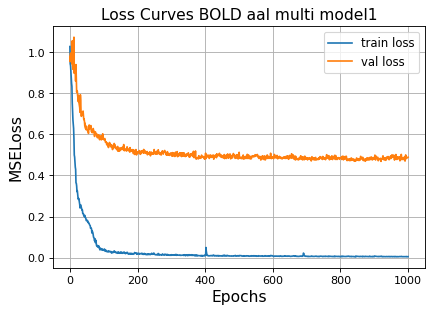

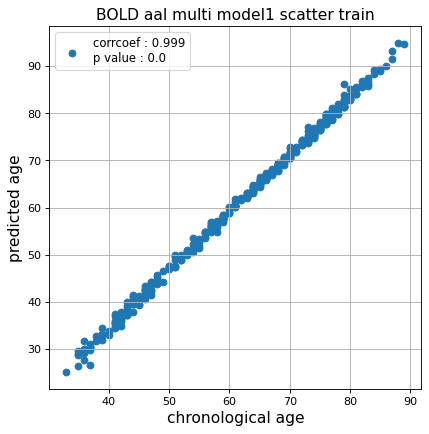

r^2 train data:  0.9449241098178666


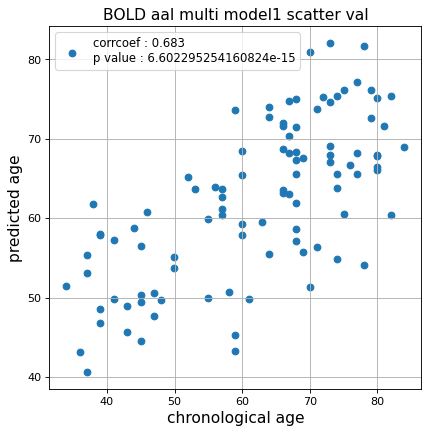

r^2 val data:  0.4655109457499633


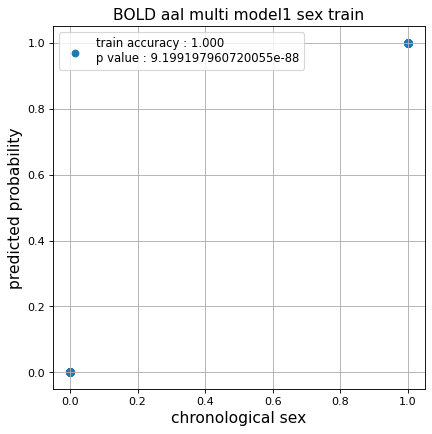

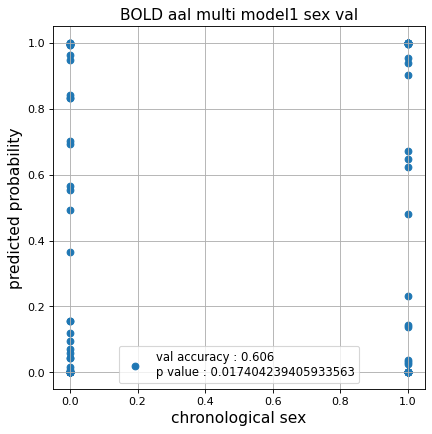

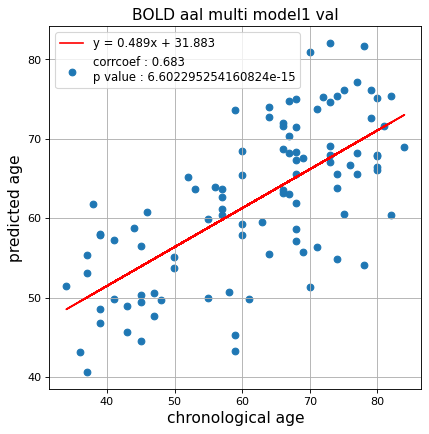

切片: 31.882543011215454
傾き: 0.48946353955007255
Kfold: 2 ::: epoch: 100, loss: 0.032995130150364, val loss: 0.6436615288257599
Kfold: 2 ::: epoch: 200, loss: 0.015979552784791358, val loss: 0.6222897171974182
Kfold: 2 ::: epoch: 300, loss: 0.013472791832800094, val loss: 0.6065826267004013
Kfold: 2 ::: epoch: 400, loss: 0.008598503549225055, val loss: 0.5975323617458344
Kfold: 2 ::: epoch: 500, loss: 0.010078917723149061, val loss: 0.5879938751459122
Kfold: 2 ::: epoch: 600, loss: 0.006518808856176643, val loss: 0.5873254612088203
Kfold: 2 ::: epoch: 700, loss: 0.007017930109913533, val loss: 0.5737375393509865
Kfold: 2 ::: epoch: 800, loss: 0.005201868336791029, val loss: 0.5773447081446648
Kfold: 2 ::: epoch: 900, loss: 0.005947571659747224, val loss: 0.5683908015489578
Kfold: 2 ::: epoch: 1000, loss: 0.004745085150576555, val loss: 0.5822305083274841
save_epochs:958
best val loss:0.5586644113063812


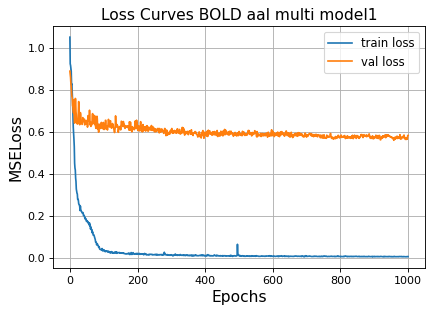

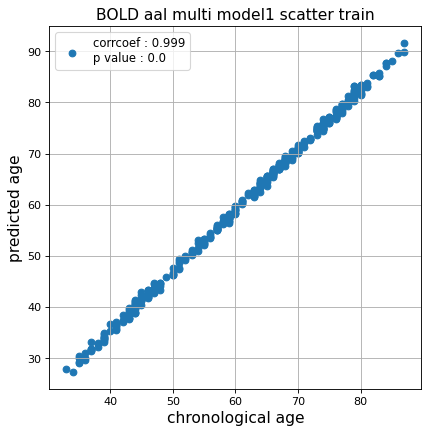

r^2 train data:  0.9622836306290786


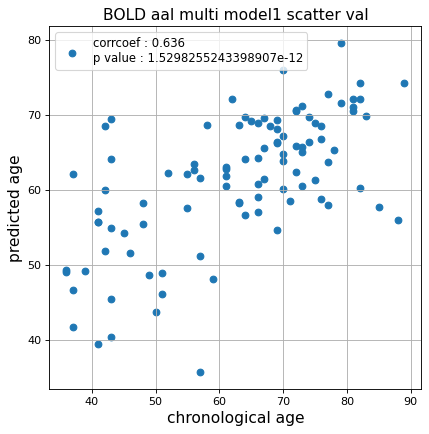

r^2 val data:  0.39654896874559475


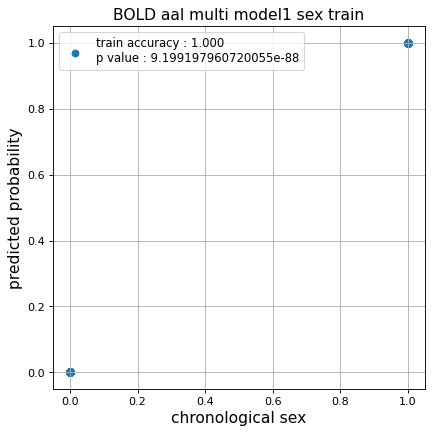

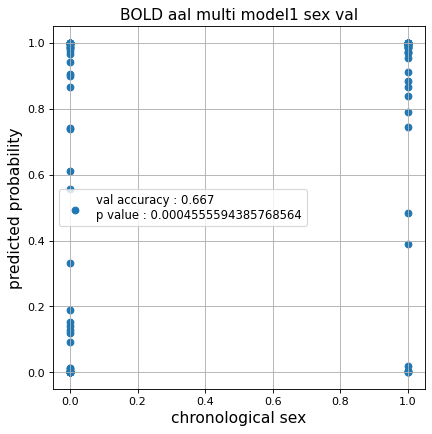

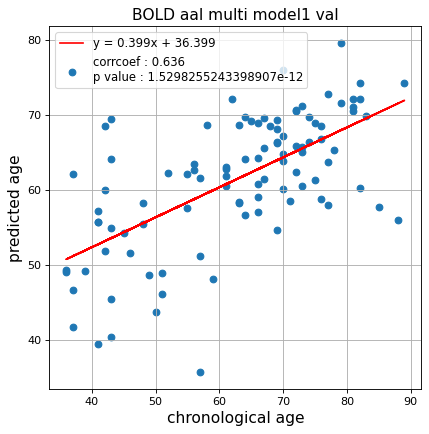

切片: 36.39899416873592
傾き: 0.3991674048903302
Kfold: 3 ::: epoch: 100, loss: 0.03804841666267468, val loss: 0.674024224281311
Kfold: 3 ::: epoch: 200, loss: 0.023190403285507973, val loss: 0.5675534307956696
Kfold: 3 ::: epoch: 300, loss: 0.014186821089914212, val loss: 0.5530897602438927
Kfold: 3 ::: epoch: 400, loss: 0.009657237822046647, val loss: 0.5316852927207947
Kfold: 3 ::: epoch: 500, loss: 0.007625848054885864, val loss: 0.5098017230629921
Kfold: 3 ::: epoch: 600, loss: 0.007353749520216997, val loss: 0.5093003734946251
Kfold: 3 ::: epoch: 700, loss: 0.006429117208776565, val loss: 0.47732680290937424
Kfold: 3 ::: epoch: 800, loss: 0.005966434255242348, val loss: 0.4883168190717697
Kfold: 3 ::: epoch: 900, loss: 0.006616235459939792, val loss: 0.4700431525707245
Kfold: 3 ::: epoch: 1000, loss: 0.16362029650750068, val loss: 0.45050039142370224
save_epochs:1000
best val loss:0.45050039142370224


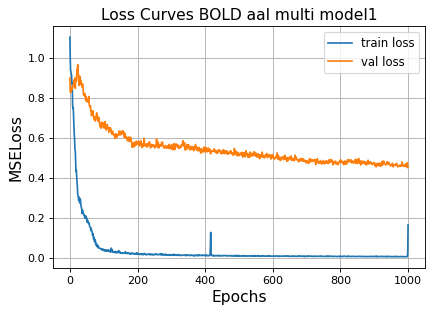

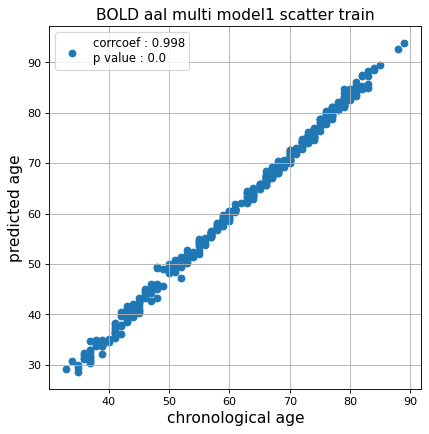

r^2 train data:  0.9608623565095101


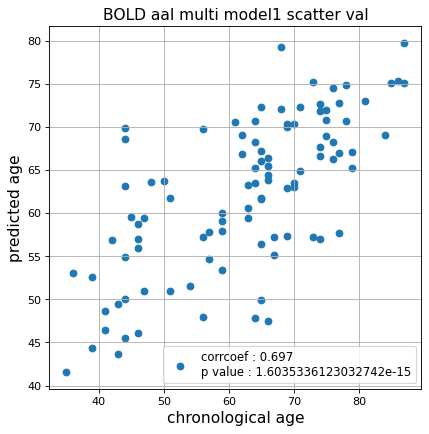

r^2 val data:  0.4851463803869225


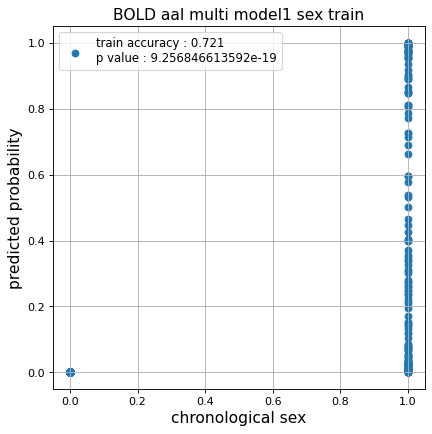

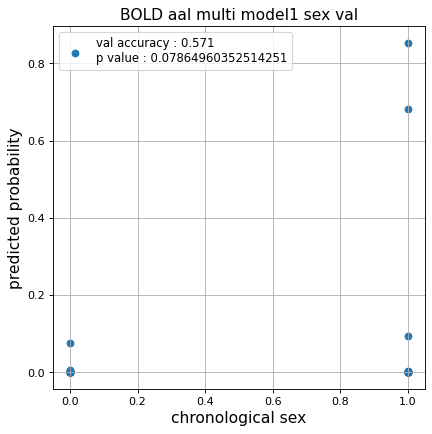

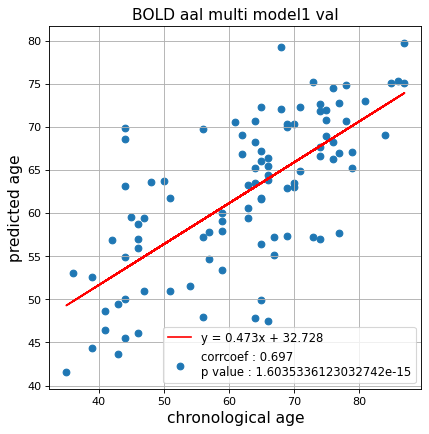

切片: 32.727512370461554
傾き: 0.4734249463161774
Kfold: 4 ::: epoch: 100, loss: 0.03314884092945319, val loss: 0.6899298429489136
Kfold: 4 ::: epoch: 200, loss: 0.01655076963540453, val loss: 0.671012356877327
Kfold: 4 ::: epoch: 300, loss: 0.01223011533371531, val loss: 0.6146469786763191
Kfold: 4 ::: epoch: 400, loss: 0.010923379745620947, val loss: 0.5976204872131348
Kfold: 4 ::: epoch: 500, loss: 0.00766617263882206, val loss: 0.5954776555299759
Kfold: 4 ::: epoch: 600, loss: 0.006334803067147732, val loss: 0.5622566640377045
Kfold: 4 ::: epoch: 700, loss: 0.005666763593371098, val loss: 0.5672020316123962
Kfold: 4 ::: epoch: 800, loss: 0.004471588449982496, val loss: 0.5444765537977219
Kfold: 4 ::: epoch: 900, loss: 0.024032356629434686, val loss: 0.5456032902002335
Kfold: 4 ::: epoch: 1000, loss: 0.003970960387960076, val loss: 0.5303898379206657
save_epochs:988
best val loss:0.5119988769292831


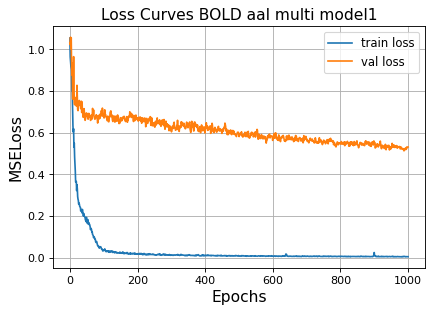

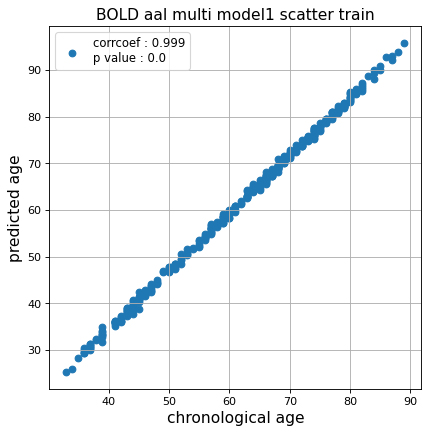

r^2 train data:  0.9424099653976787


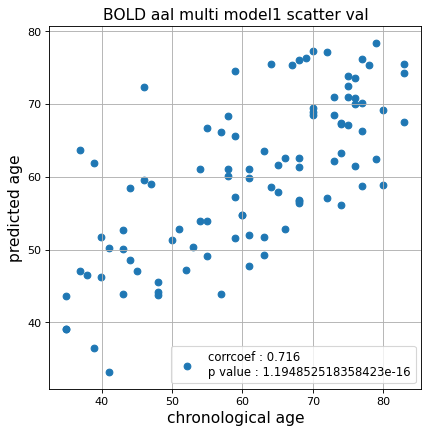

r^2 val data:  0.49906277797890464


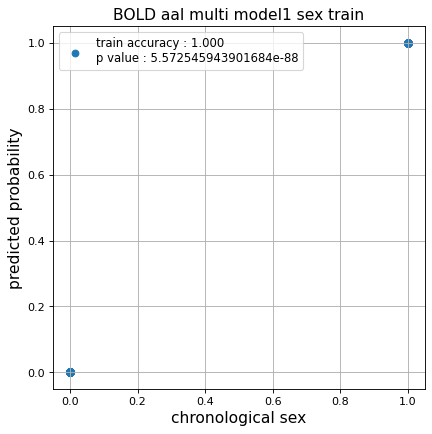

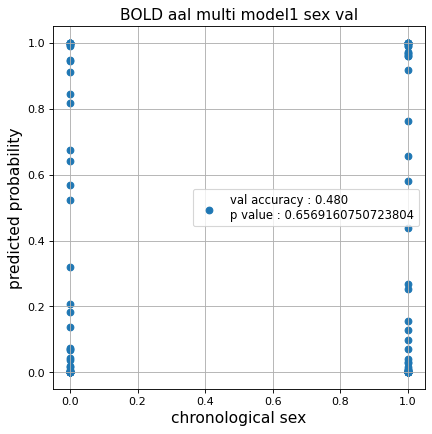

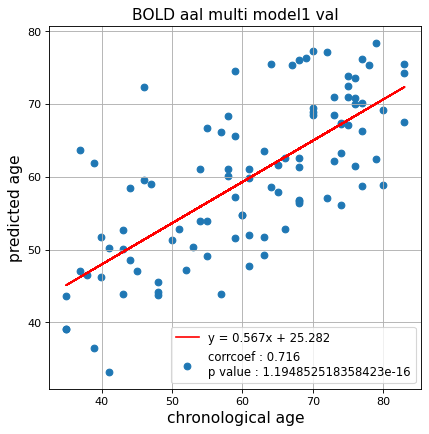

切片: 25.281998333020233
傾き: 0.5669694127695897
Kfold: 5 ::: epoch: 100, loss: 0.04071250959084584, val loss: 0.8102862536907196
Kfold: 5 ::: epoch: 200, loss: 0.016710030308996256, val loss: 0.7984578609466553
Kfold: 5 ::: epoch: 300, loss: 0.014060727428071775, val loss: 0.754609614610672
Kfold: 5 ::: epoch: 400, loss: 0.008861357883478586, val loss: 0.7399396747350693
Kfold: 5 ::: epoch: 500, loss: 0.008136593682978015, val loss: 0.7315489202737808
Kfold: 5 ::: epoch: 600, loss: 0.008554628118872643, val loss: 0.701721802353859
Kfold: 5 ::: epoch: 700, loss: 0.007034066169021221, val loss: 0.7158600986003876
Kfold: 5 ::: epoch: 800, loss: 0.005929273911393606, val loss: 0.7241854667663574
Kfold: 5 ::: epoch: 900, loss: 0.005089146568654821, val loss: 0.6838732659816742
Kfold: 5 ::: epoch: 1000, loss: 0.006015122724840274, val loss: 0.6848173439502716
save_epochs:737
best val loss:0.6553156971931458


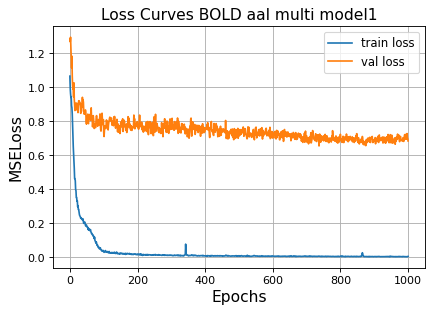

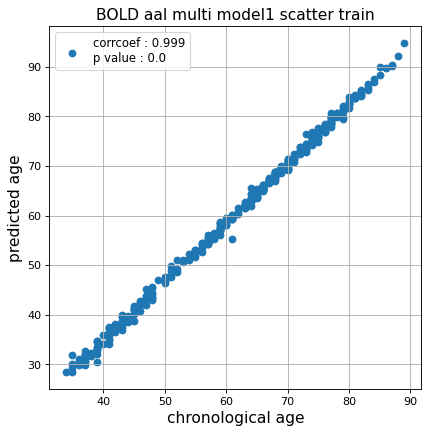

r^2 train data:  0.9561845099471119


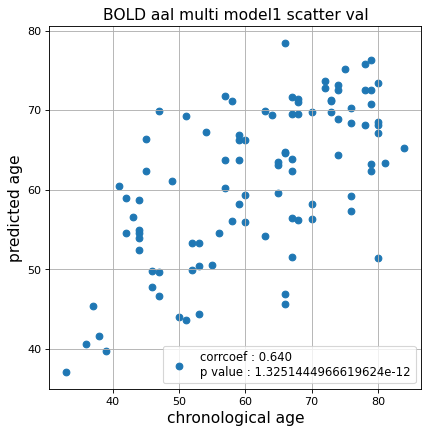

r^2 val data:  0.39757300709163845


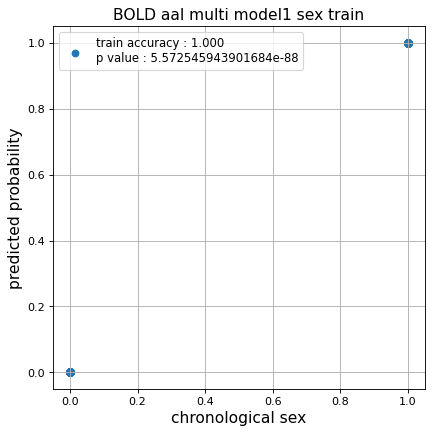

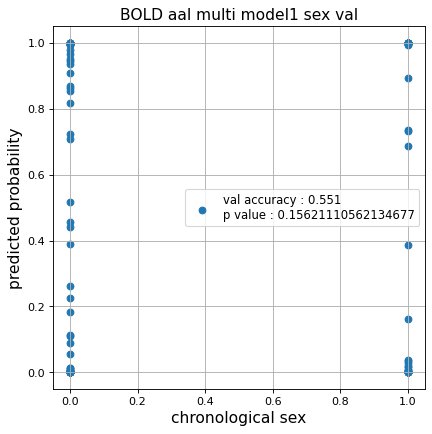

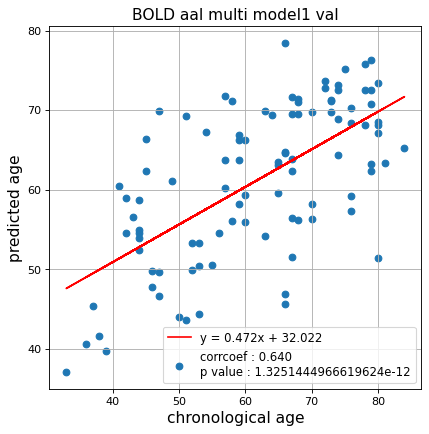

切片: 32.02220218406437
傾き: 0.4720752180503791
CPU times: user 2h 11min 22s, sys: 18min 23s, total: 2h 29min 46s
Wall time: 2h 29min 56s


In [14]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_all_1  = []
test_pred_aal_all_inverse_1  = []
test_label_aal_all_1 = []

test_idx_aal_all_1   = []
train_idx_aal_all_1  = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_inverse,test_label = train_model(data_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 256,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 1024,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.2,
                                                           fc_drop = 0.1,
                                                           title = 'BOLD aal multi model1'
                                                          )
    
    test_pred_aal_all_1.append(test_pred)
    test_pred_aal_all_inverse_1.append(test_pred_inverse)
    test_label_aal_all_1.append(test_label)

    test_idx_aal_all_1.append(test_idx)
    train_idx_aal_all_1.append(train_idx)

### Bold 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.18331577227665827, val loss: 0.7195379287004471
Kfold: 1 ::: epoch: 200, loss: 0.032930476447710626, val loss: 0.6808783411979675
Kfold: 1 ::: epoch: 300, loss: 0.015512174765507761, val loss: 0.6617300882935524
Kfold: 1 ::: epoch: 400, loss: 0.011094194944374837, val loss: 0.6635636687278748
Kfold: 1 ::: epoch: 500, loss: 0.010066902515693353, val loss: 0.6396847814321518
Kfold: 1 ::: epoch: 600, loss: 0.009892980030809458, val loss: 0.6320170536637306
Kfold: 1 ::: epoch: 700, loss: 0.010127018814763198, val loss: 0.6255711913108826
Kfold: 1 ::: epoch: 800, loss: 0.009234498183314618, val loss: 0.6202028095722198
Kfold: 1 ::: epoch: 900, loss: 0.008262231587790526, val loss: 0.603745810687542
Kfold: 1 ::: epoch: 1000, loss: 0.00657868105918169, val loss: 0.5767215453088284
save_epochs:991
best val loss:0.569991260766983


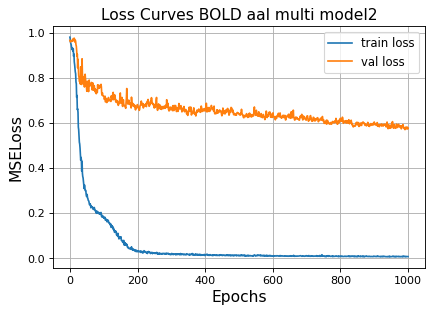

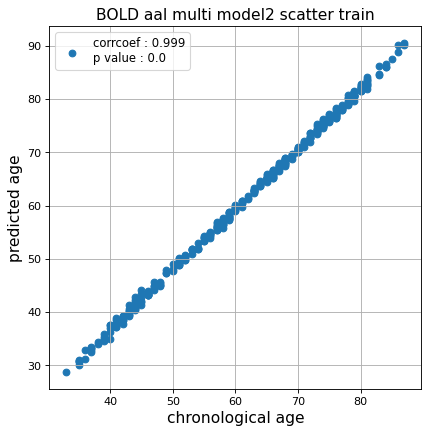

r^2 train data:  0.9806555501423552


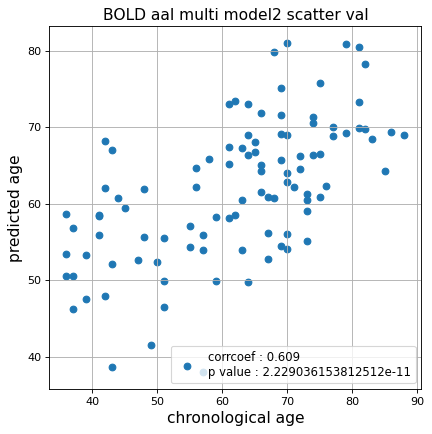

r^2 val data:  0.36836837658525867


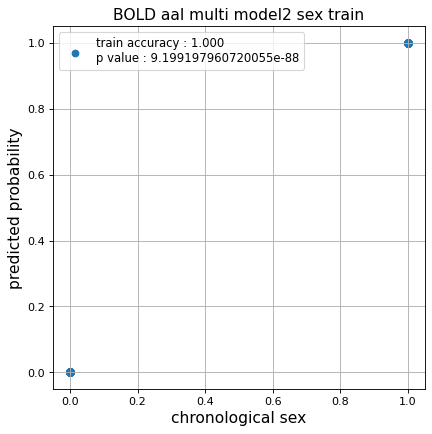

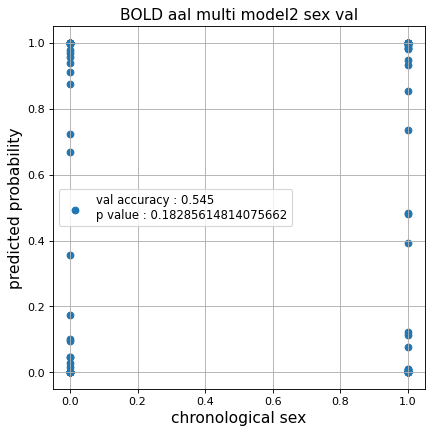

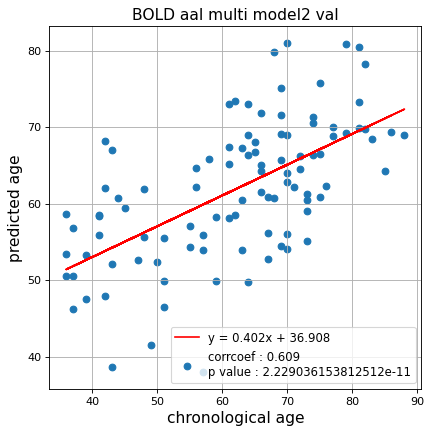

切片: 36.9076520927247
傾き: 0.40246911839932265
Kfold: 2 ::: epoch: 100, loss: 0.18224371511202592, val loss: 0.6437539681792259
Kfold: 2 ::: epoch: 200, loss: 0.03295183654588003, val loss: 0.5917706042528152
Kfold: 2 ::: epoch: 300, loss: 0.017566393272807963, val loss: 0.5885545313358307
Kfold: 2 ::: epoch: 400, loss: 0.01405949442862318, val loss: 0.596102699637413
Kfold: 2 ::: epoch: 500, loss: 0.01723677650667154, val loss: 0.597649946808815
Kfold: 2 ::: epoch: 600, loss: 0.013767123222351074, val loss: 0.5878008157014847
Kfold: 2 ::: epoch: 700, loss: 0.010680870869411873, val loss: 0.5818465501070023
Kfold: 2 ::: epoch: 800, loss: 0.00807838154455217, val loss: 0.5866017937660217
Kfold: 2 ::: epoch: 900, loss: 0.006807593807864647, val loss: 0.5750113353133202
Kfold: 2 ::: epoch: 1000, loss: 0.0076785353728784965, val loss: 0.5559051334857941
save_epochs:1000
best val loss:0.5559051334857941


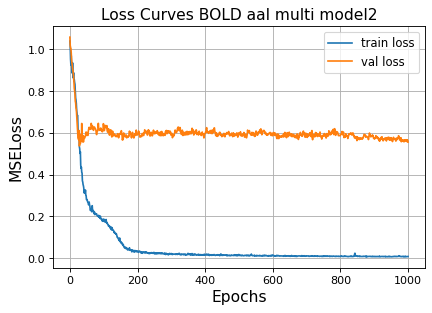

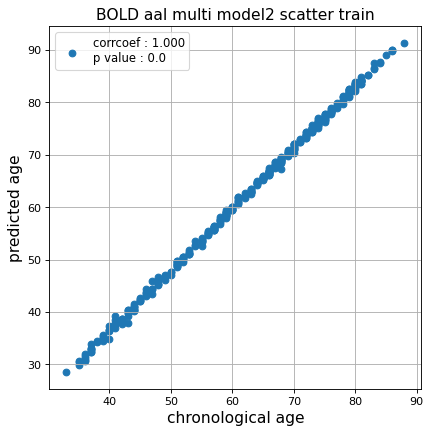

r^2 train data:  0.9704156409863592


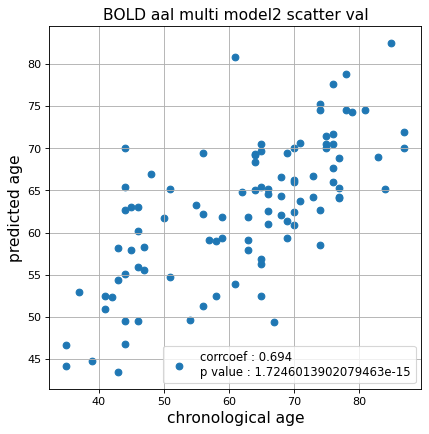

r^2 val data:  0.47344210920050644


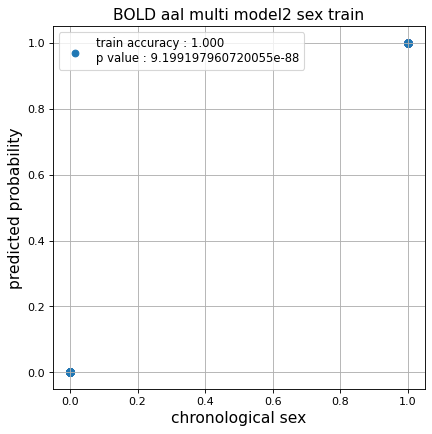

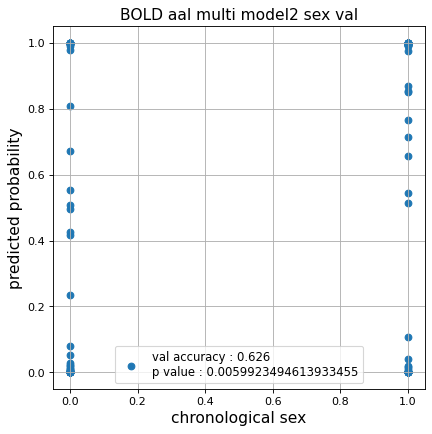

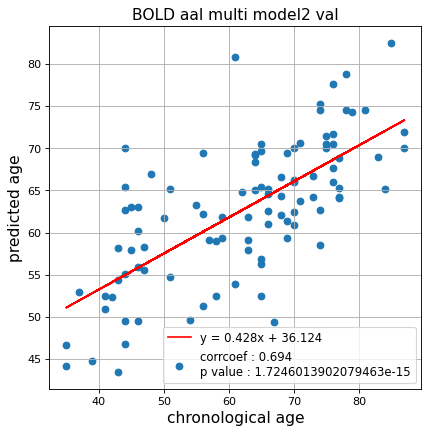

切片: 36.12394785863823
傾き: 0.42772954433512633
Kfold: 3 ::: epoch: 100, loss: 0.17520665663939256, val loss: 1.0165402740240097
Kfold: 3 ::: epoch: 200, loss: 0.032466704169144996, val loss: 0.9718243181705475
Kfold: 3 ::: epoch: 300, loss: 0.021659661944095906, val loss: 0.8842640370130539
Kfold: 3 ::: epoch: 400, loss: 0.013942255280338801, val loss: 0.853399783372879
Kfold: 3 ::: epoch: 500, loss: 0.012148715054186491, val loss: 0.8262768983840942
Kfold: 3 ::: epoch: 600, loss: 0.011204446451022075, val loss: 0.7867986857891083
Kfold: 3 ::: epoch: 700, loss: 0.00947259570686863, val loss: 0.7900543063879013
Kfold: 3 ::: epoch: 800, loss: 0.009077289750656256, val loss: 0.7769476175308228
Kfold: 3 ::: epoch: 900, loss: 0.006795156532182143, val loss: 0.7631069868803024
Kfold: 3 ::: epoch: 1000, loss: 0.005716915206553845, val loss: 0.7314746081829071
save_epochs:999
best val loss:0.726999893784523


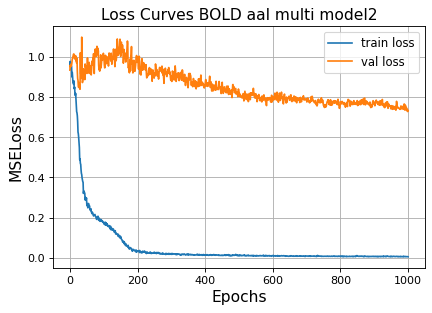

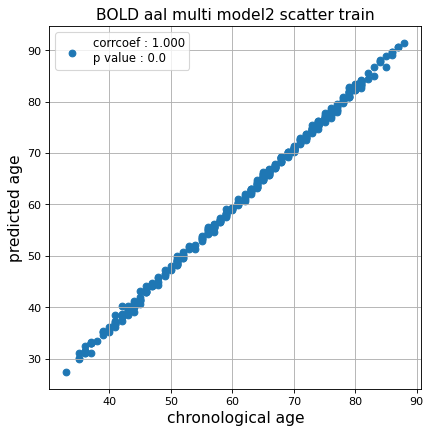

r^2 train data:  0.9714470693239101


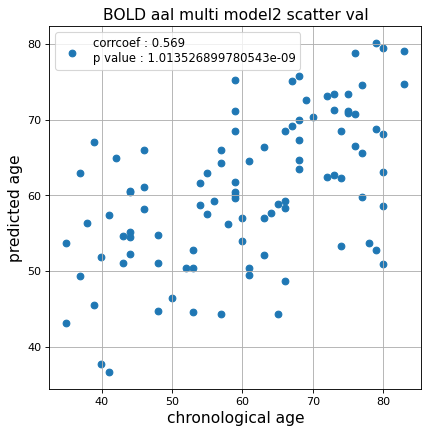

r^2 val data:  0.3014779415577522


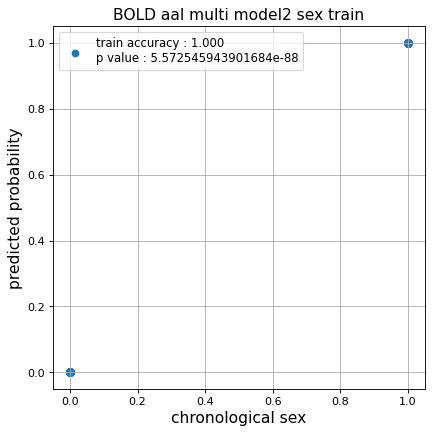

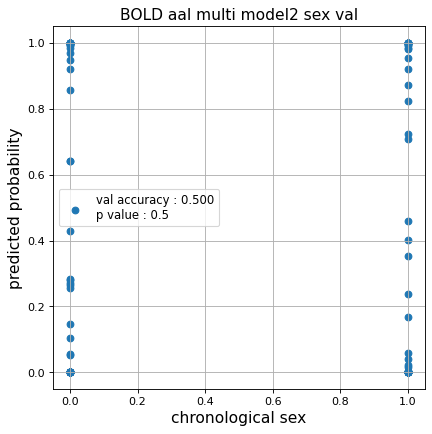

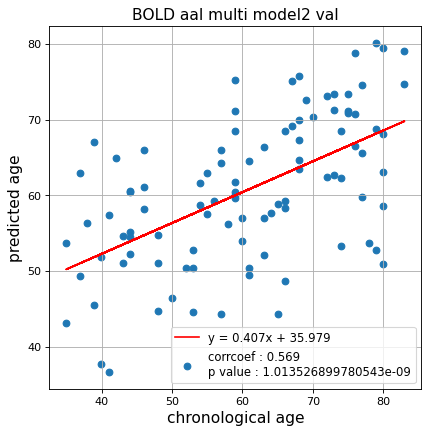

切片: 35.979426377485915
傾き: 0.40720351446842623
Kfold: 4 ::: epoch: 100, loss: 0.15277417863790804, val loss: 1.370062604546547
Kfold: 4 ::: epoch: 200, loss: 0.027220136485993862, val loss: 1.2021497040987015
Kfold: 4 ::: epoch: 300, loss: 0.01904183404090313, val loss: 1.1837410181760788
Kfold: 4 ::: epoch: 400, loss: 0.014092720650996152, val loss: 1.120887964963913
Kfold: 4 ::: epoch: 500, loss: 0.012663021540412536, val loss: 1.0984559804201126
Kfold: 4 ::: epoch: 600, loss: 0.010744383773551537, val loss: 1.0666290670633316
Kfold: 4 ::: epoch: 700, loss: 0.010343488986388994, val loss: 1.052817478775978
Kfold: 4 ::: epoch: 800, loss: 0.009703394634505877, val loss: 1.034394770860672
Kfold: 4 ::: epoch: 900, loss: 0.008426940426803552, val loss: 1.009737879037857
Kfold: 4 ::: epoch: 1000, loss: 0.006368579325051262, val loss: 1.0169378221035004
save_epochs:899
best val loss:0.9898166209459305


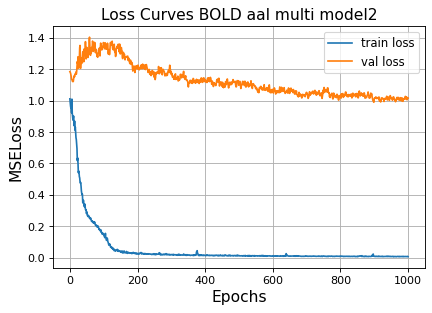

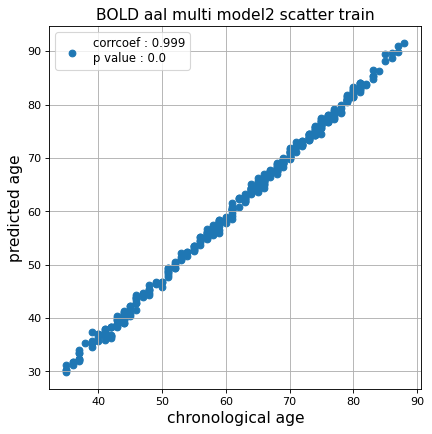

r^2 train data:  0.972725259419456


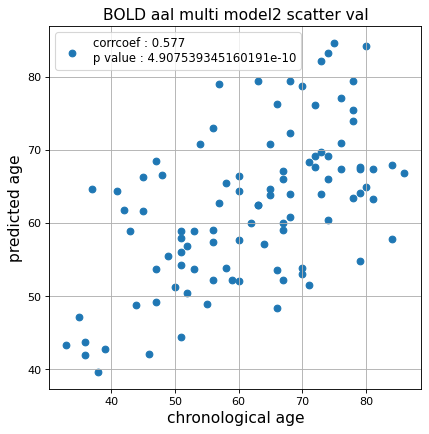

r^2 val data:  0.292753992989473


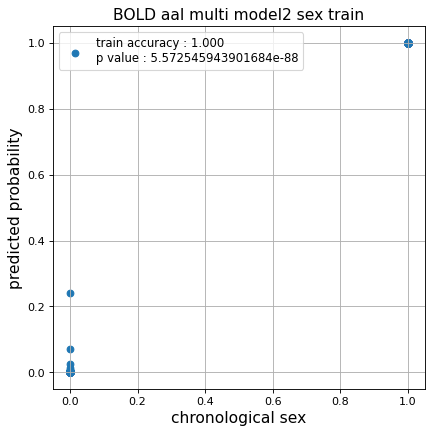

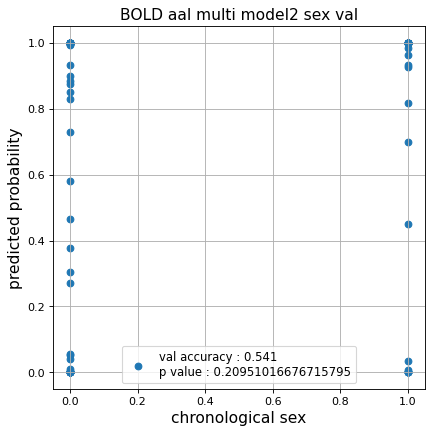

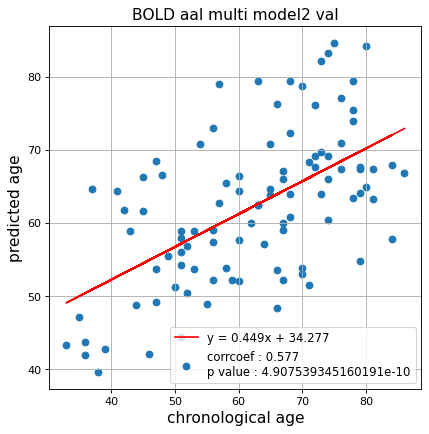

切片: 34.27672797931503
傾き: 0.4492575051196997
Kfold: 5 ::: epoch: 100, loss: 0.1937669446835151, val loss: 1.1311290860176086
Kfold: 5 ::: epoch: 200, loss: 0.030936216219113424, val loss: 0.9564380496740341
Kfold: 5 ::: epoch: 300, loss: 0.02298658570417991, val loss: 0.8861693441867828
Kfold: 5 ::: epoch: 400, loss: 0.017613636902891673, val loss: 0.8545561134815216
Kfold: 5 ::: epoch: 500, loss: 0.015084481583191799, val loss: 0.8099915608763695
Kfold: 5 ::: epoch: 600, loss: 0.010850437379513796, val loss: 0.803166389465332
Kfold: 5 ::: epoch: 700, loss: 0.011541612607498582, val loss: 0.7843711227178574
Kfold: 5 ::: epoch: 800, loss: 0.0075711507994968156, val loss: 0.7881637066602707
Kfold: 5 ::: epoch: 900, loss: 0.007493900206799691, val loss: 0.8007907271385193
Kfold: 5 ::: epoch: 1000, loss: 0.008119552861899137, val loss: 0.8181079030036926
save_epochs:863
best val loss:0.7668803408741951


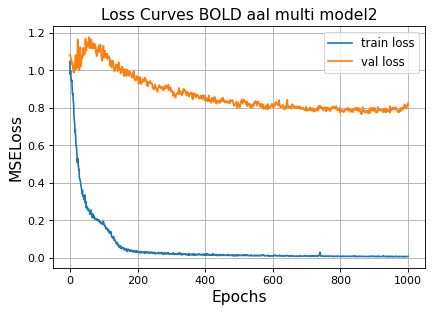

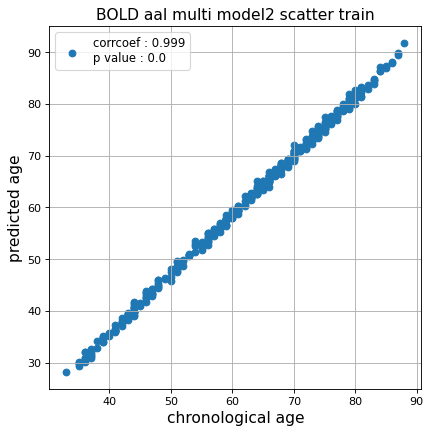

r^2 train data:  0.9700934834315891


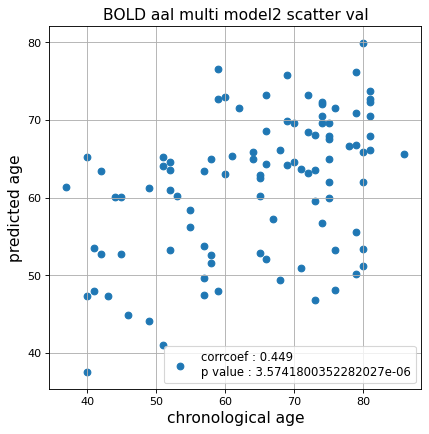

r^2 val data:  0.07734293384632951


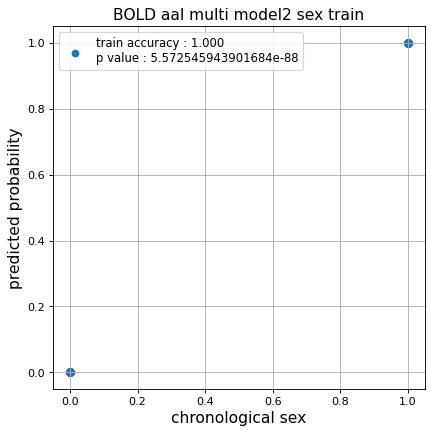

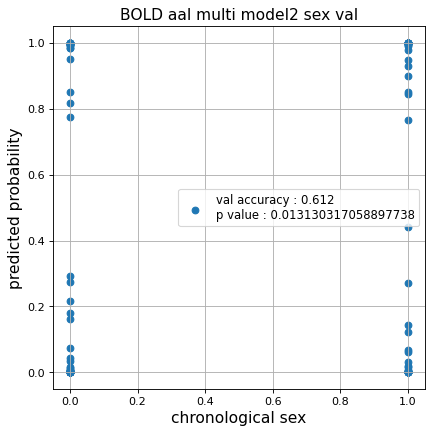

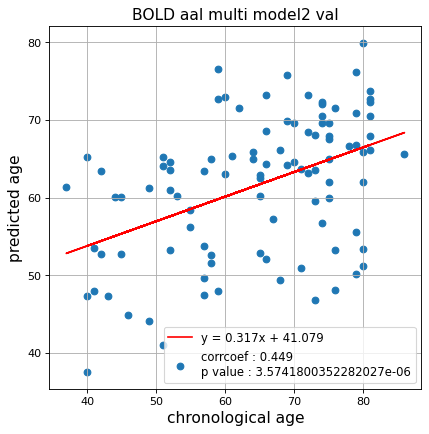

切片: 41.07863875125335
傾き: 0.3174110842865986
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.17732513065521532, val loss: 0.8415986001491547
Kfold: 1 ::: epoch: 200, loss: 0.028859533369541168, val loss: 0.7794158160686493
Kfold: 1 ::: epoch: 300, loss: 0.016860752939604796, val loss: 0.7438458353281021
Kfold: 1 ::: epoch: 400, loss: 0.012683448095161181, val loss: 0.7326838970184326
Kfold: 1 ::: epoch: 500, loss: 0.012180392666218372, val loss: 0.6988959163427353
Kfold: 1 ::: epoch: 600, loss: 0.008961288616634332, val loss: 0.6762907952070236
Kfold: 1 ::: epoch: 700, loss: 0.00951819376160319, val loss: 0.6634428948163986
Kfold: 1 ::: epoch: 800, loss: 0.00891238461750058, val loss: 0.6674136817455292
Kfold: 1 ::: epoch: 900, loss: 0.0084921489827908, val loss: 0.6324384361505508
Kfold: 1 ::: epoch: 1000, loss: 0.0069422484017335456, val loss: 0.6470670104026794
save_epochs:901
best val loss:0.6301609724760056


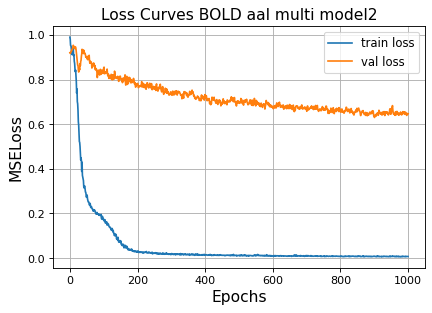

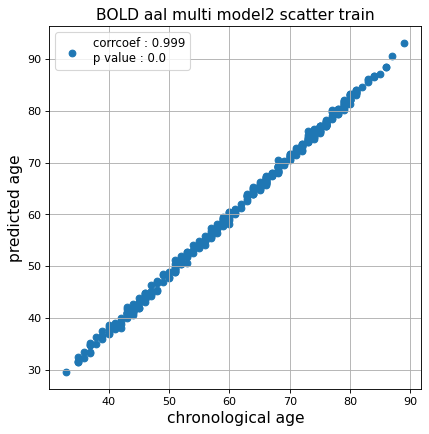

r^2 train data:  0.9830840237535605


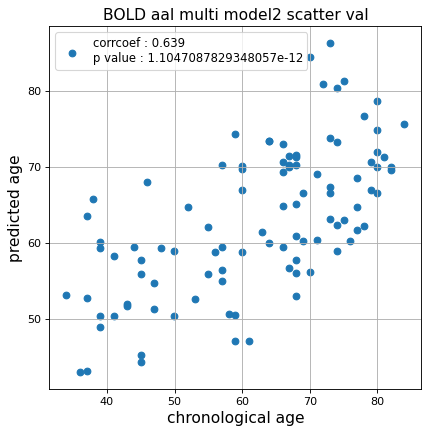

r^2 val data:  0.3995787594061254


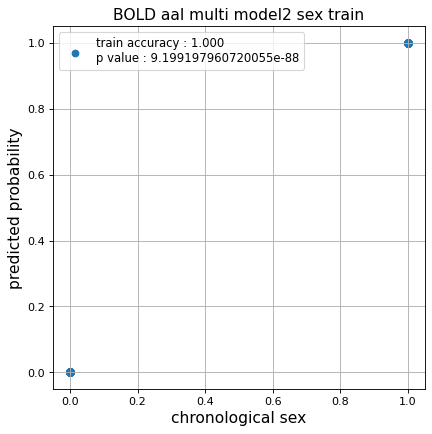

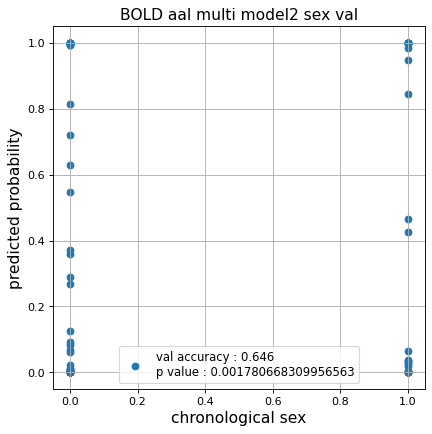

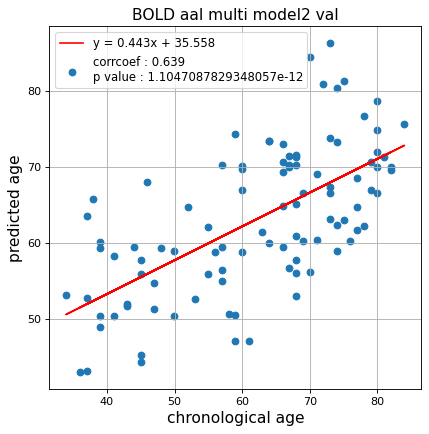

切片: 35.55849379460436
傾き: 0.44331244350971355
Kfold: 2 ::: epoch: 100, loss: 0.1841817830617611, val loss: 0.6303079128265381
Kfold: 2 ::: epoch: 200, loss: 0.03610509691330103, val loss: 0.6232270896434784
Kfold: 2 ::: epoch: 300, loss: 0.01653173931229573, val loss: 0.6314432471990585
Kfold: 2 ::: epoch: 400, loss: 0.014713135762856556, val loss: 0.6406198889017105
Kfold: 2 ::: epoch: 500, loss: 0.013149870738673668, val loss: 0.6556332558393478
Kfold: 2 ::: epoch: 600, loss: 0.00889547523827507, val loss: 0.6343705058097839
Kfold: 2 ::: epoch: 700, loss: 0.00904960729754888, val loss: 0.5970888435840607
Kfold: 2 ::: epoch: 800, loss: 0.00869693596345874, val loss: 0.5926305800676346
Kfold: 2 ::: epoch: 900, loss: 0.006505169189320161, val loss: 0.6009438782930374
Kfold: 2 ::: epoch: 1000, loss: 0.007573020429565356, val loss: 0.5938726663589478
save_epochs:765
best val loss:0.5804916992783546


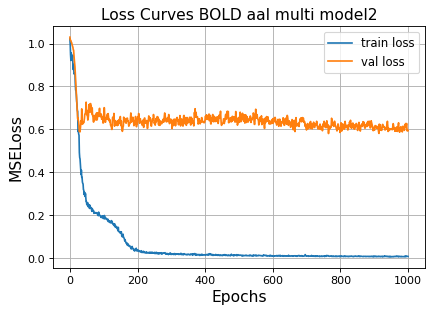

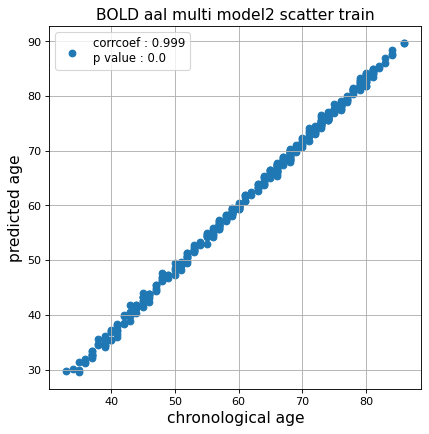

r^2 train data:  0.9707635966378956


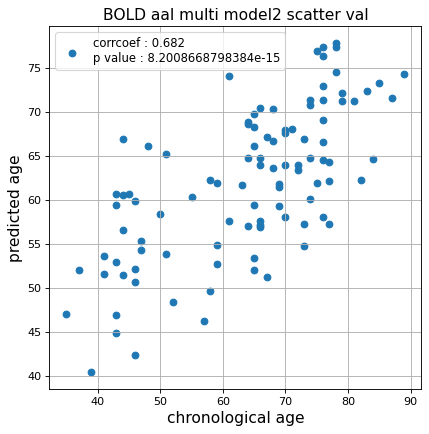

r^2 val data:  0.4435483869841824


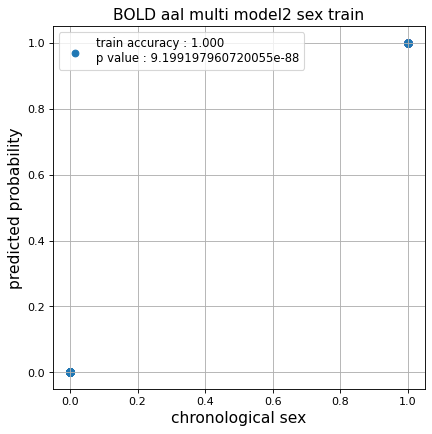

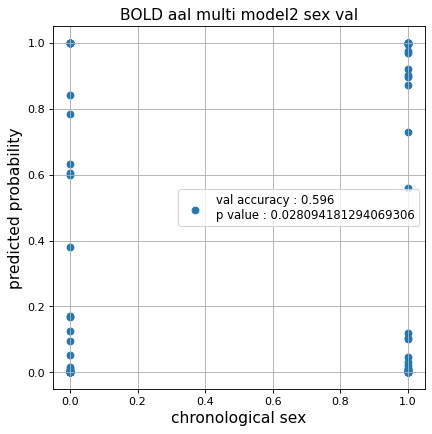

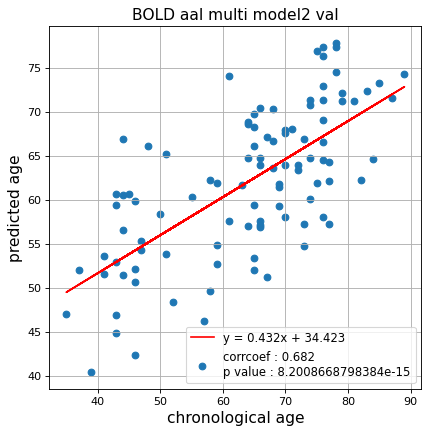

切片: 34.42301062547954
傾き: 0.43206528290086504
Kfold: 3 ::: epoch: 100, loss: 0.16140392078803137, val loss: 1.2143394649028778
Kfold: 3 ::: epoch: 200, loss: 0.033226652357440725, val loss: 1.0594651848077774
Kfold: 3 ::: epoch: 300, loss: 0.021507457185250062, val loss: 0.9612003415822983
Kfold: 3 ::: epoch: 400, loss: 0.014032575874947585, val loss: 0.8754123002290726
Kfold: 3 ::: epoch: 500, loss: 0.010465800941277009, val loss: 0.8859946876764297
Kfold: 3 ::: epoch: 600, loss: 0.010483965349312011, val loss: 0.830624058842659
Kfold: 3 ::: epoch: 700, loss: 0.008598124536757287, val loss: 0.8283315002918243
Kfold: 3 ::: epoch: 800, loss: 0.010037063155323267, val loss: 0.808465838432312
Kfold: 3 ::: epoch: 900, loss: 0.0074236167308229664, val loss: 0.7952255457639694
Kfold: 3 ::: epoch: 1000, loss: 0.005821438434605415, val loss: 0.8054859489202499
save_epochs:876
best val loss:0.7621119320392609


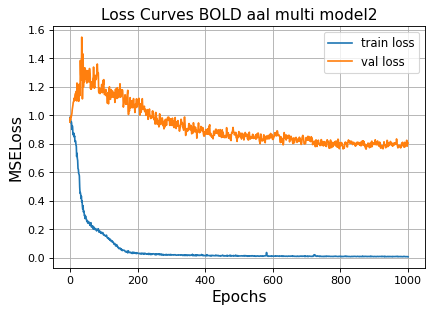

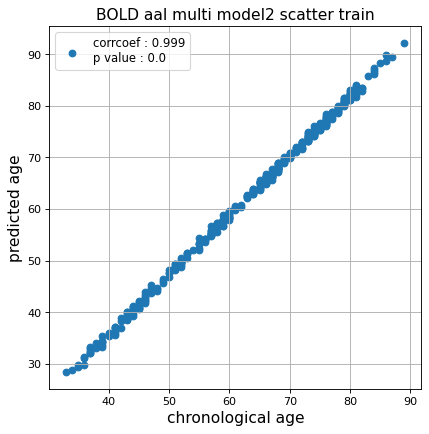

r^2 train data:  0.9728345624504262


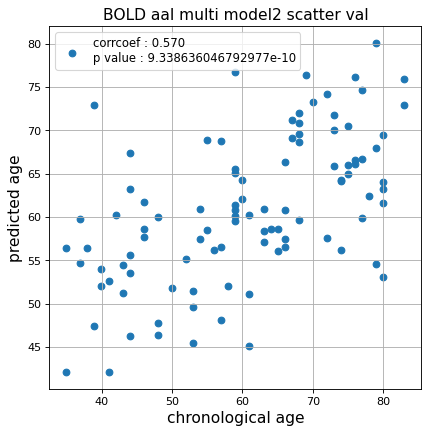

r^2 val data:  0.3209680183273147


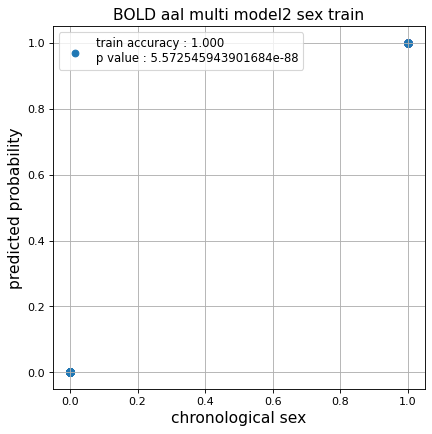

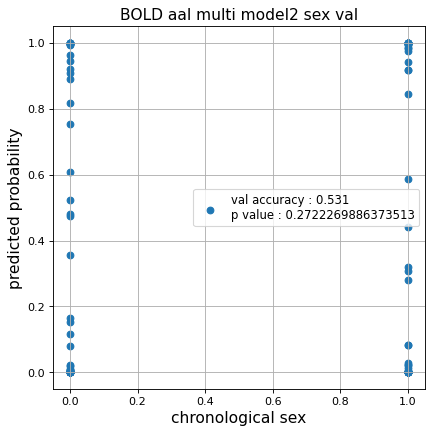

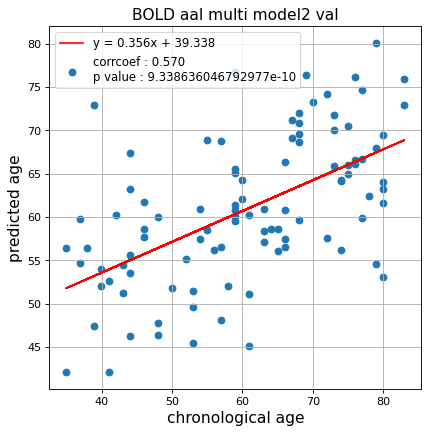

切片: 39.337806369808014
傾き: 0.35572413507665773
Kfold: 4 ::: epoch: 100, loss: 0.14671133573238665, val loss: 1.2837953716516495
Kfold: 4 ::: epoch: 200, loss: 0.025925546669616148, val loss: 1.22421233355999
Kfold: 4 ::: epoch: 300, loss: 0.018917324021458626, val loss: 1.3214877545833588
Kfold: 4 ::: epoch: 400, loss: 0.015098298684908794, val loss: 1.1745715290307999
Kfold: 4 ::: epoch: 500, loss: 0.01282113016797946, val loss: 1.1663633584976196
Kfold: 4 ::: epoch: 600, loss: 0.010967784453756534, val loss: 1.1242003589868546
Kfold: 4 ::: epoch: 700, loss: 0.010327360091301111, val loss: 1.103720486164093
Kfold: 4 ::: epoch: 800, loss: 0.009181366875194587, val loss: 1.100695788860321
Kfold: 4 ::: epoch: 900, loss: 0.007077766797290399, val loss: 1.0705169290304184
Kfold: 4 ::: epoch: 1000, loss: 0.0076775416875114804, val loss: 1.060925543308258
save_epochs:929
best val loss:1.0373624116182327


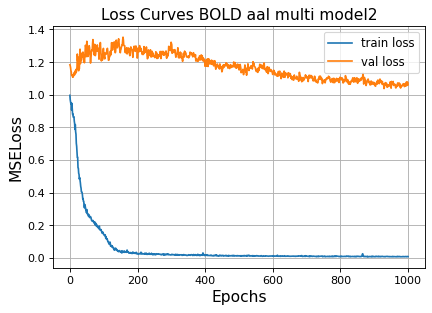

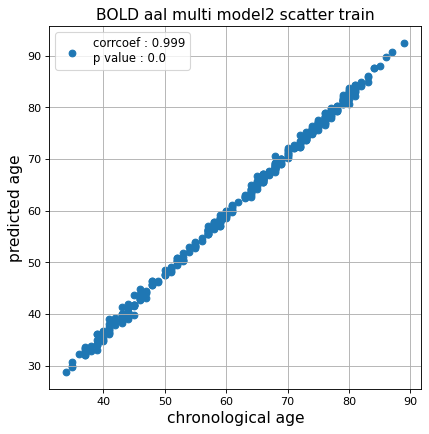

r^2 train data:  0.9723842971339282


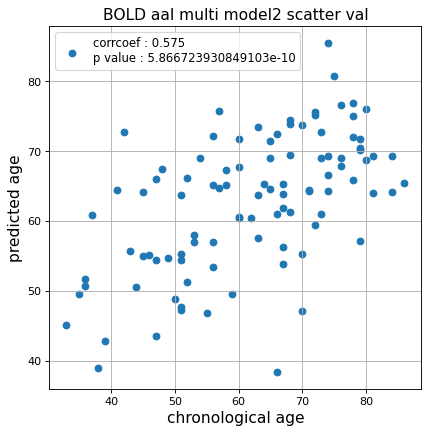

r^2 val data:  0.30554329791473134


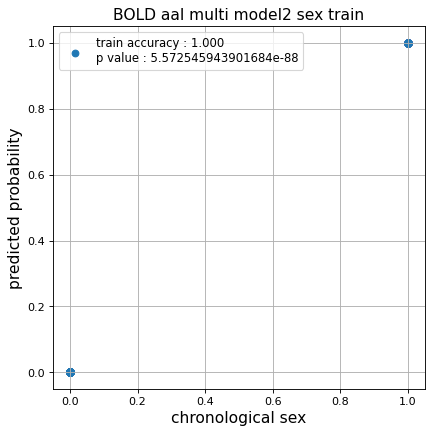

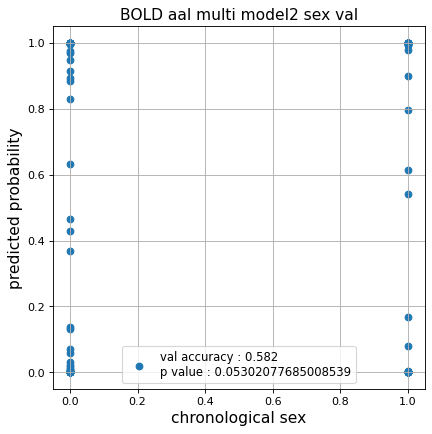

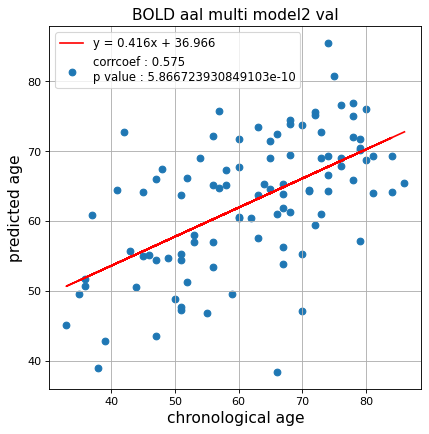

切片: 36.96592476694808
傾き: 0.4162404193617905
Kfold: 5 ::: epoch: 100, loss: 0.1770200775219844, val loss: 0.9767603874206543
Kfold: 5 ::: epoch: 200, loss: 0.0325523352680298, val loss: 0.9292763769626617
Kfold: 5 ::: epoch: 300, loss: 0.018863362116882436, val loss: 0.896695464849472
Kfold: 5 ::: epoch: 400, loss: 0.01573883441205208, val loss: 0.8940612971782684
Kfold: 5 ::: epoch: 500, loss: 0.013245901415267816, val loss: 0.8875653743743896
Kfold: 5 ::: epoch: 600, loss: 0.012058734965439025, val loss: 0.8971680998802185
Kfold: 5 ::: epoch: 700, loss: 0.009277185747543206, val loss: 0.8690432012081146
Kfold: 5 ::: epoch: 800, loss: 0.007972699804947926, val loss: 0.8918216675519943
Kfold: 5 ::: epoch: 900, loss: 0.007043482019351079, val loss: 0.900959387421608
Kfold: 5 ::: epoch: 1000, loss: 0.007490536466670724, val loss: 0.8996004611253738
save_epochs:753
best val loss:0.8441284149885178


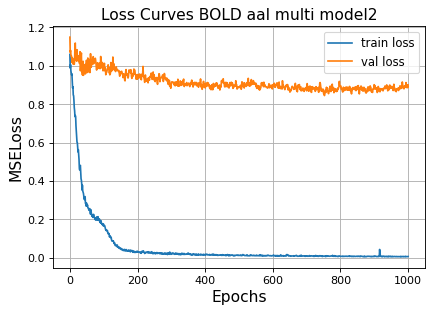

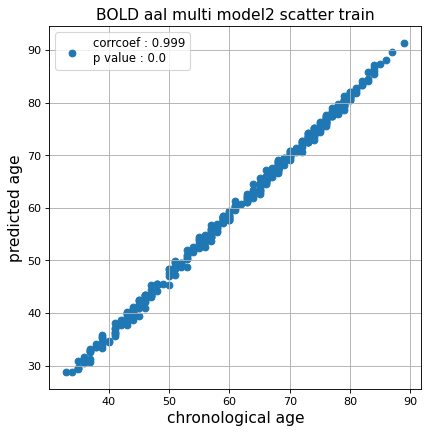

r^2 train data:  0.9716705621386339


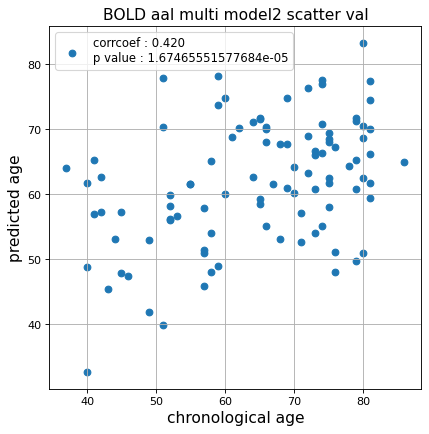

r^2 val data:  0.025934119122484223


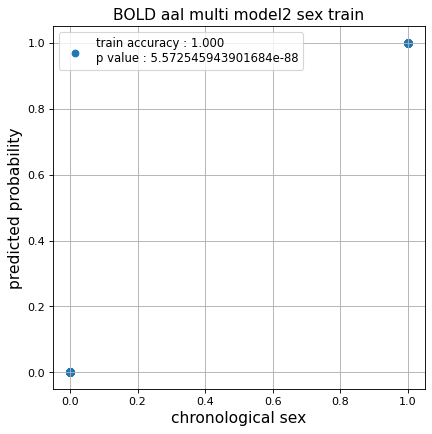

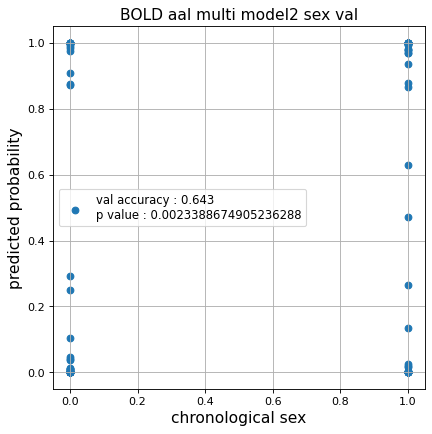

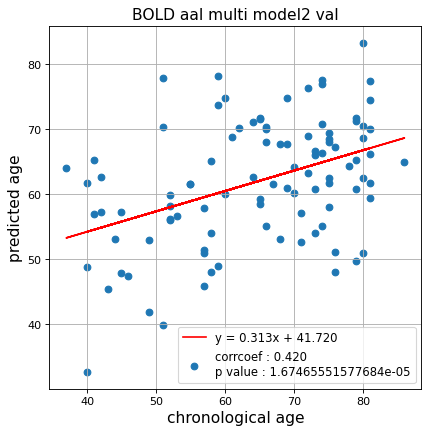

切片: 41.71958444534286
傾き: 0.31332493814738543
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.17286547674582556, val loss: 1.053437501192093
Kfold: 1 ::: epoch: 200, loss: 0.03273192506570082, val loss: 0.9212015122175217
Kfold: 1 ::: epoch: 300, loss: 0.020464648206073504, val loss: 0.8339774906635284
Kfold: 1 ::: epoch: 400, loss: 0.016459749796642706, val loss: 0.8044327273964882
Kfold: 1 ::: epoch: 500, loss: 0.010802519077864977, val loss: 0.7716380953788757
Kfold: 1 ::: epoch: 600, loss: 0.009624331544798154, val loss: 0.7533925026655197
Kfold: 1 ::: epoch: 700, loss: 0.011227965247459136, val loss: 0.7303002774715424
Kfold: 1 ::: epoch: 800, loss: 0.008576000897357097, val loss: 0.7275646403431892
Kfold: 1 ::: epoch: 900, loss: 0.007749078186372152, val loss: 0.6965152472257614
Kfold: 1 ::: epoch: 1000, loss: 0.006812664429442241, val loss: 0.7024223580956459
save_epochs:926
best val loss:0.6864491403102875


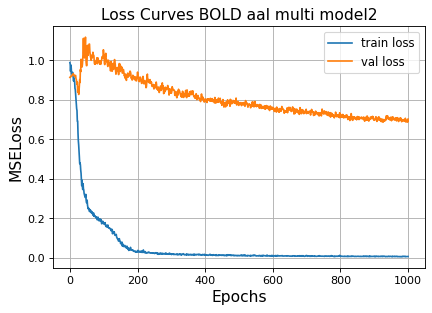

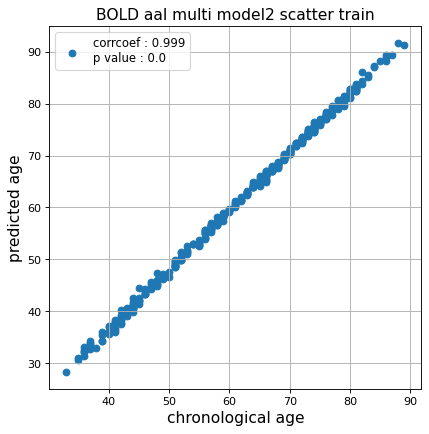

r^2 train data:  0.97900270018845


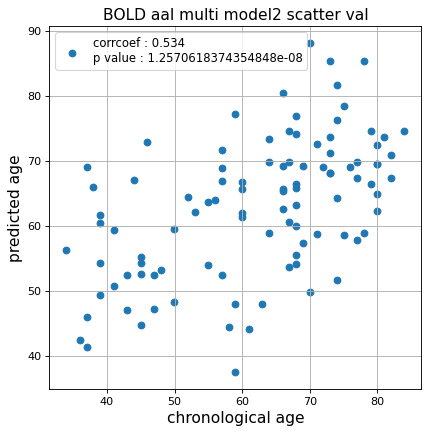

r^2 val data:  0.22404295481766479


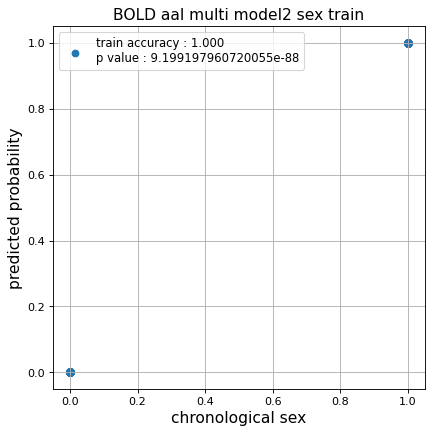

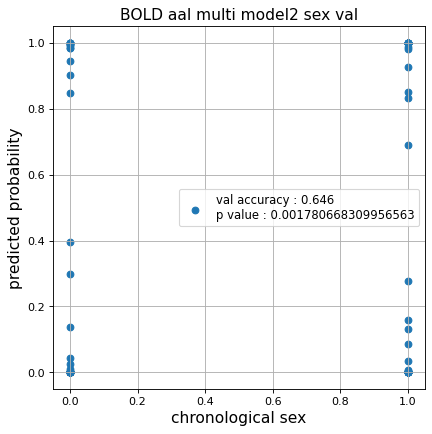

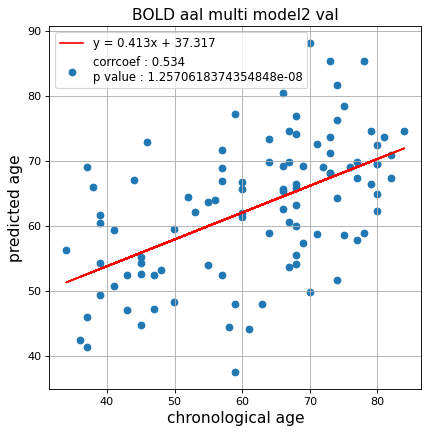

切片: 37.31689686048798
傾き: 0.41254112394990666
Kfold: 2 ::: epoch: 100, loss: 0.17987176317435044, val loss: 0.6822304502129555
Kfold: 2 ::: epoch: 200, loss: 0.032824210822582245, val loss: 0.6282939836382866
Kfold: 2 ::: epoch: 300, loss: 0.01879166016498437, val loss: 0.6175917237997055
Kfold: 2 ::: epoch: 400, loss: 0.014443402823347311, val loss: 0.6021072119474411
Kfold: 2 ::: epoch: 500, loss: 0.013727614441170143, val loss: 0.5783643499016762
Kfold: 2 ::: epoch: 600, loss: 0.01043015610999786, val loss: 0.5725690200924873
Kfold: 2 ::: epoch: 700, loss: 0.009639915795280384, val loss: 0.5672052428126335
Kfold: 2 ::: epoch: 800, loss: 0.008708138018846512, val loss: 0.5639323182404041
Kfold: 2 ::: epoch: 900, loss: 0.006977576851988068, val loss: 0.5605264082551003
Kfold: 2 ::: epoch: 1000, loss: 0.006747122065952191, val loss: 0.5550146326422691
save_epochs:967
best val loss:0.5476906653493643


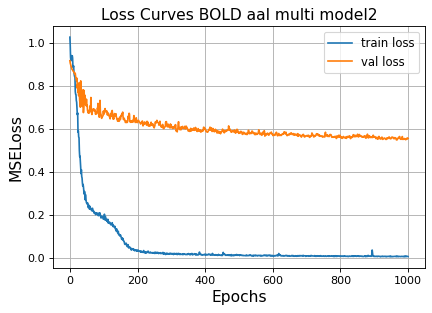

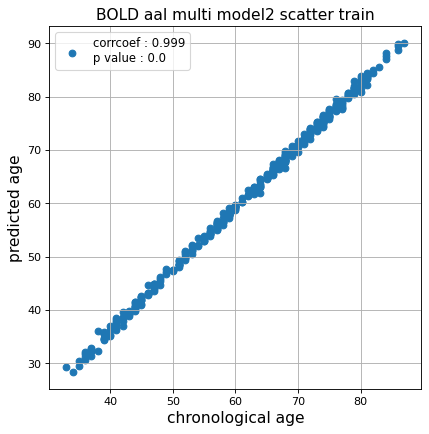

r^2 train data:  0.9724116998921463


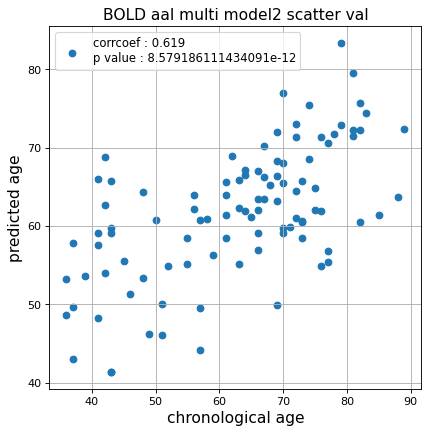

r^2 val data:  0.3788962669669391


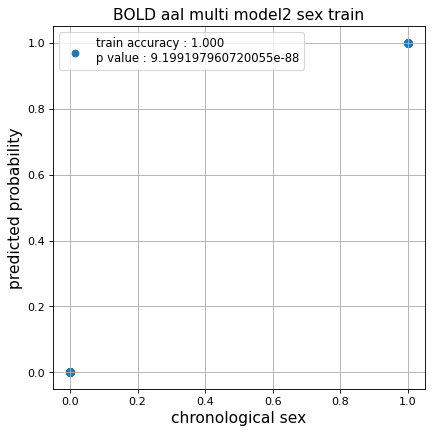

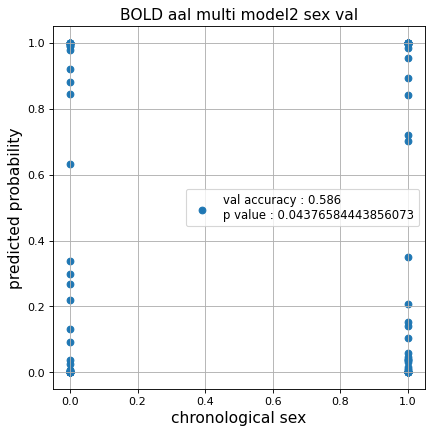

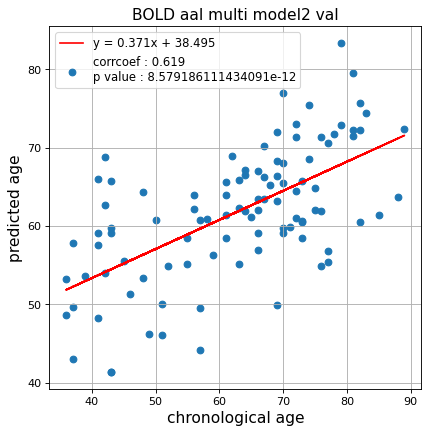

切片: 38.494963193336
傾き: 0.37147009031791284
Kfold: 3 ::: epoch: 100, loss: 0.17025745946627396, val loss: 1.0124033987522125
Kfold: 3 ::: epoch: 200, loss: 0.03261620981188921, val loss: 1.064347267150879
Kfold: 3 ::: epoch: 300, loss: 0.020986007239956122, val loss: 0.9765184968709946
Kfold: 3 ::: epoch: 400, loss: 0.01473621536905949, val loss: 0.9817865490913391
Kfold: 3 ::: epoch: 500, loss: 0.015591515514713068, val loss: 0.9083632230758667
Kfold: 3 ::: epoch: 600, loss: 0.011967891576484991, val loss: 0.9146940857172012
Kfold: 3 ::: epoch: 700, loss: 0.009559804860215921, val loss: 0.8947359174489975
Kfold: 3 ::: epoch: 800, loss: 0.010748312271271761, val loss: 0.8716771155595779
Kfold: 3 ::: epoch: 900, loss: 0.009353807661682367, val loss: 0.8893423974514008
Kfold: 3 ::: epoch: 1000, loss: 0.006508829484048944, val loss: 0.8415726274251938
save_epochs:797
best val loss:0.8119924515485764


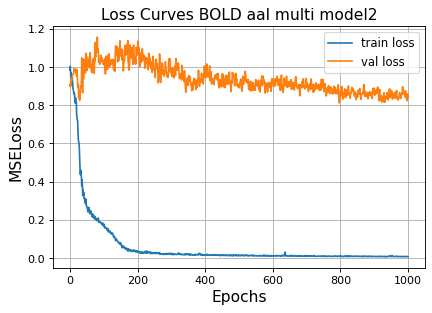

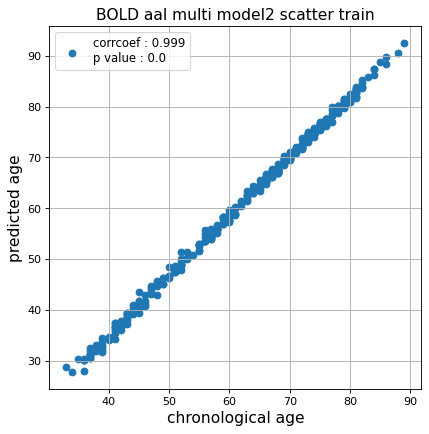

r^2 train data:  0.9621270783285596


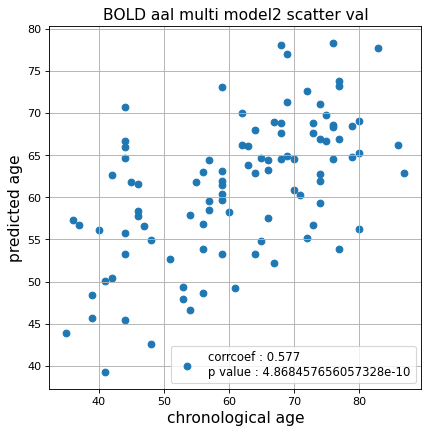

r^2 val data:  0.3307450652697749


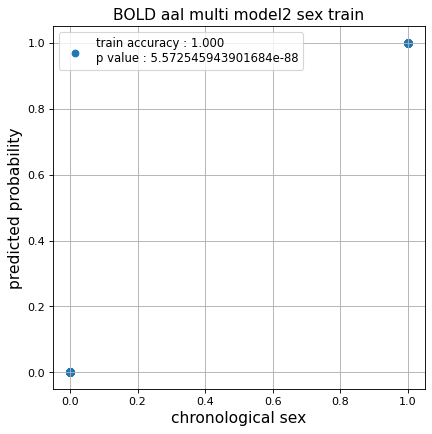

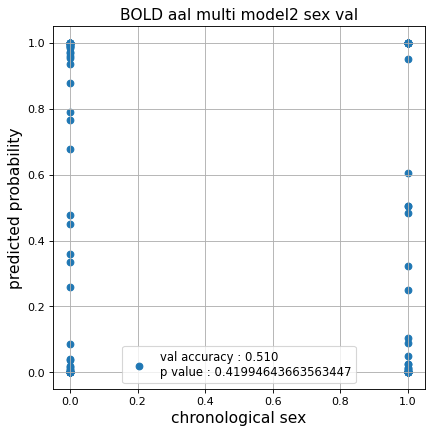

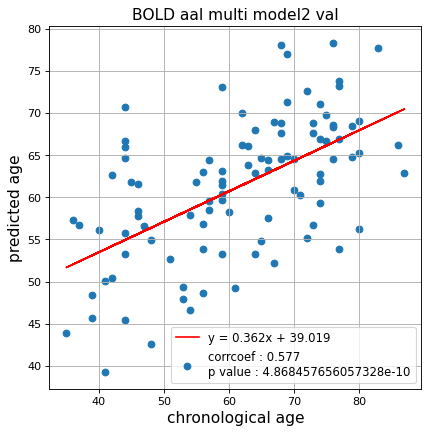

切片: 39.019214798699075
傾き: 0.36156228921311645
Kfold: 4 ::: epoch: 100, loss: 0.1607918498607782, val loss: 1.3173410296440125
Kfold: 4 ::: epoch: 200, loss: 0.02468874305486679, val loss: 1.2316679656505585
Kfold: 4 ::: epoch: 300, loss: 0.023073692447864093, val loss: 1.202666088938713
Kfold: 4 ::: epoch: 400, loss: 0.013247060446211925, val loss: 1.1448885649442673
Kfold: 4 ::: epoch: 500, loss: 0.012487720268277021, val loss: 1.1254962980747223
Kfold: 4 ::: epoch: 600, loss: 0.010935235123794813, val loss: 1.0387666672468185
Kfold: 4 ::: epoch: 700, loss: 0.009624476508738903, val loss: 1.0466062426567078
Kfold: 4 ::: epoch: 800, loss: 0.010550506986104526, val loss: 1.0100444704294205
Kfold: 4 ::: epoch: 900, loss: 0.008076303817618351, val loss: 1.0345623642206192
Kfold: 4 ::: epoch: 1000, loss: 0.007949261961934658, val loss: 0.9884322732686996
save_epochs:994
best val loss:0.9722832292318344


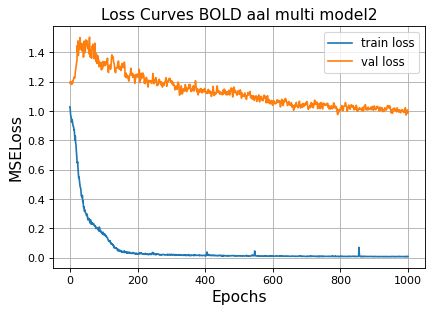

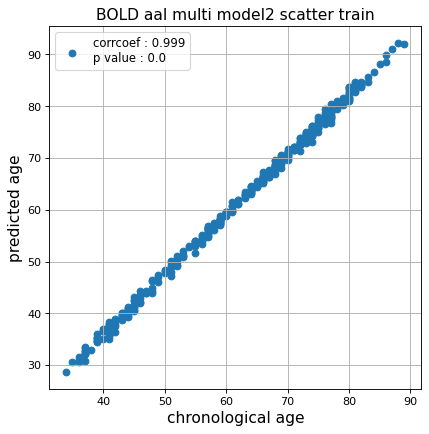

r^2 train data:  0.9718990200518017


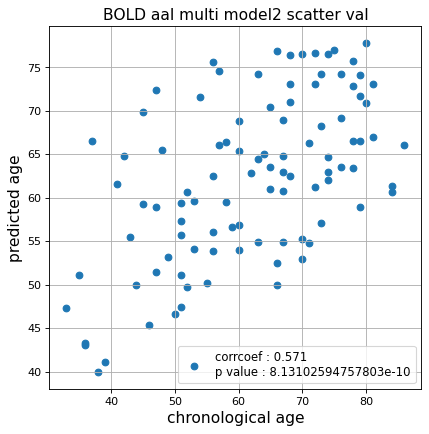

r^2 val data:  0.30883533965949583


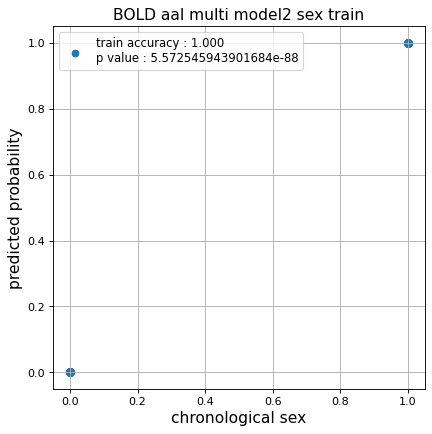

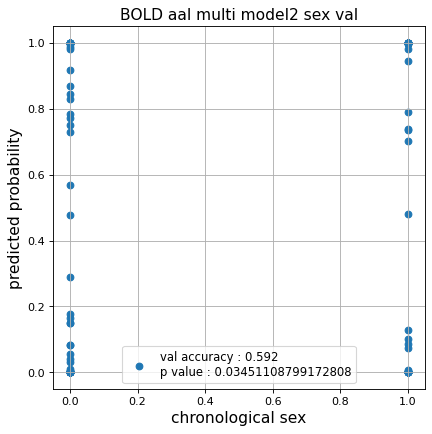

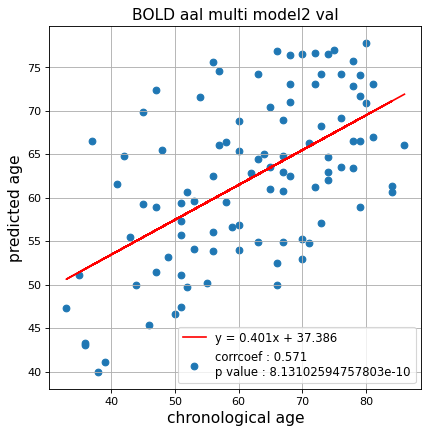

切片: 37.38618638383282
傾き: 0.40116031830317356
Kfold: 5 ::: epoch: 100, loss: 0.17151435636557066, val loss: 0.8034963570535183
Kfold: 5 ::: epoch: 200, loss: 0.038661606753101714, val loss: 0.740677285939455
Kfold: 5 ::: epoch: 300, loss: 0.024596103037206028, val loss: 0.7383529730141163
Kfold: 5 ::: epoch: 400, loss: 0.019227439179443397, val loss: 0.6907016057521105
Kfold: 5 ::: epoch: 500, loss: 0.015351768654699508, val loss: 0.6939869849011302
Kfold: 5 ::: epoch: 600, loss: 0.01475098503466982, val loss: 0.6562578175216913
Kfold: 5 ::: epoch: 700, loss: 0.012267178354355006, val loss: 0.6712290365248919
Kfold: 5 ::: epoch: 800, loss: 0.008252581653113548, val loss: 0.6684556580148637
Kfold: 5 ::: epoch: 900, loss: 0.007462656626907678, val loss: 0.6460969354957342
Kfold: 5 ::: epoch: 1000, loss: 0.007433866795438986, val loss: 0.6580775496549904
save_epochs:825
best val loss:0.6321033854037523


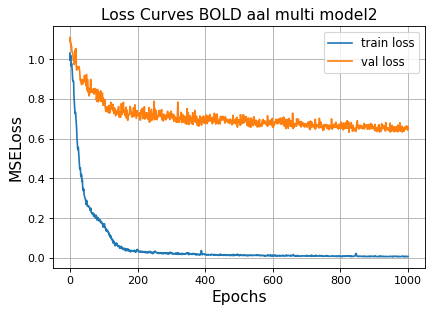

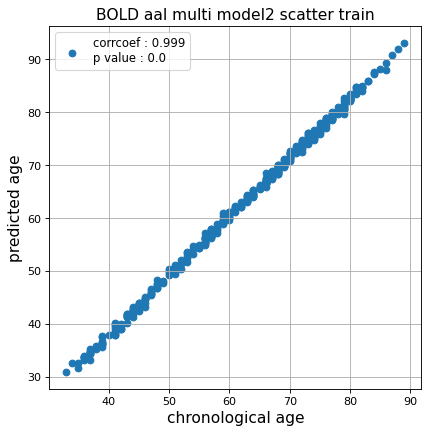

r^2 train data:  0.9829140857598575


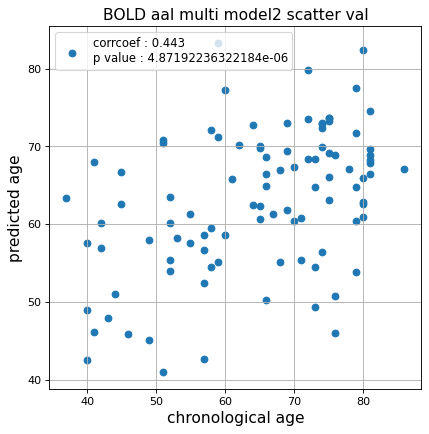

r^2 val data:  0.10451117572154567


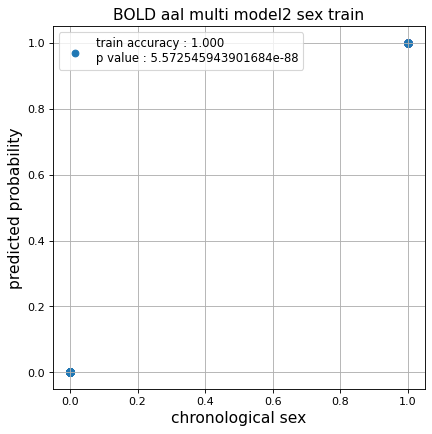

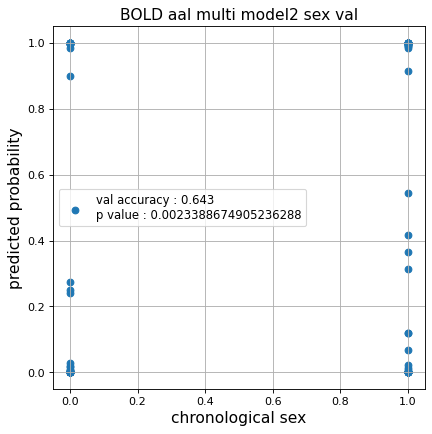

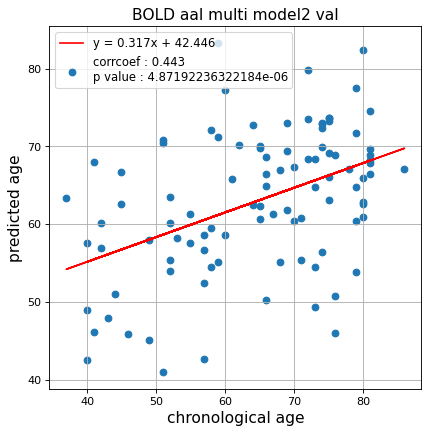

切片: 42.44569106012736
傾き: 0.317436210642148
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.17869951174809381, val loss: 0.7647699266672134
Kfold: 1 ::: epoch: 200, loss: 0.03184261488226744, val loss: 0.6677001044154167
Kfold: 1 ::: epoch: 300, loss: 0.019178158675248805, val loss: 0.6515812650322914
Kfold: 1 ::: epoch: 400, loss: 0.014703954569995403, val loss: 0.6064661592245102
Kfold: 1 ::: epoch: 500, loss: 0.010986256019140665, val loss: 0.6019186303019524
Kfold: 1 ::: epoch: 600, loss: 0.010770612575400334, val loss: 0.5756372660398483
Kfold: 1 ::: epoch: 700, loss: 0.008846654538781596, val loss: 0.5737462788820267
Kfold: 1 ::: epoch: 800, loss: 0.007867691465295278, val loss: 0.562999926507473
Kfold: 1 ::: epoch: 900, loss: 0.009484363648180779, val loss: 0.5412589013576508
Kfold: 1 ::: epoch: 1000, loss: 0.006656454231303472, val loss: 0.555521160364151
save_epochs:901
best val loss:0.529035247862339


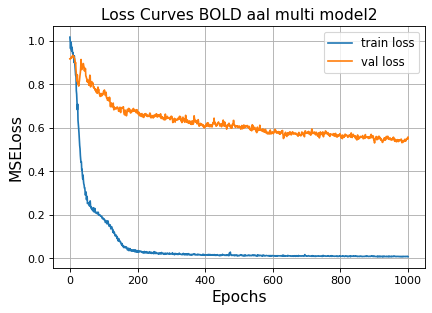

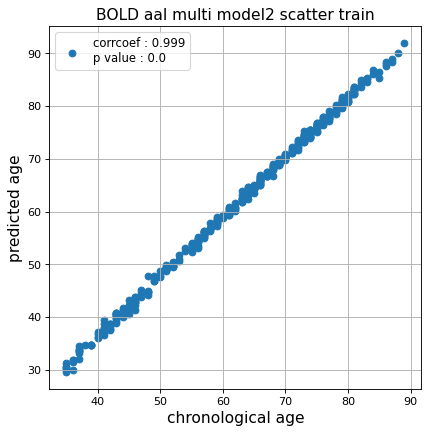

r^2 train data:  0.9797043679923478


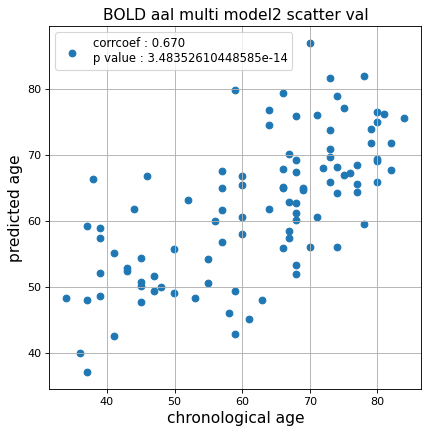

r^2 val data:  0.43853673327602927


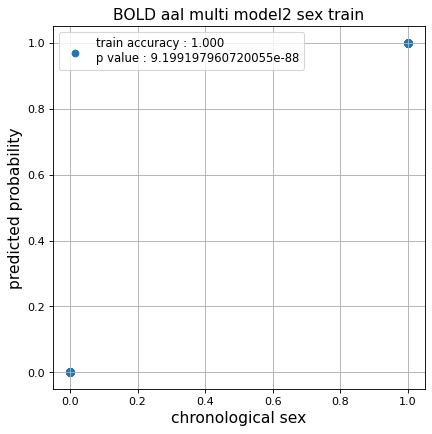

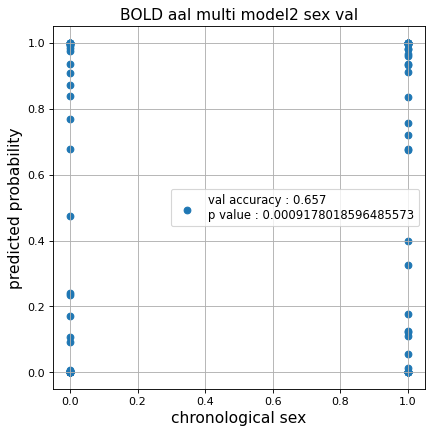

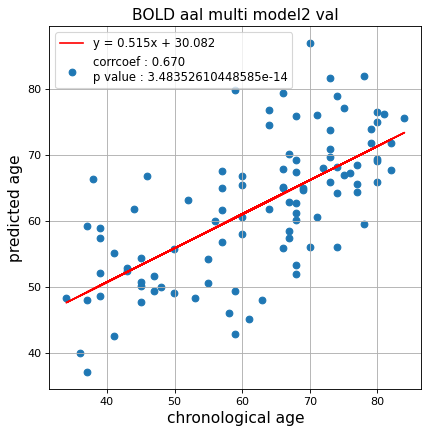

切片: 30.081674254450096
傾き: 0.5152556145336463
Kfold: 2 ::: epoch: 100, loss: 0.18188247084617615, val loss: 0.6843174323439598
Kfold: 2 ::: epoch: 200, loss: 0.035598681236688905, val loss: 0.6572622656822205
Kfold: 2 ::: epoch: 300, loss: 0.016211009082885888, val loss: 0.6667885258793831
Kfold: 2 ::: epoch: 400, loss: 0.015452829977640739, val loss: 0.6363718584179878
Kfold: 2 ::: epoch: 500, loss: 0.012206720331540475, val loss: 0.6485921293497086
Kfold: 2 ::: epoch: 600, loss: 0.013036458179927789, val loss: 0.6330873370170593
Kfold: 2 ::: epoch: 700, loss: 0.011410014668049721, val loss: 0.6118742004036903
Kfold: 2 ::: epoch: 800, loss: 0.009281702769490389, val loss: 0.6040928326547146
Kfold: 2 ::: epoch: 900, loss: 0.00837195786432578, val loss: 0.6058476828038692
Kfold: 2 ::: epoch: 1000, loss: 0.008011302194343163, val loss: 0.6022011339664459
save_epochs:988
best val loss:0.5878218710422516


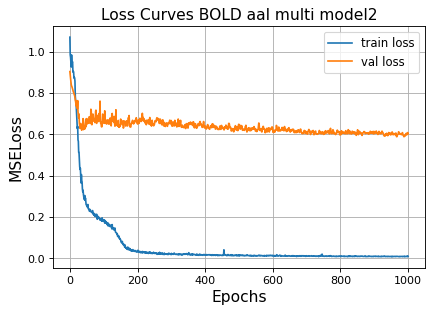

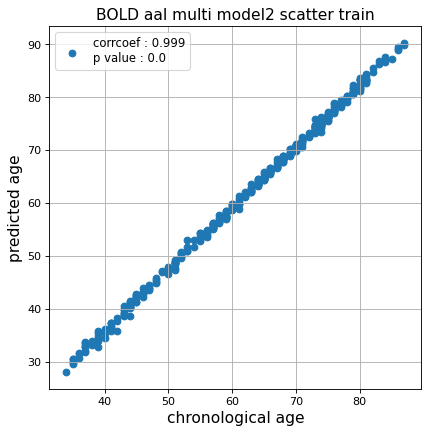

r^2 train data:  0.9721176943742641


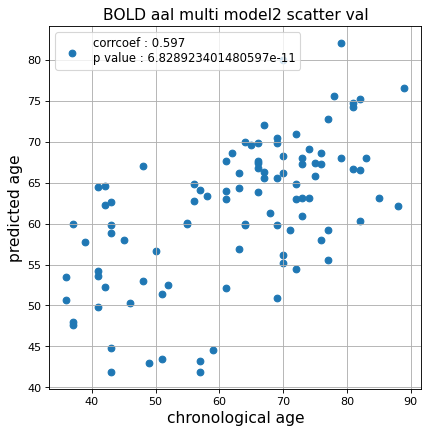

r^2 val data:  0.351694685224443


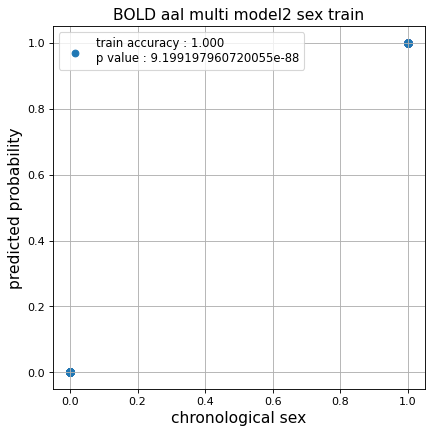

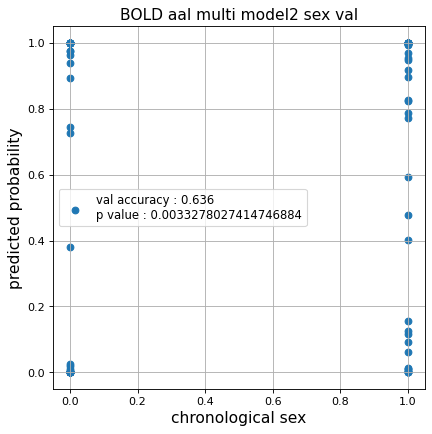

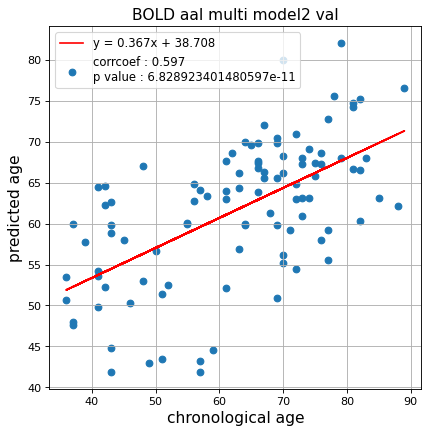

切片: 38.70756828915454
傾き: 0.36676501061560784
Kfold: 3 ::: epoch: 100, loss: 0.1738651142670558, val loss: 0.6099237501621246
Kfold: 3 ::: epoch: 200, loss: 0.04308260905628021, val loss: 0.6183208227157593
Kfold: 3 ::: epoch: 300, loss: 0.019895010269605197, val loss: 0.5827997326850891
Kfold: 3 ::: epoch: 400, loss: 0.01513297540637163, val loss: 0.5391711369156837
Kfold: 3 ::: epoch: 500, loss: 0.011933135513502818, val loss: 0.539678767323494
Kfold: 3 ::: epoch: 600, loss: 0.010999274153548937, val loss: 0.5176051929593086
Kfold: 3 ::: epoch: 700, loss: 0.009050596362123122, val loss: 0.4909677021205425
Kfold: 3 ::: epoch: 800, loss: 0.009101708133060198, val loss: 0.48327571898698807
Kfold: 3 ::: epoch: 900, loss: 0.008158731990708755, val loss: 0.47338607907295227
Kfold: 3 ::: epoch: 1000, loss: 0.007042950484901667, val loss: 0.4677663967013359
save_epochs:983
best val loss:0.4602973684668541


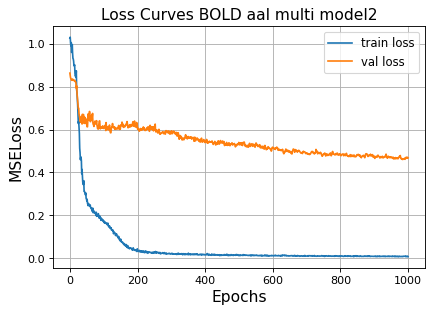

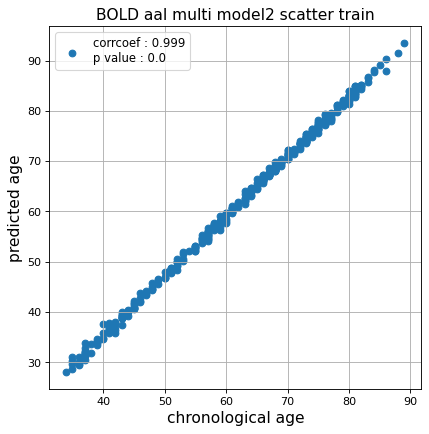

r^2 train data:  0.963209898398558


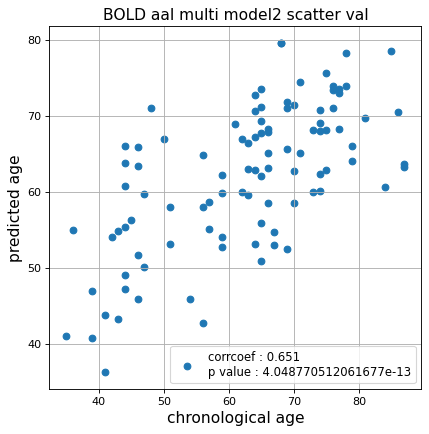

r^2 val data:  0.4174823455411496


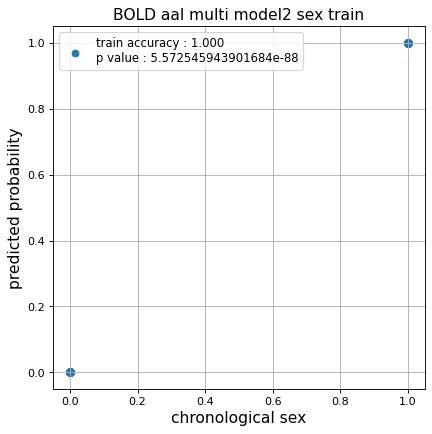

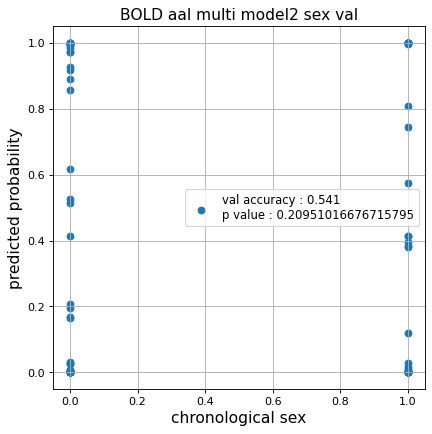

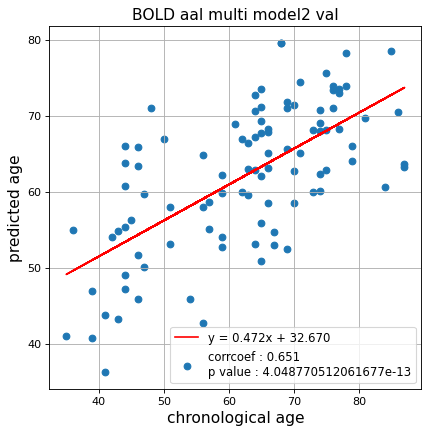

切片: 32.670109662949116
傾き: 0.4718257518795666
Kfold: 4 ::: epoch: 100, loss: 0.13427948321287447, val loss: 1.334571287035942
Kfold: 4 ::: epoch: 200, loss: 0.02420483658520075, val loss: 1.1842577308416367
Kfold: 4 ::: epoch: 300, loss: 0.019782534012427695, val loss: 1.1244399547576904
Kfold: 4 ::: epoch: 400, loss: 0.013973115907552151, val loss: 1.0371124893426895
Kfold: 4 ::: epoch: 500, loss: 0.013064408603195962, val loss: 0.9960495233535767
Kfold: 4 ::: epoch: 600, loss: 0.03308580088644074, val loss: 0.9407056570053101
Kfold: 4 ::: epoch: 700, loss: 0.009075621178803535, val loss: 0.9490377381443977
Kfold: 4 ::: epoch: 800, loss: 0.009768403314340573, val loss: 0.9056200236082077
Kfold: 4 ::: epoch: 900, loss: 0.010226133530243086, val loss: 0.9771143943071365
Kfold: 4 ::: epoch: 1000, loss: 0.0077658606191667225, val loss: 0.9071944504976273
save_epochs:994
best val loss:0.8850923627614975


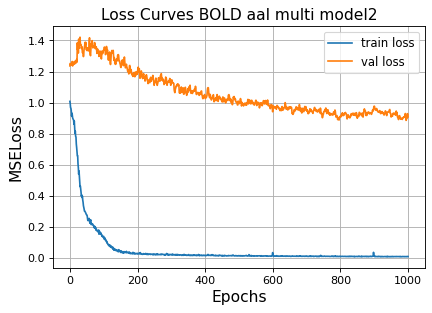

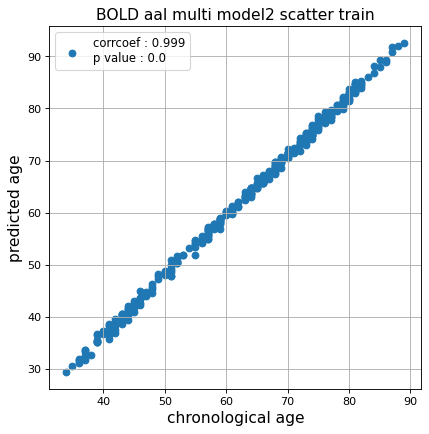

r^2 train data:  0.9746607433709439


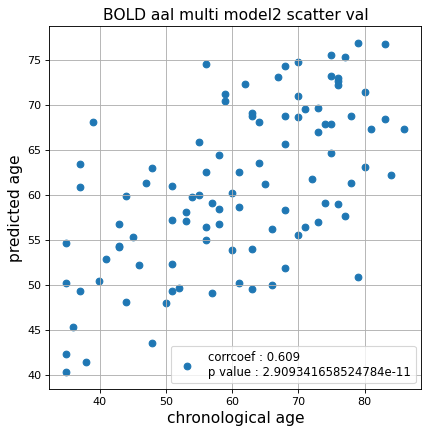

r^2 val data:  0.36980676801473833


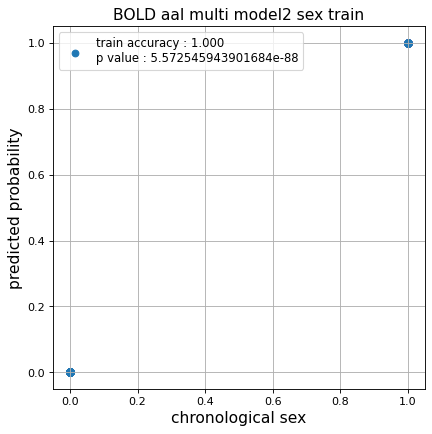

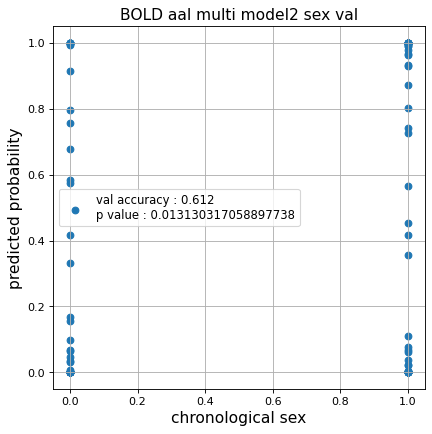

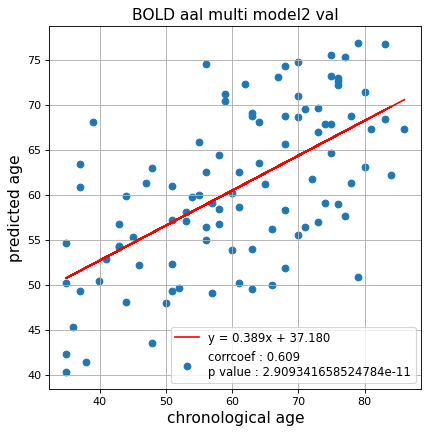

切片: 37.1795966565355
傾き: 0.3886645536313562
Kfold: 5 ::: epoch: 100, loss: 0.1601979835675313, val loss: 0.8646114990115166
Kfold: 5 ::: epoch: 200, loss: 0.029175396005694684, val loss: 0.7924824208021164
Kfold: 5 ::: epoch: 300, loss: 0.022483342613738317, val loss: 0.7692916616797447
Kfold: 5 ::: epoch: 400, loss: 0.016919519967184618, val loss: 0.7460481226444244
Kfold: 5 ::: epoch: 500, loss: 0.0148006805147116, val loss: 0.7466621547937393
Kfold: 5 ::: epoch: 600, loss: 0.011697668797121598, val loss: 0.727790929377079
Kfold: 5 ::: epoch: 700, loss: 0.010014630710849395, val loss: 0.7340265512466431
Kfold: 5 ::: epoch: 800, loss: 0.007482910242218237, val loss: 0.7320921421051025
Kfold: 5 ::: epoch: 900, loss: 0.008606242696539713, val loss: 0.7309755906462669
Kfold: 5 ::: epoch: 1000, loss: 0.008134699319131099, val loss: 0.7319467812776566
save_epochs:554
best val loss:0.7062438726425171


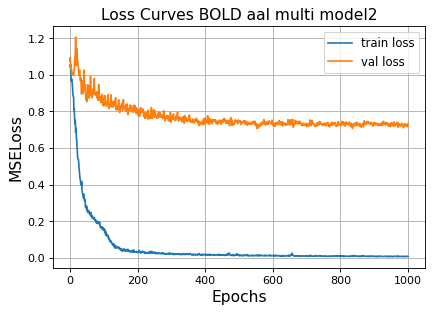

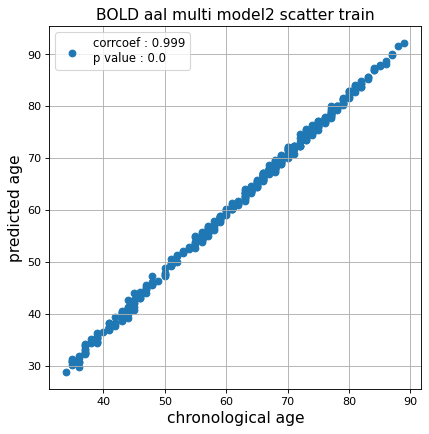

r^2 train data:  0.9771946326907333


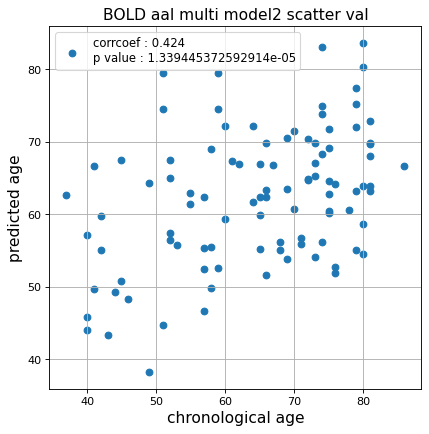

r^2 val data:  0.058594442335344055


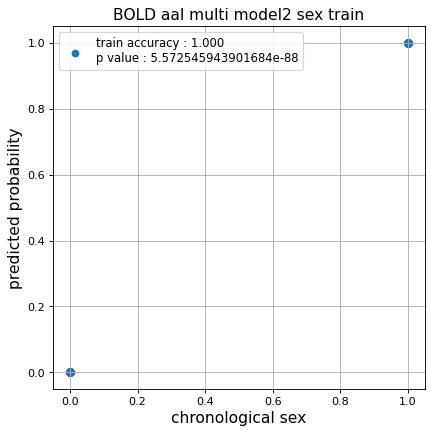

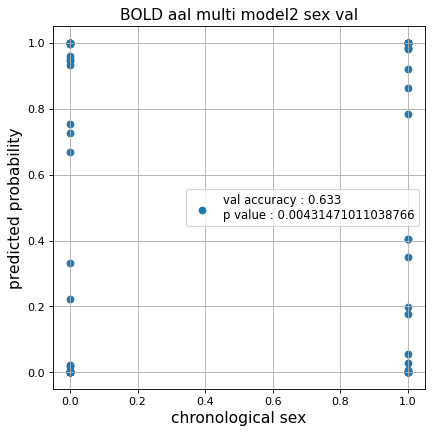

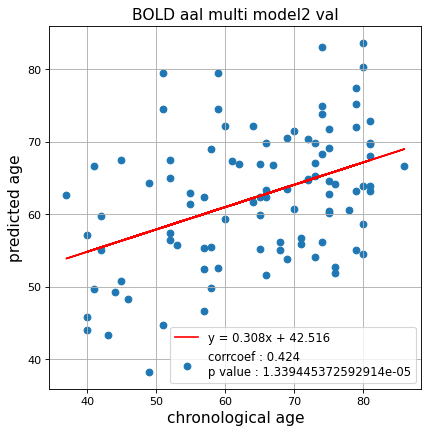

切片: 42.51560755633653
傾き: 0.30792905285138195
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.1803371275846775, val loss: 0.8127997070550919
Kfold: 1 ::: epoch: 200, loss: 0.03095019322175246, val loss: 0.7055551409721375
Kfold: 1 ::: epoch: 300, loss: 0.018379915075806472, val loss: 0.6812173575162888
Kfold: 1 ::: epoch: 400, loss: 0.016846506068339713, val loss: 0.6607480198144913
Kfold: 1 ::: epoch: 500, loss: 0.01202197215304925, val loss: 0.6391017884016037
Kfold: 1 ::: epoch: 600, loss: 0.01010991521896078, val loss: 0.6261444687843323
Kfold: 1 ::: epoch: 700, loss: 0.008820350783375593, val loss: 0.6272228807210922
Kfold: 1 ::: epoch: 800, loss: 0.008049971244942684, val loss: 0.612241804599762
Kfold: 1 ::: epoch: 900, loss: 0.008361202521392932, val loss: 0.6191481351852417
Kfold: 1 ::: epoch: 1000, loss: 0.006767197261349513, val loss: 0.6128198802471161
save_epochs:982
best val loss:0.591224417090416


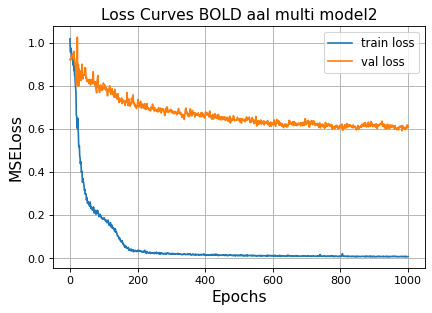

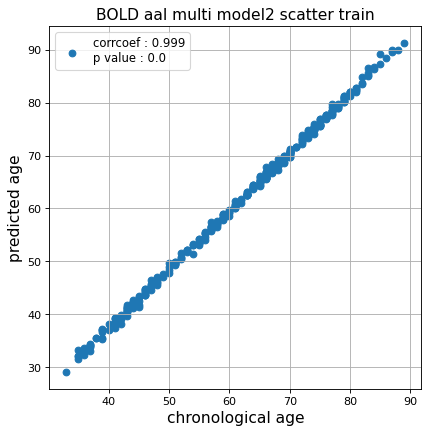

r^2 train data:  0.9870397767835802


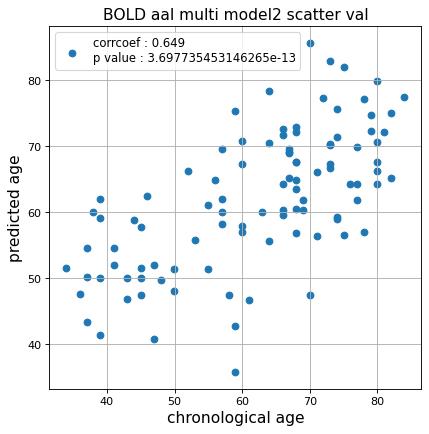

r^2 val data:  0.40958976238667877


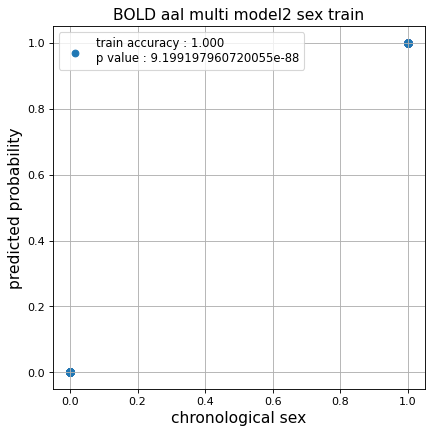

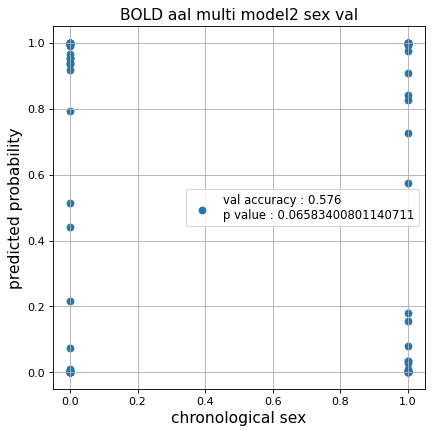

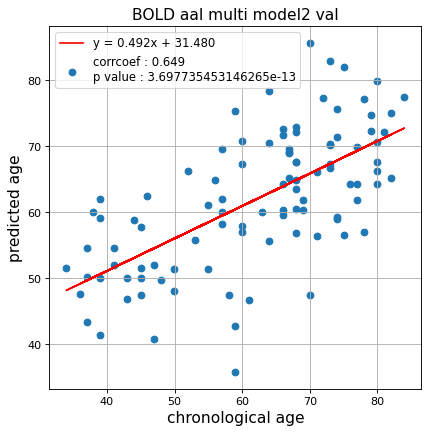

切片: 31.48030258643641
傾き: 0.49153091331011645
Kfold: 2 ::: epoch: 100, loss: 0.20304592526876009, val loss: 0.6849739998579025
Kfold: 2 ::: epoch: 200, loss: 0.040337119824611224, val loss: 0.6496851220726967
Kfold: 2 ::: epoch: 300, loss: 0.018819438007015448, val loss: 0.6437949389219284
Kfold: 2 ::: epoch: 400, loss: 0.014166504431229372, val loss: 0.6311492472887039
Kfold: 2 ::: epoch: 500, loss: 0.009957139774297293, val loss: 0.6189588084816933
Kfold: 2 ::: epoch: 600, loss: 0.011580030290553203, val loss: 0.5872791334986687
Kfold: 2 ::: epoch: 700, loss: 0.009989480631282696, val loss: 0.5901286751031876
Kfold: 2 ::: epoch: 800, loss: 0.007727895648433612, val loss: 0.5734491944313049
Kfold: 2 ::: epoch: 900, loss: 0.009150071606899682, val loss: 0.5845820754766464
Kfold: 2 ::: epoch: 1000, loss: 0.006921804474236874, val loss: 0.5553312115371227
save_epochs:985
best val loss:0.5532878749072552


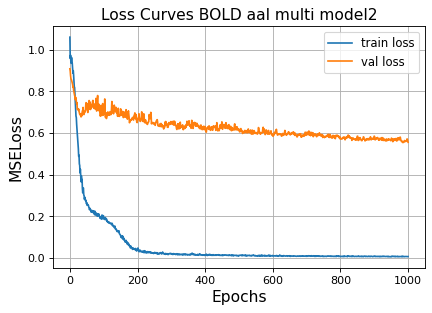

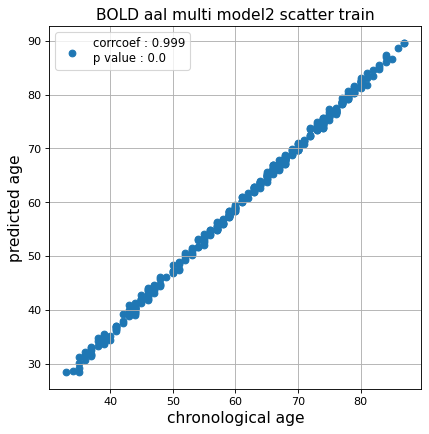

r^2 train data:  0.9716901114292618


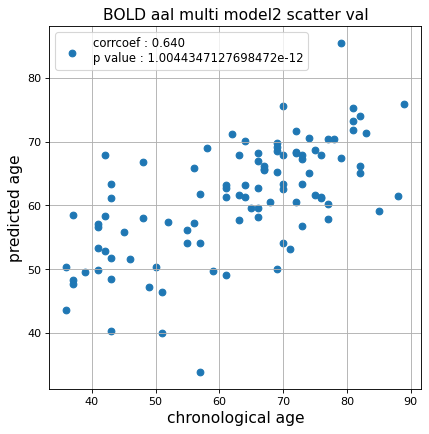

r^2 val data:  0.3963252520175786


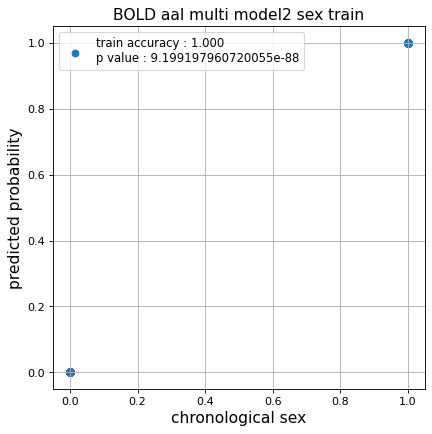

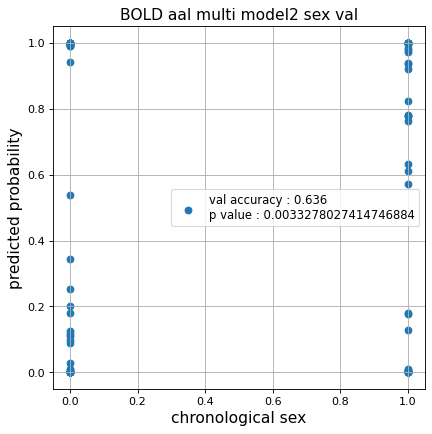

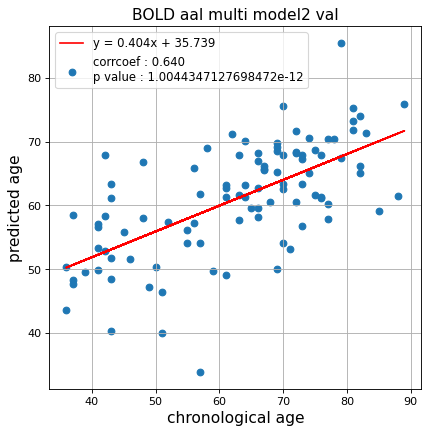

切片: 35.73933661569468
傾き: 0.4038374276393959
Kfold: 3 ::: epoch: 100, loss: 0.17324562943898714, val loss: 0.6027647331357002
Kfold: 3 ::: epoch: 200, loss: 0.039766454782623514, val loss: 0.5348115339875221
Kfold: 3 ::: epoch: 300, loss: 0.019632386043667793, val loss: 0.4573534931987524
Kfold: 3 ::: epoch: 400, loss: 0.014776483679620119, val loss: 0.4481010474264622
Kfold: 3 ::: epoch: 500, loss: 0.013298534215069734, val loss: 0.43935098499059677
Kfold: 3 ::: epoch: 600, loss: 0.01090747483361226, val loss: 0.4419339671730995
Kfold: 3 ::: epoch: 700, loss: 0.00882424869073125, val loss: 0.4268222972750664
Kfold: 3 ::: epoch: 800, loss: 0.009624280429516848, val loss: 0.41606042347848415
Kfold: 3 ::: epoch: 900, loss: 0.008383909813486613, val loss: 0.4153314605355263
Kfold: 3 ::: epoch: 1000, loss: 0.007359235475842769, val loss: 0.4279598742723465
save_epochs:826
best val loss:0.40557615272700787


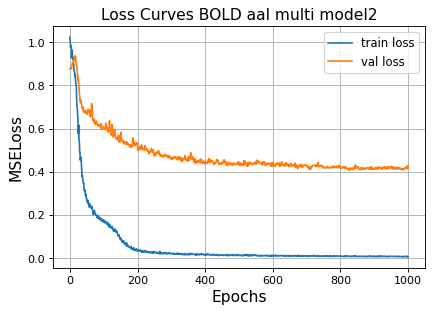

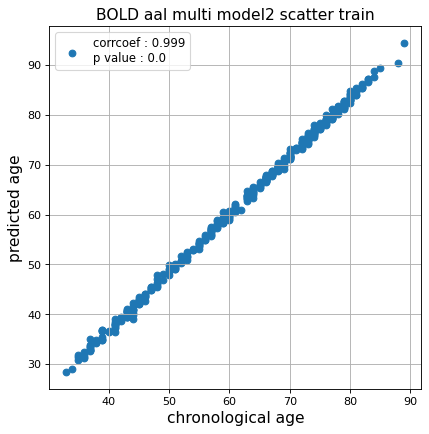

r^2 train data:  0.9696162789387007


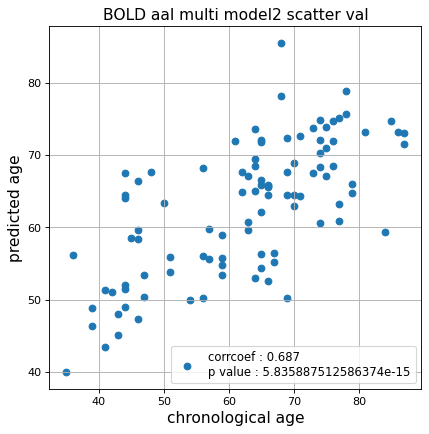

r^2 val data:  0.4711025332393016


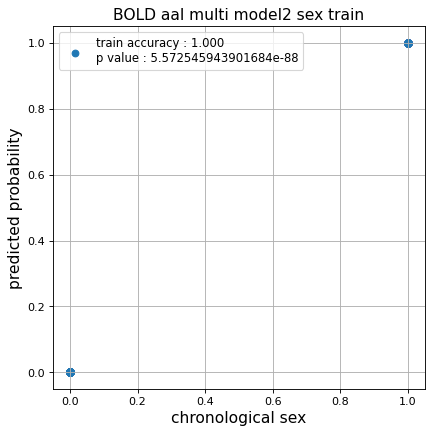

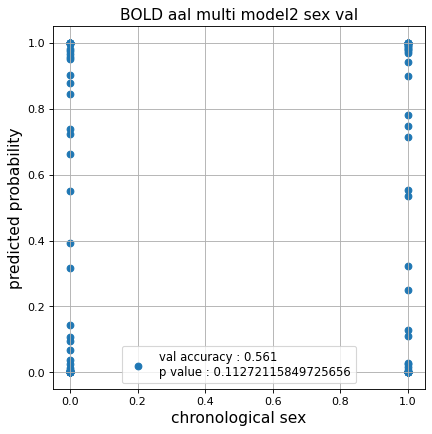

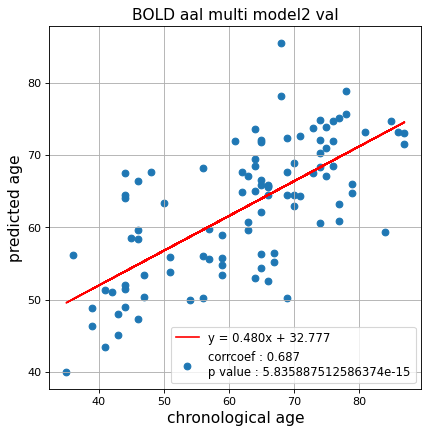

切片: 32.776730978065686
傾き: 0.47961183192834117
Kfold: 4 ::: epoch: 100, loss: 0.1440038073521394, val loss: 0.9407505989074707
Kfold: 4 ::: epoch: 200, loss: 0.02680863654957368, val loss: 0.8054307252168655
Kfold: 4 ::: epoch: 300, loss: 0.02106899245140644, val loss: 0.788192480802536
Kfold: 4 ::: epoch: 400, loss: 0.01339230235092915, val loss: 0.7561874091625214
Kfold: 4 ::: epoch: 500, loss: 0.012090604501561476, val loss: 0.6999553292989731
Kfold: 4 ::: epoch: 600, loss: 0.01039212175573294, val loss: 0.6863646358251572
Kfold: 4 ::: epoch: 700, loss: 0.009527644178328605, val loss: 0.6611688733100891
Kfold: 4 ::: epoch: 800, loss: 0.009683735023897428, val loss: 0.6380236148834229
Kfold: 4 ::: epoch: 900, loss: 0.007447439532440443, val loss: 0.6150313168764114
Kfold: 4 ::: epoch: 1000, loss: 0.006636618099247034, val loss: 0.6090498566627502
save_epochs:981
best val loss:0.6015993058681488


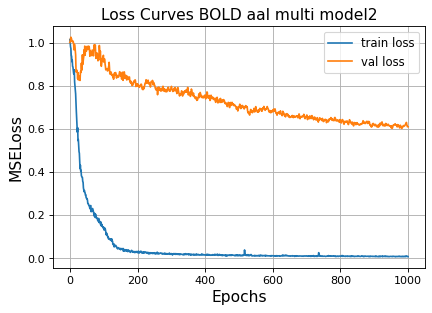

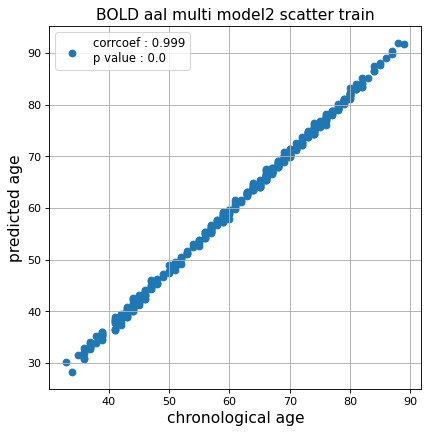

r^2 train data:  0.9791463808934511


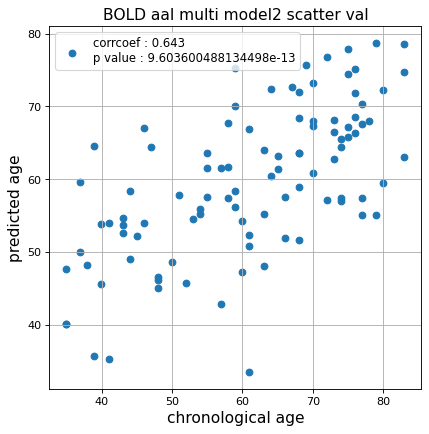

r^2 val data:  0.38982108625450795


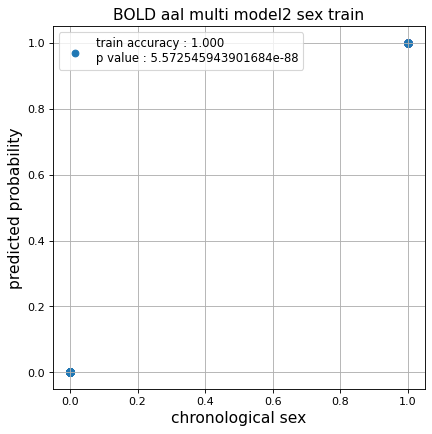

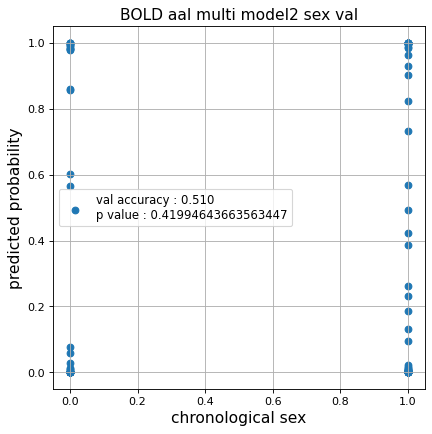

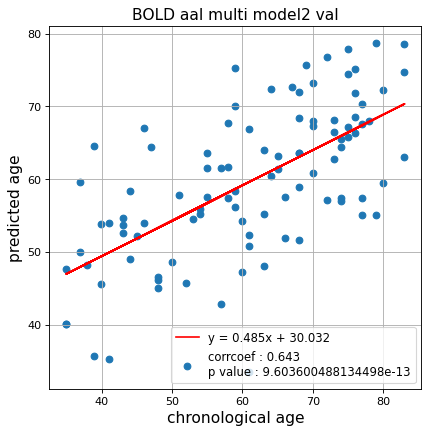

切片: 30.03154394001626
傾き: 0.48549741082686515
Kfold: 5 ::: epoch: 100, loss: 0.16480347628776842, val loss: 1.5140156894922256
Kfold: 5 ::: epoch: 200, loss: 0.029905869983709775, val loss: 1.273060366511345
Kfold: 5 ::: epoch: 300, loss: 0.03387594423615015, val loss: 1.1672625839710236
Kfold: 5 ::: epoch: 400, loss: 0.016573723907080982, val loss: 1.1939993798732758
Kfold: 5 ::: epoch: 500, loss: 0.01633348108197634, val loss: 1.1356161832809448
Kfold: 5 ::: epoch: 600, loss: 0.01141591090708971, val loss: 1.0937068164348602
Kfold: 5 ::: epoch: 700, loss: 0.009538257494568825, val loss: 1.0573396980762482
Kfold: 5 ::: epoch: 800, loss: 0.008030806506912295, val loss: 1.0317646265029907
Kfold: 5 ::: epoch: 900, loss: 0.008665273610789042, val loss: 1.058345004916191
Kfold: 5 ::: epoch: 1000, loss: 0.00767784622999338, val loss: 1.0165454745292664
save_epochs:890
best val loss:0.9463677704334259


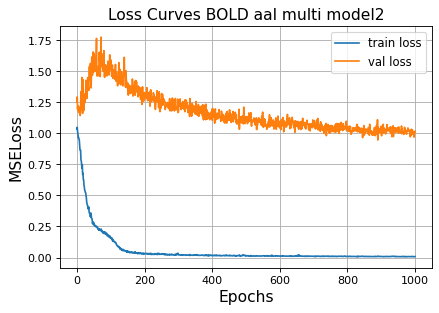

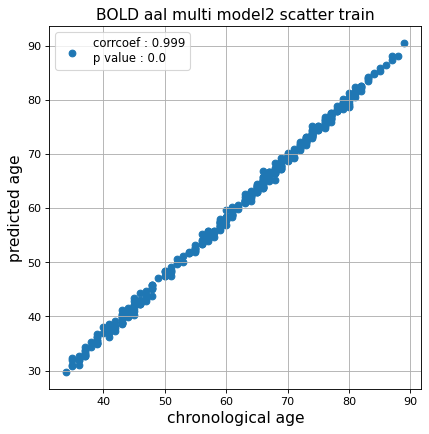

r^2 train data:  0.9769195851066109


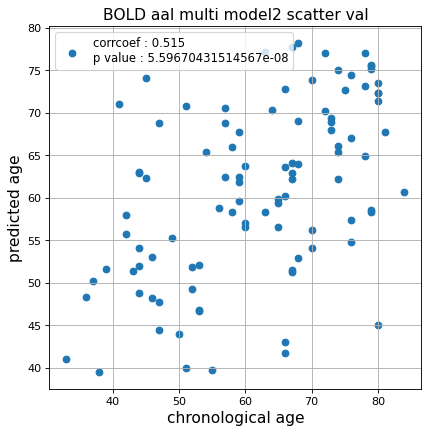

r^2 val data:  0.18916625879878934


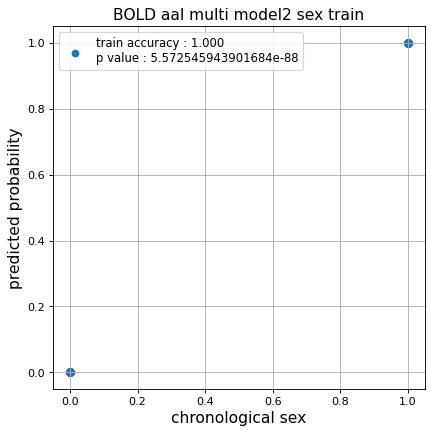

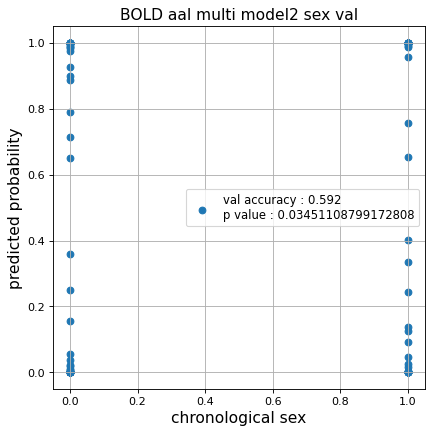

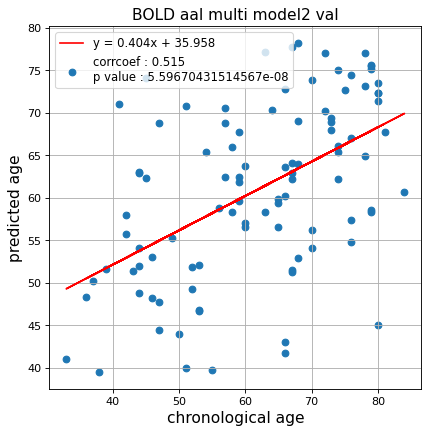

切片: 35.95824633734764
傾き: 0.4041990943724684
CPU times: user 1h 43min 33s, sys: 9min 10s, total: 1h 52min 43s
Wall time: 1h 52min 50s


In [15]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_all_2  = []
test_pred_aal_all_inverse_2  = []
test_label_aal_all_2 = []

test_idx_aal_all_2   = []
train_idx_aal_all_2  = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_inverse,test_label = train_model(data_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 128,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 128,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.1,
                                                           fc_drop = 0.1,
                                                           title = 'BOLD aal multi model2'
                                                          )
    
    test_pred_aal_all_2.append(test_pred)
    test_pred_aal_all_inverse_2.append(test_pred_inverse)
    test_label_aal_all_2.append(test_label)

    test_idx_aal_all_2.append(test_idx)
    train_idx_aal_all_2.append(train_idx)

### データ保存

In [16]:
np.savez('../02_data_analysis/temp/all_multi_aal_1',
         test_pred_aal_all_1,
         test_pred_aal_all_inverse_1,
         test_label_aal_all_1,
         test_idx_aal_all_1,
         train_idx_aal_all_1)
np.savez('../02_data_analysis/temp/all_multi_aal_2',
         test_pred_aal_all_2,
         test_pred_aal_all_inverse_2,
         test_label_aal_all_2,
         test_idx_aal_all_2,
         train_idx_aal_all_2)

### Data定義(dynamic FC)

In [17]:
%%time
df_dynamic_aal = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_aal.csv')
data_dynamic_aal = make_data(df_dynamic_aal)
print(data_dynamic_aal.shape)

(615, 123, 6670)
CPU times: user 3min 3s, sys: 5.7 s, total: 3min 9s
Wall time: 3min 10s


### Dynamic FC 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.036018491794283576, val loss: 0.5472303591668606
Kfold: 1 ::: epoch: 200, loss: 0.020204629462498885, val loss: 0.5157624371349812
Kfold: 1 ::: epoch: 300, loss: 0.013625037498199023, val loss: 0.5127200447022915
Kfold: 1 ::: epoch: 400, loss: 0.008976299279870896, val loss: 0.5026209093630314
Kfold: 1 ::: epoch: 500, loss: 0.006916642081565582, val loss: 0.497379332780838
Kfold: 1 ::: epoch: 600, loss: 0.006673280131788208, val loss: 0.4991428814828396
Kfold: 1 ::: epoch: 700, loss: 0.005267253754517207, val loss: 0.5226024203002453
save_epochs:480
best val loss:0.4771261550486088


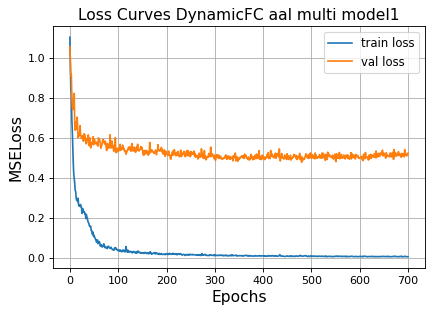

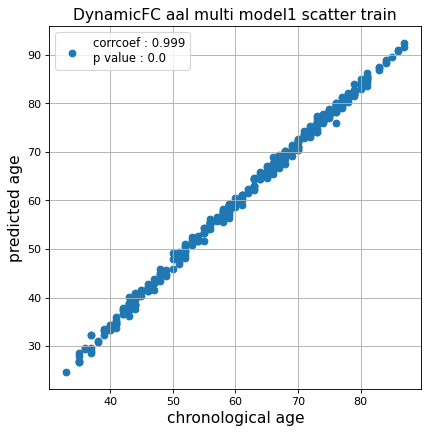

r^2 train data:  0.9398213042367595


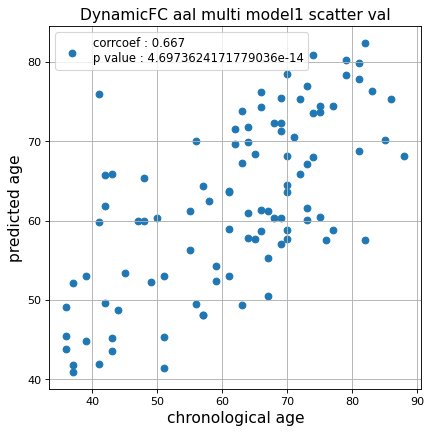

r^2 val data:  0.4322945582121892


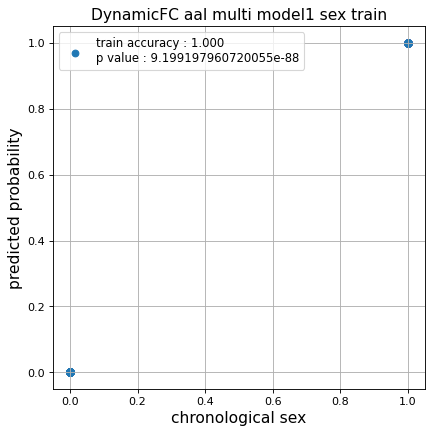

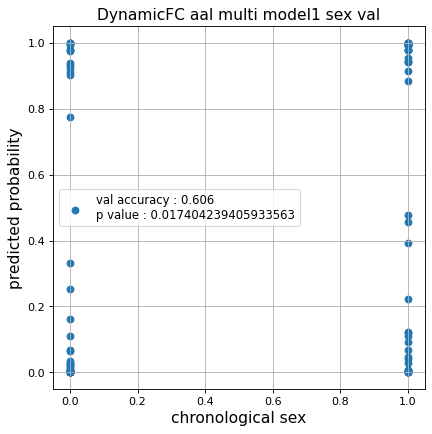

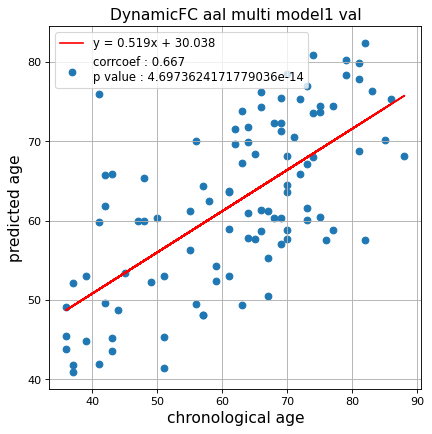

切片: 30.03767458448285
傾き: 0.5193537726654153
Kfold: 2 ::: epoch: 100, loss: 0.03963420998591643, val loss: 0.45903803408145905
Kfold: 2 ::: epoch: 200, loss: 0.016208479288392343, val loss: 0.4536101147532463
Kfold: 2 ::: epoch: 300, loss: 0.01524680394392747, val loss: 0.4558514282107353
Kfold: 2 ::: epoch: 400, loss: 0.007034138059959962, val loss: 0.4455929473042488
Kfold: 2 ::: epoch: 500, loss: 0.006095314720788827, val loss: 0.4656236842274666
Kfold: 2 ::: epoch: 600, loss: 0.005734404065431311, val loss: 0.4556166045367718
Kfold: 2 ::: epoch: 700, loss: 0.004567805373181517, val loss: 0.44384732842445374
save_epochs:296
best val loss:0.4344613775610924


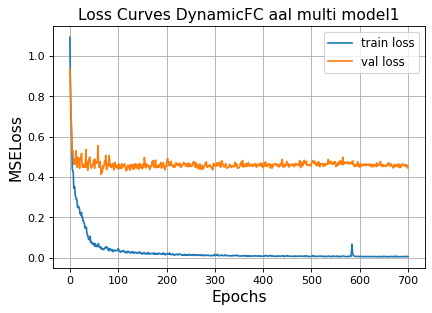

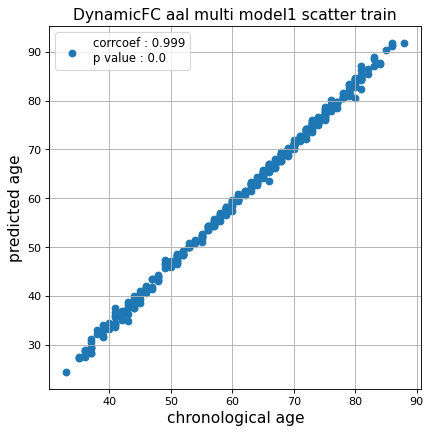

r^2 train data:  0.9366577091627266


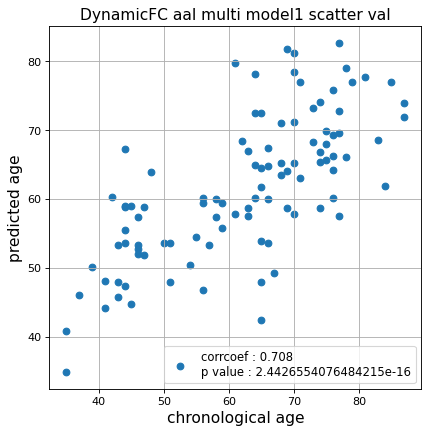

r^2 val data:  0.4967449097971186


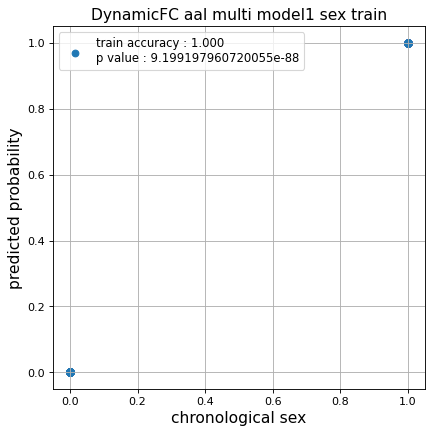

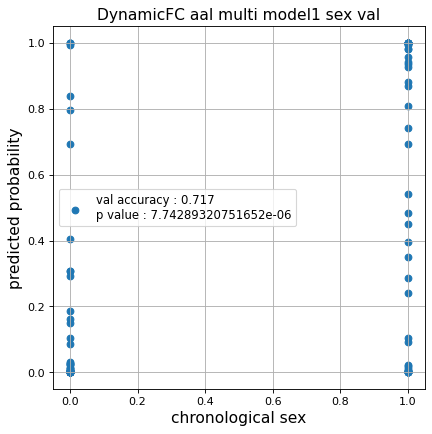

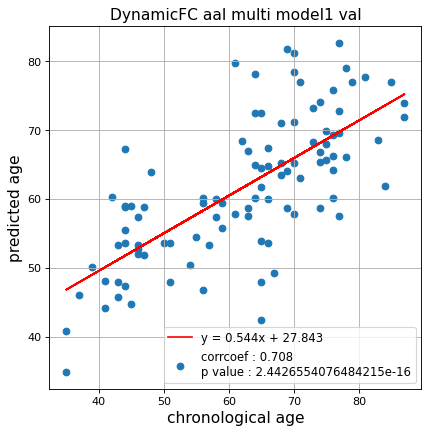

切片: 27.842894745954084
傾き: 0.5444597910260867
Kfold: 3 ::: epoch: 100, loss: 0.036374726690925084, val loss: 0.4918608833104372
Kfold: 3 ::: epoch: 200, loss: 0.01987787500883524, val loss: 0.4732562778517604
Kfold: 3 ::: epoch: 300, loss: 0.012016574028306283, val loss: 0.48817626014351845
Kfold: 3 ::: epoch: 400, loss: 0.007774405682889314, val loss: 0.4901390876621008
Kfold: 3 ::: epoch: 500, loss: 0.0075835521117999, val loss: 0.5014550276100636
Kfold: 3 ::: epoch: 600, loss: 0.09051736841837947, val loss: 0.5642464011907578
Kfold: 3 ::: epoch: 700, loss: 0.005904379694794233, val loss: 0.5117804035544395
save_epochs:295
best val loss:0.4529907298274338


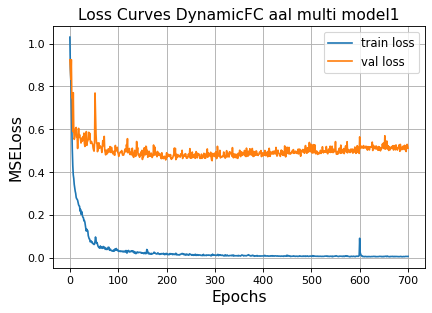

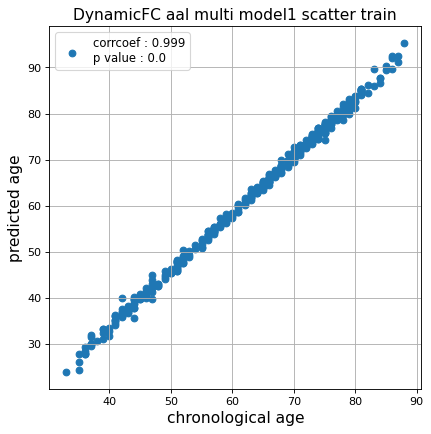

r^2 train data:  0.9327490778053882


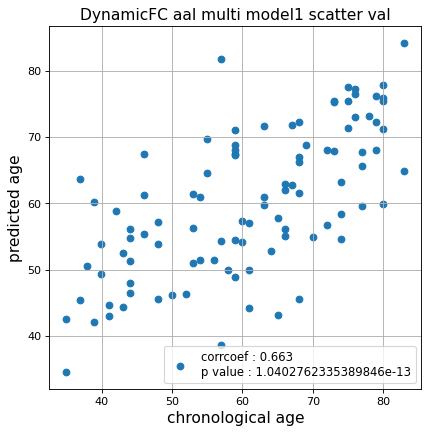

r^2 val data:  0.41707879512386803


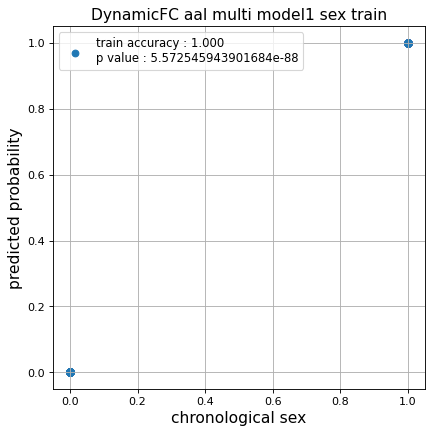

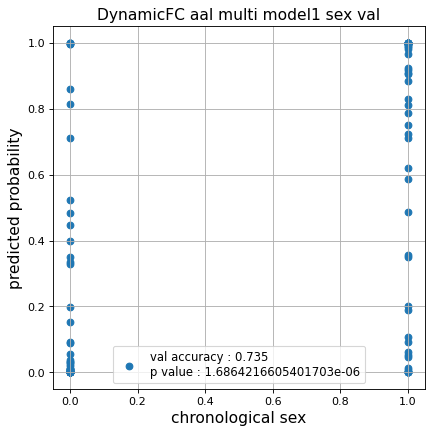

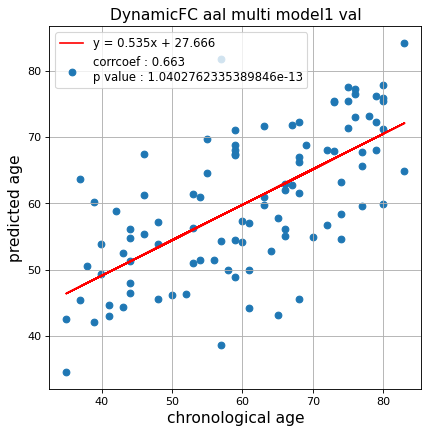

切片: 27.665590719959198
傾き: 0.5353388695415106
Kfold: 4 ::: epoch: 100, loss: 0.03343513006201157, val loss: 0.7175308465957642
Kfold: 4 ::: epoch: 200, loss: 0.015620478213979648, val loss: 0.6976745948195457
Kfold: 4 ::: epoch: 300, loss: 0.010476119458102263, val loss: 0.633429765701294
Kfold: 4 ::: epoch: 400, loss: 0.0075530495781164905, val loss: 0.6375419497489929
Kfold: 4 ::: epoch: 500, loss: 0.008042374052680455, val loss: 0.6156951785087585
Kfold: 4 ::: epoch: 600, loss: 0.00514825673487324, val loss: 0.6530545800924301
Kfold: 4 ::: epoch: 700, loss: 0.005245210477509177, val loss: 0.650540217757225
save_epochs:277
best val loss:0.5854695737361908


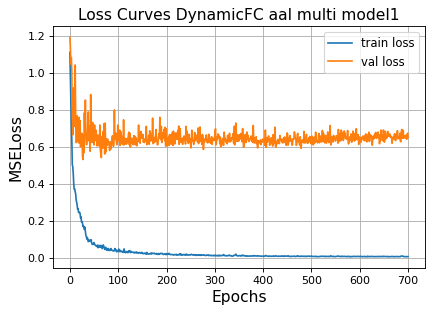

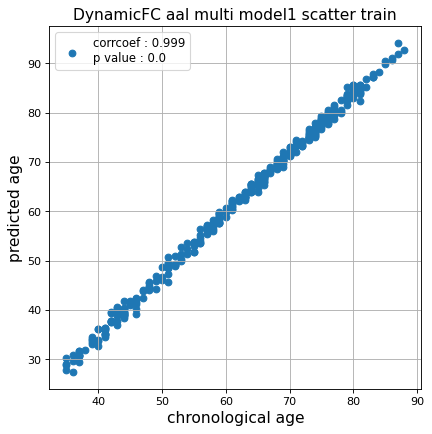

r^2 train data:  0.9445643676983401


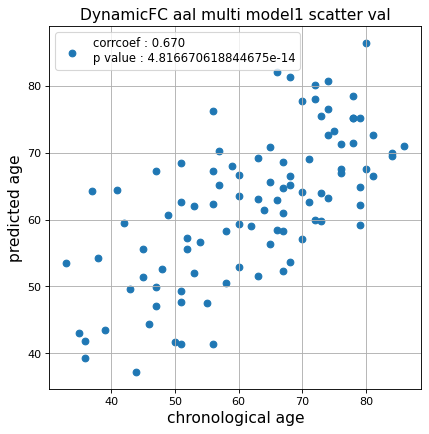

r^2 val data:  0.4277040297785146


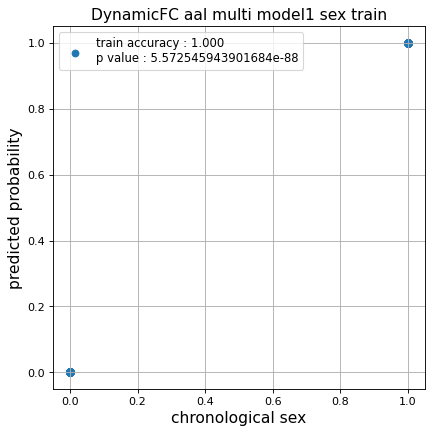

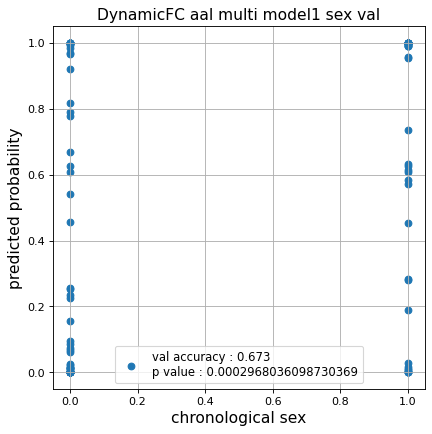

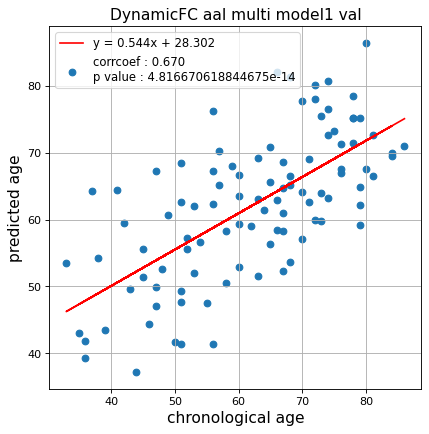

切片: 28.301736352690632
傾き: 0.5441663472990119
Kfold: 5 ::: epoch: 100, loss: 0.04085589415178849, val loss: 0.6460161358118057
Kfold: 5 ::: epoch: 200, loss: 0.017959815808213674, val loss: 0.5664988532662392
Kfold: 5 ::: epoch: 300, loss: 0.010474542979724132, val loss: 0.5672166347503662
Kfold: 5 ::: epoch: 400, loss: 0.008093815941650134, val loss: 0.5622709766030312
Kfold: 5 ::: epoch: 500, loss: 0.0072087868689917605, val loss: 0.5554437190294266
Kfold: 5 ::: epoch: 600, loss: 0.00524176864956434, val loss: 0.5533348247408867
Kfold: 5 ::: epoch: 700, loss: 0.005312706630390424, val loss: 0.537114841863513
save_epochs:654
best val loss:0.5266984403133392


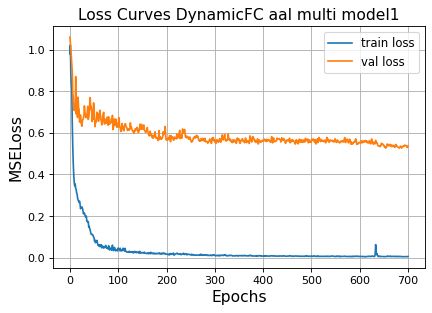

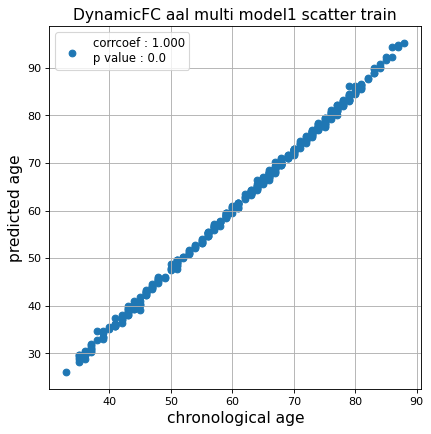

r^2 train data:  0.9336950906964552


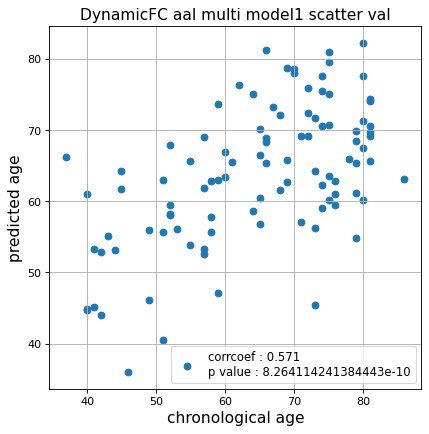

r^2 val data:  0.2831899475230639


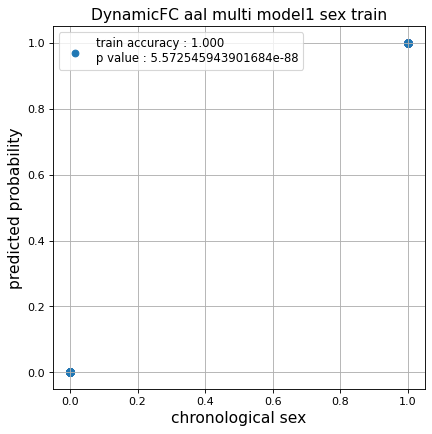

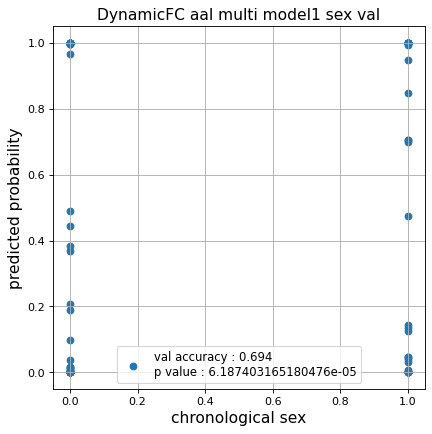

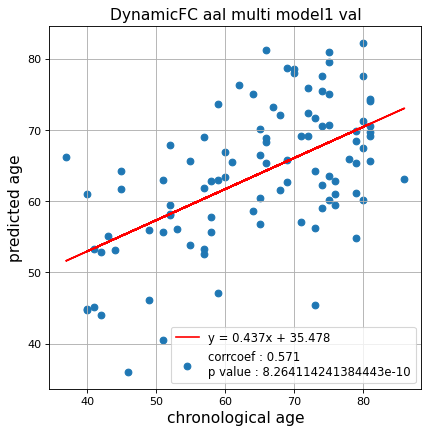

切片: 35.477667171366946
傾き: 0.4372906382517218
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.03796743658872751, val loss: 0.6870806664228439
Kfold: 1 ::: epoch: 200, loss: 0.019801469806295175, val loss: 0.6647956222295761
Kfold: 1 ::: epoch: 300, loss: 0.016180456544344243, val loss: 0.7031843215227127
Kfold: 1 ::: epoch: 400, loss: 0.009062420755911332, val loss: 0.7243603989481926
Kfold: 1 ::: epoch: 500, loss: 0.006591474780669579, val loss: 0.7314090803265572
Kfold: 1 ::: epoch: 600, loss: 0.007351187165253437, val loss: 0.7493672966957092
Kfold: 1 ::: epoch: 700, loss: 0.00535643299540075, val loss: 0.7709476053714752
save_epochs:257
best val loss:0.6602190583944321


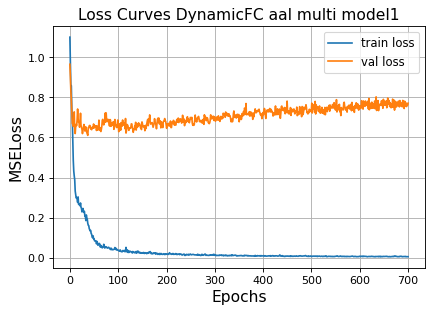

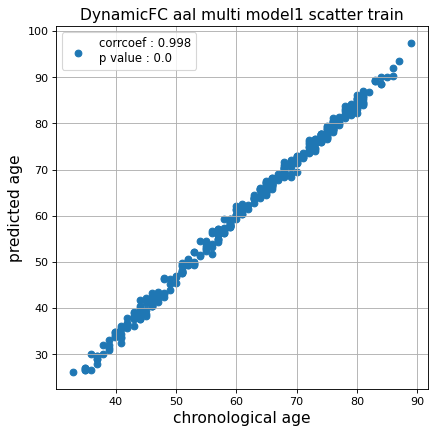

r^2 train data:  0.9241394697543739


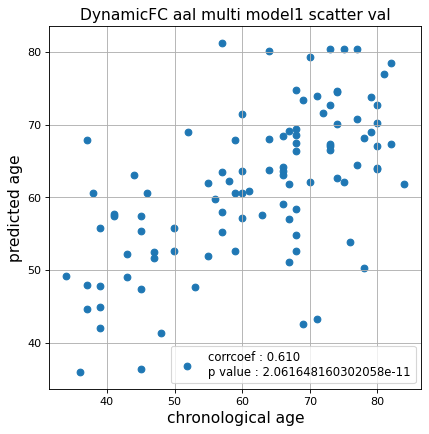

r^2 val data:  0.34928871990699506


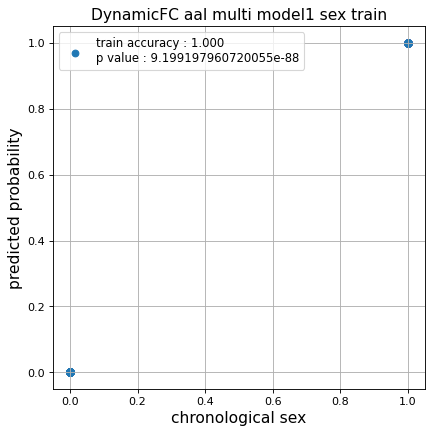

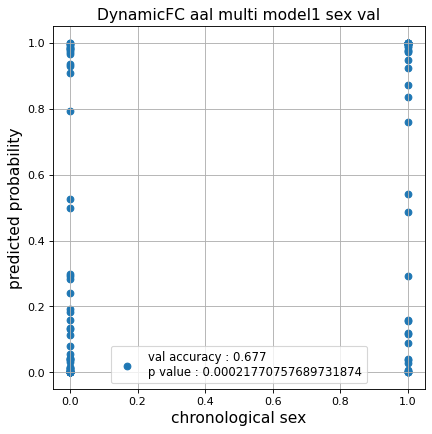

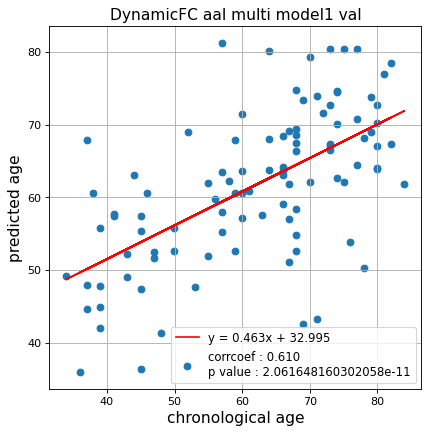

切片: 32.99507410084762
傾き: 0.46308102256510747
Kfold: 2 ::: epoch: 100, loss: 0.049791019839736134, val loss: 0.5414447486400604
Kfold: 2 ::: epoch: 200, loss: 0.014912354186750375, val loss: 0.5851162150502205
Kfold: 2 ::: epoch: 300, loss: 0.01358230634090992, val loss: 0.6006684079766273
Kfold: 2 ::: epoch: 400, loss: 0.0072985494043678045, val loss: 0.6043905094265938
Kfold: 2 ::: epoch: 500, loss: 0.005299589328038005, val loss: 0.6256318539381027
Kfold: 2 ::: epoch: 600, loss: 0.005666877769936736, val loss: 0.626875750720501
Kfold: 2 ::: epoch: 700, loss: 0.00508695872178158, val loss: 0.6119249016046524
save_epochs:268
best val loss:0.5682460069656372


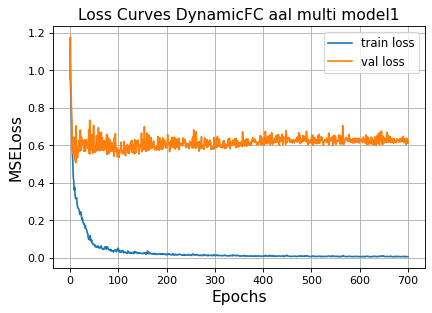

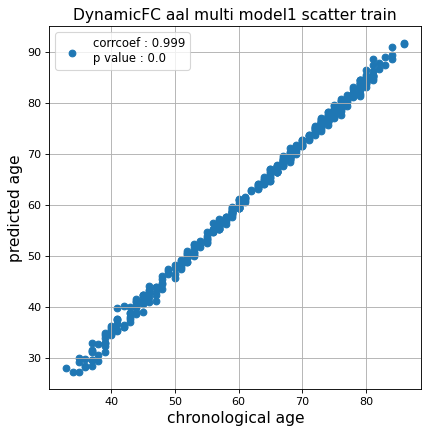

r^2 train data:  0.937500988733128


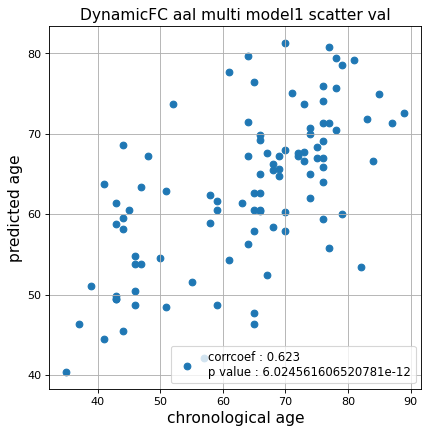

r^2 val data:  0.3750815549074997


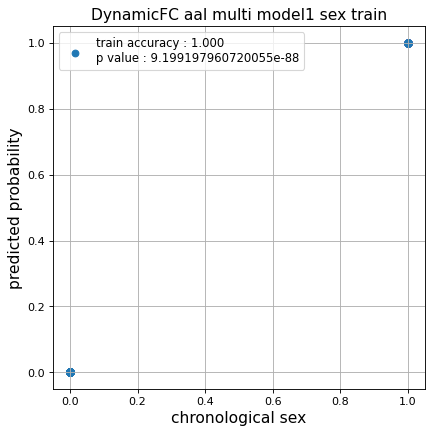

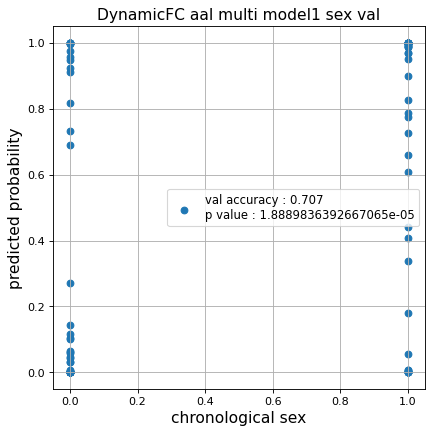

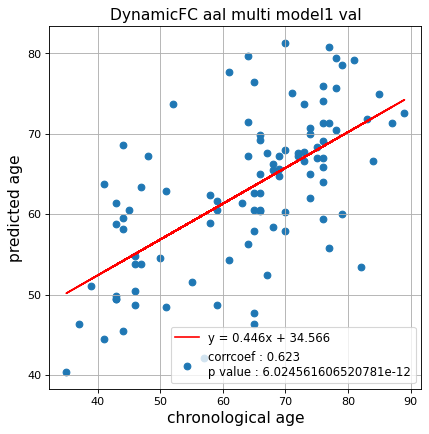

切片: 34.56562748988762
傾き: 0.4455574922350138
Kfold: 3 ::: epoch: 100, loss: 0.036678991495416716, val loss: 0.5801737681031227
Kfold: 3 ::: epoch: 200, loss: 0.020482430521112222, val loss: 0.5210020169615746
Kfold: 3 ::: epoch: 300, loss: 0.014063109751217641, val loss: 0.482014998793602
Kfold: 3 ::: epoch: 400, loss: 0.008573564056020517, val loss: 0.4962053447961807
Kfold: 3 ::: epoch: 500, loss: 0.00816228255056418, val loss: 0.49760136008262634
Kfold: 3 ::: epoch: 600, loss: 0.006535851969741858, val loss: 0.5185424312949181
Kfold: 3 ::: epoch: 700, loss: 0.00663557335232886, val loss: 0.551617331802845
save_epochs:345
best val loss:0.46939636766910553


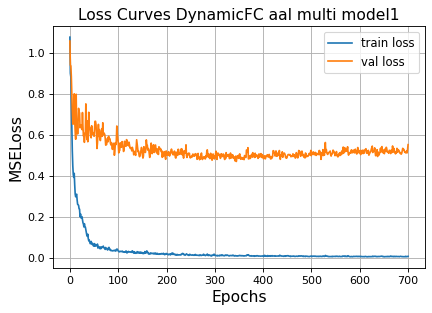

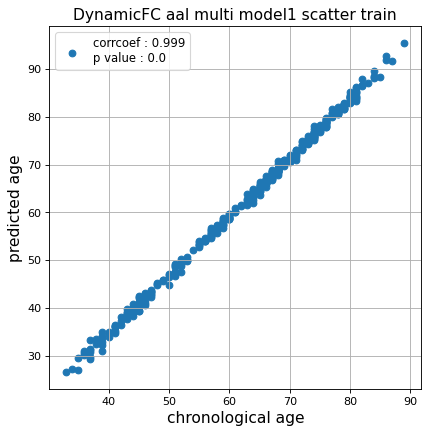

r^2 train data:  0.9465077917709179


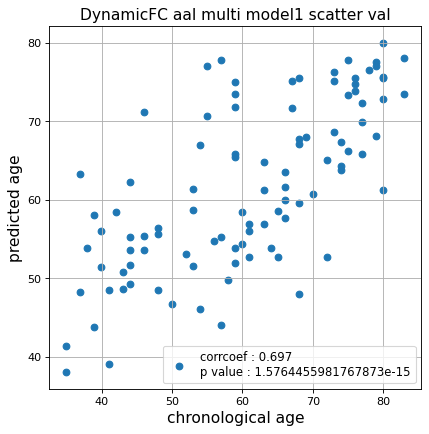

r^2 val data:  0.4735396733075732


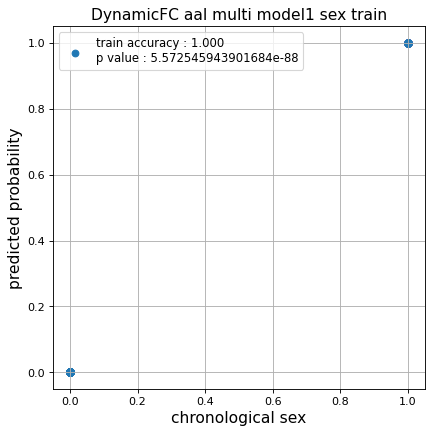

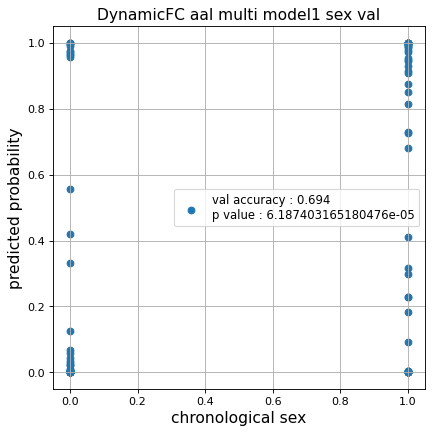

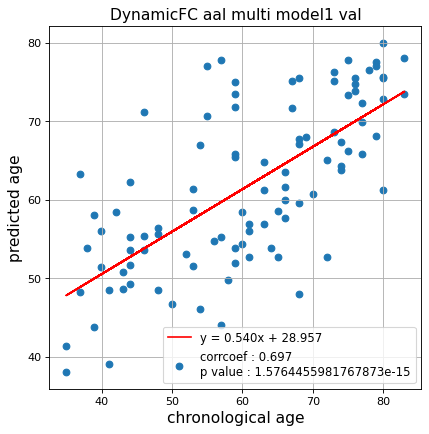

切片: 28.95715443571271
傾き: 0.5399232523674994
Kfold: 4 ::: epoch: 100, loss: 0.032613339045873053, val loss: 0.8692331910133362
Kfold: 4 ::: epoch: 200, loss: 0.015587551662555108, val loss: 0.8651760071516037
Kfold: 4 ::: epoch: 300, loss: 0.011198280594096733, val loss: 0.8781337589025497
Kfold: 4 ::: epoch: 400, loss: 0.009249625996185036, val loss: 0.9038128405809402
Kfold: 4 ::: epoch: 500, loss: 0.007724386407062411, val loss: 0.8518248200416565
Kfold: 4 ::: epoch: 600, loss: 0.005269831261382653, val loss: 0.8700600117444992
Kfold: 4 ::: epoch: 700, loss: 0.004534490836354403, val loss: 0.8775246888399124
save_epochs:350
best val loss:0.829724133014679


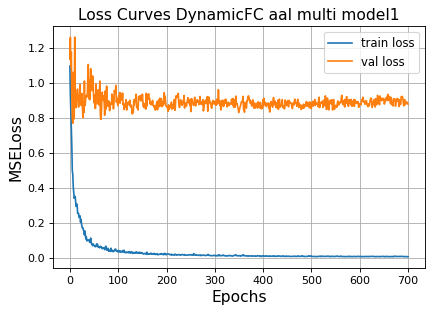

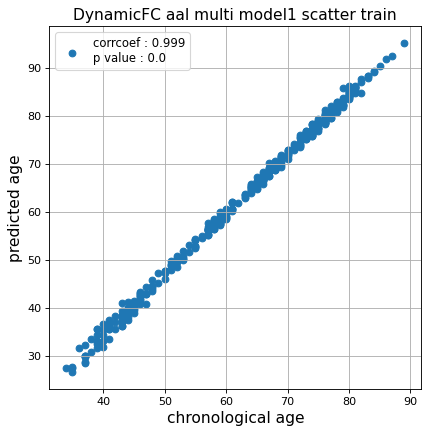

r^2 train data:  0.9338341080846893


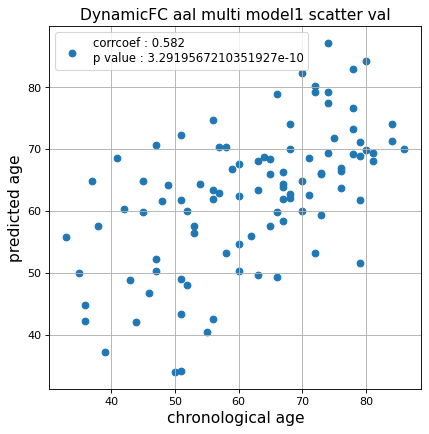

r^2 val data:  0.27137108553371225


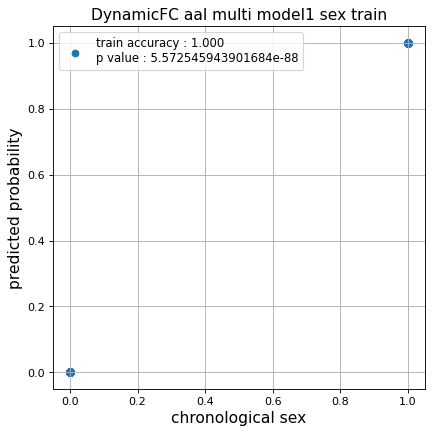

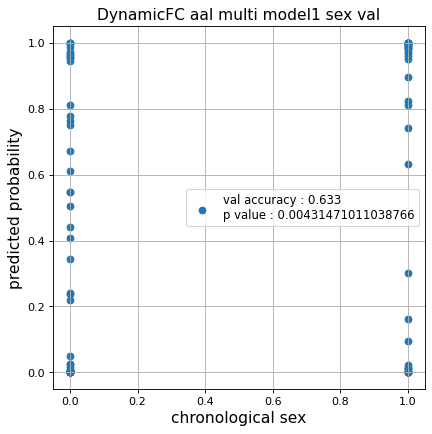

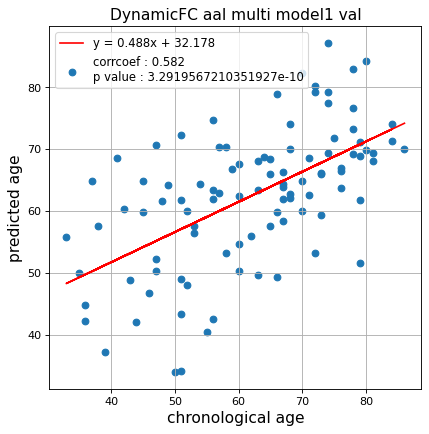

切片: 32.177834986560256
傾き: 0.4883685447457004
Kfold: 5 ::: epoch: 100, loss: 0.035990676627709314, val loss: 0.6354785338044167
Kfold: 5 ::: epoch: 200, loss: 0.018381847211947806, val loss: 0.5885644853115082
Kfold: 5 ::: epoch: 300, loss: 0.011014734538128743, val loss: 0.6395471096038818
Kfold: 5 ::: epoch: 400, loss: 0.008738139286064185, val loss: 0.6939987987279892
Kfold: 5 ::: epoch: 500, loss: 0.007209735027012916, val loss: 0.6686009392142296
Kfold: 5 ::: epoch: 600, loss: 0.006063860124693467, val loss: 0.6797115951776505
Kfold: 5 ::: epoch: 700, loss: 0.00427694281993004, val loss: 0.6976847350597382
save_epochs:280
best val loss:0.5946676284074783


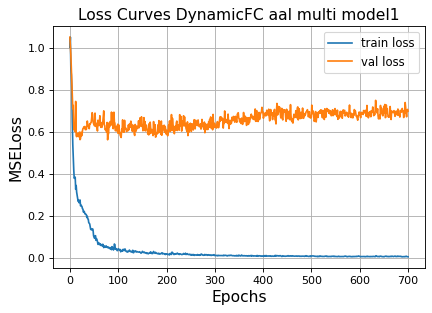

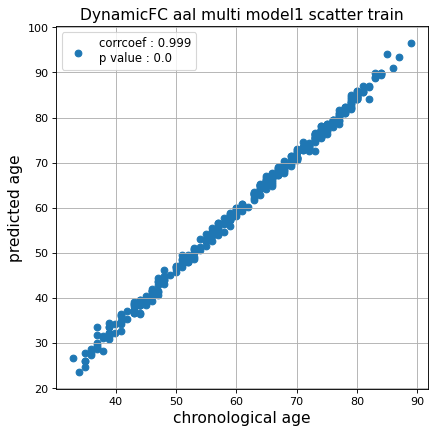

r^2 train data:  0.9213570813828155


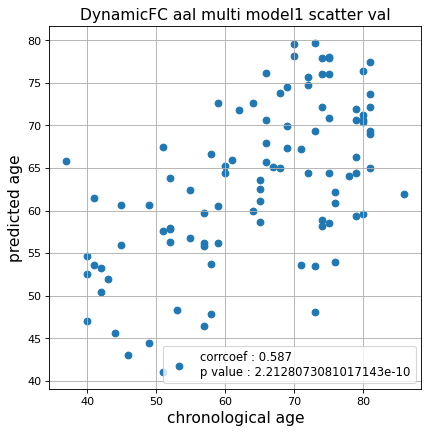

r^2 val data:  0.3143706498207769


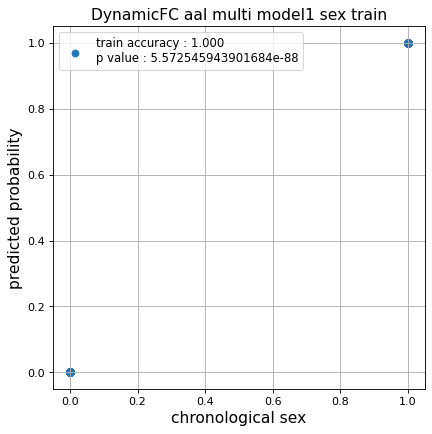

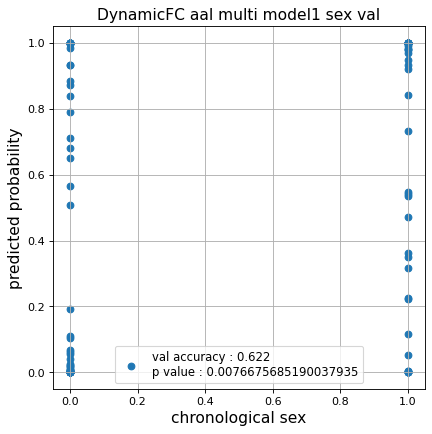

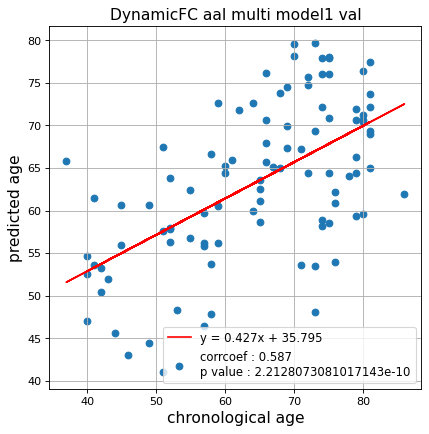

切片: 35.79485826982593
傾き: 0.4269792348703048
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.03573692804918839, val loss: 0.6187775209546089
Kfold: 1 ::: epoch: 200, loss: 0.02107995770011957, val loss: 0.6729637980461121
Kfold: 1 ::: epoch: 300, loss: 0.015232213128071565, val loss: 0.7277852147817612
Kfold: 1 ::: epoch: 400, loss: 0.011637254653928371, val loss: 0.7411524057388306
Kfold: 1 ::: epoch: 500, loss: 0.00649758349530972, val loss: 0.7622829228639603
Kfold: 1 ::: epoch: 600, loss: 0.00602696524359859, val loss: 0.7729002833366394
Kfold: 1 ::: epoch: 700, loss: 0.0052617363846645905, val loss: 0.8076323717832565
save_epochs:255
best val loss:0.6455372273921967


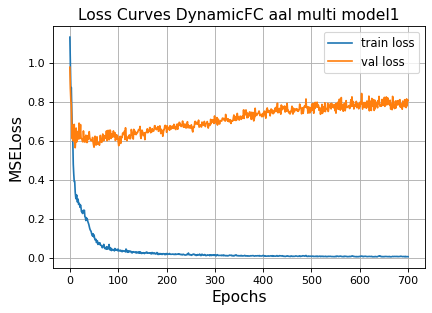

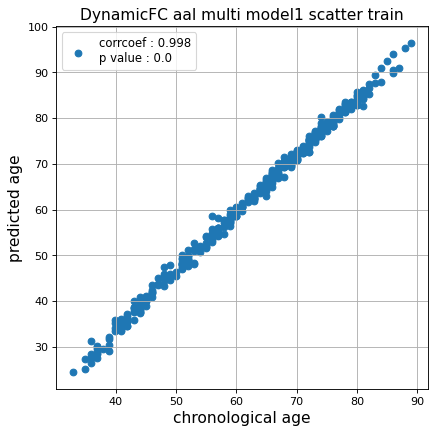

r^2 train data:  0.9232449146354944


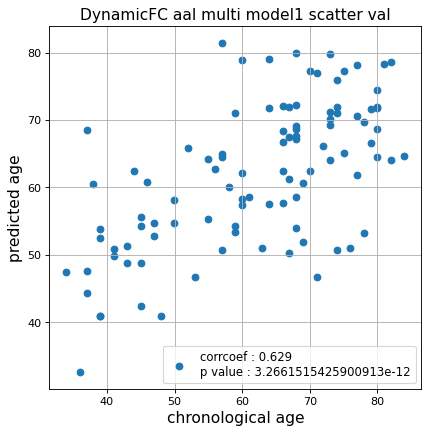

r^2 val data:  0.3717480890037347


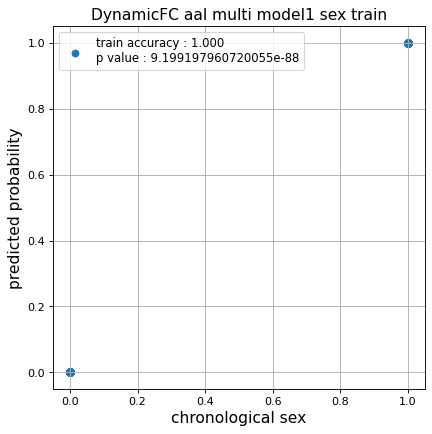

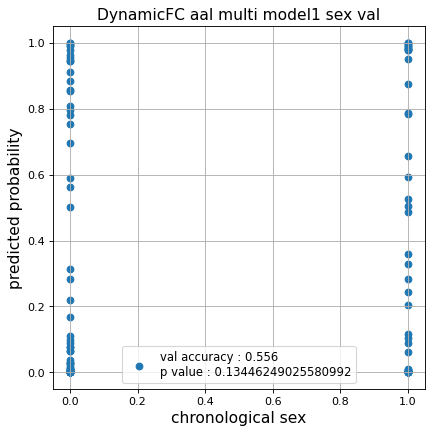

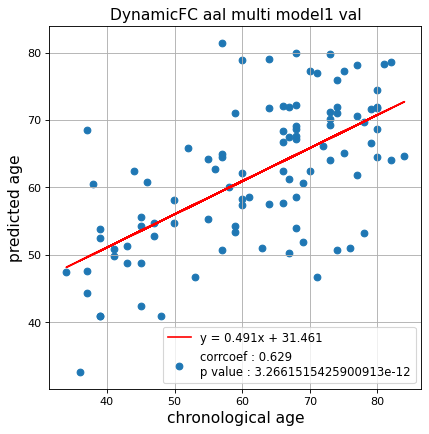

切片: 31.461042526359392
傾き: 0.49105537667540233
Kfold: 2 ::: epoch: 100, loss: 0.04332803748548031, val loss: 0.559574605897069
Kfold: 2 ::: epoch: 200, loss: 0.01548503923158233, val loss: 0.5686507653445005
Kfold: 2 ::: epoch: 300, loss: 0.011621437250421597, val loss: 0.5687166415154934
Kfold: 2 ::: epoch: 400, loss: 0.007657193292218905, val loss: 0.5985564105212688
Kfold: 2 ::: epoch: 500, loss: 0.005621614668948146, val loss: 0.6175683215260506
Kfold: 2 ::: epoch: 600, loss: 0.005610116632082141, val loss: 0.642335057258606
Kfold: 2 ::: epoch: 700, loss: 0.004977238516753109, val loss: 0.6355123817920685
save_epochs:258
best val loss:0.5513237845152617


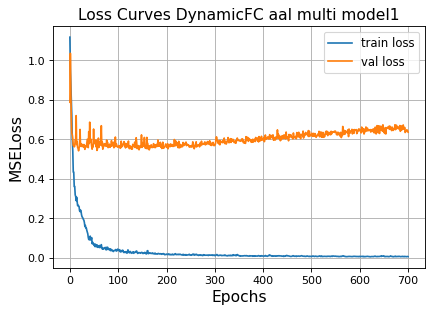

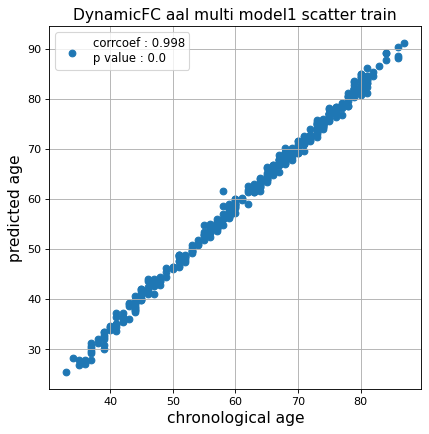

r^2 train data:  0.9430399196429826


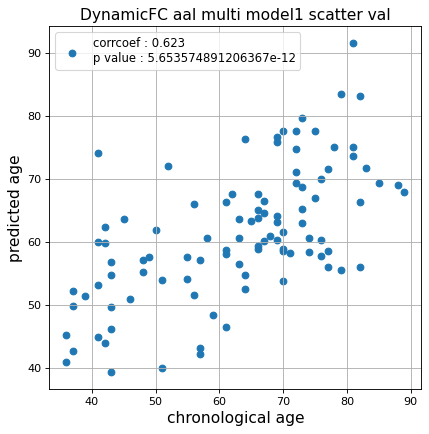

r^2 val data:  0.3638886192017654


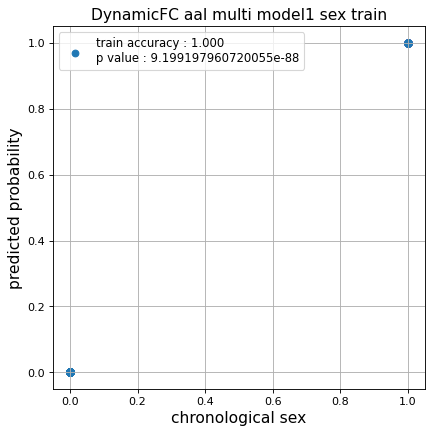

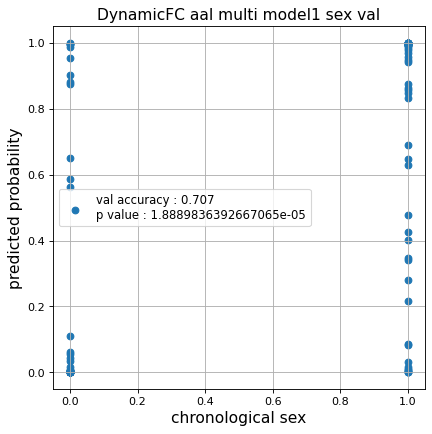

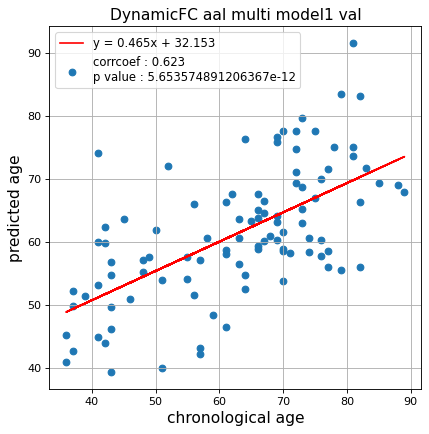

切片: 32.15340570714467
傾き: 0.4650977663912816
Kfold: 3 ::: epoch: 100, loss: 0.033734963490412787, val loss: 0.6793882846832275
Kfold: 3 ::: epoch: 200, loss: 0.01772817661269353, val loss: 0.6229774951934814
Kfold: 3 ::: epoch: 300, loss: 0.014816965836171921, val loss: 0.5801117718219757
Kfold: 3 ::: epoch: 400, loss: 0.008681860089731904, val loss: 0.5806886404752731
Kfold: 3 ::: epoch: 500, loss: 0.006303353521686334, val loss: 0.5738967657089233
Kfold: 3 ::: epoch: 600, loss: 0.0060733885038644075, val loss: 0.5813796073198318
Kfold: 3 ::: epoch: 700, loss: 0.0065029589101099055, val loss: 0.6220405101776123
save_epochs:361
best val loss:0.5491932779550552


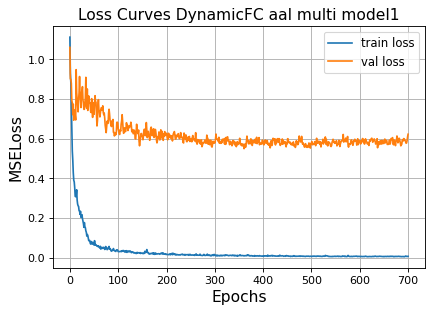

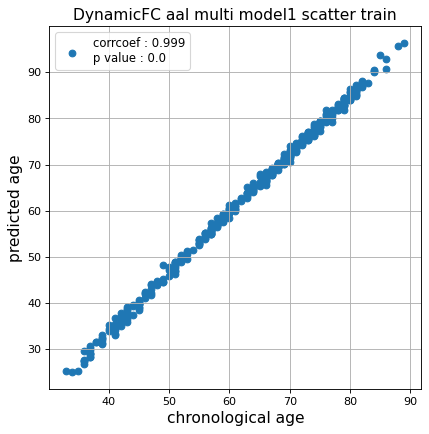

r^2 train data:  0.9163552286380606


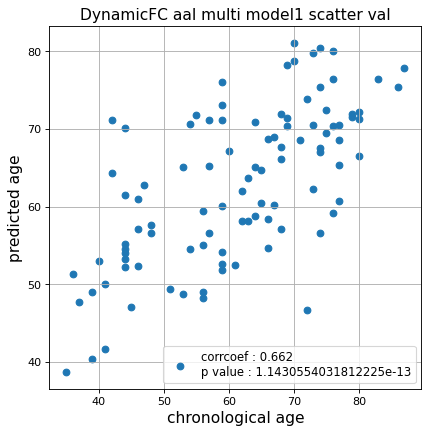

r^2 val data:  0.4164134053215859


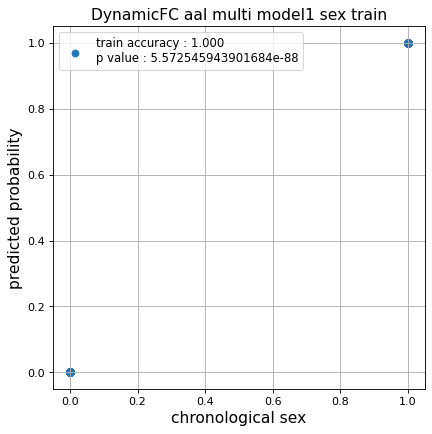

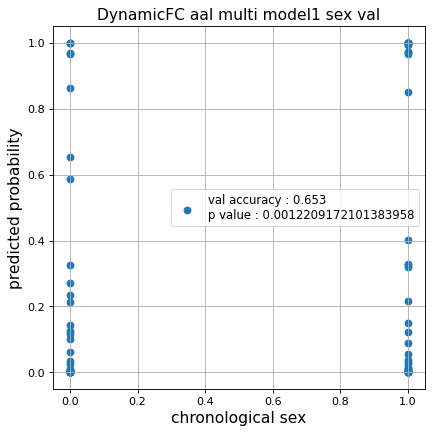

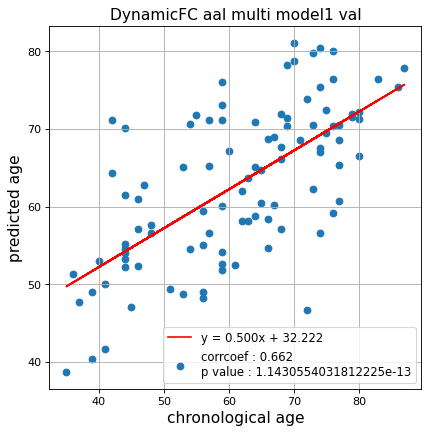

切片: 32.222477224193895
傾き: 0.5000015097469043
Kfold: 4 ::: epoch: 100, loss: 0.03219153072971564, val loss: 0.805315300822258
Kfold: 4 ::: epoch: 200, loss: 0.01722638667202913, val loss: 0.7898272424936295
Kfold: 4 ::: epoch: 300, loss: 0.01091176694115767, val loss: 0.805835634469986
Kfold: 4 ::: epoch: 400, loss: 0.009090741702283803, val loss: 0.8607003688812256
Kfold: 4 ::: epoch: 500, loss: 0.007855820523288388, val loss: 0.8510905355215073
Kfold: 4 ::: epoch: 600, loss: 0.007171079516410828, val loss: 0.86285300552845
Kfold: 4 ::: epoch: 700, loss: 0.0055629200696085505, val loss: 0.9022551625967026
save_epochs:360
best val loss:0.7597696930170059


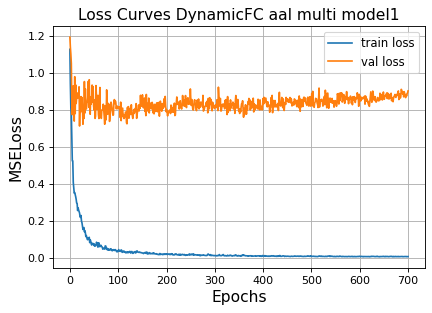

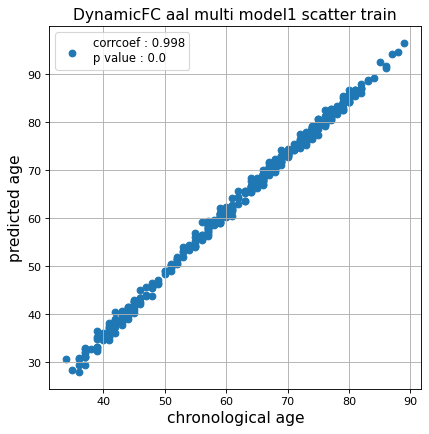

r^2 train data:  0.9245254917756114


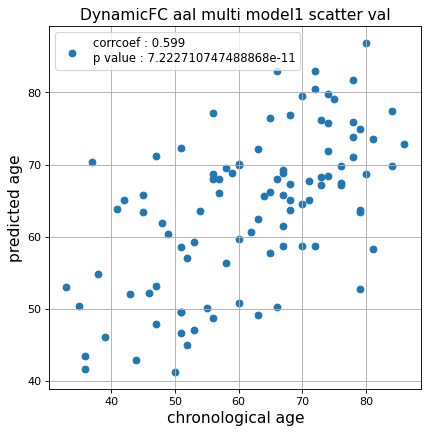

r^2 val data:  0.3007891868435565


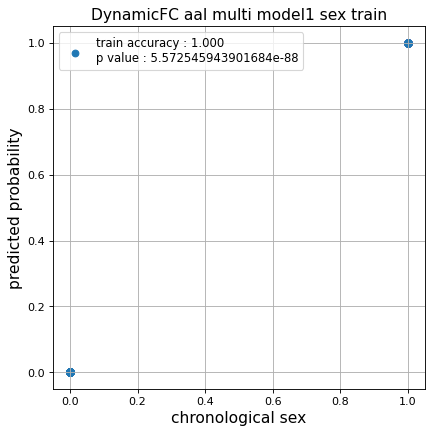

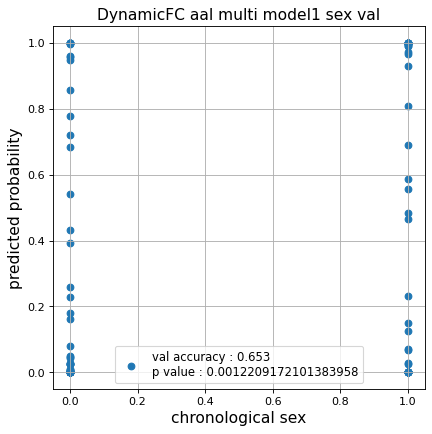

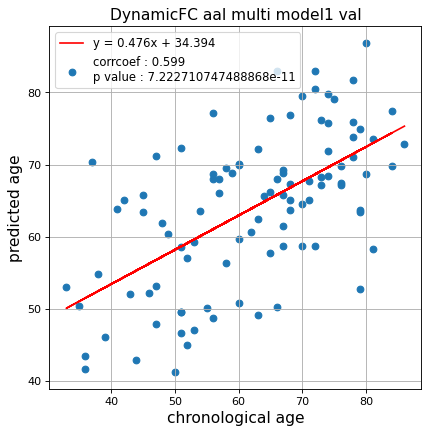

切片: 34.39425990789012
傾き: 0.4758705466973931
Kfold: 5 ::: epoch: 100, loss: 0.03355212437991913, val loss: 0.6354660764336586
Kfold: 5 ::: epoch: 200, loss: 0.01820342206897644, val loss: 0.5920877605676651
Kfold: 5 ::: epoch: 300, loss: 0.011607724958314346, val loss: 0.5893045663833618
Kfold: 5 ::: epoch: 400, loss: 0.009907437345156303, val loss: 0.5932746231555939
Kfold: 5 ::: epoch: 500, loss: 0.005885243147181777, val loss: 0.5798307843506336
Kfold: 5 ::: epoch: 600, loss: 0.005514629024009292, val loss: 0.5787283480167389
Kfold: 5 ::: epoch: 700, loss: 0.004405336221680045, val loss: 0.5726617835462093
save_epochs:510
best val loss:0.5589415989816189


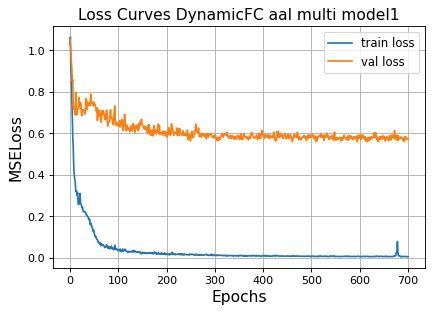

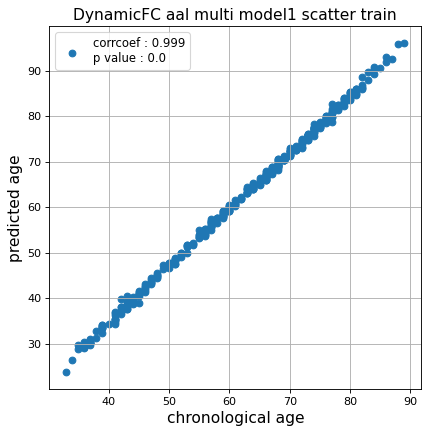

r^2 train data:  0.9383370373815642


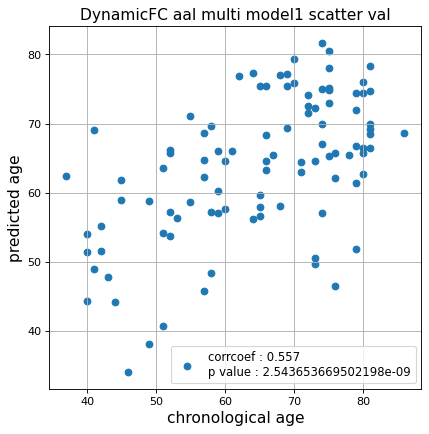

r^2 val data:  0.24677983874732157


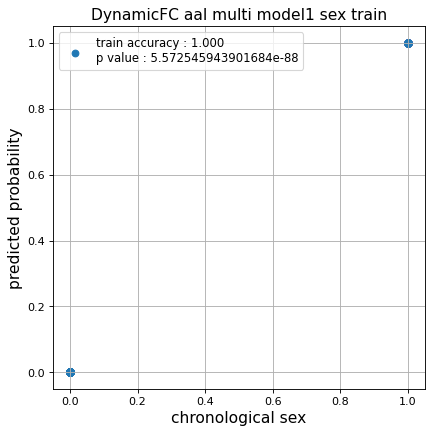

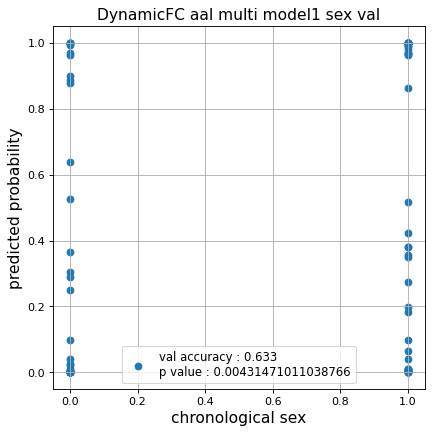

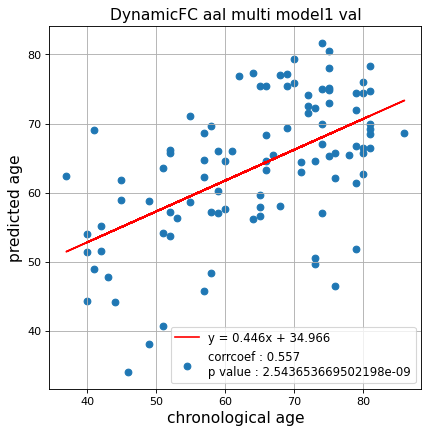

切片: 34.965783736418814
傾き: 0.44629235976376175
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.03271931058798845, val loss: 0.637653648853302
Kfold: 1 ::: epoch: 200, loss: 0.019621866325346324, val loss: 0.6277527213096619
Kfold: 1 ::: epoch: 300, loss: 0.01606854760589508, val loss: 0.6555001437664032
Kfold: 1 ::: epoch: 400, loss: 0.01148481172724412, val loss: 0.6570063978433609
Kfold: 1 ::: epoch: 500, loss: 0.006511366550022593, val loss: 0.6950739771127701
Kfold: 1 ::: epoch: 600, loss: 0.0055358639130225545, val loss: 0.7105015218257904
Kfold: 1 ::: epoch: 700, loss: 0.005163188468521604, val loss: 0.7219682782888412
save_epochs:252
best val loss:0.6090513989329338


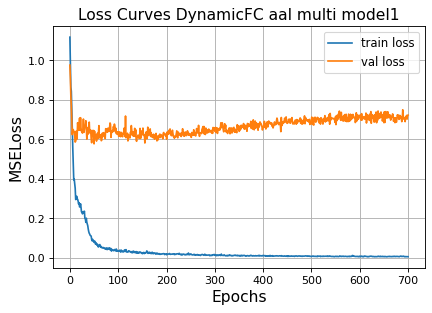

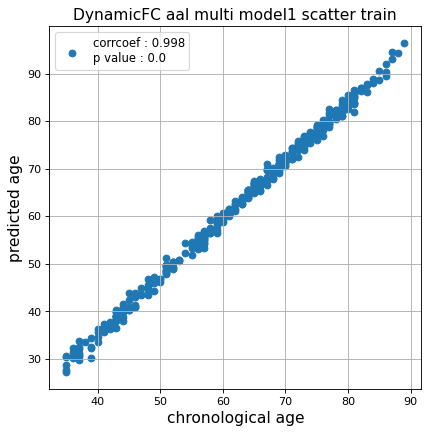

r^2 train data:  0.9459495899335582


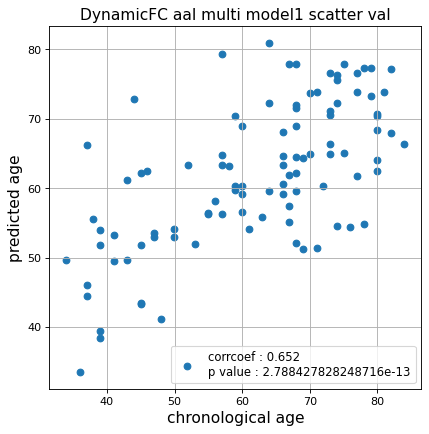

r^2 val data:  0.4142891846296115


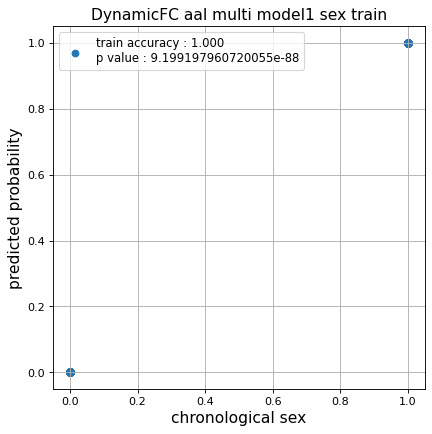

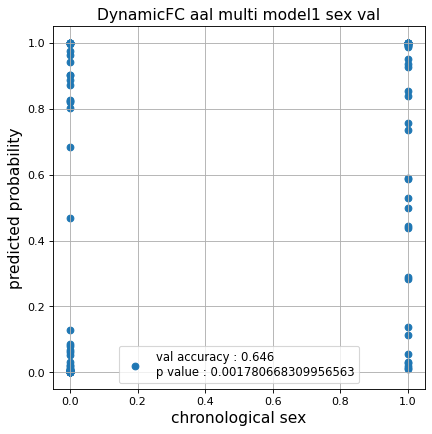

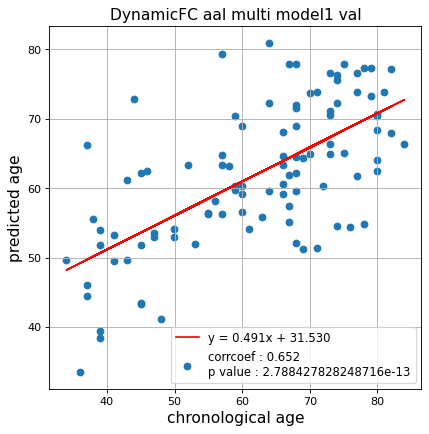

切片: 31.529806094666426
傾き: 0.4908247561458641
Kfold: 2 ::: epoch: 100, loss: 0.0402161766989873, val loss: 0.5713110771030188
Kfold: 2 ::: epoch: 200, loss: 0.017116018750060063, val loss: 0.5772162973880768
Kfold: 2 ::: epoch: 300, loss: 0.014291213037302861, val loss: 0.6095602586865425
Kfold: 2 ::: epoch: 400, loss: 0.00843677338427649, val loss: 0.6608818992972374
Kfold: 2 ::: epoch: 500, loss: 0.006502459685389812, val loss: 0.6850651055574417
Kfold: 2 ::: epoch: 600, loss: 0.005080820616477957, val loss: 0.7055737525224686
Kfold: 2 ::: epoch: 700, loss: 0.005266071476328831, val loss: 0.7267489433288574
save_epochs:256
best val loss:0.5808877274394035


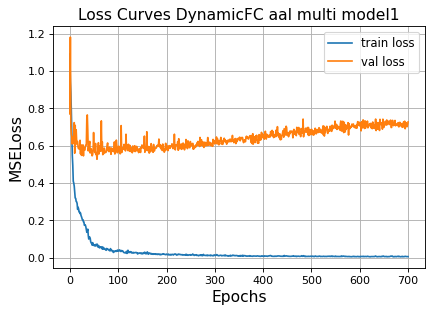

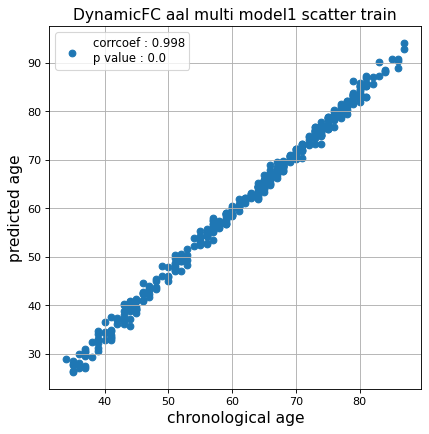

r^2 train data:  0.9336017594296434


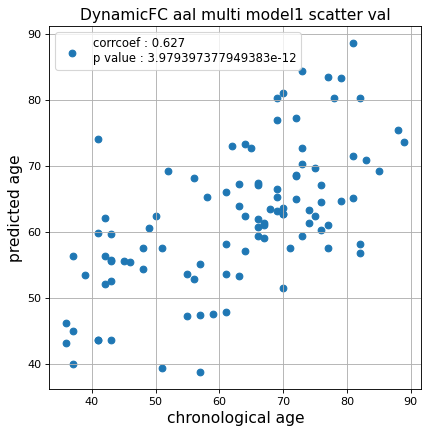

r^2 val data:  0.37358208745862864


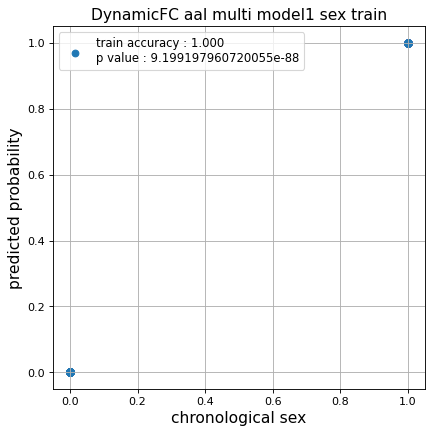

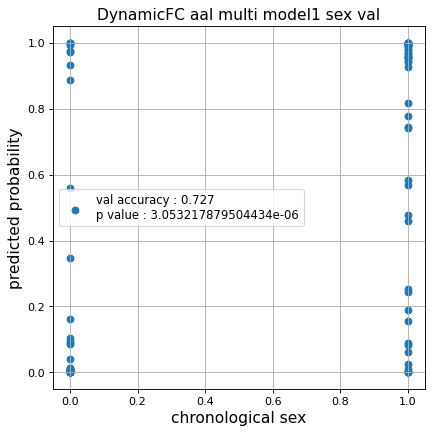

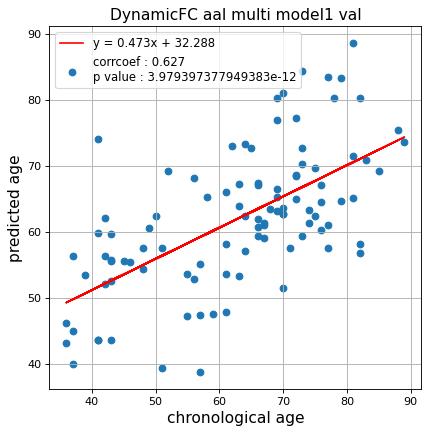

切片: 32.288493875839
傾き: 0.4726005460154739
Kfold: 3 ::: epoch: 100, loss: 0.03181150512626538, val loss: 0.570371612906456
Kfold: 3 ::: epoch: 200, loss: 0.018649630750027988, val loss: 0.5620878711342812
Kfold: 3 ::: epoch: 300, loss: 0.01299543112802964, val loss: 0.5850927978754044
Kfold: 3 ::: epoch: 400, loss: 0.008135063466257773, val loss: 0.6151478439569473
Kfold: 3 ::: epoch: 500, loss: 0.0058845240586938765, val loss: 0.6565705686807632
Kfold: 3 ::: epoch: 600, loss: 0.0062876592139498545, val loss: 0.6651031225919724
Kfold: 3 ::: epoch: 700, loss: 0.006143414343778904, val loss: 0.6814483255147934
save_epochs:271
best val loss:0.5633348077535629


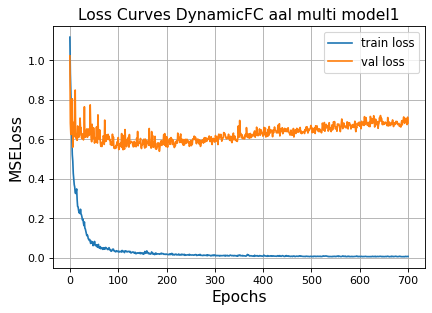

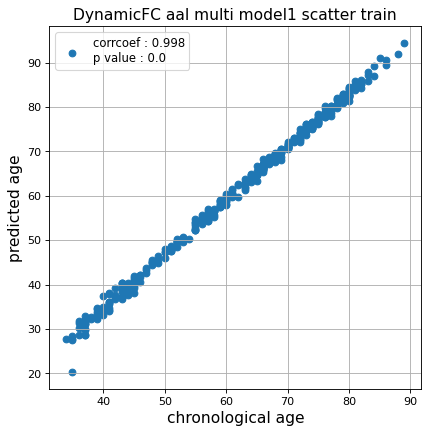

r^2 train data:  0.9476972029738159


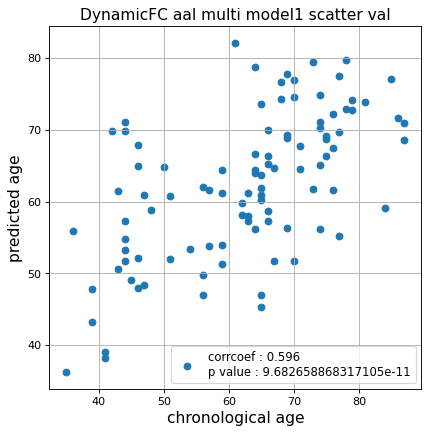

r^2 val data:  0.3252319521630649


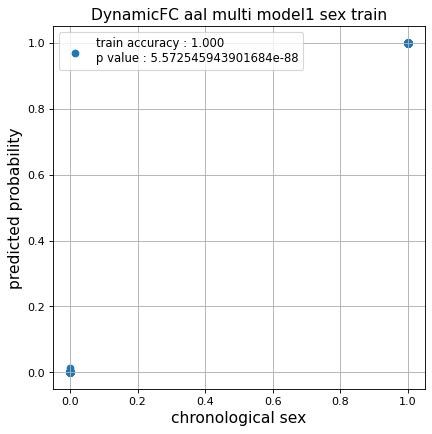

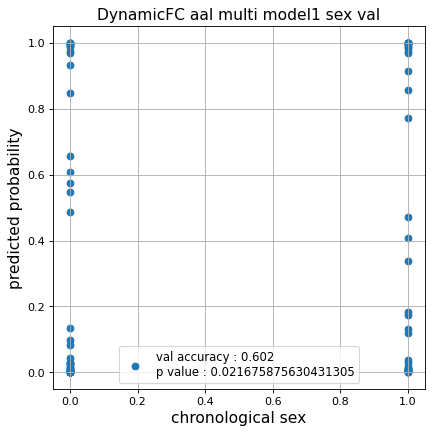

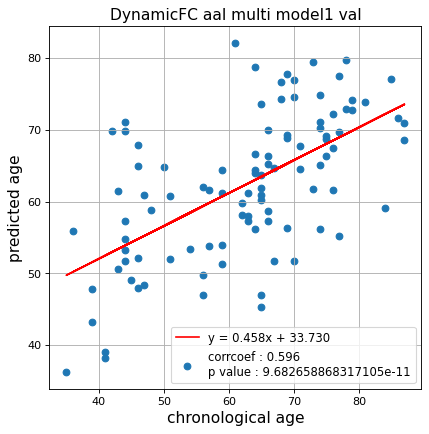

切片: 33.72982118067179
傾き: 0.4575830103902801
Kfold: 4 ::: epoch: 100, loss: 0.033145614398213535, val loss: 0.7913051843643188
Kfold: 4 ::: epoch: 200, loss: 0.018730289231126126, val loss: 0.8151953667402267
Kfold: 4 ::: epoch: 300, loss: 0.010815832692270096, val loss: 0.8339495956897736
Kfold: 4 ::: epoch: 400, loss: 0.01000316681053776, val loss: 0.9278919696807861
Kfold: 4 ::: epoch: 500, loss: 0.00737749170870162, val loss: 0.8705283105373383
Kfold: 4 ::: epoch: 600, loss: 0.006933387530107911, val loss: 0.8885703310370445
Kfold: 4 ::: epoch: 700, loss: 0.006075879845481653, val loss: 0.93726547062397
save_epochs:414
best val loss:0.8006790578365326


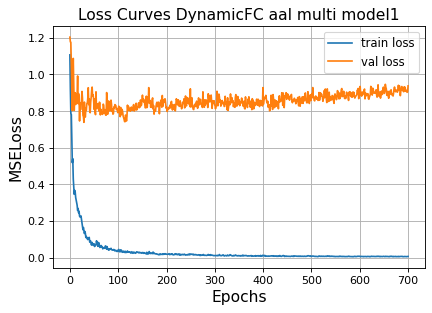

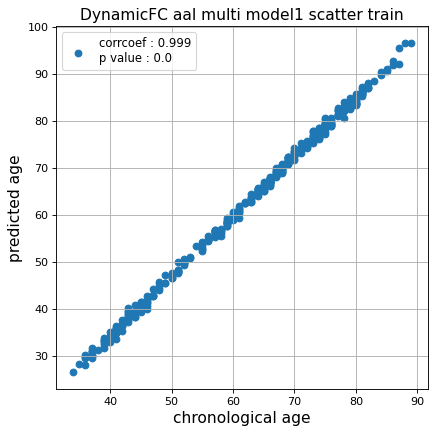

r^2 train data:  0.9230483959488087


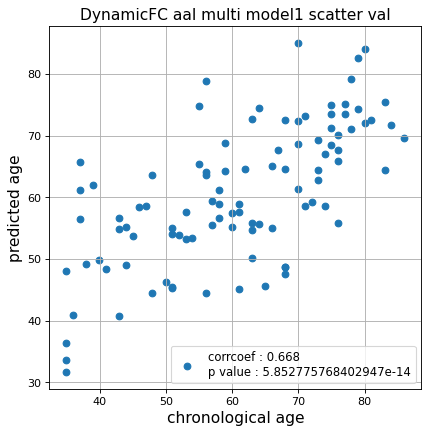

r^2 val data:  0.42652912296857237


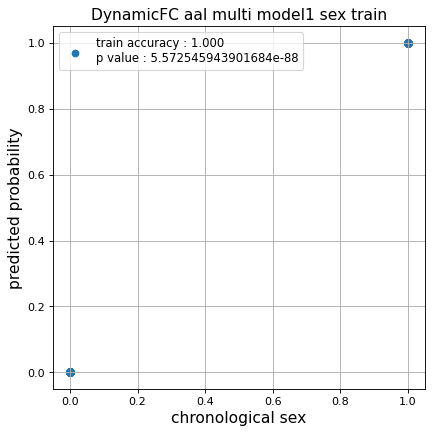

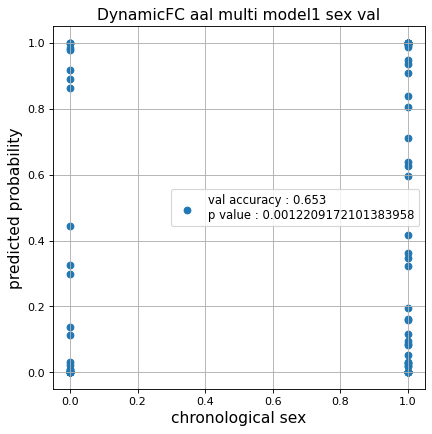

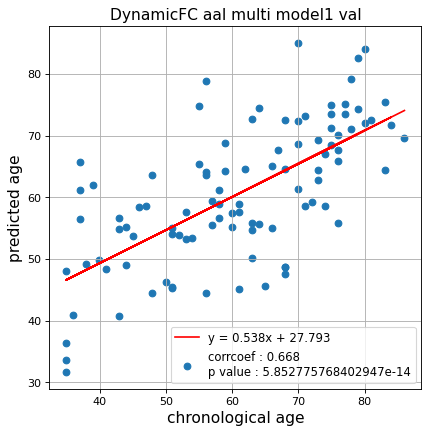

切片: 27.793322154932063
傾き: 0.5381493883002237
Kfold: 5 ::: epoch: 100, loss: 0.037018997594714165, val loss: 0.6424736380577087
Kfold: 5 ::: epoch: 200, loss: 0.01588851070174804, val loss: 0.5642976462841034
Kfold: 5 ::: epoch: 300, loss: 0.011165717545037087, val loss: 0.5377197414636612
Kfold: 5 ::: epoch: 400, loss: 0.009091800042929558, val loss: 0.5511157065629959
Kfold: 5 ::: epoch: 500, loss: 0.006298138706300121, val loss: 0.5454749241471291
Kfold: 5 ::: epoch: 600, loss: 0.006122014539029736, val loss: 0.5290674306452274
Kfold: 5 ::: epoch: 700, loss: 0.005315688420803501, val loss: 0.5220616795122623
save_epochs:594
best val loss:0.510698176920414


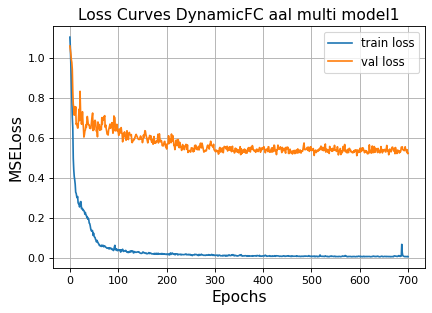

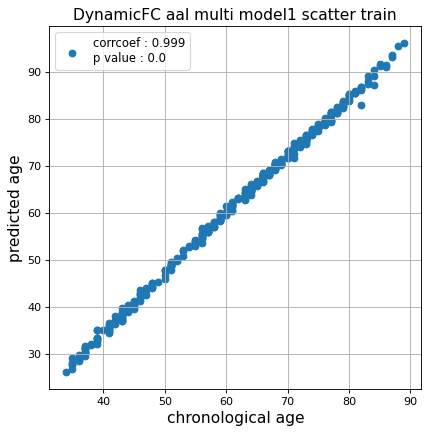

r^2 train data:  0.9342604841169783


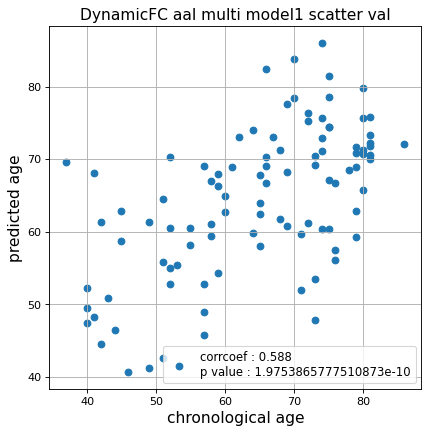

r^2 val data:  0.303351537790867


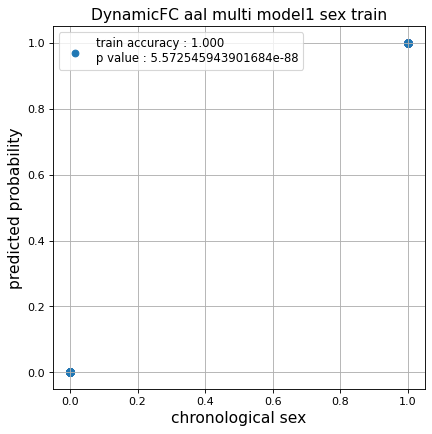

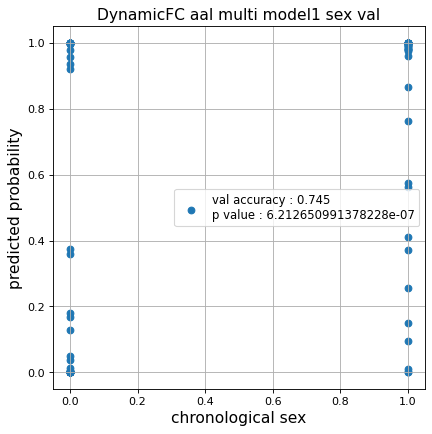

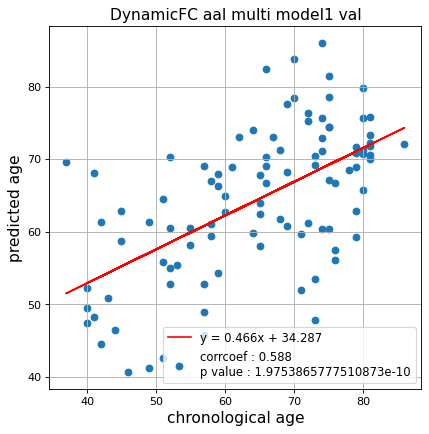

切片: 34.28738710201064
傾き: 0.4656235224545727
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.03214922146155284, val loss: 0.7492389231920242
Kfold: 1 ::: epoch: 200, loss: 0.018844115762756422, val loss: 0.7128636687994003
Kfold: 1 ::: epoch: 300, loss: 0.01594176866973822, val loss: 0.716288223862648
Kfold: 1 ::: epoch: 400, loss: 0.008733375177073937, val loss: 0.736122265458107
Kfold: 1 ::: epoch: 500, loss: 0.006054118705483584, val loss: 0.7804730236530304
Kfold: 1 ::: epoch: 600, loss: 0.007445868677817858, val loss: 0.7965581566095352
Kfold: 1 ::: epoch: 700, loss: 0.00608753810565059, val loss: 0.8648992031812668
save_epochs:251
best val loss:0.6700814068317413


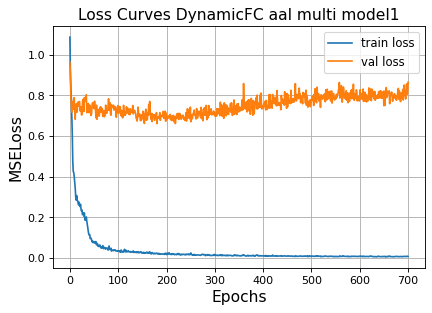

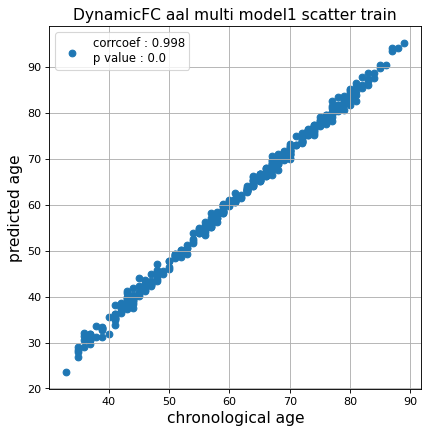

r^2 train data:  0.9434199690115936


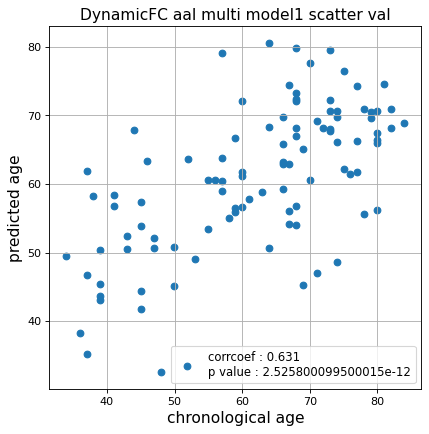

r^2 val data:  0.3761690156627031


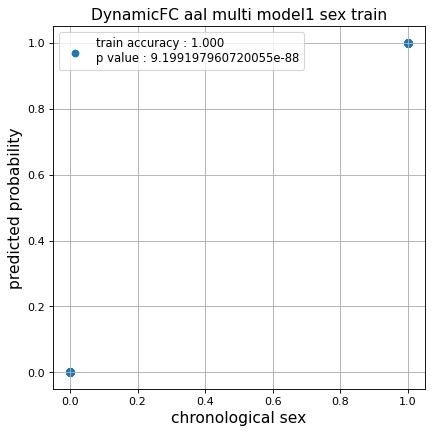

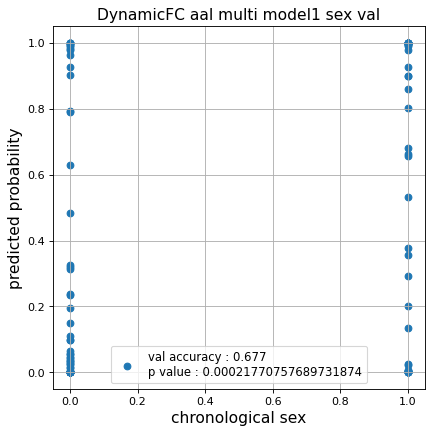

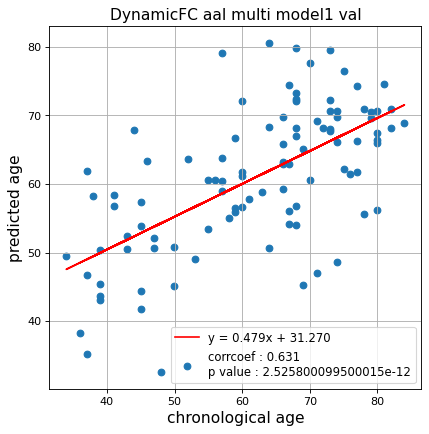

切片: 31.270097438564225
傾き: 0.47932076130322077
Kfold: 2 ::: epoch: 100, loss: 0.03364335831541281, val loss: 0.596753716468811
Kfold: 2 ::: epoch: 200, loss: 0.014465523955340568, val loss: 0.6347487233579159
Kfold: 2 ::: epoch: 300, loss: 0.010916780608777817, val loss: 0.6561651453375816
Kfold: 2 ::: epoch: 400, loss: 0.007228059156869466, val loss: 0.7102321833372116
Kfold: 2 ::: epoch: 500, loss: 0.006545731009772191, val loss: 0.7131337523460388
Kfold: 2 ::: epoch: 600, loss: 0.006096758449879976, val loss: 0.7319115921854973
Kfold: 2 ::: epoch: 700, loss: 0.00468677139052978, val loss: 0.7547245919704437
save_epochs:258
best val loss:0.6313247829675674


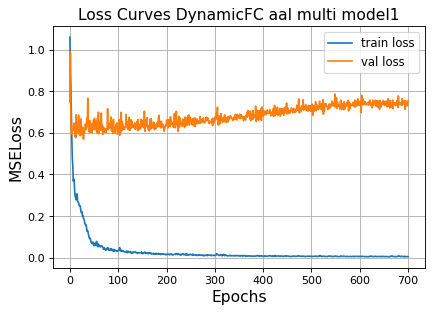

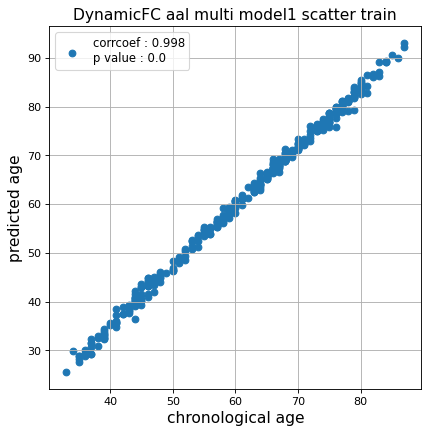

r^2 train data:  0.9473823949114841


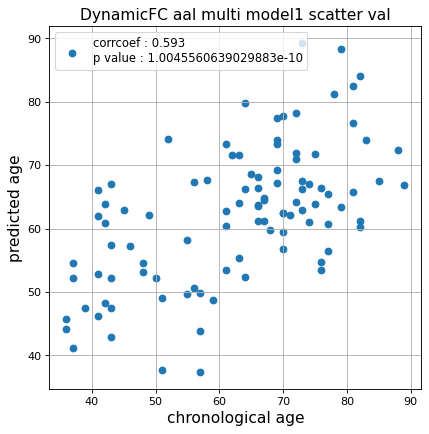

r^2 val data:  0.3218482846183758


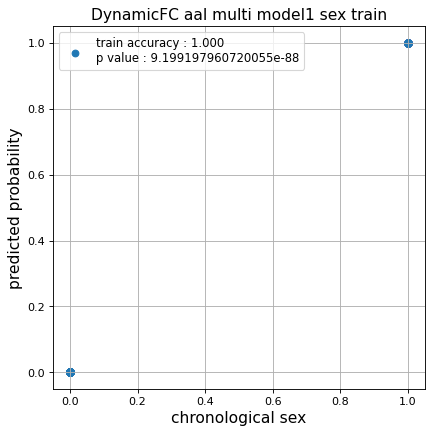

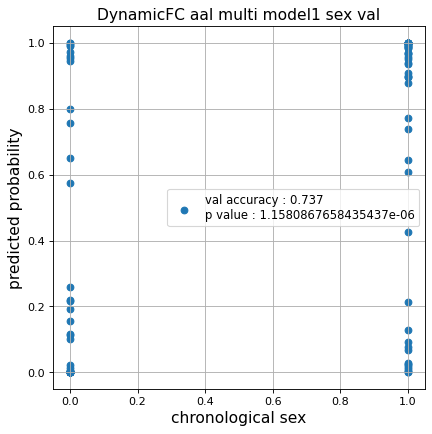

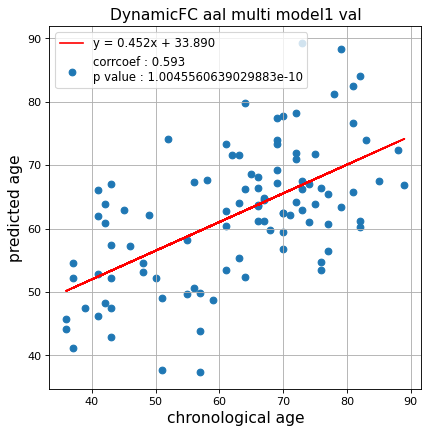

切片: 33.890148226181395
傾き: 0.4522560275069756
Kfold: 3 ::: epoch: 100, loss: 0.03343422739551617, val loss: 0.5418364256620407
Kfold: 3 ::: epoch: 200, loss: 0.01821710248119556, val loss: 0.5295373499393463
Kfold: 3 ::: epoch: 300, loss: 0.011250350266121902, val loss: 0.5361751057207584
Kfold: 3 ::: epoch: 400, loss: 0.007194451092240902, val loss: 0.5533715710043907
Kfold: 3 ::: epoch: 500, loss: 0.007314363028854132, val loss: 0.578477069735527
Kfold: 3 ::: epoch: 600, loss: 0.006685132483163705, val loss: 0.5802855268120766
Kfold: 3 ::: epoch: 700, loss: 0.006755408239909089, val loss: 0.5855307579040527
save_epochs:271
best val loss:0.5190690979361534


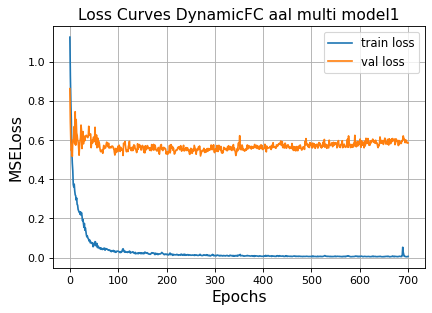

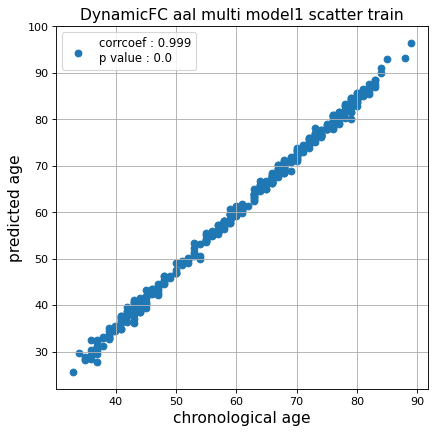

r^2 train data:  0.9390355275581953


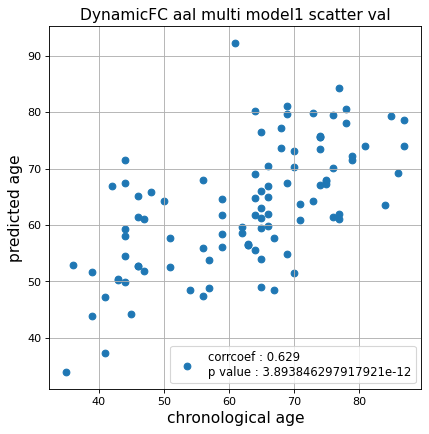

r^2 val data:  0.35471704139270666


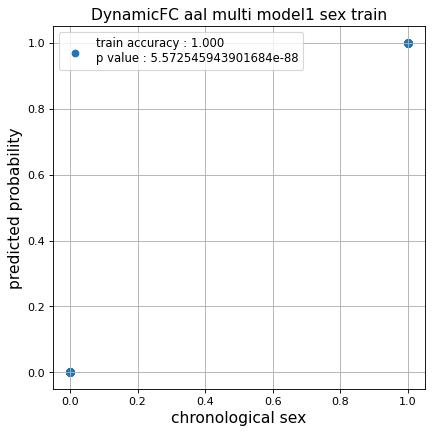

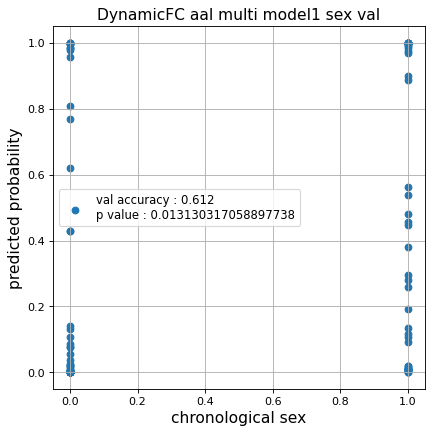

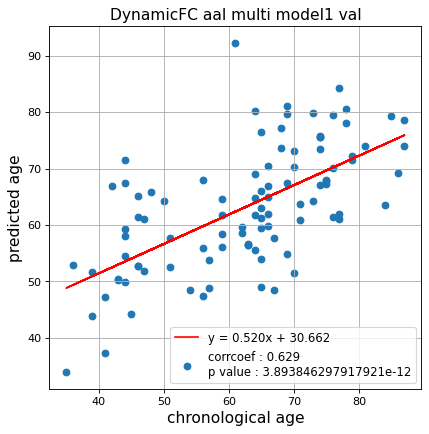

切片: 30.661535532195884
傾き: 0.5198806767344548
Kfold: 4 ::: epoch: 100, loss: 0.03187498235358642, val loss: 0.5481871888041496
Kfold: 4 ::: epoch: 200, loss: 0.021035347277155288, val loss: 0.5438679158687592
Kfold: 4 ::: epoch: 300, loss: 0.012083074937646206, val loss: 0.547079548239708
Kfold: 4 ::: epoch: 400, loss: 0.008077373925166635, val loss: 0.5840067267417908
Kfold: 4 ::: epoch: 500, loss: 0.00700002358868145, val loss: 0.5707507431507111
Kfold: 4 ::: epoch: 600, loss: 0.006379909741763885, val loss: 0.5520948618650436
Kfold: 4 ::: epoch: 700, loss: 0.006196283323403735, val loss: 0.5770001709461212
save_epochs:353
best val loss:0.5246835798025131


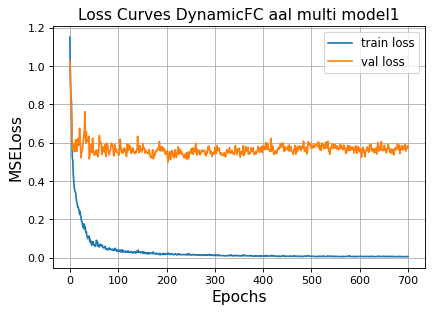

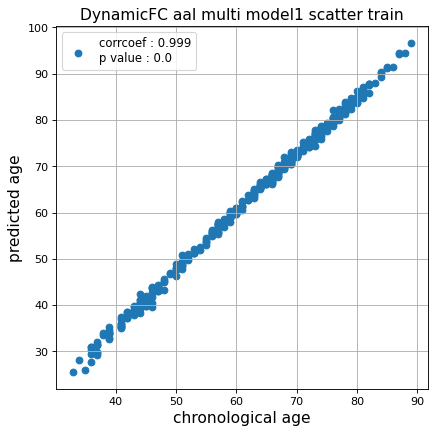

r^2 train data:  0.9318043238136583


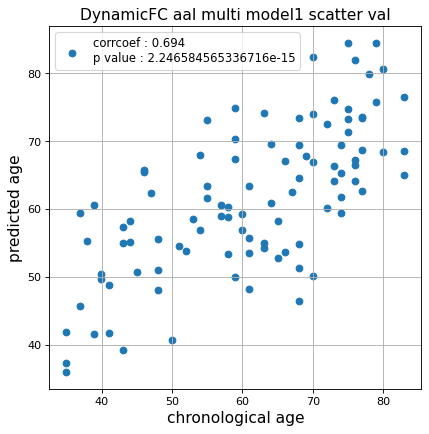

r^2 val data:  0.46932562159799185


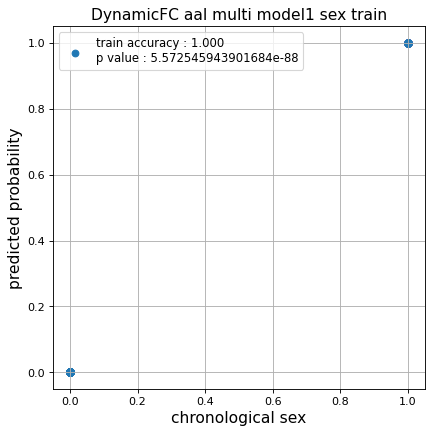

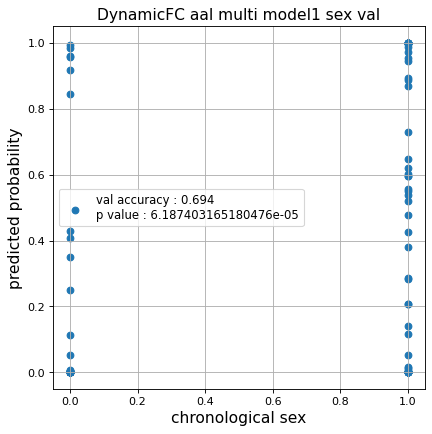

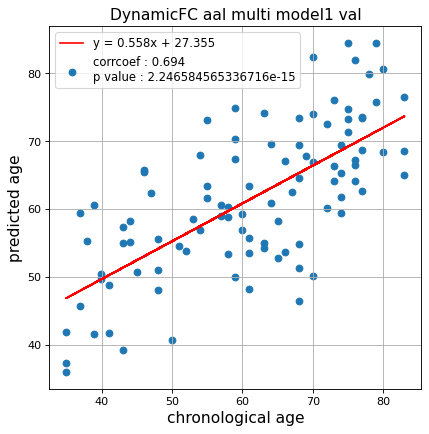

切片: 27.355178356979934
傾き: 0.5580423867886262
Kfold: 5 ::: epoch: 100, loss: 0.03864597213956026, val loss: 0.8591561168432236
Kfold: 5 ::: epoch: 200, loss: 0.016981803238964997, val loss: 0.8753312528133392
Kfold: 5 ::: epoch: 300, loss: 0.010524039586576132, val loss: 0.8764326572418213
Kfold: 5 ::: epoch: 400, loss: 0.008165389048652006, val loss: 0.8766524791717529
Kfold: 5 ::: epoch: 500, loss: 0.006512709678365634, val loss: 0.9218793362379074
Kfold: 5 ::: epoch: 600, loss: 0.0060298669940003985, val loss: 0.9462527632713318
Kfold: 5 ::: epoch: 700, loss: 0.004734709196222516, val loss: 0.9721453338861465
save_epochs:273
best val loss:0.8024044036865234


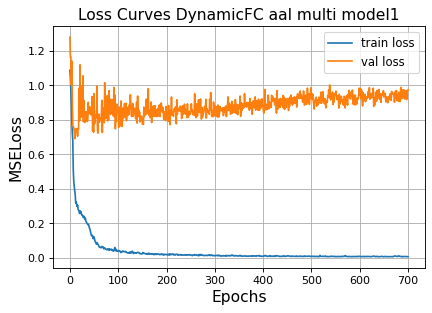

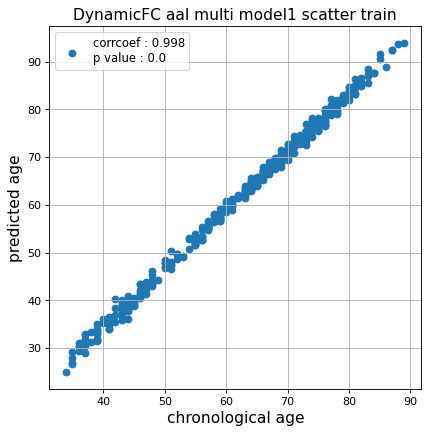

r^2 train data:  0.9423137517371809


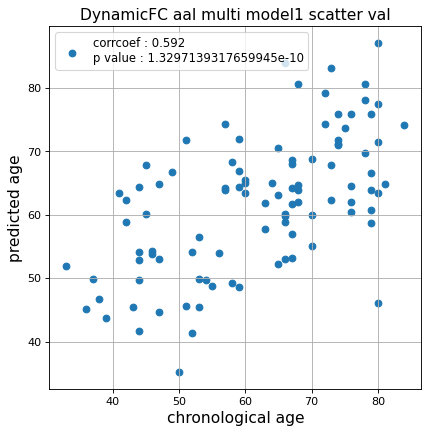

r^2 val data:  0.3016927307603524


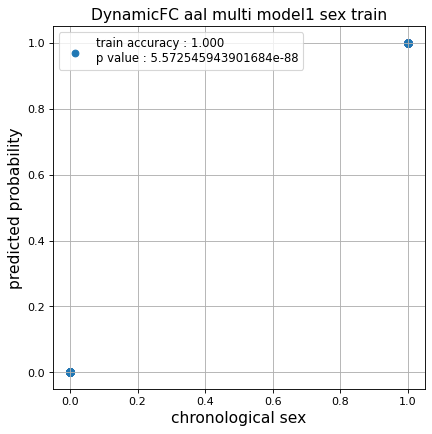

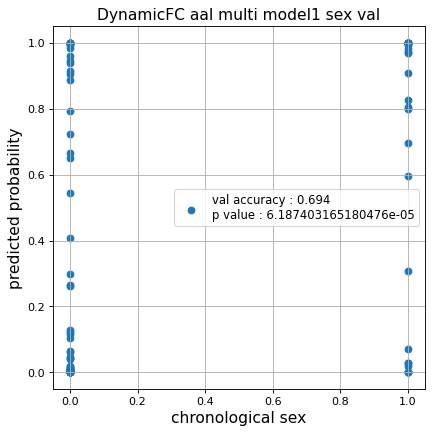

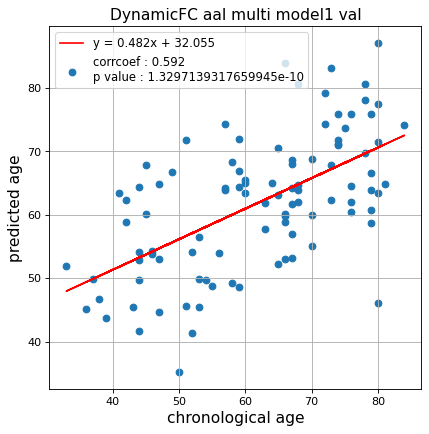

切片: 32.05535930966967
傾き: 0.48201493575766696
CPU times: user 1d 4h 40min 36s, sys: 2min 7s, total: 1d 4h 42min 43s
Wall time: 4h 7min 55s


In [18]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_all_dynamic_1  = []
test_pred_aal_all_dynamic_inverse_1  = []
test_label_aal_all_dynamic_1 = []

test_idx_aal_all_dynamic_1   = []
train_idx_aal_all_dynamic_1  = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_inverse,test_label = train_model(data_dynamic_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop    = 0.3,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC aal multi model1'
                                                          )
    
    test_pred_aal_all_dynamic_1.append(test_pred)
    test_pred_aal_all_dynamic_inverse_1.append(test_pred_inverse)
    test_label_aal_all_dynamic_1.append(test_label)

    test_idx_aal_all_dynamic_1.append(test_idx)
    train_idx_aal_all_dynamic_1.append(train_idx)

### Dynamic FC 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.036697788880421564, val loss: 0.5819439962506294
Kfold: 1 ::: epoch: 200, loss: 0.022002501986347713, val loss: 0.568405706435442
Kfold: 1 ::: epoch: 300, loss: 0.01405801667043796, val loss: 0.56525669246912
Kfold: 1 ::: epoch: 400, loss: 0.008344720690869369, val loss: 0.5666269958019257
Kfold: 1 ::: epoch: 500, loss: 0.006507573147805838, val loss: 0.5801246576011181
Kfold: 1 ::: epoch: 600, loss: 0.0061718141301893275, val loss: 0.5777450054883957
Kfold: 1 ::: epoch: 700, loss: 0.004850929799991159, val loss: 0.5897212289273739
save_epochs:302
best val loss:0.5349586941301823


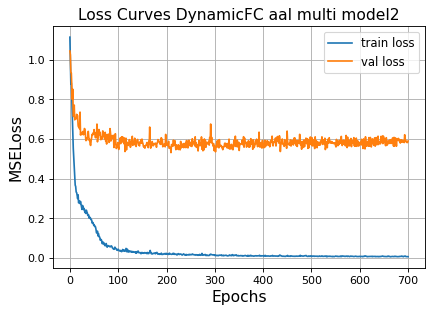

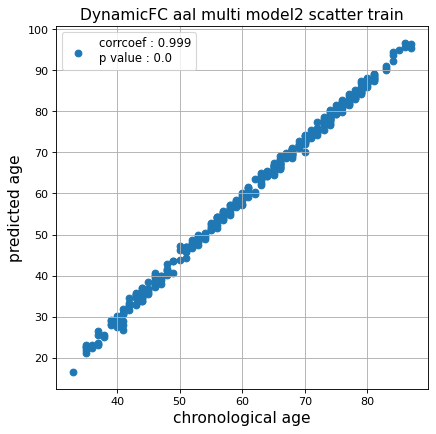

r^2 train data:  0.8018981679195202


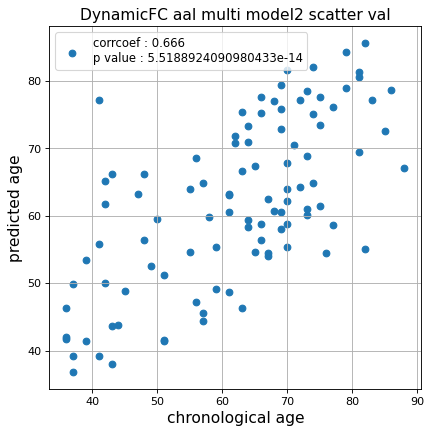

r^2 val data:  0.3886129283048302


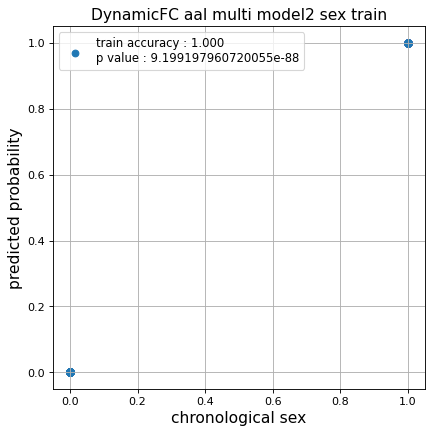

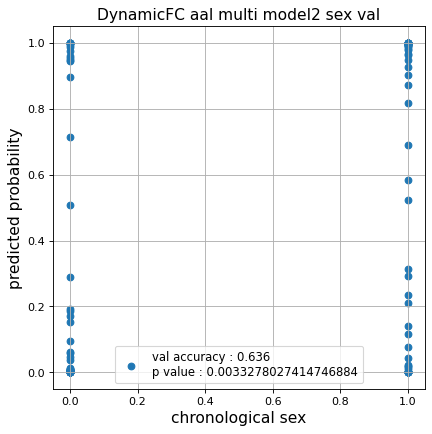

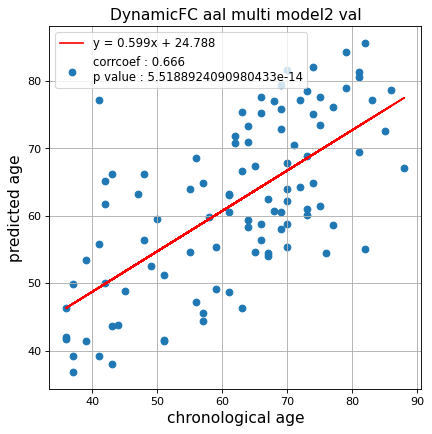

切片: 24.787962524999067
傾き: 0.5989583025951931
Kfold: 2 ::: epoch: 100, loss: 0.038170962379528925, val loss: 0.47778230160474777
Kfold: 2 ::: epoch: 200, loss: 0.01644229473402867, val loss: 0.47755635529756546
Kfold: 2 ::: epoch: 300, loss: 0.011842066207184242, val loss: 0.4776255935430527
Kfold: 2 ::: epoch: 400, loss: 0.008073510279735694, val loss: 0.47571614384651184
Kfold: 2 ::: epoch: 500, loss: 0.006383943102824001, val loss: 0.49402283877134323
Kfold: 2 ::: epoch: 600, loss: 0.006941890415663903, val loss: 0.503069531172514
Kfold: 2 ::: epoch: 700, loss: 0.004378413562125598, val loss: 0.4794614613056183
save_epochs:326
best val loss:0.4575263485312462


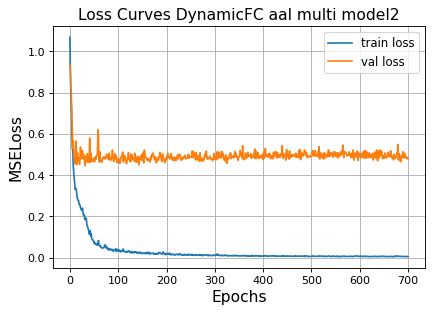

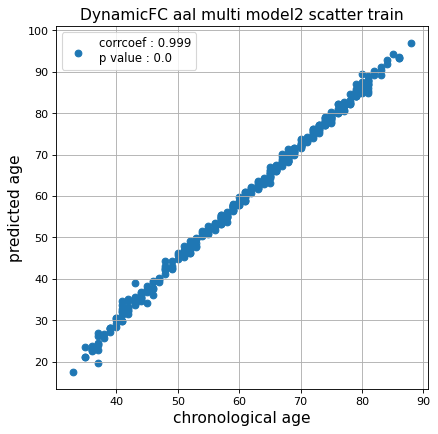

r^2 train data:  0.8272034126600083


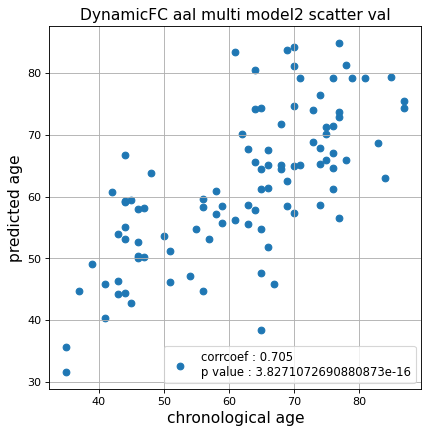

r^2 val data:  0.46353319801518145


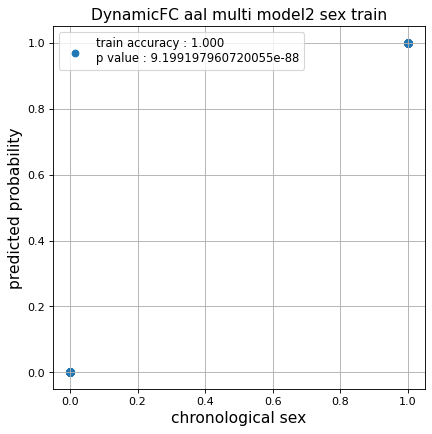

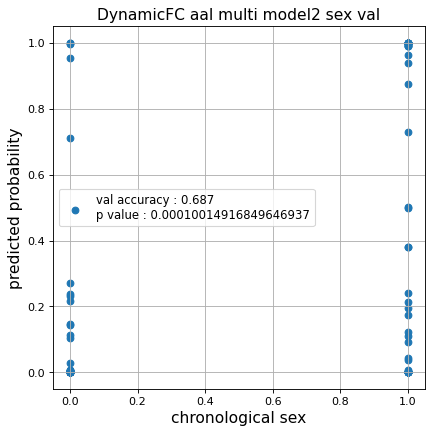

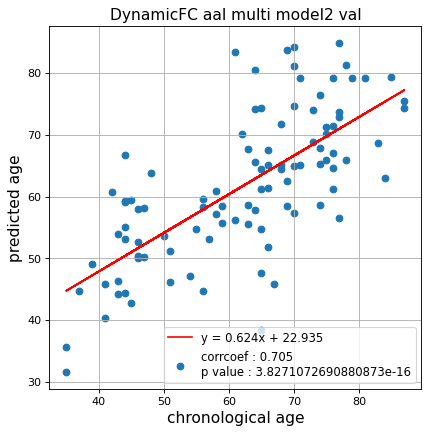

切片: 22.93519328469455
傾き: 0.6238722697756671
Kfold: 3 ::: epoch: 100, loss: 0.03482108520200619, val loss: 0.5415785498917103
Kfold: 3 ::: epoch: 200, loss: 0.021901659810772307, val loss: 0.5035292049869895
Kfold: 3 ::: epoch: 300, loss: 0.012985540303186728, val loss: 0.5150192806031555
Kfold: 3 ::: epoch: 400, loss: 0.007113972428039863, val loss: 0.5433029127307236
Kfold: 3 ::: epoch: 500, loss: 0.007204064024755588, val loss: 0.5456644686637446
Kfold: 3 ::: epoch: 600, loss: 0.01721316661972266, val loss: 0.5347641697153449
Kfold: 3 ::: epoch: 700, loss: 0.006485381915878791, val loss: 0.5602591775823385
save_epochs:279
best val loss:0.4982813603710383


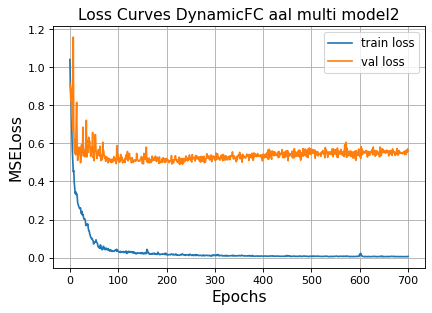

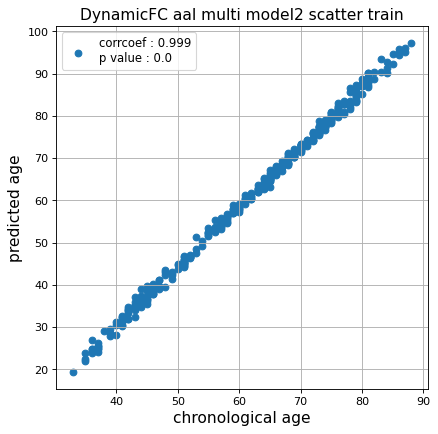

r^2 train data:  0.8280491328514767


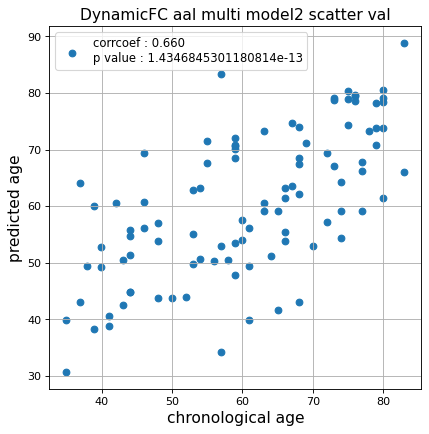

r^2 val data:  0.35320899752324997


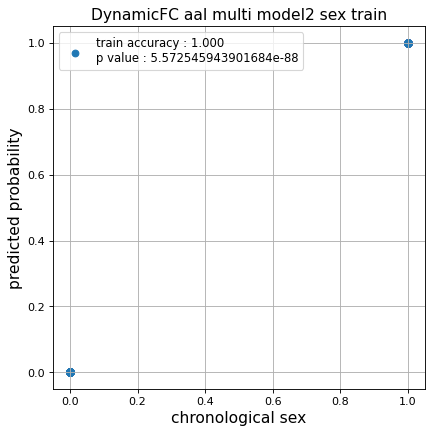

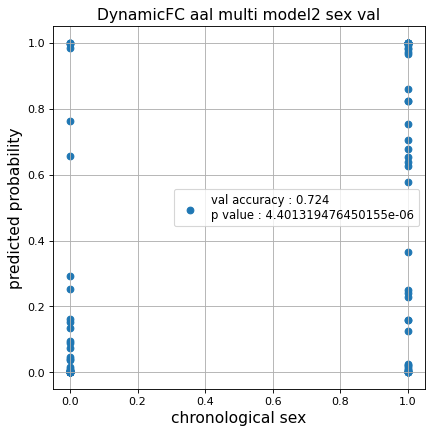

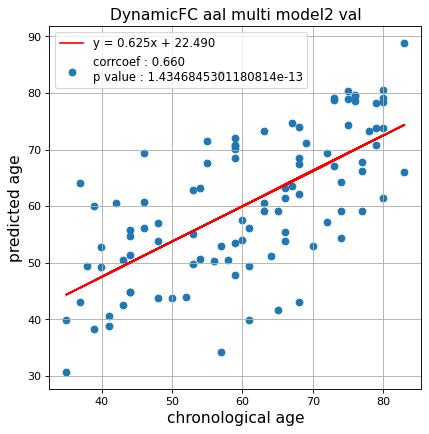

切片: 22.489630884835044
傾き: 0.6248913131946617
Kfold: 4 ::: epoch: 100, loss: 0.0384930634441284, val loss: 0.7795886546373367
Kfold: 4 ::: epoch: 200, loss: 0.017383188725664064, val loss: 0.6827346533536911
Kfold: 4 ::: epoch: 300, loss: 0.010257257865025448, val loss: 0.6573163121938705
Kfold: 4 ::: epoch: 400, loss: 0.007526936403547342, val loss: 0.640035480260849
Kfold: 4 ::: epoch: 500, loss: 0.00782074284954713, val loss: 0.6300718411803246
Kfold: 4 ::: epoch: 600, loss: 0.004903887308990726, val loss: 0.677783265709877
Kfold: 4 ::: epoch: 700, loss: 0.00521006490677022, val loss: 0.6725627928972244
save_epochs:277
best val loss:0.5725174471735954


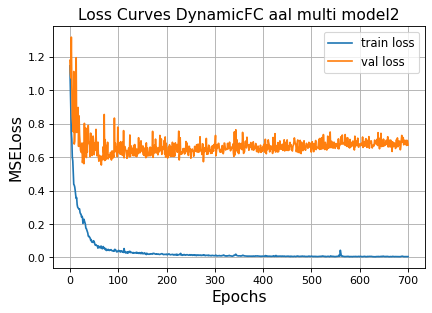

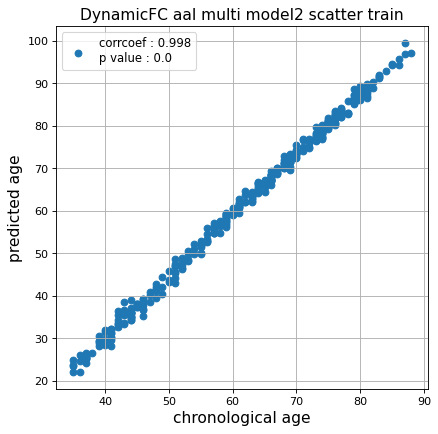

r^2 train data:  0.8096922186663251


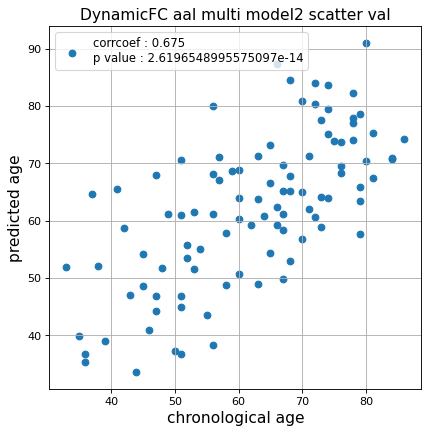

r^2 val data:  0.3643121547035544


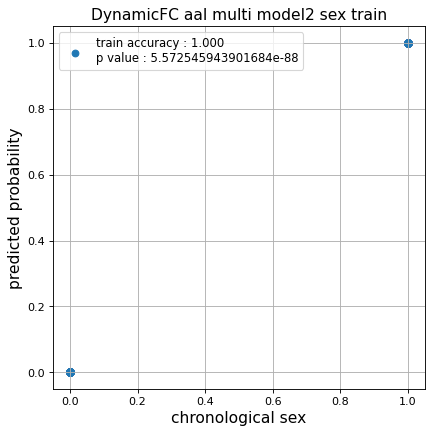

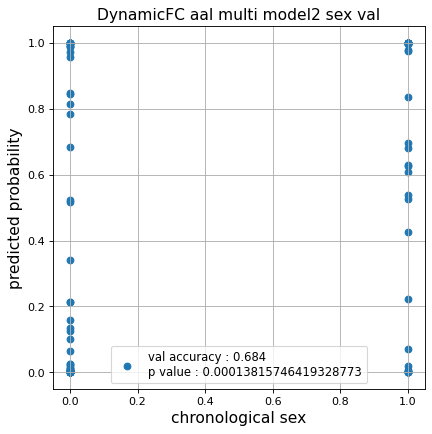

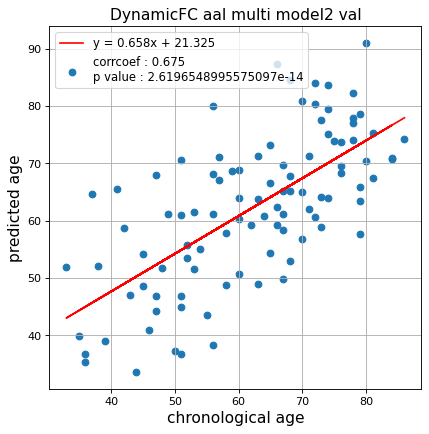

切片: 21.324922239908325
傾き: 0.6582937032930892
Kfold: 5 ::: epoch: 100, loss: 0.041735207805266746, val loss: 0.6762298345565796
Kfold: 5 ::: epoch: 200, loss: 0.01735703432216094, val loss: 0.5770419500768185
Kfold: 5 ::: epoch: 300, loss: 0.010095857083797455, val loss: 0.6120993494987488
Kfold: 5 ::: epoch: 400, loss: 0.008020324919086236, val loss: 0.5901729464530945
Kfold: 5 ::: epoch: 500, loss: 0.007126527659308452, val loss: 0.5834129601716995
Kfold: 5 ::: epoch: 600, loss: 0.005196072161197662, val loss: 0.5763088837265968
Kfold: 5 ::: epoch: 700, loss: 0.005088685313239694, val loss: 0.5769315268844366
save_epochs:631
best val loss:0.5638087131083012


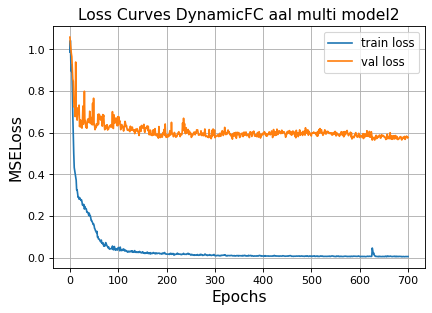

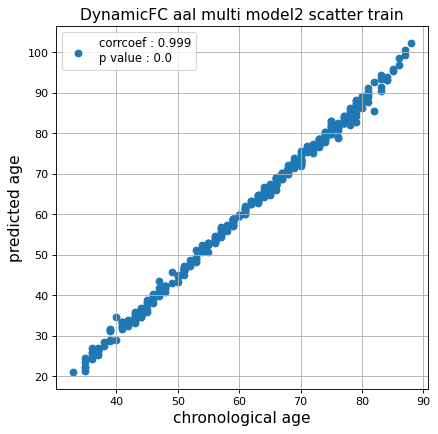

r^2 train data:  0.8098434166746633


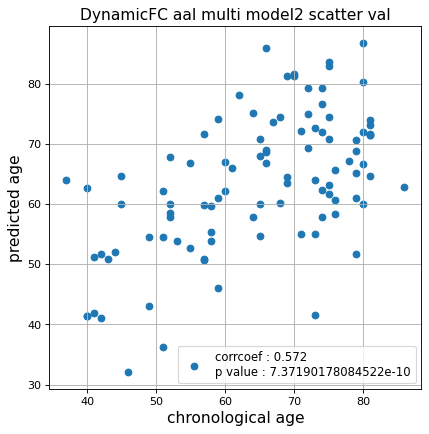

r^2 val data:  0.21588355106367674


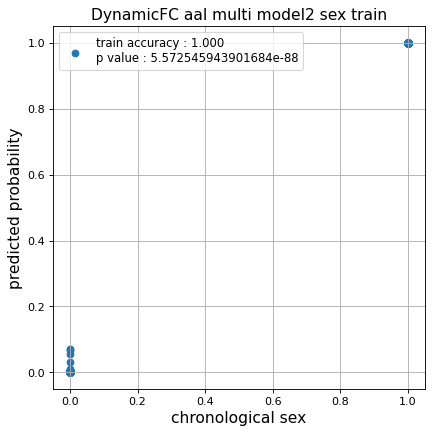

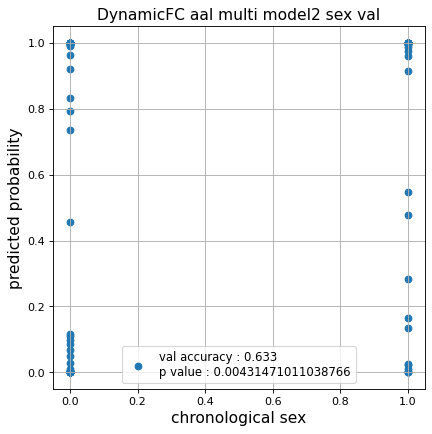

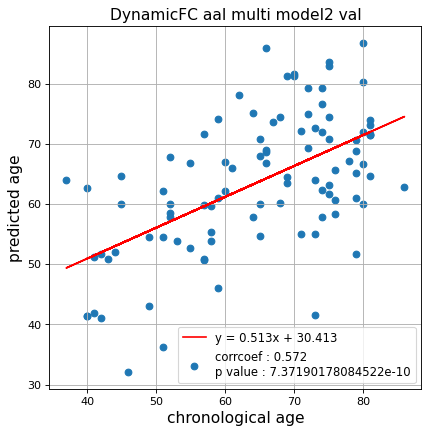

切片: 30.413006802257755
傾き: 0.5125989857410836
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.038338092513955556, val loss: 0.7563087493181229
Kfold: 1 ::: epoch: 200, loss: 0.021617942561323825, val loss: 0.751277357339859
Kfold: 1 ::: epoch: 300, loss: 0.016819109638723042, val loss: 0.7931079566478729
Kfold: 1 ::: epoch: 400, loss: 0.008928440081385465, val loss: 0.8235217332839966
Kfold: 1 ::: epoch: 500, loss: 0.006318955144916589, val loss: 0.8267849832773209
Kfold: 1 ::: epoch: 600, loss: 0.006531480413216811, val loss: 0.8785976320505142
Kfold: 1 ::: epoch: 700, loss: 0.0045709438048876245, val loss: 0.8612930029630661
save_epochs:258
best val loss:0.7396490722894669


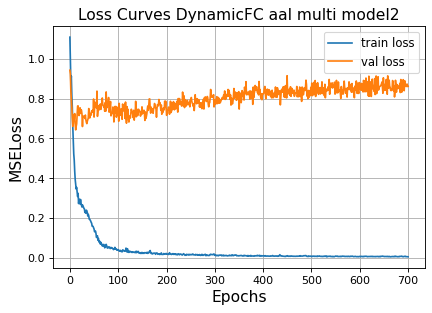

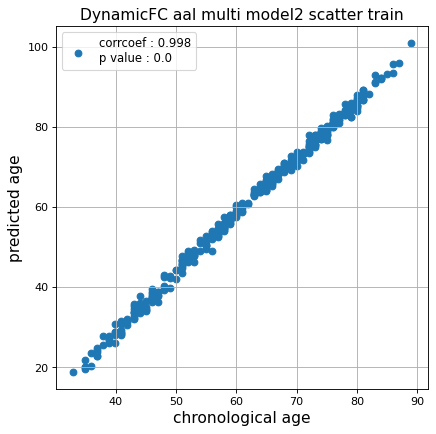

r^2 train data:  0.7957877245840427


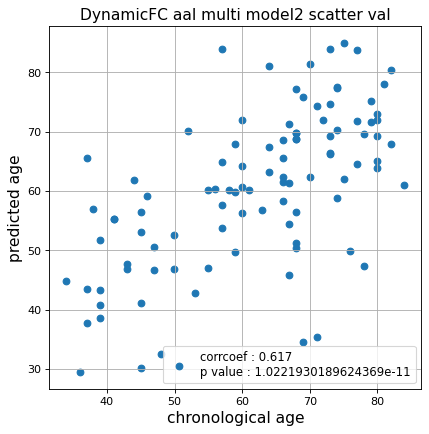

r^2 val data:  0.2607091522902051


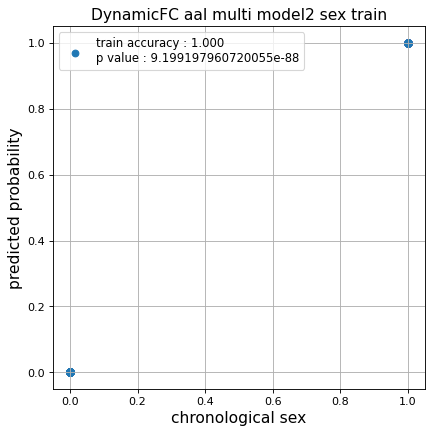

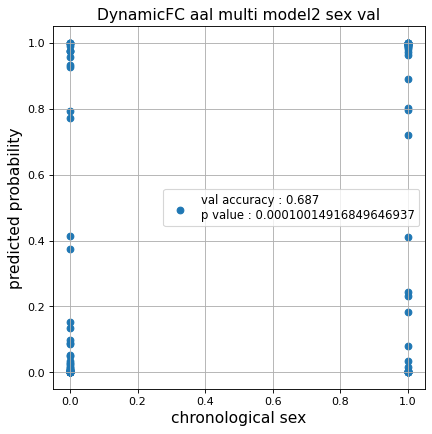

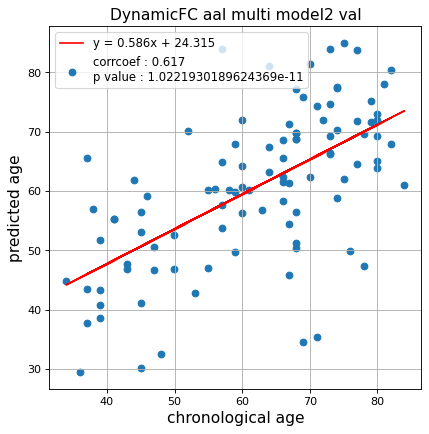

切片: 24.315148701586807
傾き: 0.5855085760388788
Kfold: 2 ::: epoch: 100, loss: 0.04794278067465012, val loss: 0.5826409533619881
Kfold: 2 ::: epoch: 200, loss: 0.015820978567577325, val loss: 0.6117548123002052
Kfold: 2 ::: epoch: 300, loss: 0.011821366273439847, val loss: 0.6376253738999367
Kfold: 2 ::: epoch: 400, loss: 0.008205704623833299, val loss: 0.65428476780653
Kfold: 2 ::: epoch: 500, loss: 0.005365931088677966, val loss: 0.672578439116478
Kfold: 2 ::: epoch: 600, loss: 0.005738126257291207, val loss: 0.6814359948039055
Kfold: 2 ::: epoch: 700, loss: 0.004183990334590467, val loss: 0.6476476863026619
save_epochs:307
best val loss:0.6019989624619484


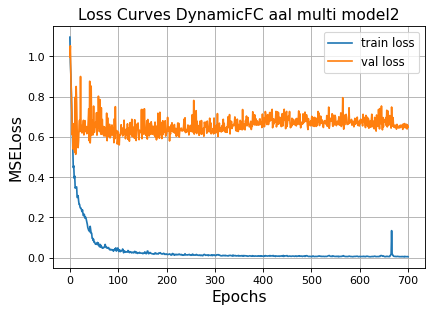

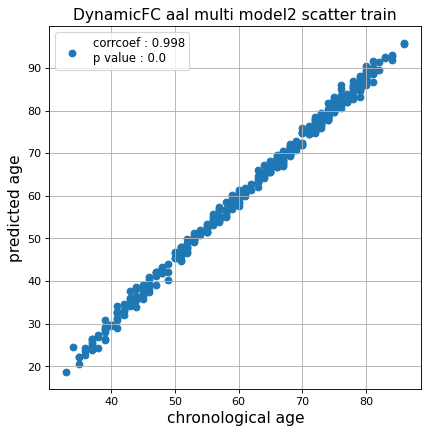

r^2 train data:  0.803727901752242


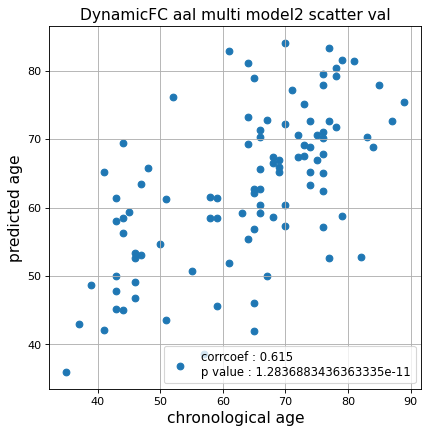

r^2 val data:  0.32135580089684446


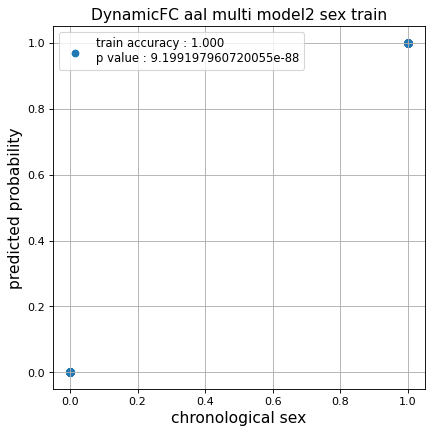

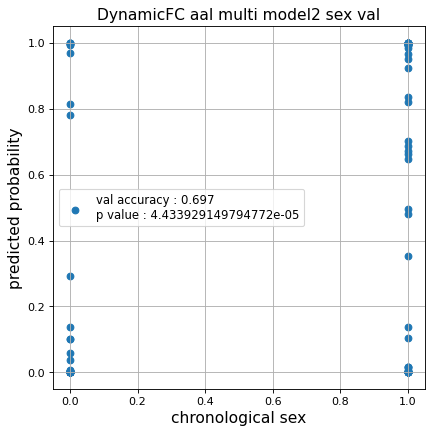

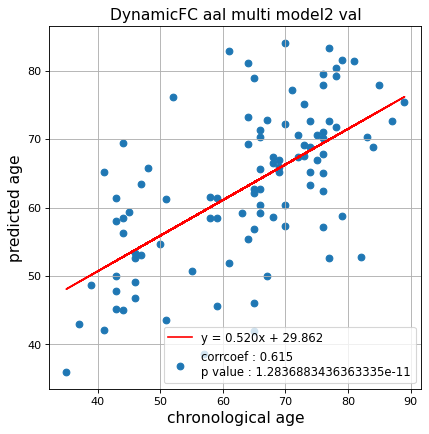

切片: 29.862259706144343
傾き: 0.5203451872165782
Kfold: 3 ::: epoch: 100, loss: 0.03721465772161117, val loss: 0.5882430896162987
Kfold: 3 ::: epoch: 200, loss: 0.021083363260214146, val loss: 0.5235081762075424
Kfold: 3 ::: epoch: 300, loss: 0.013808237245449653, val loss: 0.5187100619077682
Kfold: 3 ::: epoch: 400, loss: 0.008732416917784857, val loss: 0.52723029255867
Kfold: 3 ::: epoch: 500, loss: 0.00815020426391409, val loss: 0.5437200888991356
Kfold: 3 ::: epoch: 600, loss: 0.007615741127385543, val loss: 0.5353377275168896
Kfold: 3 ::: epoch: 700, loss: 0.006237323807839017, val loss: 0.5938680991530418
save_epochs:345
best val loss:0.48216167464852333


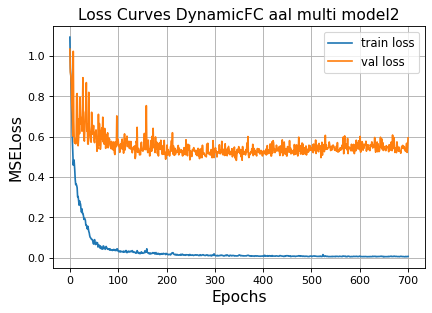

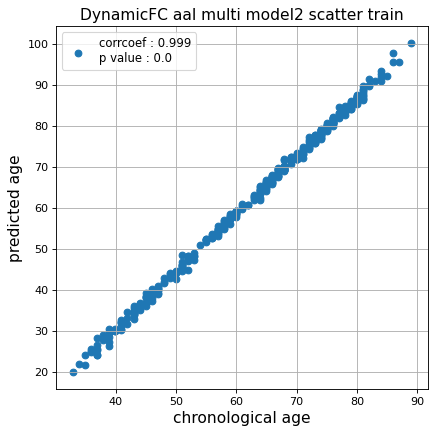

r^2 train data:  0.8284010149293287


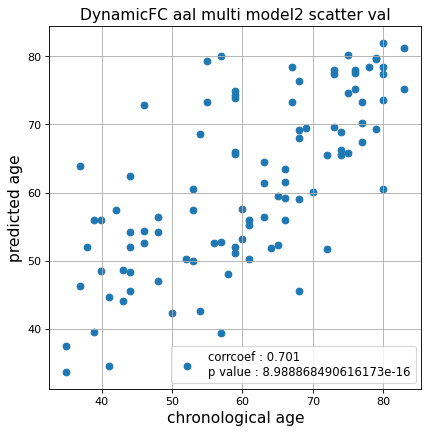

r^2 val data:  0.44206484516404054


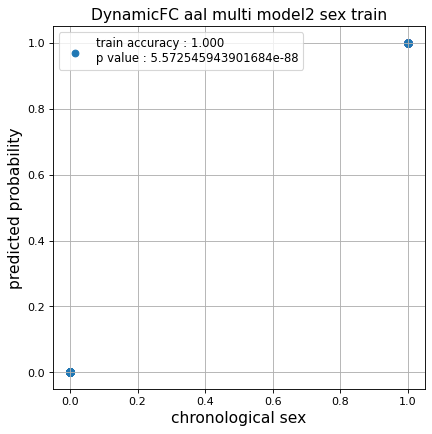

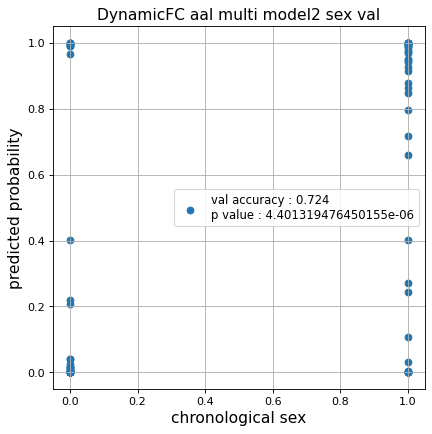

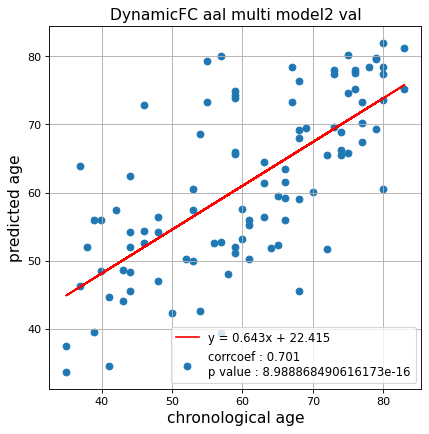

切片: 22.41543962990255
傾き: 0.6428245188968932
Kfold: 4 ::: epoch: 100, loss: 0.03551140757134327, val loss: 0.8767488300800323
Kfold: 4 ::: epoch: 200, loss: 0.01834853136768708, val loss: 0.9142724573612213
Kfold: 4 ::: epoch: 300, loss: 0.01092964754654811, val loss: 0.9359392374753952
Kfold: 4 ::: epoch: 400, loss: 0.009356037928507878, val loss: 0.9365857690572739
Kfold: 4 ::: epoch: 500, loss: 0.007131646673839826, val loss: 0.8777980506420135
Kfold: 4 ::: epoch: 600, loss: 0.005274666688190057, val loss: 0.9135059416294098
Kfold: 4 ::: epoch: 700, loss: 0.005122894886881113, val loss: 0.9417750835418701
save_epochs:350
best val loss:0.8617650717496872


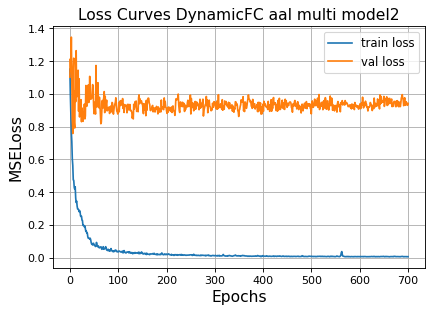

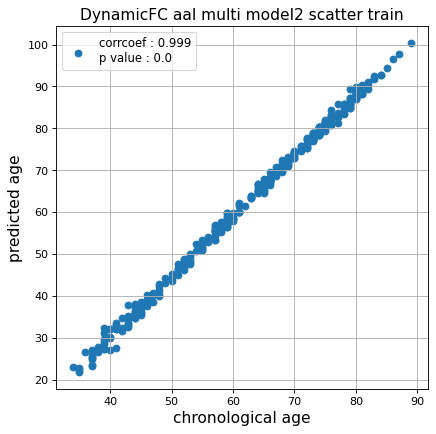

r^2 train data:  0.7998364296889653


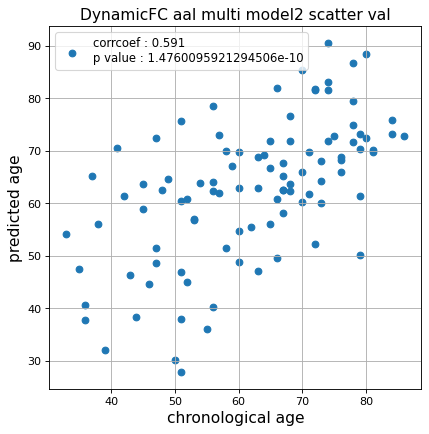

r^2 val data:  0.18271034767215055


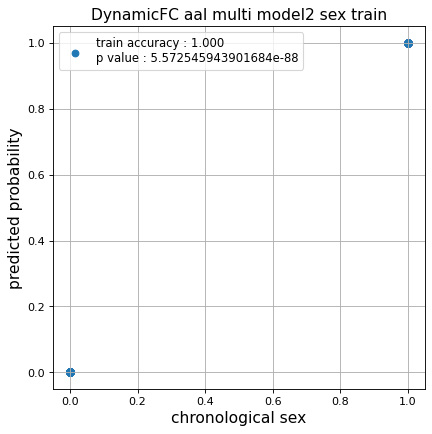

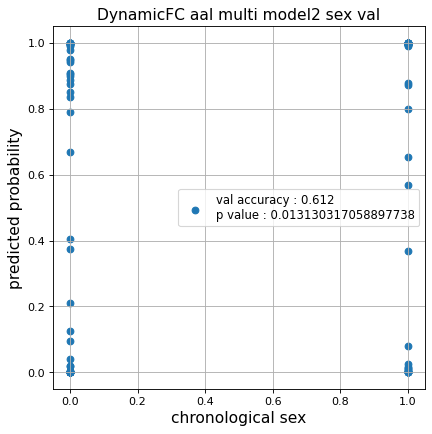

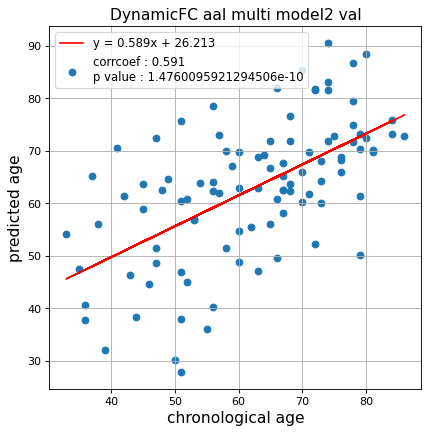

切片: 26.21324964984128
傾き: 0.5887367666513297
Kfold: 5 ::: epoch: 100, loss: 0.038591510544602685, val loss: 0.6665168106555939
Kfold: 5 ::: epoch: 200, loss: 0.01773592887016443, val loss: 0.575073167681694
Kfold: 5 ::: epoch: 300, loss: 0.009749741651690923, val loss: 0.7144797295331955
Kfold: 5 ::: epoch: 400, loss: 0.008196044569978347, val loss: 0.7275408208370209
Kfold: 5 ::: epoch: 500, loss: 0.0070940124659011, val loss: 0.705607458949089
Kfold: 5 ::: epoch: 600, loss: 0.006018968979613139, val loss: 0.7149999886751175
Kfold: 5 ::: epoch: 700, loss: 0.004776496493902344, val loss: 0.7239769846200943
save_epochs:280
best val loss:0.6005513593554497


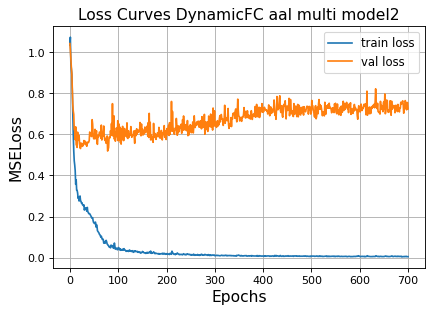

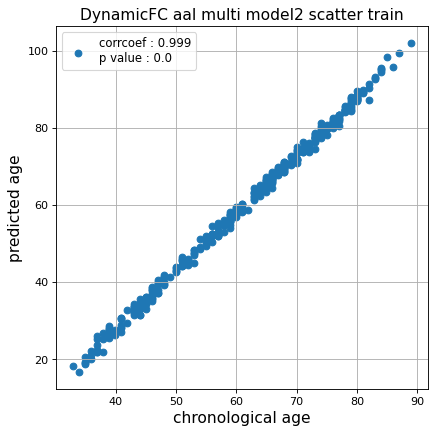

r^2 train data:  0.7430994452583835


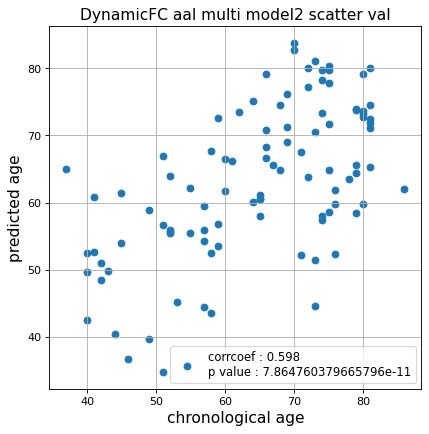

r^2 val data:  0.26168678937711365


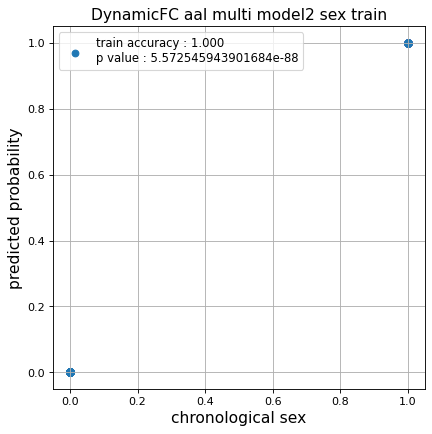

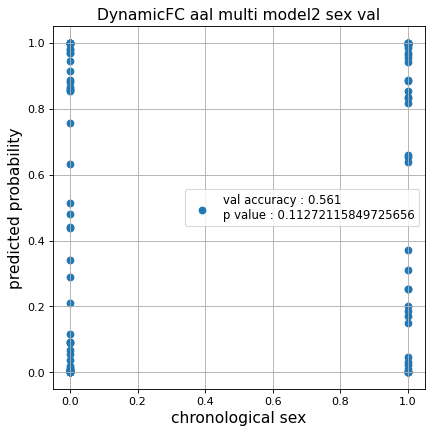

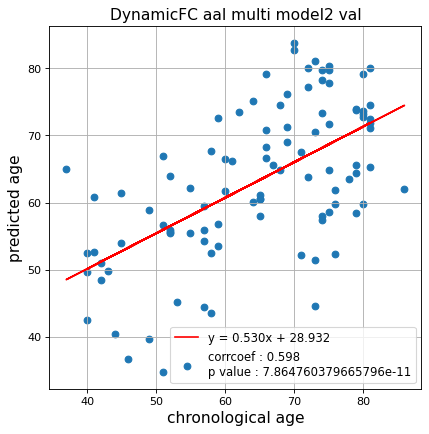

切片: 28.931945727059897
傾き: 0.5295010122757452
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.034702409202089675, val loss: 0.6869840323925018
Kfold: 1 ::: epoch: 200, loss: 0.019734088904582538, val loss: 0.7457864284515381
Kfold: 1 ::: epoch: 300, loss: 0.015120588780309144, val loss: 0.8382586389780045
Kfold: 1 ::: epoch: 400, loss: 0.010485117574437307, val loss: 0.8367158025503159
Kfold: 1 ::: epoch: 500, loss: 0.007029002209982047, val loss: 0.8533588498830795
Kfold: 1 ::: epoch: 600, loss: 0.0057664171685106475, val loss: 0.8547284007072449
Kfold: 1 ::: epoch: 700, loss: 0.005022956076293037, val loss: 0.8621748387813568
save_epochs:251
best val loss:0.7357278317213058


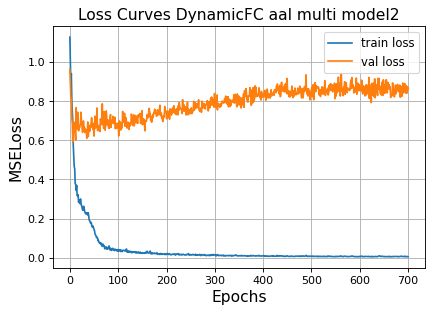

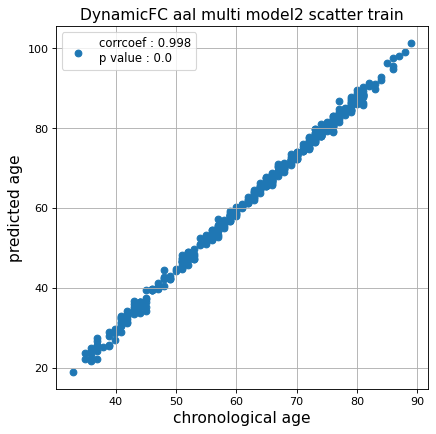

r^2 train data:  0.8041352263835255


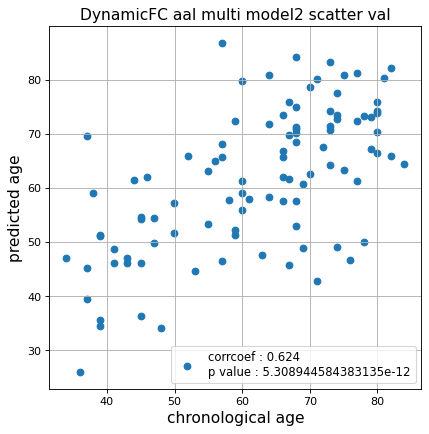

r^2 val data:  0.27799824084978786


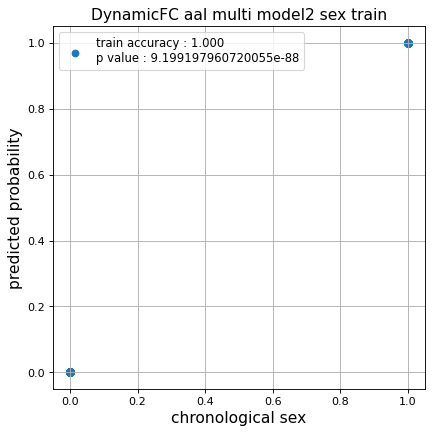

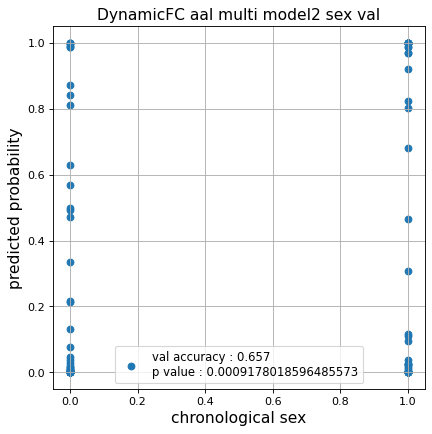

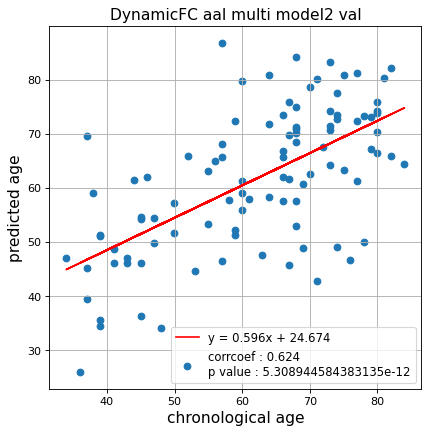

切片: 24.674318788014865
傾き: 0.5963983795688299
Kfold: 2 ::: epoch: 100, loss: 0.041727397877436415, val loss: 0.6193038448691368
Kfold: 2 ::: epoch: 200, loss: 0.015972183014337834, val loss: 0.6199803873896599
Kfold: 2 ::: epoch: 300, loss: 0.01171364112255665, val loss: 0.6509865969419479
Kfold: 2 ::: epoch: 400, loss: 0.008224506862461567, val loss: 0.6774085983633995
Kfold: 2 ::: epoch: 500, loss: 0.005888011843825762, val loss: 0.688949704170227
Kfold: 2 ::: epoch: 600, loss: 0.0053138550317201475, val loss: 0.7179174274206161
Kfold: 2 ::: epoch: 700, loss: 0.005013207591568621, val loss: 0.7065657675266266
save_epochs:258
best val loss:0.6053576767444611


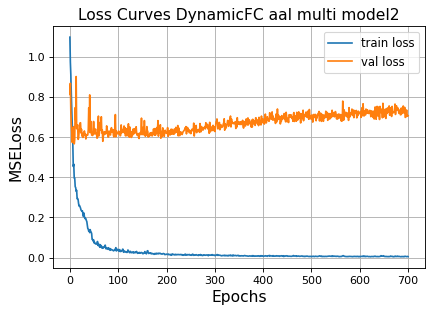

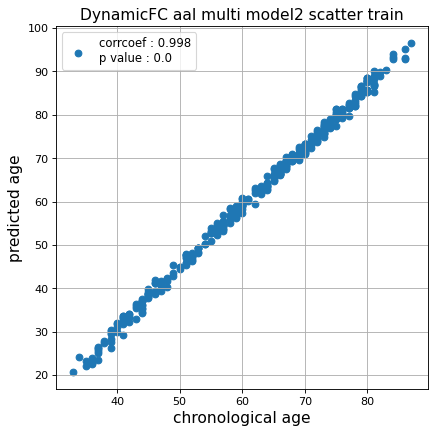

r^2 train data:  0.8413913570988738


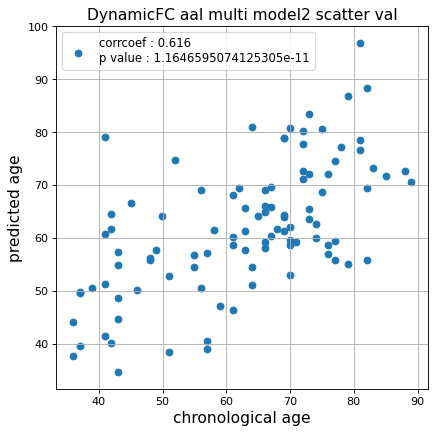

r^2 val data:  0.3093023167318195


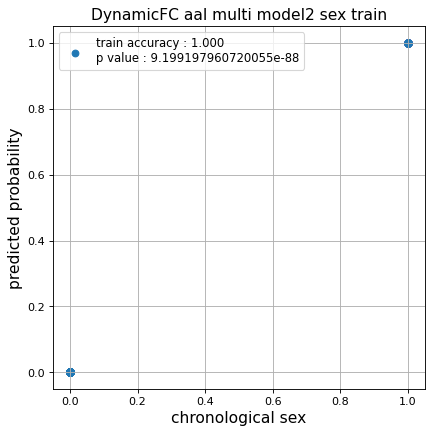

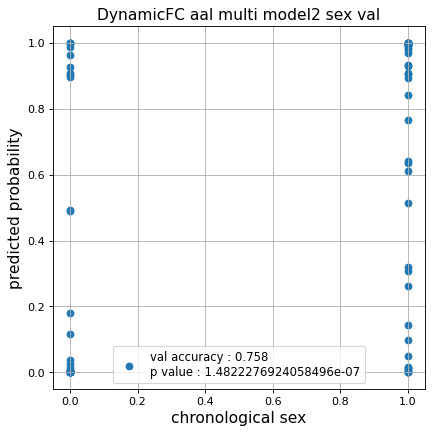

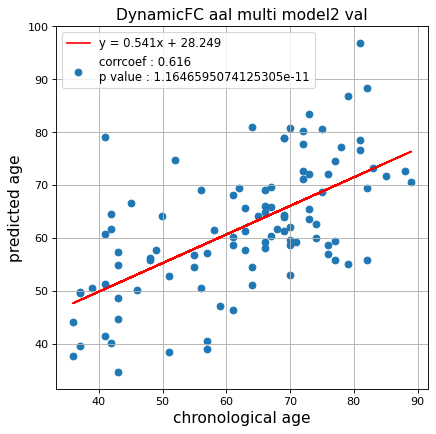

切片: 28.249180271852275
傾き: 0.5405529767533288
Kfold: 3 ::: epoch: 100, loss: 0.03645558669590033, val loss: 0.697417140007019
Kfold: 3 ::: epoch: 200, loss: 0.01934134730925927, val loss: 0.6306894570589066
Kfold: 3 ::: epoch: 300, loss: 0.01326342041675861, val loss: 0.5965179800987244
Kfold: 3 ::: epoch: 400, loss: 0.00950147326175983, val loss: 0.6165803223848343
Kfold: 3 ::: epoch: 500, loss: 0.0063387697849136134, val loss: 0.6150284111499786
Kfold: 3 ::: epoch: 600, loss: 0.006303600680369597, val loss: 0.5968006700277328
Kfold: 3 ::: epoch: 700, loss: 0.005573006364731834, val loss: 0.6340504884719849
save_epochs:576
best val loss:0.5565819442272186


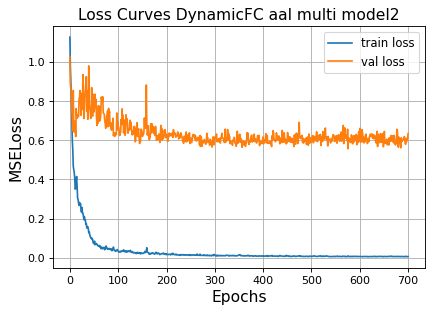

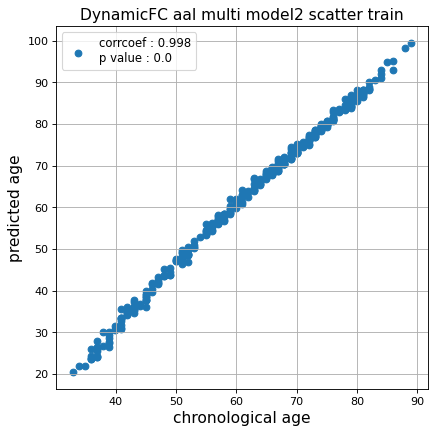

r^2 train data:  0.8391749059704767


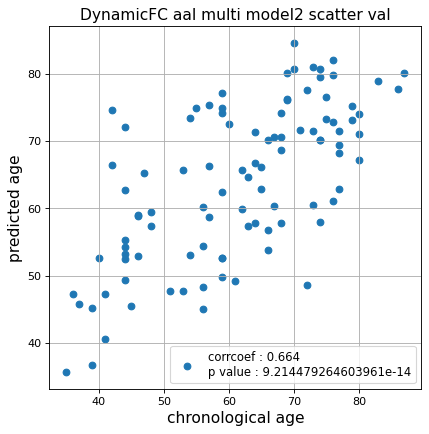

r^2 val data:  0.35917629375941607


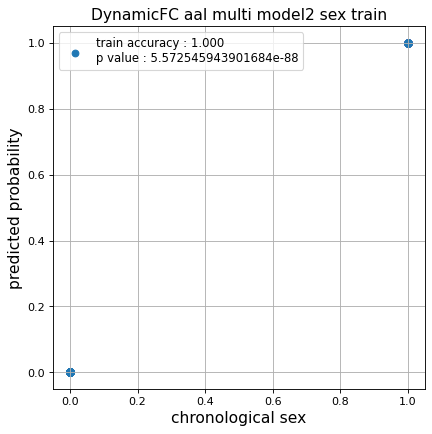

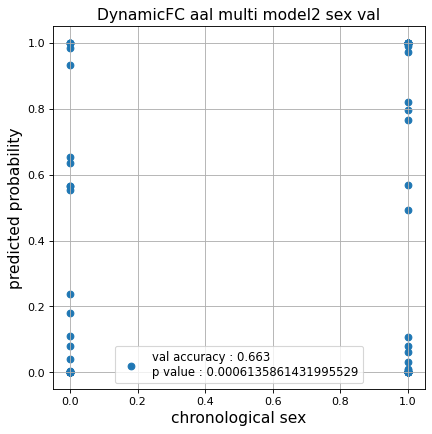

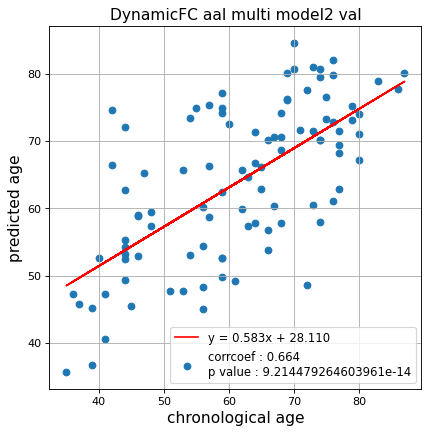

切片: 28.10981279861747
傾き: 0.5829211160600223
Kfold: 4 ::: epoch: 100, loss: 0.03510096425620409, val loss: 0.7795751392841339
Kfold: 4 ::: epoch: 200, loss: 0.017865213744628888, val loss: 0.7804315537214279
Kfold: 4 ::: epoch: 300, loss: 0.010987513841917882, val loss: 0.824333980679512
Kfold: 4 ::: epoch: 400, loss: 0.009437382149581727, val loss: 0.8517968952655792
Kfold: 4 ::: epoch: 500, loss: 0.007818742046275964, val loss: 0.8458532840013504
Kfold: 4 ::: epoch: 600, loss: 0.006976537872105837, val loss: 0.8448572307825089
Kfold: 4 ::: epoch: 700, loss: 0.005780561612202571, val loss: 0.9195615947246552
save_epochs:360
best val loss:0.7663922905921936


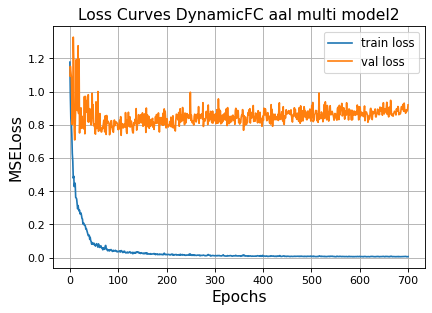

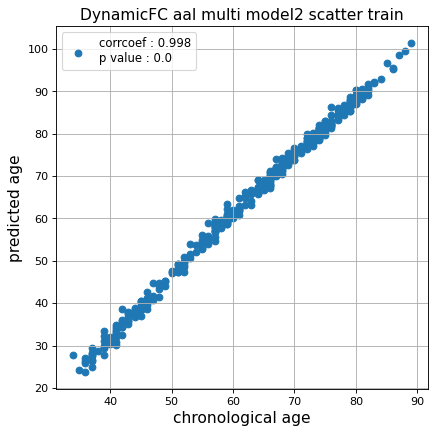

r^2 train data:  0.806572969476217


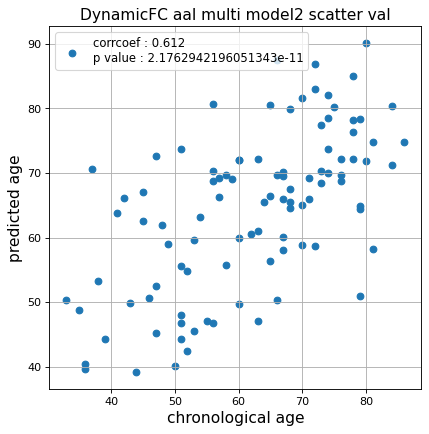

r^2 val data:  0.25053767413219286


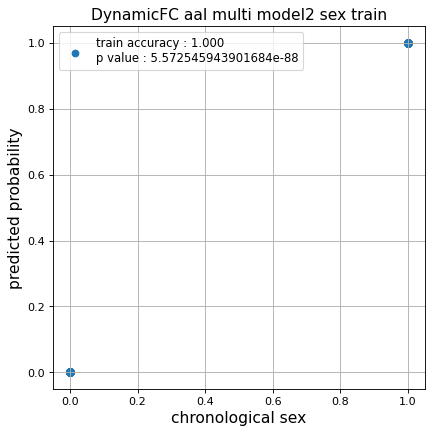

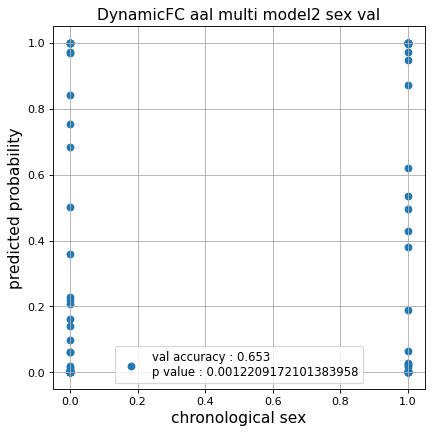

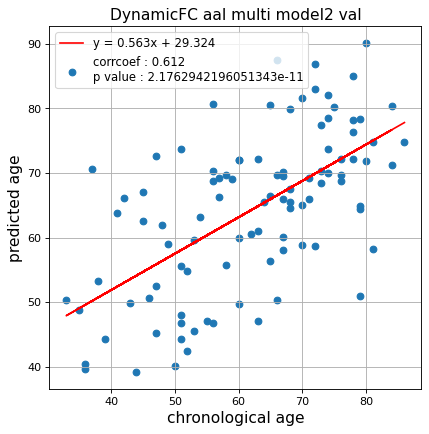

切片: 29.324234842017553
傾き: 0.563480276302104
Kfold: 5 ::: epoch: 100, loss: 0.04006452586215276, val loss: 0.6600324511528015
Kfold: 5 ::: epoch: 200, loss: 0.021640487445088532, val loss: 0.6320366933941841
Kfold: 5 ::: epoch: 300, loss: 0.009766672881176839, val loss: 0.6273828186094761
Kfold: 5 ::: epoch: 400, loss: 0.008672323364477891, val loss: 0.6119211986660957
Kfold: 5 ::: epoch: 500, loss: 0.005587323318020656, val loss: 0.630167605355382
Kfold: 5 ::: epoch: 600, loss: 0.0055494572286709, val loss: 0.6140503510832787
Kfold: 5 ::: epoch: 700, loss: 0.004707855548566351, val loss: 0.5792813636362553
save_epochs:692
best val loss:0.555900989100337


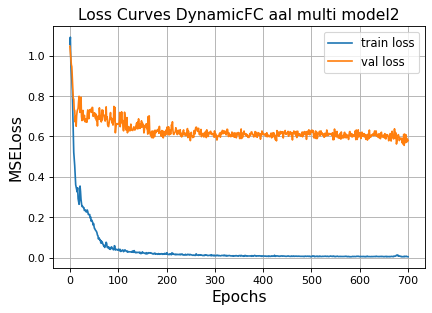

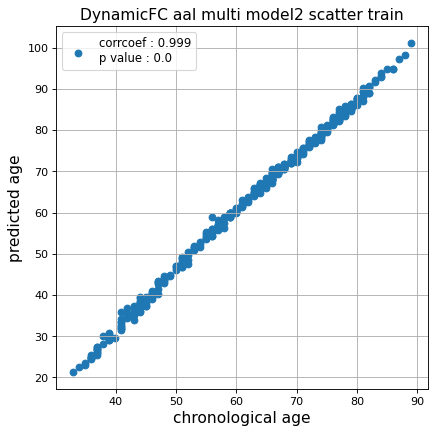

r^2 train data:  0.8390237822952195


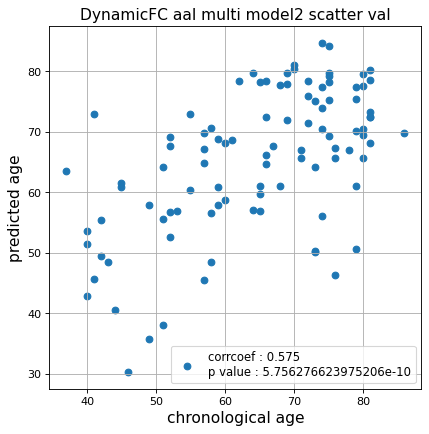

r^2 val data:  0.20917383485735053


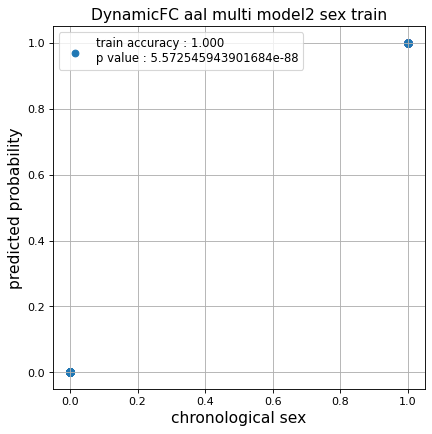

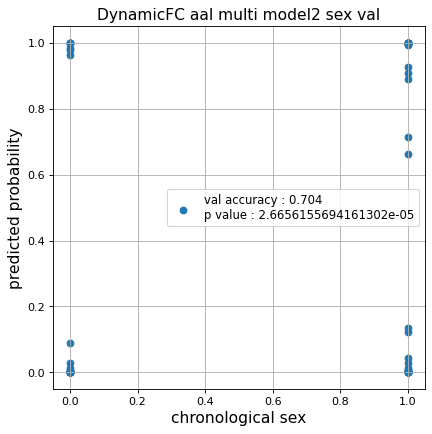

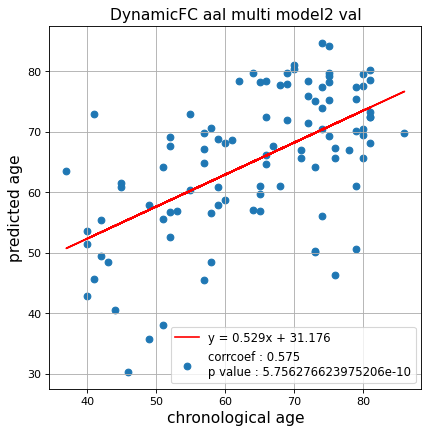

切片: 31.17604699762701
傾き: 0.5291327915333633
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.03698304947465658, val loss: 0.7381037324666977
Kfold: 1 ::: epoch: 200, loss: 0.020437308873694677, val loss: 0.7408671230077744
Kfold: 1 ::: epoch: 300, loss: 0.015189000333730992, val loss: 0.7584831193089485
Kfold: 1 ::: epoch: 400, loss: 0.011411749578725833, val loss: 0.8018506020307541
Kfold: 1 ::: epoch: 500, loss: 0.007017624904759801, val loss: 0.8085115626454353
Kfold: 1 ::: epoch: 600, loss: 0.005283151878617131, val loss: 0.7923475950956345
Kfold: 1 ::: epoch: 700, loss: 0.005015016443884144, val loss: 0.8077475726604462
save_epochs:268
best val loss:0.6879525780677795


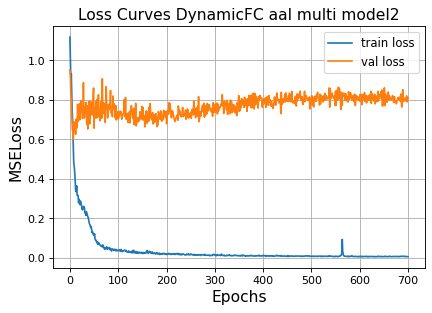

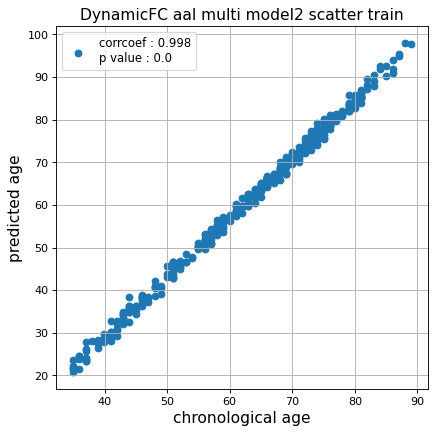

r^2 train data:  0.8208932123040735


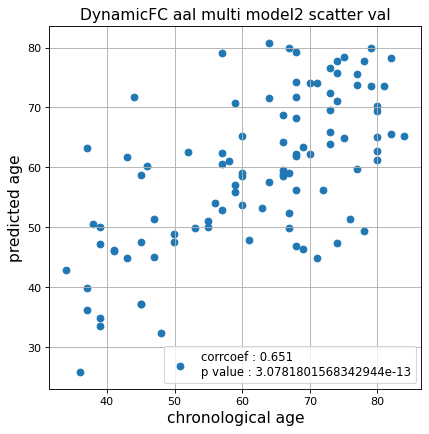

r^2 val data:  0.31601415069291905


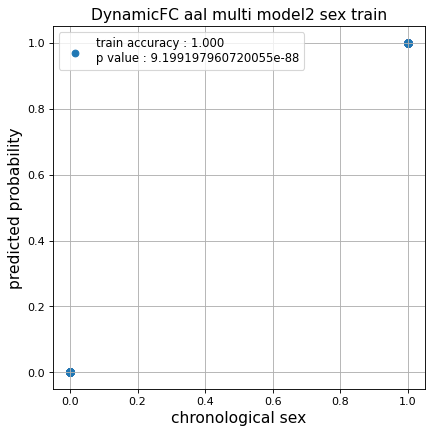

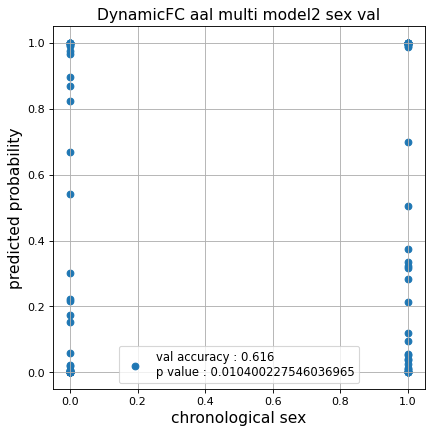

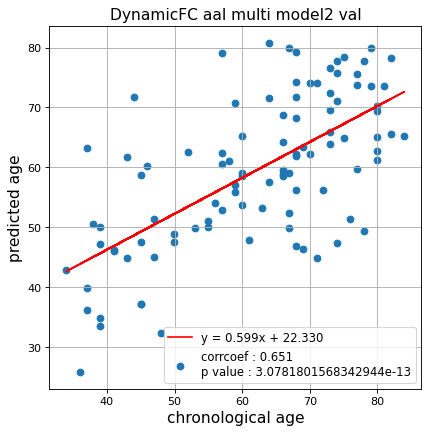

切片: 22.329509551061534
傾き: 0.598782091507593
Kfold: 2 ::: epoch: 100, loss: 0.03922336605878977, val loss: 0.6501726880669594
Kfold: 2 ::: epoch: 200, loss: 0.018155626522806976, val loss: 0.6341643780469894
Kfold: 2 ::: epoch: 300, loss: 0.015127303078770638, val loss: 0.7122853547334671
Kfold: 2 ::: epoch: 400, loss: 0.008726699635959588, val loss: 0.7783618420362473
Kfold: 2 ::: epoch: 500, loss: 0.006471861744872653, val loss: 0.7763622850179672
Kfold: 2 ::: epoch: 600, loss: 0.004883859521494462, val loss: 0.7929127216339111
Kfold: 2 ::: epoch: 700, loss: 0.005643209012655111, val loss: 0.8413691371679306
save_epochs:258
best val loss:0.6545789539813995


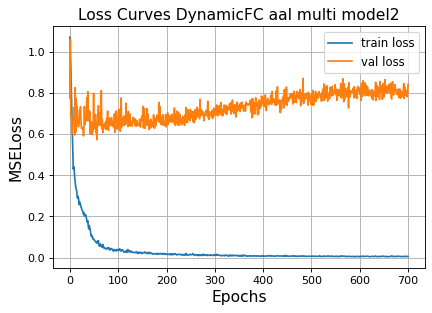

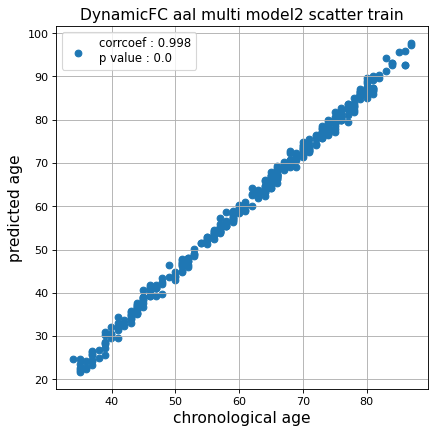

r^2 train data:  0.829117994721877


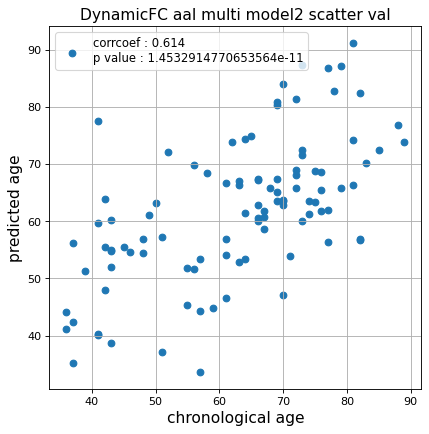

r^2 val data:  0.3043884640915254


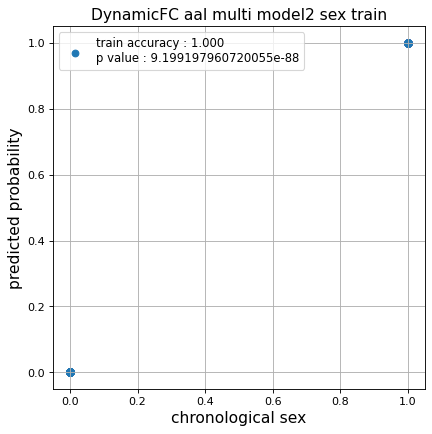

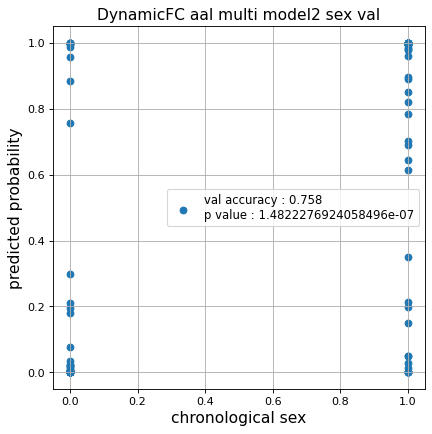

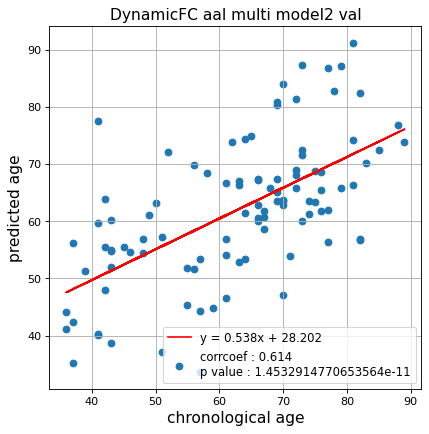

切片: 28.201724995231736
傾き: 0.5381805886199621
Kfold: 3 ::: epoch: 100, loss: 0.034124599483150705, val loss: 0.617422878742218
Kfold: 3 ::: epoch: 200, loss: 0.019870299201172132, val loss: 0.6201573759317398
Kfold: 3 ::: epoch: 300, loss: 0.013114037207112862, val loss: 0.660036988556385
Kfold: 3 ::: epoch: 400, loss: 0.008380724654461328, val loss: 0.704773522913456
Kfold: 3 ::: epoch: 500, loss: 0.00592232860911351, val loss: 0.734143041074276
Kfold: 3 ::: epoch: 600, loss: 0.006924055588360016, val loss: 0.713875524699688
Kfold: 3 ::: epoch: 700, loss: 0.00606363146709135, val loss: 0.7258472517132759
save_epochs:307
best val loss:0.6169044002890587


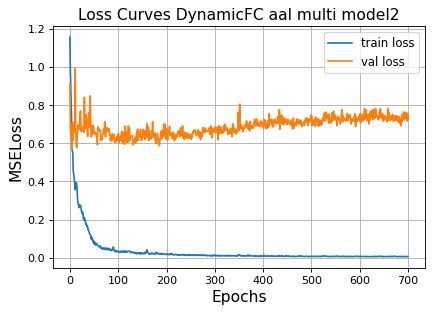

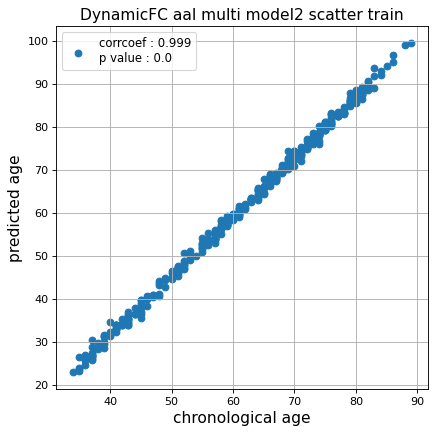

r^2 train data:  0.8468472868491299


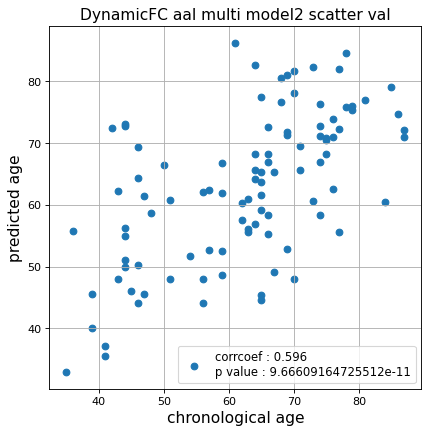

r^2 val data:  0.2474542654704328


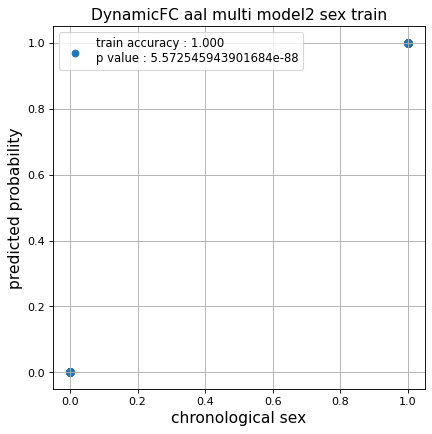

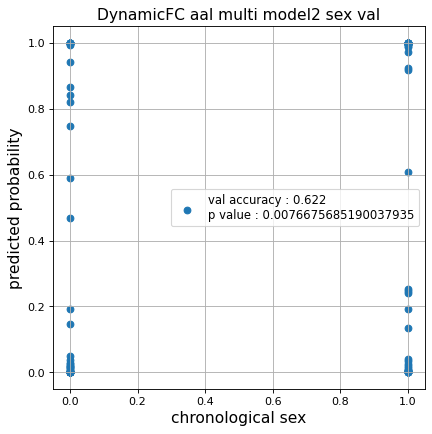

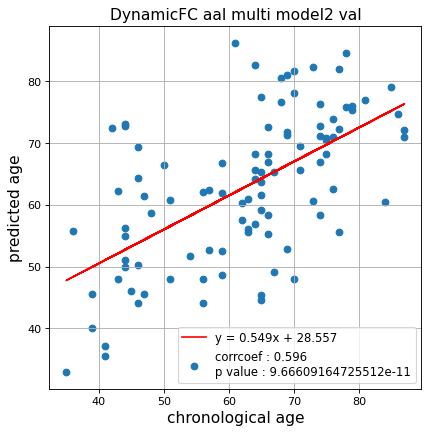

切片: 28.557254899451735
傾き: 0.5494636590898485
Kfold: 4 ::: epoch: 100, loss: 0.03588113475304384, val loss: 0.7562878727912903
Kfold: 4 ::: epoch: 200, loss: 0.018360245149009503, val loss: 0.7965715378522873
Kfold: 4 ::: epoch: 300, loss: 0.011232952336565806, val loss: 0.8604248464107513
Kfold: 4 ::: epoch: 400, loss: 0.009893927866449723, val loss: 0.9204611927270889
Kfold: 4 ::: epoch: 500, loss: 0.0073403863666149285, val loss: 0.8900724500417709
Kfold: 4 ::: epoch: 600, loss: 0.006872353412640782, val loss: 0.8824929594993591
Kfold: 4 ::: epoch: 700, loss: 0.006536435317964508, val loss: 0.9605880975723267
save_epochs:257
best val loss:0.807705819606781


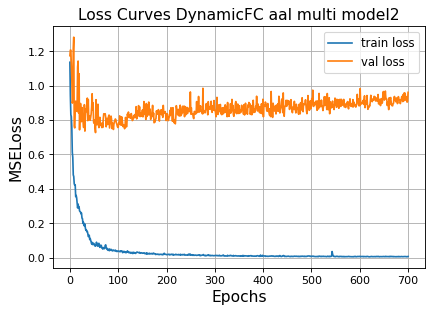

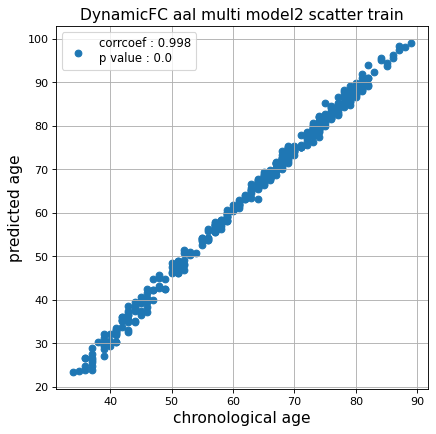

r^2 train data:  0.8010070668302358


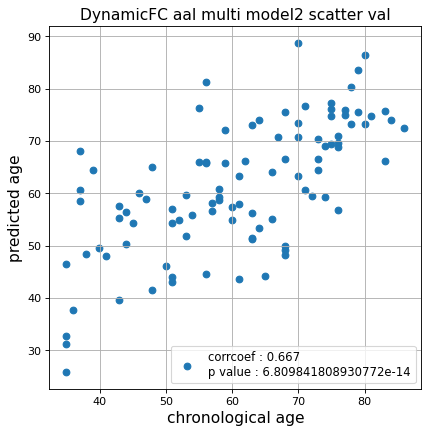

r^2 val data:  0.39079843226843514


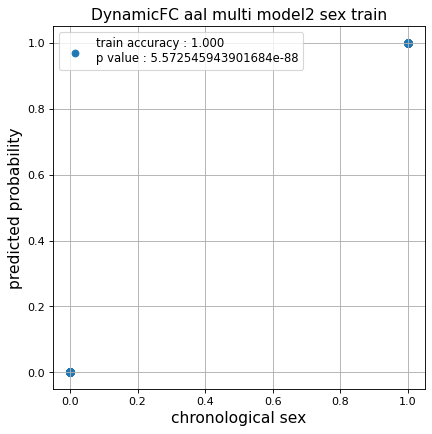

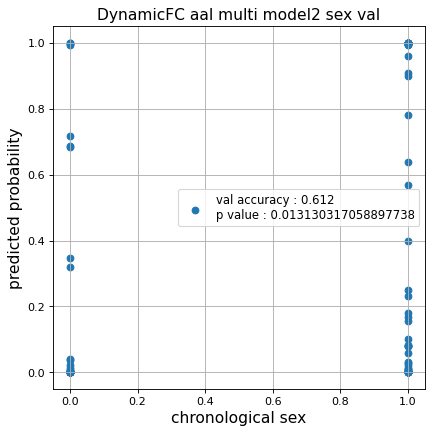

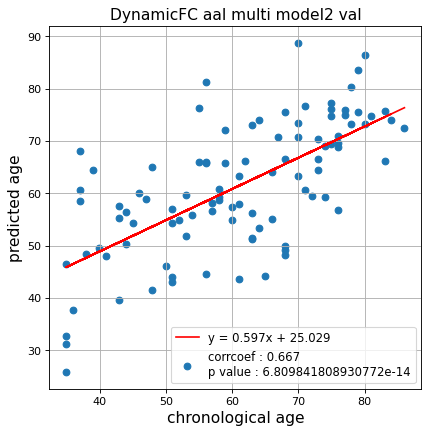

切片: 25.028684573109402
傾き: 0.5966308222787725
Kfold: 5 ::: epoch: 100, loss: 0.04431437872923338, val loss: 0.6362564489245415
Kfold: 5 ::: epoch: 200, loss: 0.016128544480754778, val loss: 0.5600689947605133
Kfold: 5 ::: epoch: 300, loss: 0.010399467813280912, val loss: 0.5461419261991978
Kfold: 5 ::: epoch: 400, loss: 0.008543975436343597, val loss: 0.564387071877718
Kfold: 5 ::: epoch: 500, loss: 0.006095936629348076, val loss: 0.5816304357722402
Kfold: 5 ::: epoch: 600, loss: 0.006260308544509686, val loss: 0.5557577032595873
Kfold: 5 ::: epoch: 700, loss: 0.004822420690638514, val loss: 0.531265328405425
save_epochs:354
best val loss:0.5240038074553013


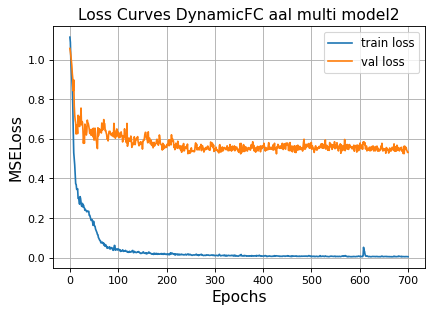

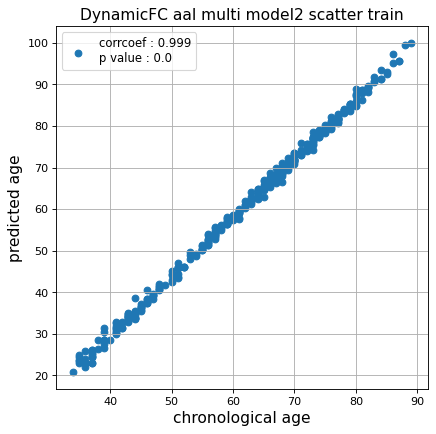

r^2 train data:  0.8132635377242228


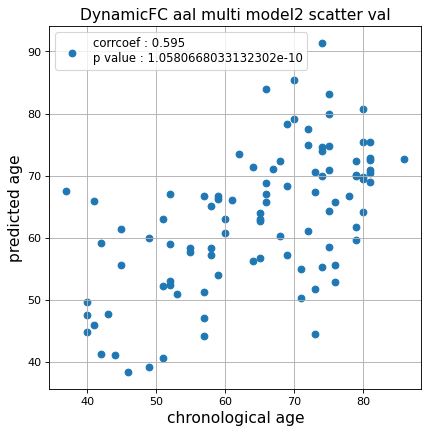

r^2 val data:  0.25891174394621774


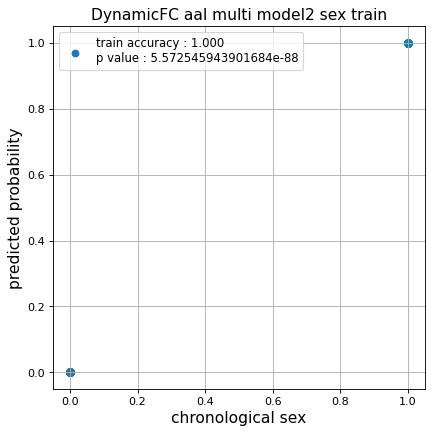

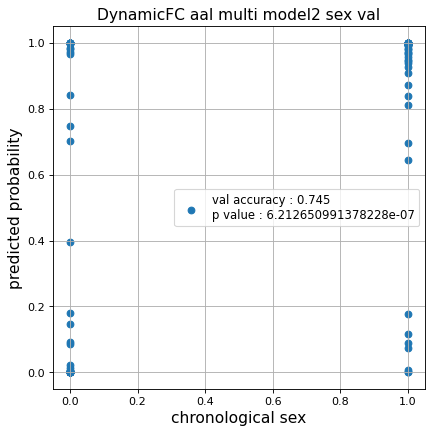

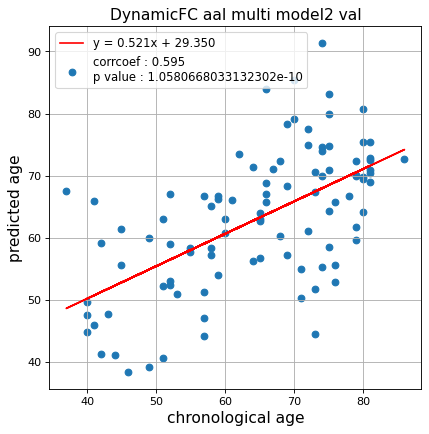

切片: 29.350054281923846
傾き: 0.5214938027290665
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.03544681963439171, val loss: 0.8173230886459351
Kfold: 1 ::: epoch: 200, loss: 0.018264847377745006, val loss: 0.7945830374956131
Kfold: 1 ::: epoch: 300, loss: 0.014099986471522313, val loss: 0.8057283163070679
Kfold: 1 ::: epoch: 400, loss: 0.00846864555317622, val loss: 0.8604328781366348
Kfold: 1 ::: epoch: 500, loss: 0.006966823067229528, val loss: 0.8907251209020615
Kfold: 1 ::: epoch: 600, loss: 0.008285637156894574, val loss: 0.8590535670518875
Kfold: 1 ::: epoch: 700, loss: 0.005899970589850385, val loss: 0.8978679478168488
save_epochs:276
best val loss:0.7473327964544296


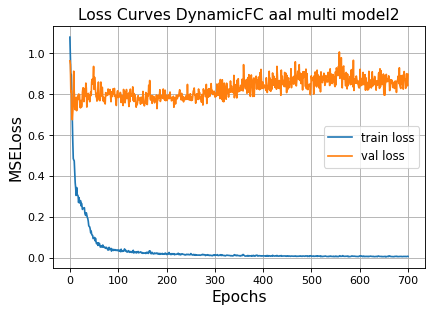

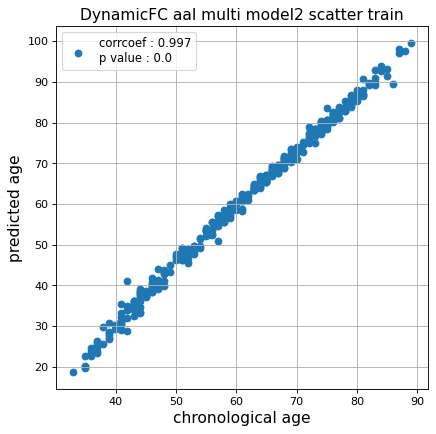

r^2 train data:  0.8228919415640746


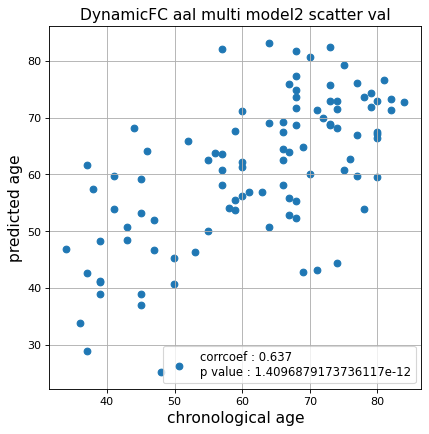

r^2 val data:  0.3155220143696209


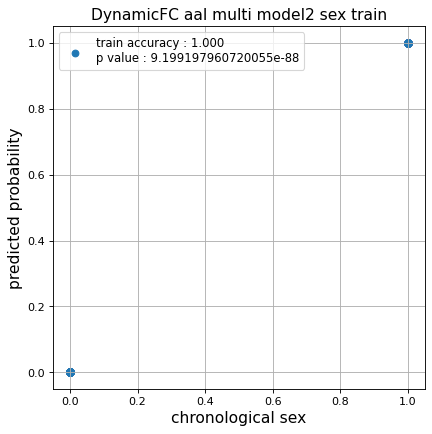

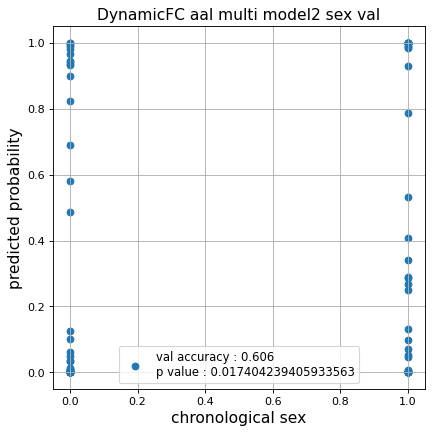

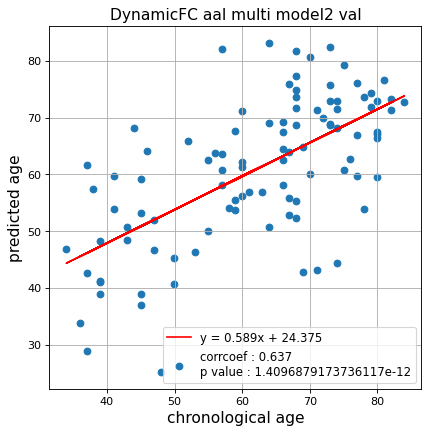

切片: 24.374814668755086
傾き: 0.588778066219443
Kfold: 2 ::: epoch: 100, loss: 0.03469489428859491, val loss: 0.6716782003641129
Kfold: 2 ::: epoch: 200, loss: 0.01481327715401466, val loss: 0.7203832641243935
Kfold: 2 ::: epoch: 300, loss: 0.012056788178877188, val loss: 0.7524737566709518
Kfold: 2 ::: epoch: 400, loss: 0.007171869636155092, val loss: 0.8283942341804504
Kfold: 2 ::: epoch: 500, loss: 0.006293178607638066, val loss: 0.8230835646390915
Kfold: 2 ::: epoch: 600, loss: 0.005824906106751699, val loss: 0.8426784425973892
Kfold: 2 ::: epoch: 700, loss: 0.0046207851085525295, val loss: 0.8742952197790146
save_epochs:258
best val loss:0.7110884040594101


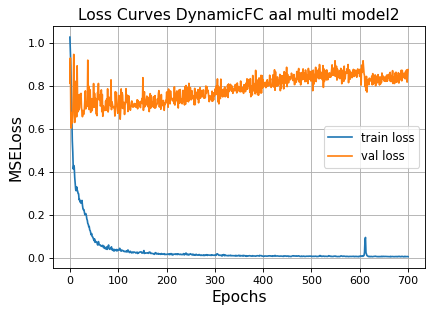

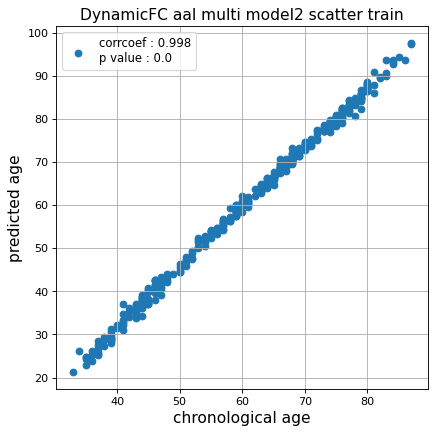

r^2 train data:  0.8475348886381411


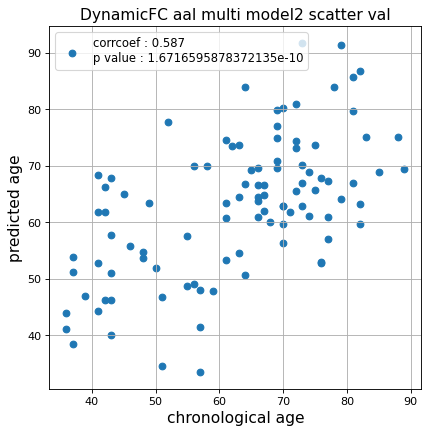

r^2 val data:  0.26236598176764214


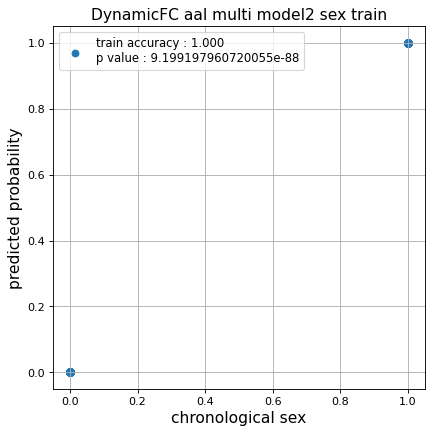

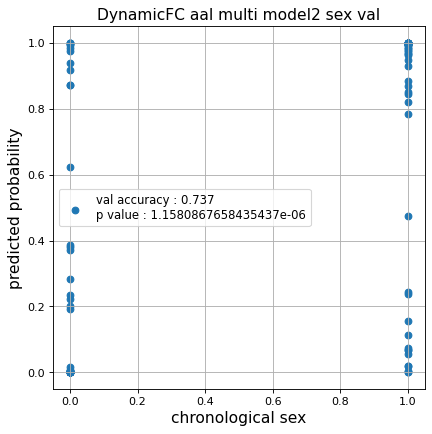

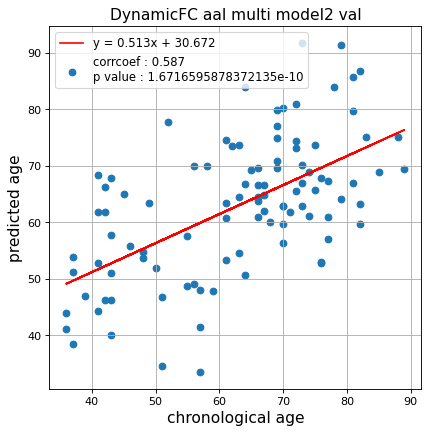

切片: 30.672295946072154
傾き: 0.5133224529168172
Kfold: 3 ::: epoch: 100, loss: 0.03311053892740837, val loss: 0.6186602935194969
Kfold: 3 ::: epoch: 200, loss: 0.018159224078632318, val loss: 0.5865837037563324
Kfold: 3 ::: epoch: 300, loss: 0.011364703675588736, val loss: 0.6119363009929657
Kfold: 3 ::: epoch: 400, loss: 0.007186049989496286, val loss: 0.6166421473026276
Kfold: 3 ::: epoch: 500, loss: 0.006381223461805628, val loss: 0.655747577548027
Kfold: 3 ::: epoch: 600, loss: 0.0069357180036604404, val loss: 0.6218441352248192
Kfold: 3 ::: epoch: 700, loss: 0.006358479704851141, val loss: 0.6438659131526947
save_epochs:262
best val loss:0.56376963108778


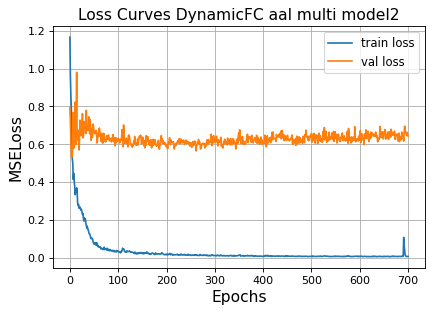

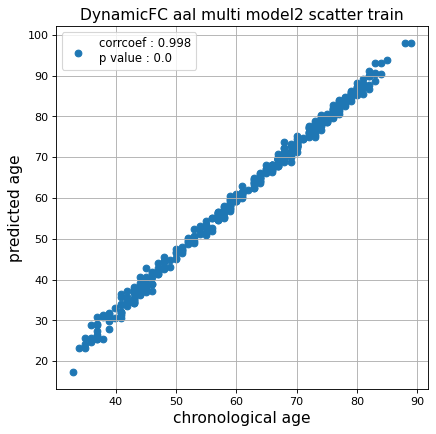

r^2 train data:  0.8577222108450954


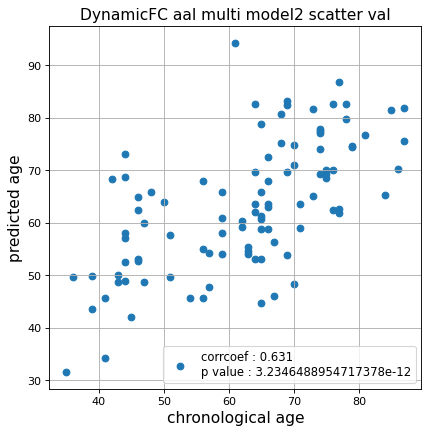

r^2 val data:  0.2979239959893001


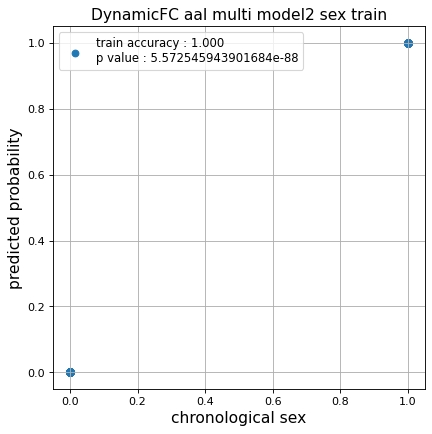

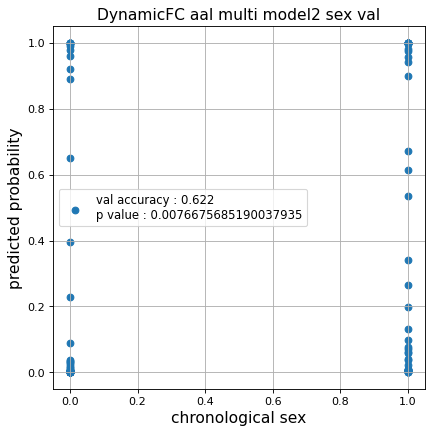

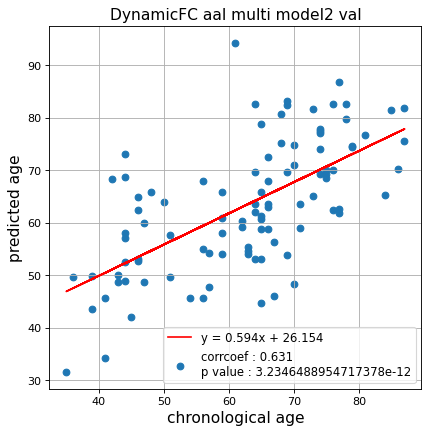

切片: 26.154312792486365
傾き: 0.5944380248248512
Kfold: 4 ::: epoch: 100, loss: 0.03311535644416626, val loss: 0.5548489540815353
Kfold: 4 ::: epoch: 200, loss: 0.0207557174592064, val loss: 0.5722164511680603
Kfold: 4 ::: epoch: 300, loss: 0.012406675145030022, val loss: 0.5903094112873077
Kfold: 4 ::: epoch: 400, loss: 0.008650407105541, val loss: 0.6748885363340378
Kfold: 4 ::: epoch: 500, loss: 0.007460828369053511, val loss: 0.6577035933732986
Kfold: 4 ::: epoch: 600, loss: 0.006303499739330549, val loss: 0.6240151077508926
Kfold: 4 ::: epoch: 700, loss: 0.0054945604911503885, val loss: 0.7215698659420013
save_epochs:297
best val loss:0.558085560798645


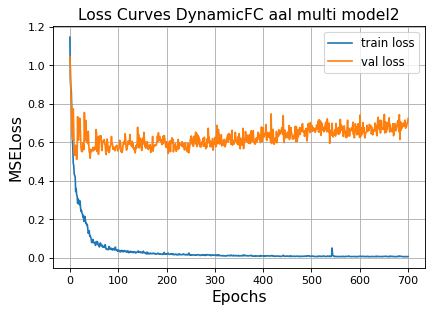

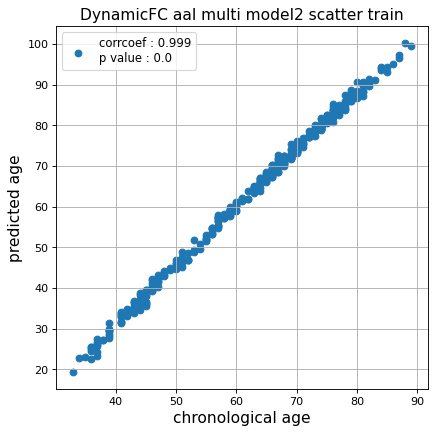

r^2 train data:  0.8038972631135434


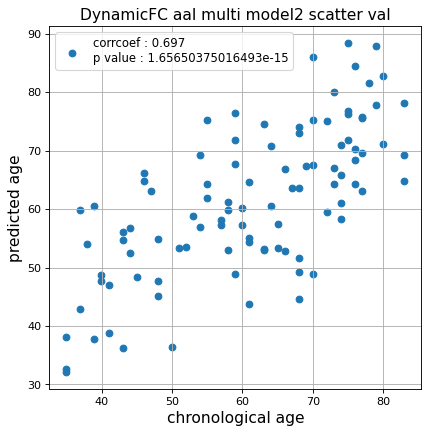

r^2 val data:  0.42866195184995715


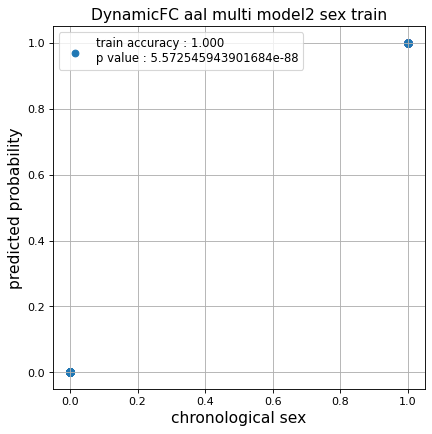

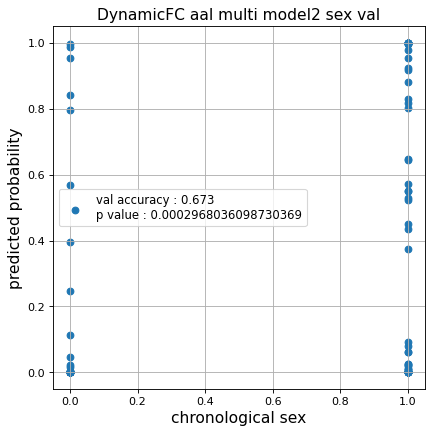

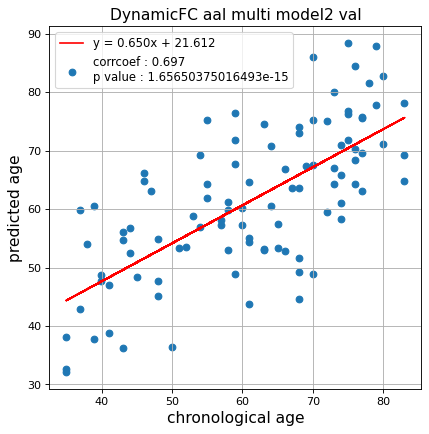

切片: 21.61150945462208
傾き: 0.6504220142029201
Kfold: 5 ::: epoch: 100, loss: 0.041759178758813784, val loss: 1.0047591924667358
Kfold: 5 ::: epoch: 200, loss: 0.017567327389350303, val loss: 0.9966250211000443
Kfold: 5 ::: epoch: 300, loss: 0.009911217261105776, val loss: 1.02488274872303
Kfold: 5 ::: epoch: 400, loss: 0.007788502861960576, val loss: 1.0290579050779343
Kfold: 5 ::: epoch: 500, loss: 0.006120475618025431, val loss: 1.1025883704423904
Kfold: 5 ::: epoch: 600, loss: 0.005974357231305196, val loss: 1.091985821723938
Kfold: 5 ::: epoch: 700, loss: 0.004878774643517458, val loss: 1.0747575461864471
save_epochs:273
best val loss:0.921823263168335


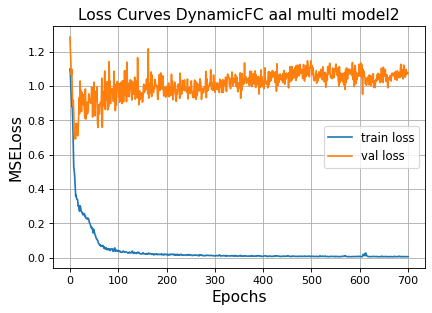

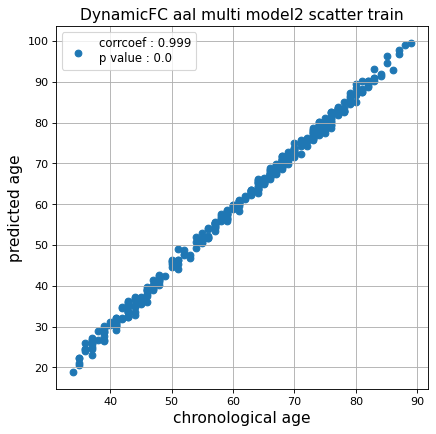

r^2 train data:  0.8098104239300266


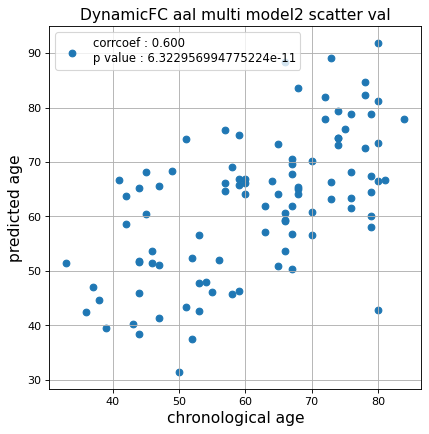

r^2 val data:  0.2146480980456772


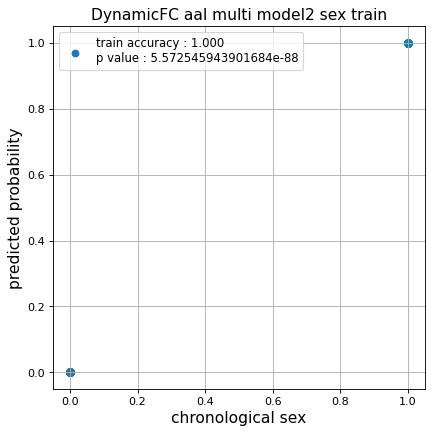

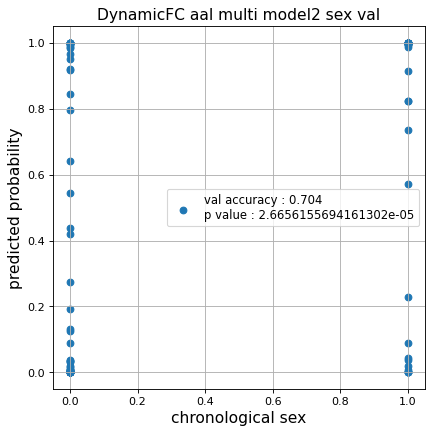

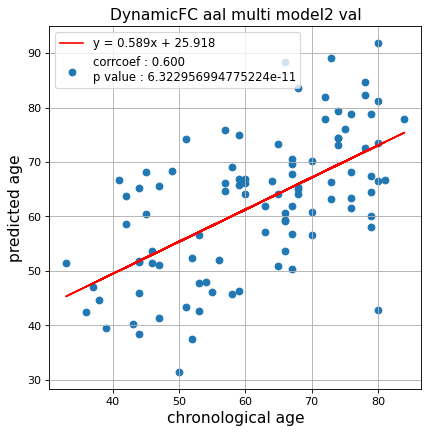

切片: 25.91847437725813
傾き: 0.5888317962108183
CPU times: user 1d 5h 52min 16s, sys: 1min 53s, total: 1d 5h 54min 10s
Wall time: 4h 12min 31s


In [19]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_all_dynamic_2  = []
test_pred_aal_all_dynamic_inverse_2  = []
test_label_aal_all_dynamic_2 = []

test_idx_aal_all_dynamic_2   = []
train_idx_aal_all_dynamic_2  = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_inverse,test_label = train_model(data_dynamic_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop    = 0.5,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC aal multi model2'
                                                          )
    
    test_pred_aal_all_dynamic_2.append(test_pred)
    test_pred_aal_all_dynamic_inverse_2.append(test_pred_inverse)
    test_label_aal_all_dynamic_2.append(test_label)

    test_idx_aal_all_dynamic_2.append(test_idx)
    train_idx_aal_all_dynamic_2.append(train_idx)

### データ保存

In [20]:
np.savez('../02_data_analysis/temp/all_multi_dynamic_aal_1',
         test_pred_aal_all_dynamic_1,
         test_pred_aal_all_dynamic_inverse_1,
         test_label_aal_all_dynamic_1,
         test_idx_aal_all_dynamic_1,
         train_idx_aal_all_dynamic_1)
np.savez('../02_data_analysis/temp/all_multi_dynamic_aal_2',
         test_pred_aal_all_dynamic_2,
         test_pred_aal_all_dynamic_inverse_2,
         test_label_aal_all_dynamic_2,
         test_idx_aal_all_dynamic_2,
         train_idx_aal_all_dynamic_2)

## 学習(Harvard-Oxford)

### Bold 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.037722963553208574, val loss: 0.8527853935956955
Kfold: 1 ::: epoch: 200, loss: 0.02384101556470761, val loss: 0.7482268214225769
Kfold: 1 ::: epoch: 300, loss: 0.01793444987673026, val loss: 0.7030274122953415
Kfold: 1 ::: epoch: 400, loss: 0.009684113785624504, val loss: 0.6506652683019638
Kfold: 1 ::: epoch: 500, loss: 0.008511208499280306, val loss: 0.6204750835895538
Kfold: 1 ::: epoch: 600, loss: 0.027470030212918155, val loss: 0.5809655152261257
Kfold: 1 ::: epoch: 700, loss: 0.006582684026887784, val loss: 0.5808682404458523
Kfold: 1 ::: epoch: 800, loss: 0.006160237271195421, val loss: 0.5623373575508595
Kfold: 1 ::: epoch: 900, loss: 0.006381207289030919, val loss: 0.5675555691123009
Kfold: 1 ::: epoch: 1000, loss: 0.0059036214549381, val loss: 0.5468193292617798
save_epochs:987
best val loss:0.5448031686246395


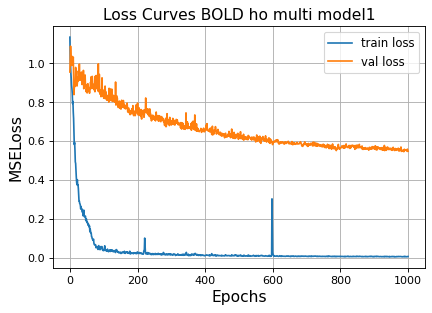

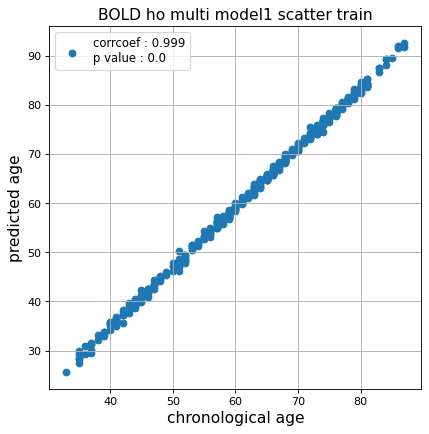

r^2 train data:  0.9499779437128684


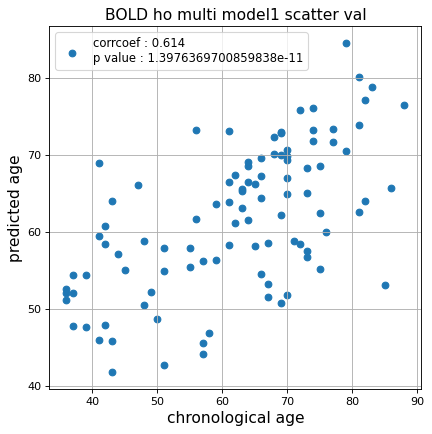

r^2 val data:  0.37231371322589424


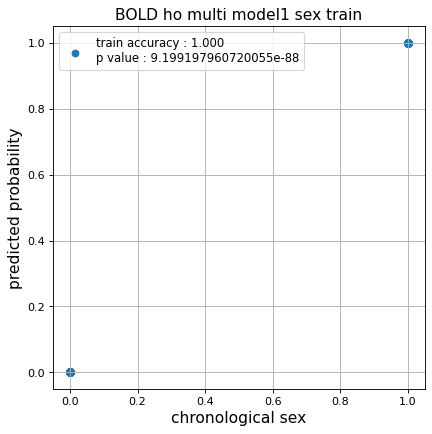

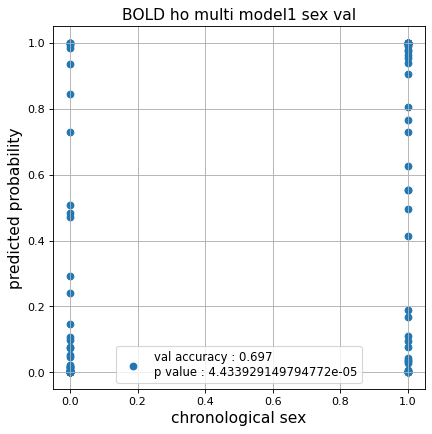

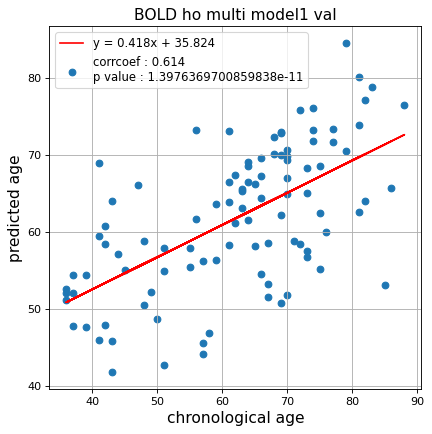

切片: 35.82412878914397
傾き: 0.41797915311586115
Kfold: 2 ::: epoch: 100, loss: 0.05587824921195324, val loss: 0.7340063750743866
Kfold: 2 ::: epoch: 200, loss: 0.017813088443989936, val loss: 0.6555175483226776
Kfold: 2 ::: epoch: 300, loss: 0.012364715266113099, val loss: 0.618849903345108
Kfold: 2 ::: epoch: 400, loss: 0.009449922658789616, val loss: 0.5787560045719147
Kfold: 2 ::: epoch: 500, loss: 0.008860620419279886, val loss: 0.56721630692482
Kfold: 2 ::: epoch: 600, loss: 0.006920302877775752, val loss: 0.5639991015195847
Kfold: 2 ::: epoch: 700, loss: 0.005856378344245828, val loss: 0.554519921541214
Kfold: 2 ::: epoch: 800, loss: 0.006237791278041326, val loss: 0.5618778318166733
Kfold: 2 ::: epoch: 900, loss: 0.00426744044615099, val loss: 0.5368306934833527
Kfold: 2 ::: epoch: 1000, loss: 0.004739179078919383, val loss: 0.538272812962532
save_epochs:912
best val loss:0.5152668803930283


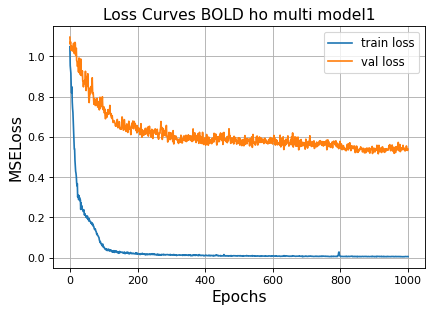

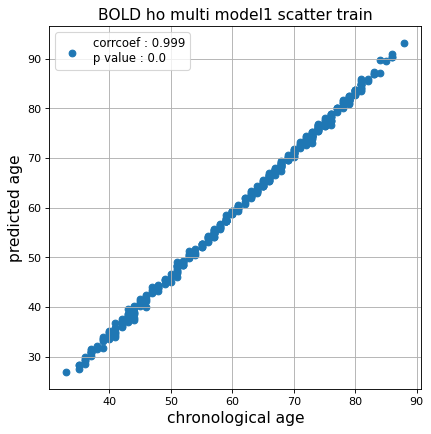

r^2 train data:  0.9458562961833148


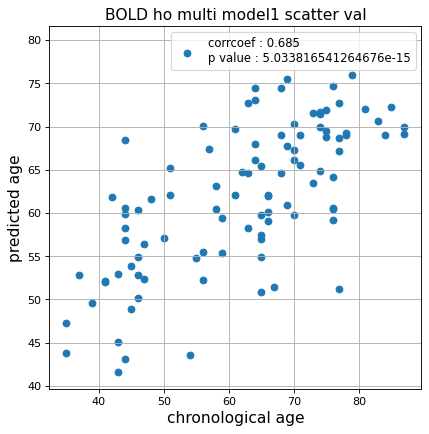

r^2 val data:  0.4670504055328859


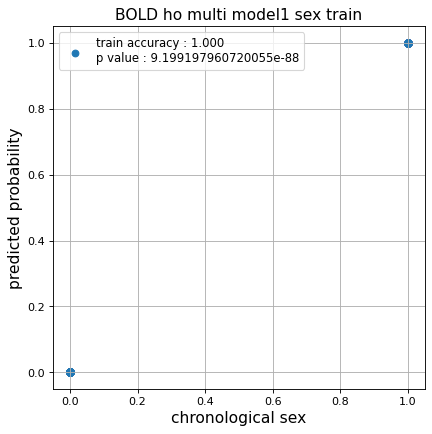

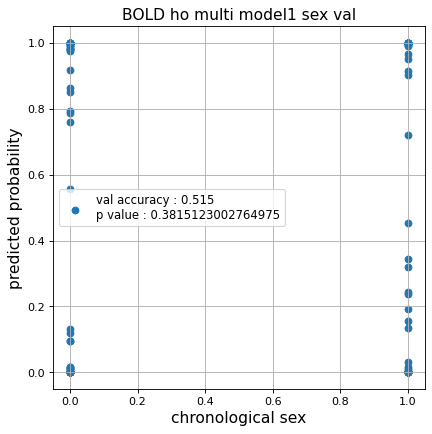

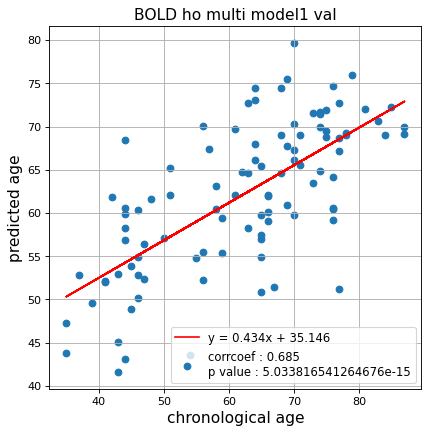

切片: 35.14617411298656
傾き: 0.43385778439982253
Kfold: 3 ::: epoch: 100, loss: 0.03595769749237941, val loss: 0.9955898374319077
Kfold: 3 ::: epoch: 200, loss: 0.018195574530042134, val loss: 0.9772225022315979
Kfold: 3 ::: epoch: 300, loss: 0.012360780535695644, val loss: 0.9021624028682709
Kfold: 3 ::: epoch: 400, loss: 0.010902430253246656, val loss: 0.9038664400577545
Kfold: 3 ::: epoch: 500, loss: 0.00903120400527349, val loss: 0.8570799976587296
Kfold: 3 ::: epoch: 600, loss: 0.006758548247699554, val loss: 0.8390774726867676
Kfold: 3 ::: epoch: 700, loss: 0.006299260914182434, val loss: 0.7995294630527496
Kfold: 3 ::: epoch: 800, loss: 0.005460176652727218, val loss: 0.8072232753038406
Kfold: 3 ::: epoch: 900, loss: 0.004340266790957405, val loss: 0.7934492826461792
Kfold: 3 ::: epoch: 1000, loss: 0.004833362065255642, val loss: 0.806741401553154
save_epochs:798
best val loss:0.7762512415647507


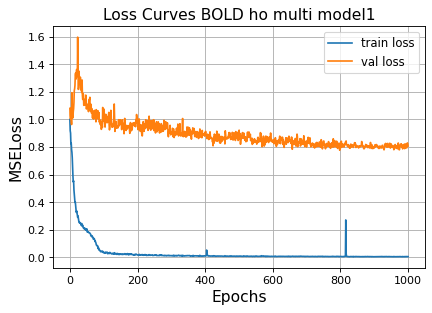

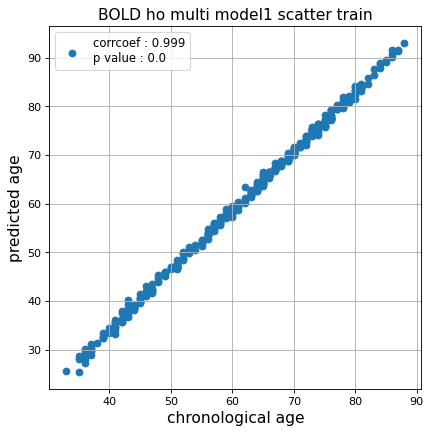

r^2 train data:  0.944203288962825


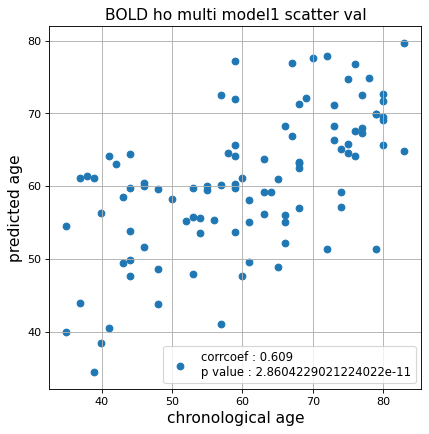

r^2 val data:  0.36110135327347026


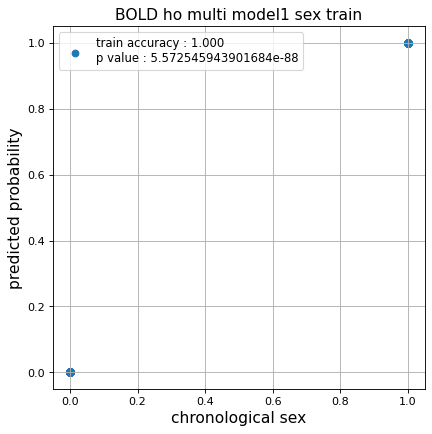

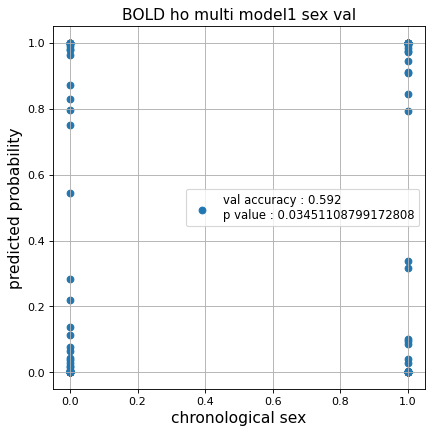

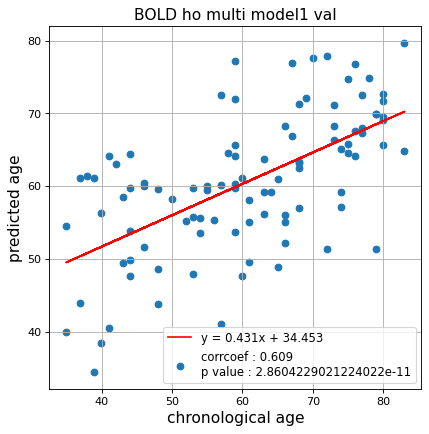

切片: 34.45262409756509
傾き: 0.43115422586294017
Kfold: 4 ::: epoch: 100, loss: 0.04172105657366606, val loss: 1.539813756942749
Kfold: 4 ::: epoch: 200, loss: 0.02141621787674152, val loss: 1.2209721058607101
Kfold: 4 ::: epoch: 300, loss: 0.031957049280978166, val loss: 1.243578478693962
Kfold: 4 ::: epoch: 400, loss: 0.010505919022342334, val loss: 1.164816215634346
Kfold: 4 ::: epoch: 500, loss: 0.007955087921940364, val loss: 1.2111676037311554
Kfold: 4 ::: epoch: 600, loss: 0.007727097254246473, val loss: 1.166869431734085
Kfold: 4 ::: epoch: 700, loss: 0.005801606081569424, val loss: 1.1640695631504059
Kfold: 4 ::: epoch: 800, loss: 0.004639833753641982, val loss: 1.1487691700458527
Kfold: 4 ::: epoch: 900, loss: 0.0051128568414312145, val loss: 1.1099660396575928
Kfold: 4 ::: epoch: 1000, loss: 0.004563755875166792, val loss: 1.1433046609163284
save_epochs:767
best val loss:1.0829036086797714


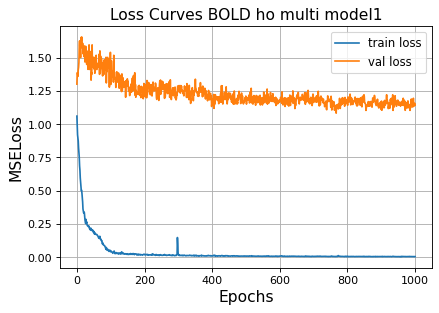

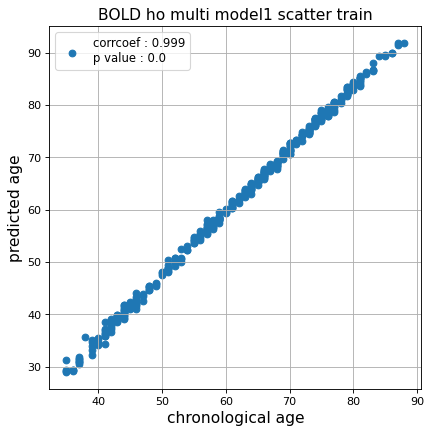

r^2 train data:  0.955141820154398


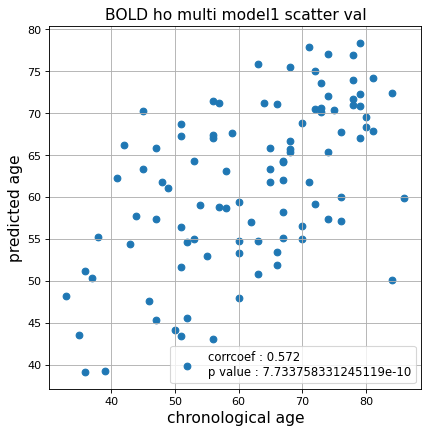

r^2 val data:  0.30628832241476933


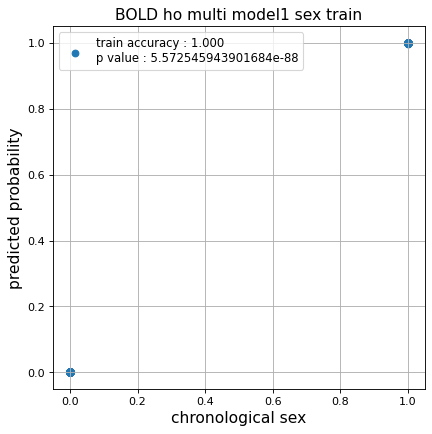

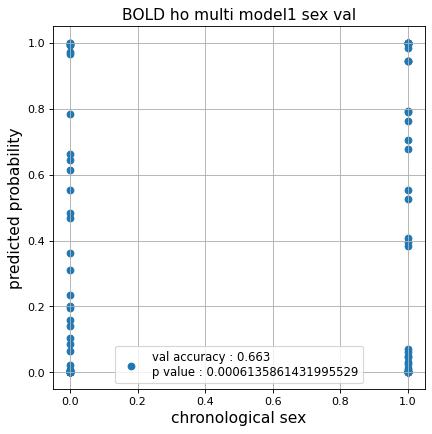

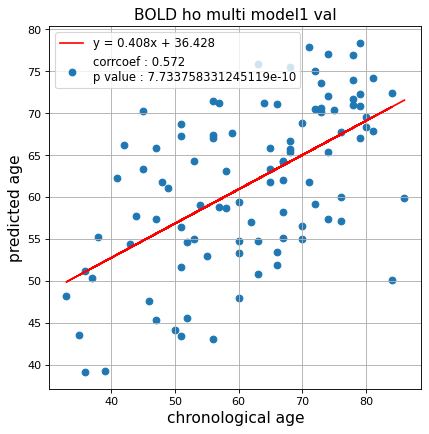

切片: 36.427577609680554
傾き: 0.4084706249766257
Kfold: 5 ::: epoch: 100, loss: 0.04249578800338965, val loss: 0.7162051945924759
Kfold: 5 ::: epoch: 200, loss: 0.020538870675059464, val loss: 0.6914200857281685
Kfold: 5 ::: epoch: 300, loss: 0.011156814674345346, val loss: 0.6779457554221153
Kfold: 5 ::: epoch: 400, loss: 0.009983932599425316, val loss: 0.6432282775640488
Kfold: 5 ::: epoch: 500, loss: 0.006521829099466021, val loss: 0.623351126909256
Kfold: 5 ::: epoch: 600, loss: 0.007539226100421869, val loss: 0.6177459210157394
Kfold: 5 ::: epoch: 700, loss: 0.005366435507312417, val loss: 0.5955967754125595
Kfold: 5 ::: epoch: 800, loss: 0.004692904024313276, val loss: 0.5932619944214821
Kfold: 5 ::: epoch: 900, loss: 0.005123266735329078, val loss: 0.5908318385481834
Kfold: 5 ::: epoch: 1000, loss: 0.004575350823310705, val loss: 0.5849168375134468
save_epochs:989
best val loss:0.5752360299229622


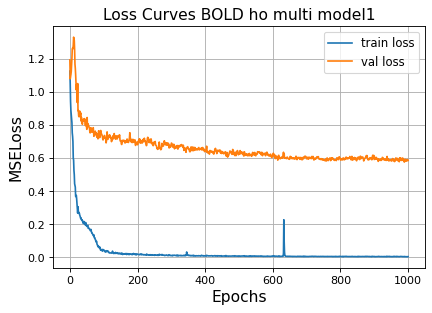

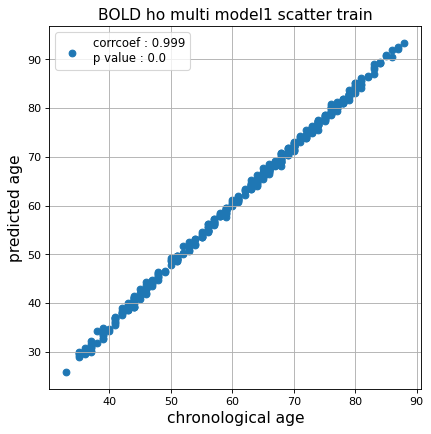

r^2 train data:  0.9494552317598841


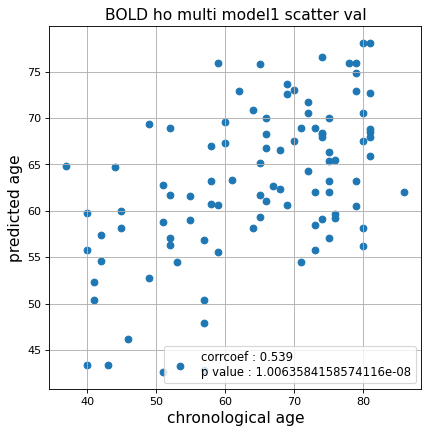

r^2 val data:  0.26778173585250664


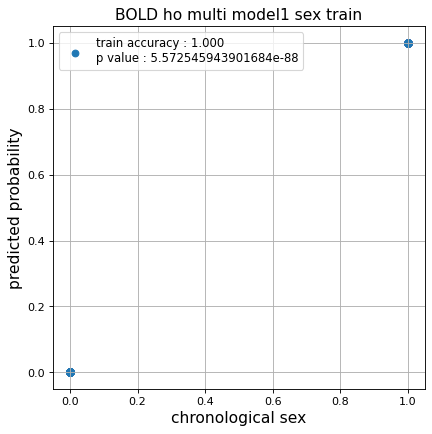

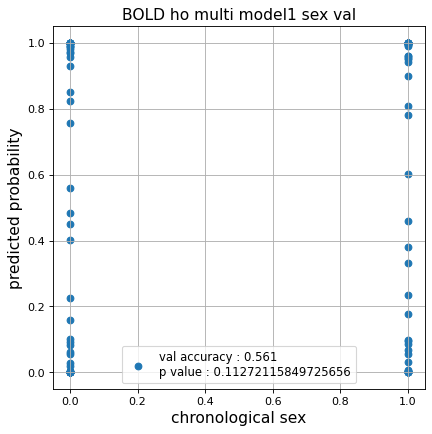

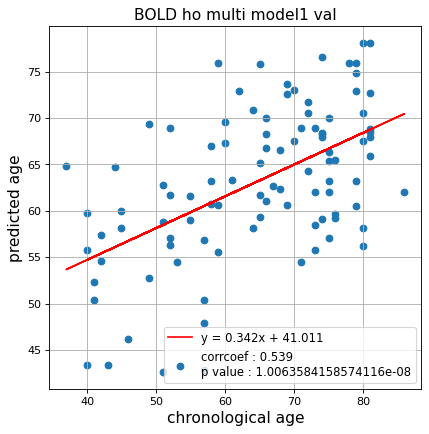

切片: 41.01080284932945
傾き: 0.3423040253672769
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.03828497818456246, val loss: 0.6588728651404381
Kfold: 1 ::: epoch: 200, loss: 0.02429617389750022, val loss: 0.6487963497638702
Kfold: 1 ::: epoch: 300, loss: 0.017898370440189656, val loss: 0.5832753330469131
Kfold: 1 ::: epoch: 400, loss: 0.011753875260742811, val loss: 0.562177836894989
Kfold: 1 ::: epoch: 500, loss: 0.009698827070398973, val loss: 0.5451471321284771
Kfold: 1 ::: epoch: 600, loss: 0.007477775090732253, val loss: 0.5376681461930275
Kfold: 1 ::: epoch: 700, loss: 0.007074946537613869, val loss: 0.5325716994702816
Kfold: 1 ::: epoch: 800, loss: 0.006913410141490973, val loss: 0.5381578207015991
Kfold: 1 ::: epoch: 900, loss: 0.008106549091350574, val loss: 0.537312887609005
Kfold: 1 ::: epoch: 1000, loss: 0.005458837052663932, val loss: 0.5352631956338882
save_epochs:907
best val loss:0.5158592872321606


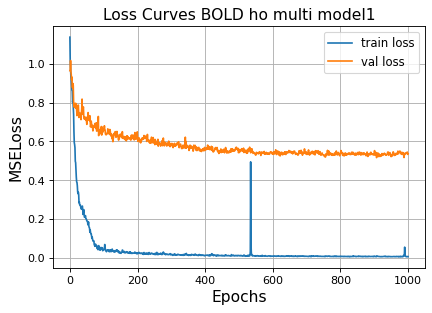

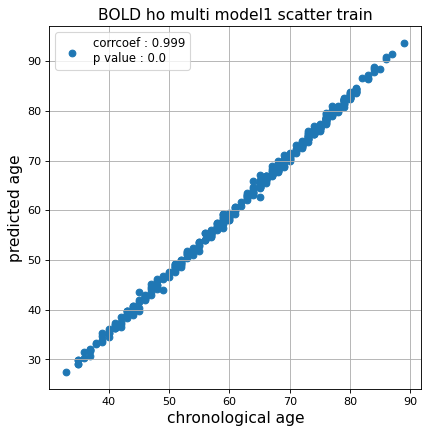

r^2 train data:  0.9612369075550309


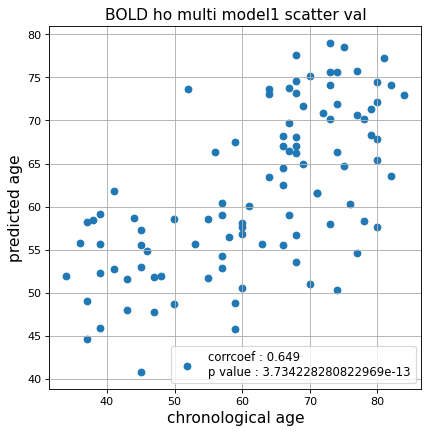

r^2 val data:  0.42043326526645963


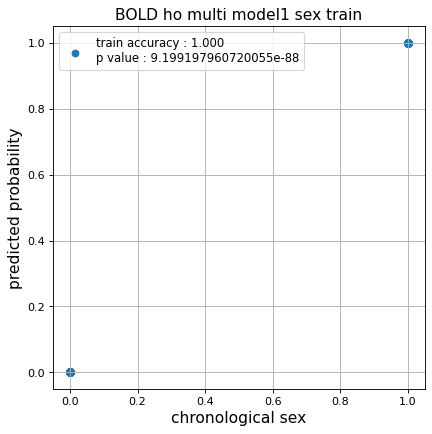

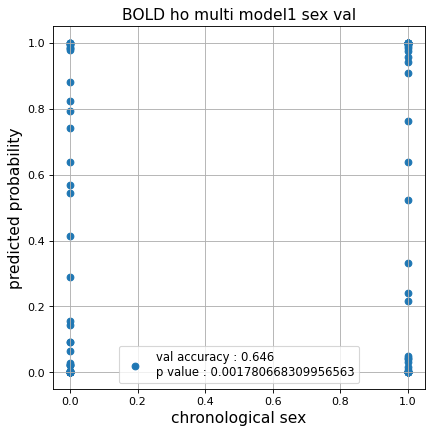

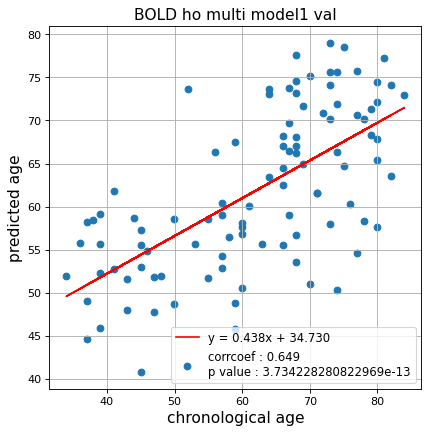

切片: 34.73012585046703
傾き: 0.4375192376413833
Kfold: 2 ::: epoch: 100, loss: 0.049569209321187094, val loss: 0.8754144012928009
Kfold: 2 ::: epoch: 200, loss: 0.019315011226213895, val loss: 0.7712555080652237
Kfold: 2 ::: epoch: 300, loss: 0.014048427522469025, val loss: 0.741523489356041
Kfold: 2 ::: epoch: 400, loss: 0.01071851822332694, val loss: 0.7455722689628601
Kfold: 2 ::: epoch: 500, loss: 0.009783083178962652, val loss: 0.7299168407917023
Kfold: 2 ::: epoch: 600, loss: 0.007782449515966268, val loss: 0.7030125856399536
Kfold: 2 ::: epoch: 700, loss: 0.006085428409278393, val loss: 0.7031936347484589
Kfold: 2 ::: epoch: 800, loss: 0.005162094451057224, val loss: 0.7030847296118736
Kfold: 2 ::: epoch: 900, loss: 0.004411749398479095, val loss: 0.6863413751125336
Kfold: 2 ::: epoch: 1000, loss: 0.0037742677646187637, val loss: 0.6750098615884781
save_epochs:991
best val loss:0.6528925895690918


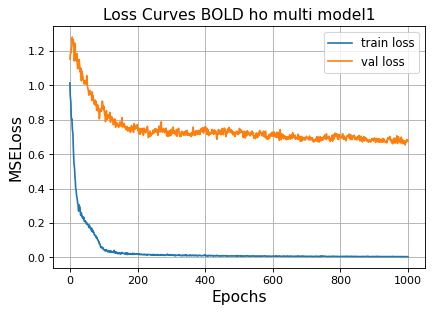

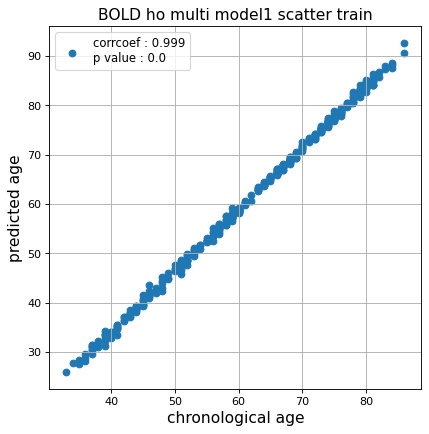

r^2 train data:  0.9371922186144412


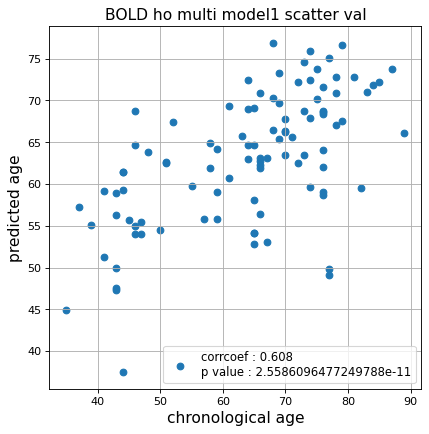

r^2 val data:  0.36598762910645954


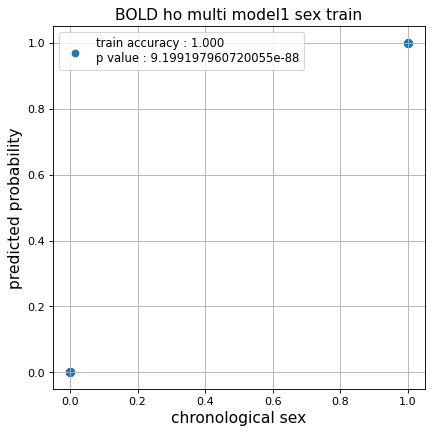

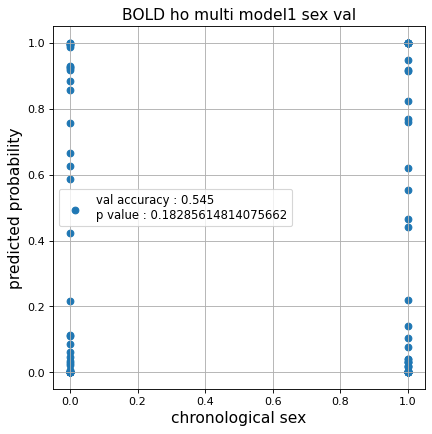

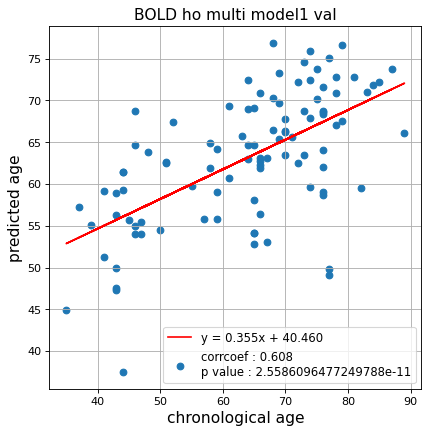

切片: 40.46049915913169
傾き: 0.35504101796356324
Kfold: 3 ::: epoch: 100, loss: 0.039164682277120076, val loss: 1.0909525752067566
Kfold: 3 ::: epoch: 200, loss: 0.019004675488059338, val loss: 1.0084676891565323
Kfold: 3 ::: epoch: 300, loss: 0.012877270149496885, val loss: 1.0891254842281342
Kfold: 3 ::: epoch: 400, loss: 0.010650812039295068, val loss: 1.0394341498613358
Kfold: 3 ::: epoch: 500, loss: 0.0075776005127968695, val loss: 1.0292678773403168
Kfold: 3 ::: epoch: 600, loss: 0.007746956239526088, val loss: 0.9543594866991043
Kfold: 3 ::: epoch: 700, loss: 0.008250097887447247, val loss: 0.9572523385286331
Kfold: 3 ::: epoch: 800, loss: 0.00565599798797988, val loss: 1.008902221918106
Kfold: 3 ::: epoch: 900, loss: 0.005075203595109857, val loss: 0.9881231337785721
Kfold: 3 ::: epoch: 1000, loss: 0.00530774282434812, val loss: 0.979869931936264
save_epochs:588
best val loss:0.9202491641044617


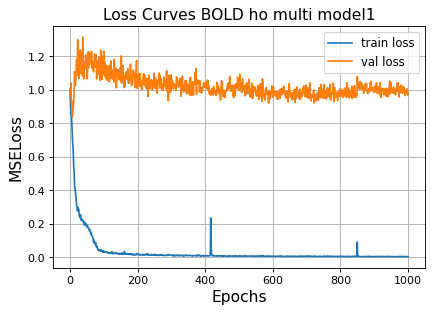

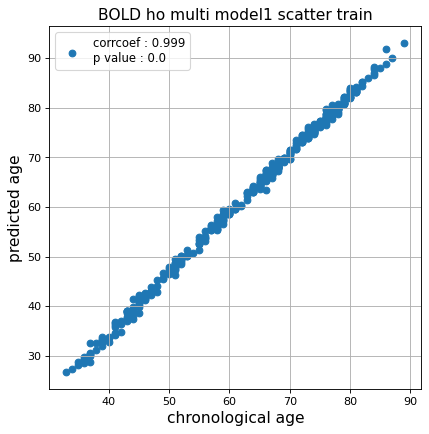

r^2 train data:  0.9525065003617126


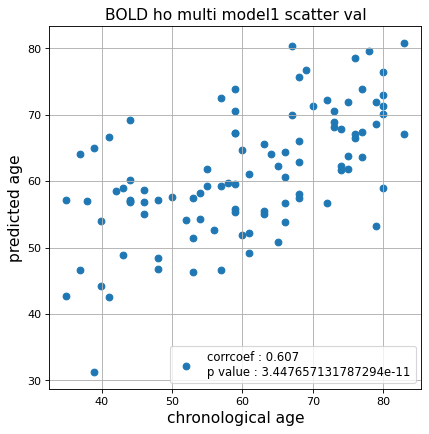

r^2 val data:  0.35945396516891426


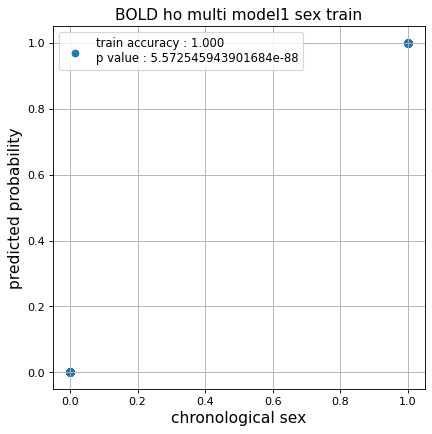

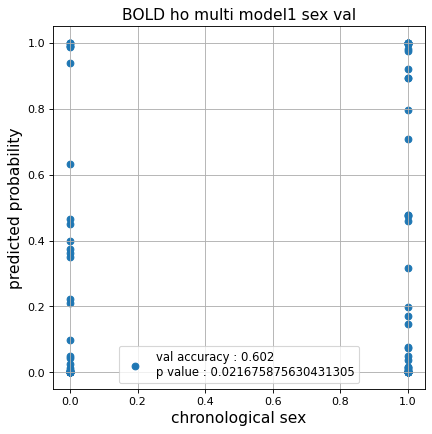

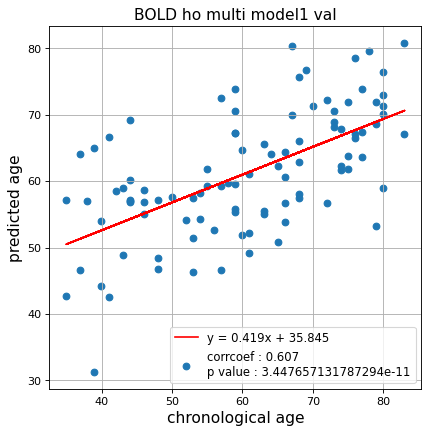

切片: 35.84524047145355
傾き: 0.4190155621286052
Kfold: 4 ::: epoch: 100, loss: 0.03988717023569804, val loss: 1.4245525300502777
Kfold: 4 ::: epoch: 200, loss: 0.021953047539752264, val loss: 1.3342273831367493
Kfold: 4 ::: epoch: 300, loss: 0.01653707930101798, val loss: 1.1931762397289276
Kfold: 4 ::: epoch: 400, loss: 0.011211903013575535, val loss: 1.1949180960655212
Kfold: 4 ::: epoch: 500, loss: 0.007211066388453429, val loss: 1.1146785467863083
Kfold: 4 ::: epoch: 600, loss: 0.007089732662559702, val loss: 1.2256887406110764
Kfold: 4 ::: epoch: 700, loss: 0.0058863377735878415, val loss: 1.1573772579431534
Kfold: 4 ::: epoch: 800, loss: 0.005399463268426748, val loss: 1.1269808411598206
Kfold: 4 ::: epoch: 900, loss: 0.004912886016357403, val loss: 1.1168817430734634
Kfold: 4 ::: epoch: 1000, loss: 0.005210473578279981, val loss: 1.147403098642826
save_epochs:528
best val loss:1.071019560098648


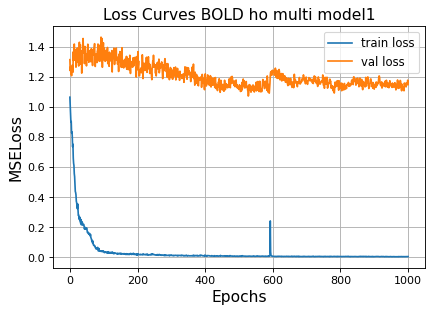

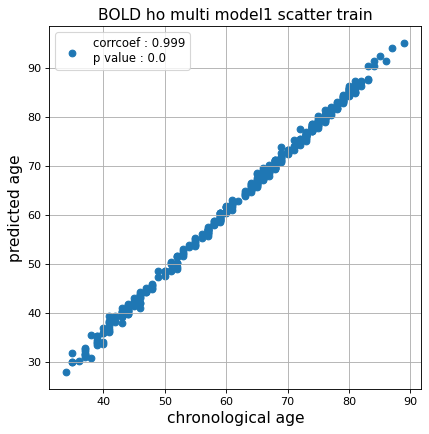

r^2 train data:  0.9385487254785402


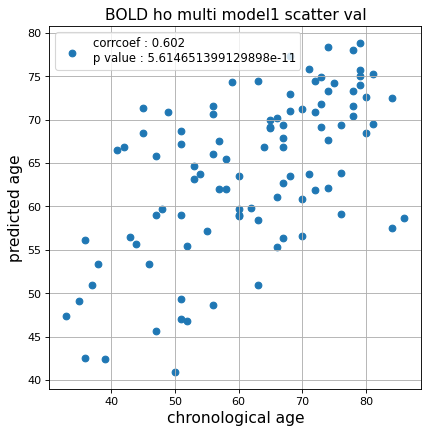

r^2 val data:  0.3332429855883956


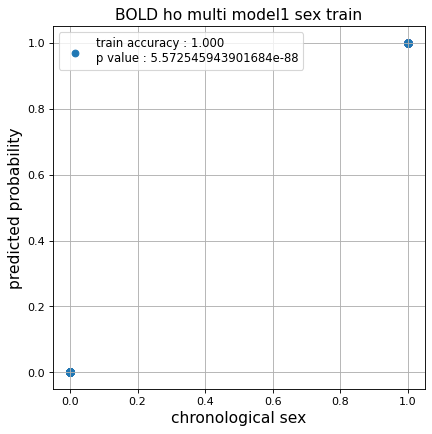

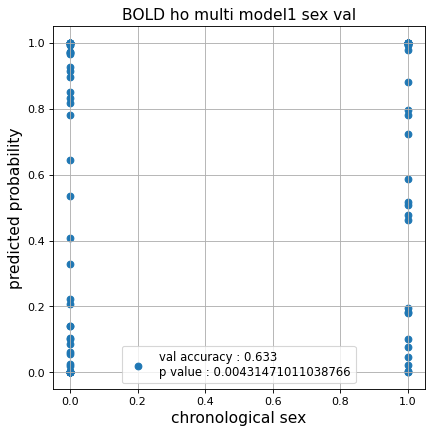

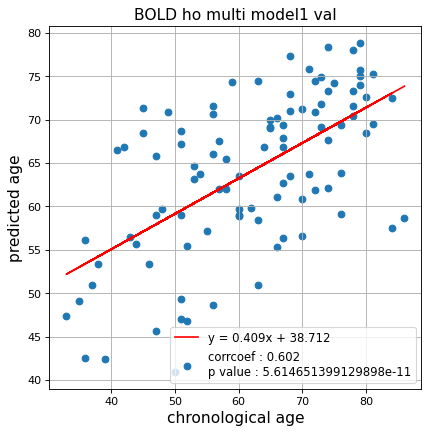

切片: 38.7118214703188
傾き: 0.408524583355598
Kfold: 5 ::: epoch: 100, loss: 0.03323917964903208, val loss: 0.7322611324489117
Kfold: 5 ::: epoch: 200, loss: 0.019225517072929785, val loss: 0.731410801410675
Kfold: 5 ::: epoch: 300, loss: 0.012629484041379048, val loss: 0.697338692843914
Kfold: 5 ::: epoch: 400, loss: 0.010084727349189611, val loss: 0.6977347135543823
Kfold: 5 ::: epoch: 500, loss: 0.007274756172242073, val loss: 0.7213592305779457
Kfold: 5 ::: epoch: 600, loss: 0.0070250039705290245, val loss: 0.6931099146604538
Kfold: 5 ::: epoch: 700, loss: 0.006521487107070593, val loss: 0.6748629361391068
Kfold: 5 ::: epoch: 800, loss: 0.004776476739117732, val loss: 0.6618395373225212
Kfold: 5 ::: epoch: 900, loss: 0.005561779611385786, val loss: 0.6777729094028473
Kfold: 5 ::: epoch: 1000, loss: 0.005433028420576682, val loss: 0.6814195960760117
save_epochs:797
best val loss:0.6540518626570702


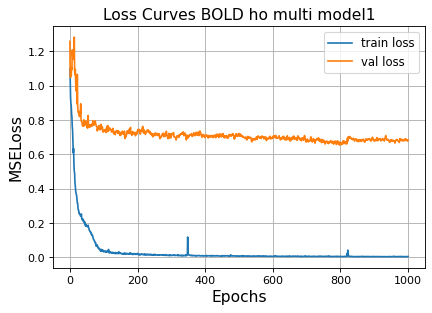

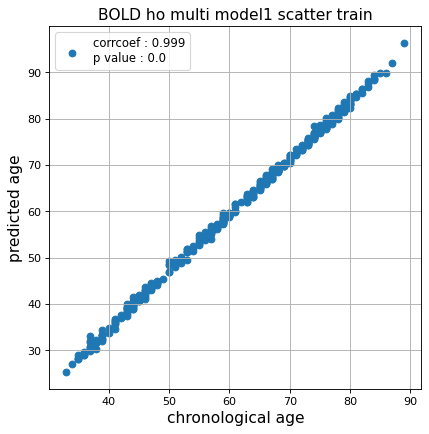

r^2 train data:  0.9493007545807326


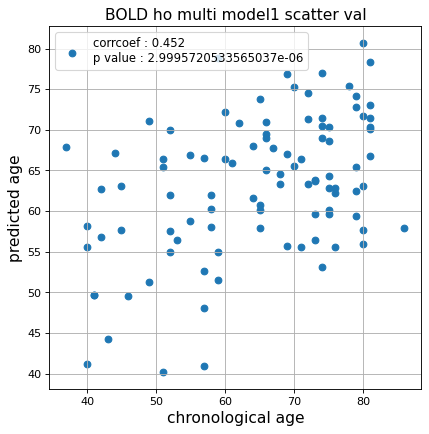

r^2 val data:  0.14452069178319937


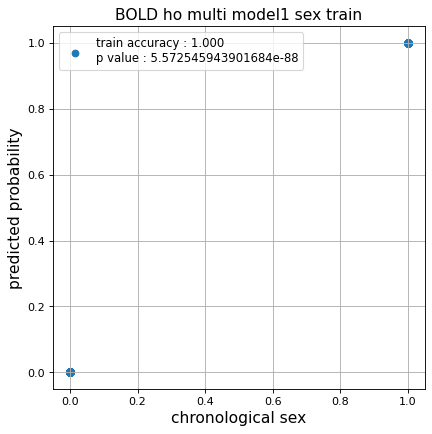

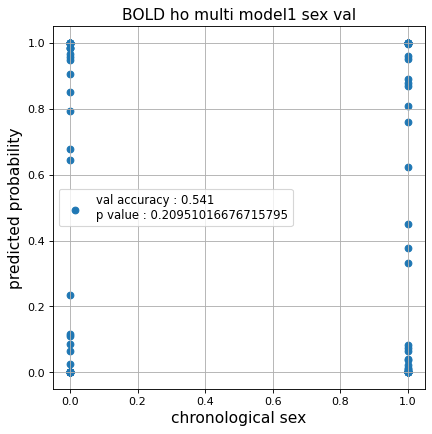

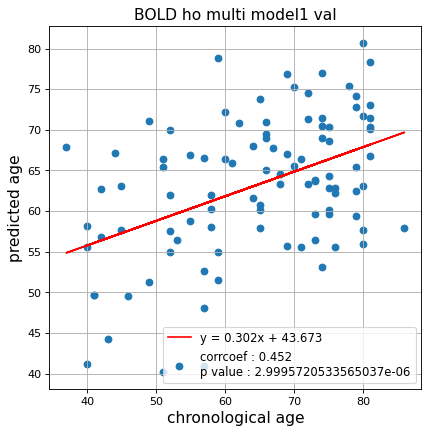

切片: 43.67320768630626
傾き: 0.3024141041338591
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.043042208426273786, val loss: 0.6147284358739853
Kfold: 1 ::: epoch: 200, loss: 0.021286189627762023, val loss: 0.5740767829120159
Kfold: 1 ::: epoch: 300, loss: 0.01597367449162098, val loss: 0.5592104643583298
Kfold: 1 ::: epoch: 400, loss: 0.014506140652184304, val loss: 0.5430021584033966
Kfold: 1 ::: epoch: 500, loss: 0.008318152350301925, val loss: 0.5249766372144222
Kfold: 1 ::: epoch: 600, loss: 0.006281022268992204, val loss: 0.5185744389891624
Kfold: 1 ::: epoch: 700, loss: 0.007591770926060585, val loss: 0.5145959369838238
Kfold: 1 ::: epoch: 800, loss: 0.00697008826626608, val loss: 0.5179759748280048
Kfold: 1 ::: epoch: 900, loss: 0.00445010273072582, val loss: 0.515765093266964
Kfold: 1 ::: epoch: 1000, loss: 0.005246607192720358, val loss: 0.5213762521743774
save_epochs:928
best val loss:0.49751339852809906


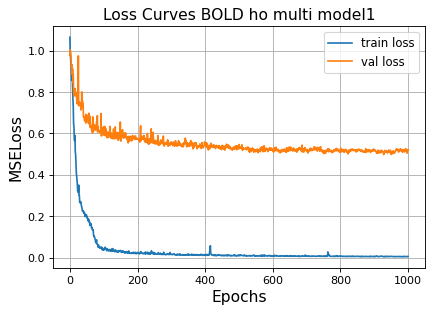

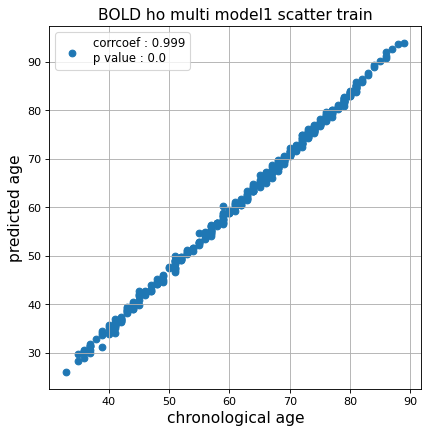

r^2 train data:  0.9515530951881257


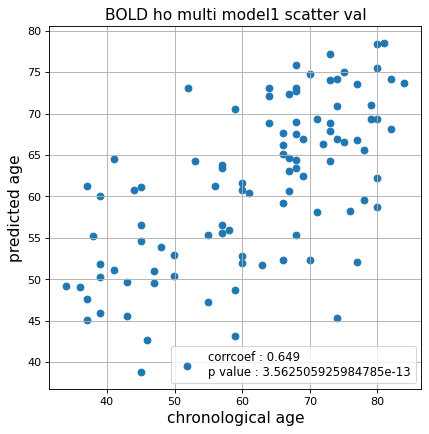

r^2 val data:  0.417277932766825


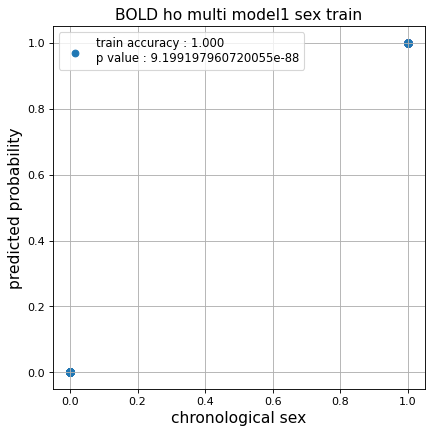

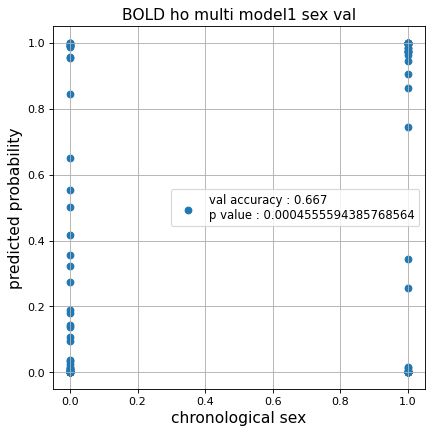

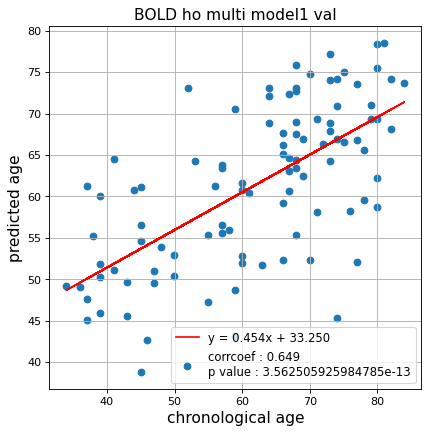

切片: 33.2504922586553
傾き: 0.4540022072781214
Kfold: 2 ::: epoch: 100, loss: 0.05199591013101431, val loss: 0.7550124377012253
Kfold: 2 ::: epoch: 200, loss: 0.020433772498598464, val loss: 0.6871110126376152
Kfold: 2 ::: epoch: 300, loss: 0.015116869185406428, val loss: 0.6263621412217617
Kfold: 2 ::: epoch: 400, loss: 0.009638159500005154, val loss: 0.592273173853755
Kfold: 2 ::: epoch: 500, loss: 0.008319637093406457, val loss: 0.5710714152082801
Kfold: 2 ::: epoch: 600, loss: 0.008007669534820776, val loss: 0.5693354811519384
Kfold: 2 ::: epoch: 700, loss: 0.006071323260235099, val loss: 0.5502312928438187
Kfold: 2 ::: epoch: 800, loss: 0.005230026928564677, val loss: 0.5473287827335298
Kfold: 2 ::: epoch: 900, loss: 0.004611660959199071, val loss: 0.5433261077851057
Kfold: 2 ::: epoch: 1000, loss: 0.004168958850921347, val loss: 0.5323738856241107
save_epochs:943
best val loss:0.5291987168602645


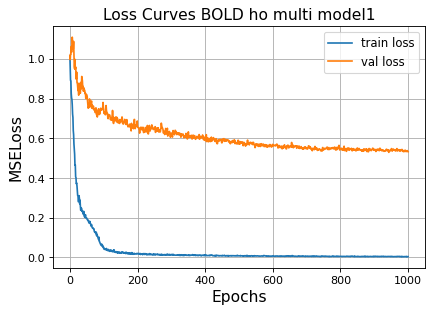

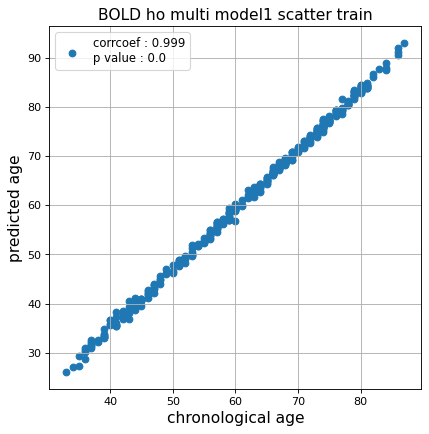

r^2 train data:  0.9523836928521558


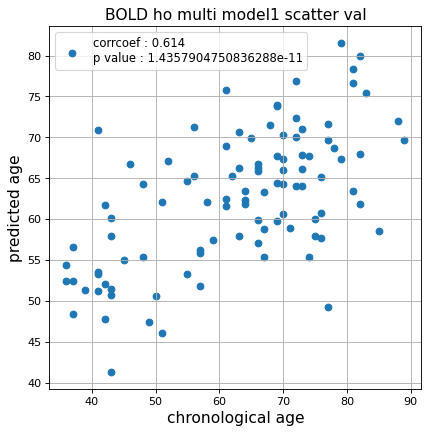

r^2 val data:  0.37585125822672216


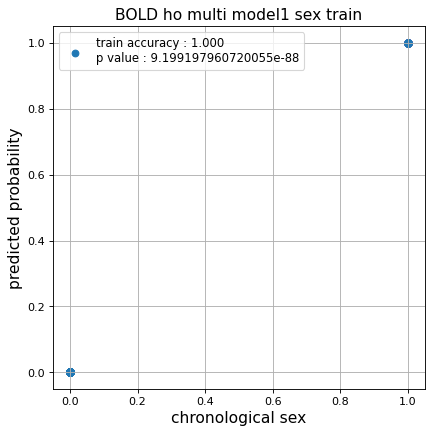

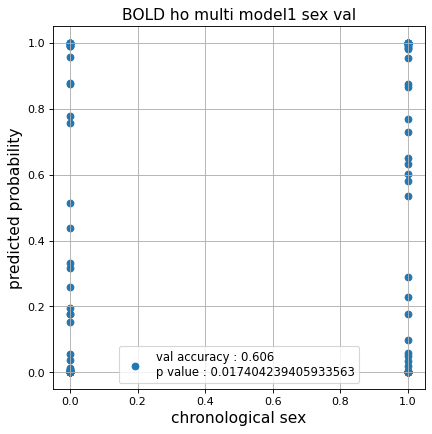

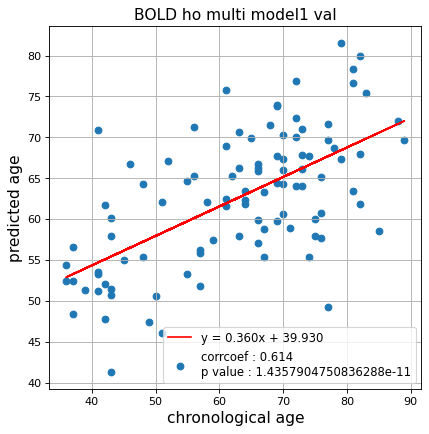

切片: 39.929674838723116
傾き: 0.36036842031032895
Kfold: 3 ::: epoch: 100, loss: 0.03645000090965858, val loss: 0.9224464297294617
Kfold: 3 ::: epoch: 200, loss: 0.019071346793610316, val loss: 0.8144434541463852
Kfold: 3 ::: epoch: 300, loss: 0.011750105123680372, val loss: 0.8404256999492645
Kfold: 3 ::: epoch: 400, loss: 0.011334568477020813, val loss: 0.8513322025537491
Kfold: 3 ::: epoch: 500, loss: 0.0076561992128308005, val loss: 0.8443153500556946
Kfold: 3 ::: epoch: 600, loss: 0.007011579636197824, val loss: 0.727637767791748
Kfold: 3 ::: epoch: 700, loss: 0.006899615821356957, val loss: 0.8082882612943649
Kfold: 3 ::: epoch: 800, loss: 0.005165268756592503, val loss: 0.7970853000879288
Kfold: 3 ::: epoch: 900, loss: 0.005667398647906689, val loss: 0.8022435754537582
Kfold: 3 ::: epoch: 1000, loss: 0.005039124946611432, val loss: 0.7989111840724945
save_epochs:600
best val loss:0.727637767791748


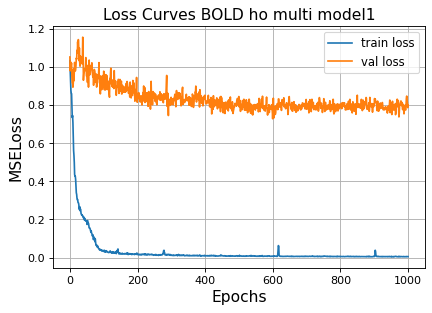

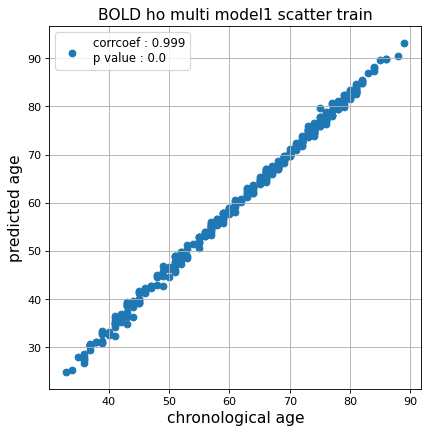

r^2 train data:  0.9423380853429276


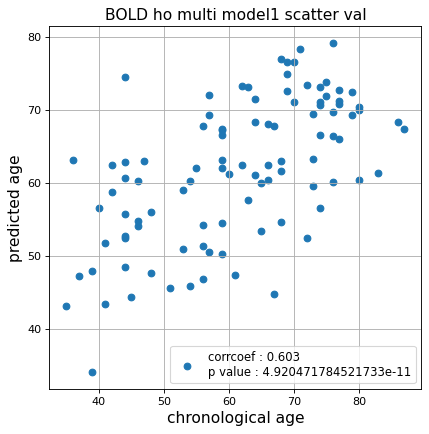

r^2 val data:  0.34538421303650535


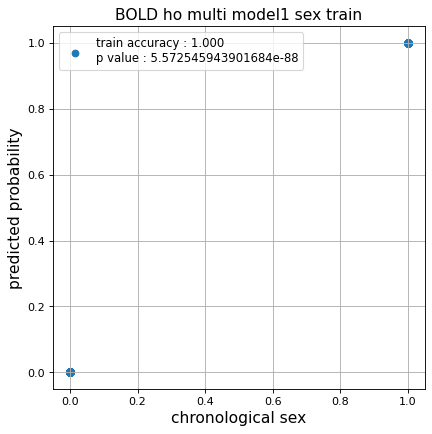

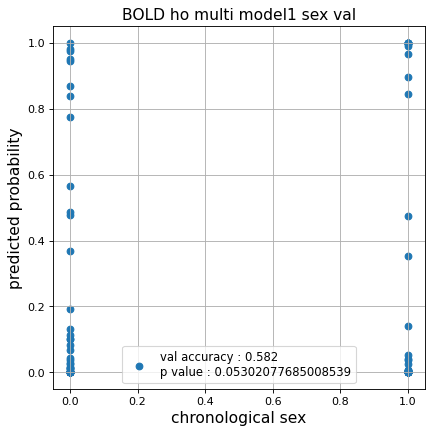

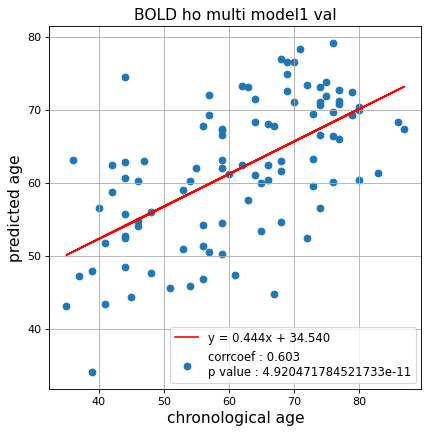

切片: 34.540081564440676
傾き: 0.44390286139107876
Kfold: 4 ::: epoch: 100, loss: 0.03749047692578573, val loss: 1.294901356101036
Kfold: 4 ::: epoch: 200, loss: 0.023746313312305853, val loss: 1.3112697899341583
Kfold: 4 ::: epoch: 300, loss: 0.01477326495716205, val loss: 1.205002635717392
Kfold: 4 ::: epoch: 400, loss: 0.010494870473988928, val loss: 1.1963541358709335
Kfold: 4 ::: epoch: 500, loss: 0.010768767088078536, val loss: 1.1531959474086761
Kfold: 4 ::: epoch: 600, loss: 0.0065490592342729755, val loss: 1.2138550579547882
Kfold: 4 ::: epoch: 700, loss: 0.006966360199909944, val loss: 1.1796511113643646
Kfold: 4 ::: epoch: 800, loss: 0.005147181702061341, val loss: 1.153442606329918
Kfold: 4 ::: epoch: 900, loss: 0.004479651858743567, val loss: 1.1785406172275543
Kfold: 4 ::: epoch: 1000, loss: 0.004581873949903708, val loss: 1.1696668714284897
save_epochs:810
best val loss:1.1157016456127167


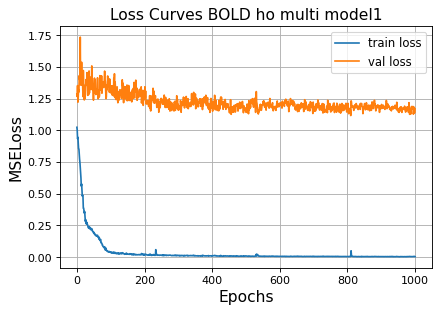

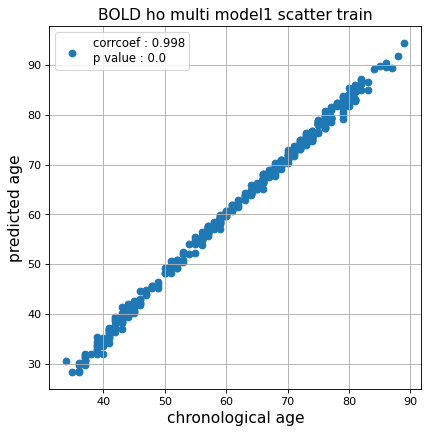

r^2 train data:  0.9541668073777083


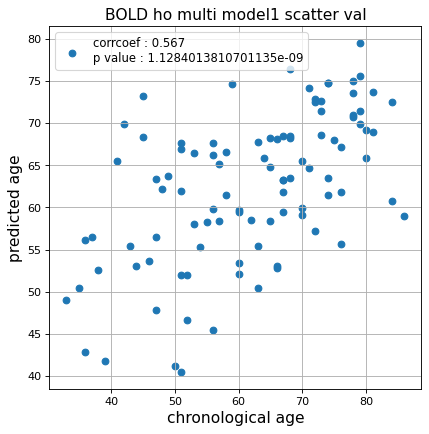

r^2 val data:  0.31277072949373175


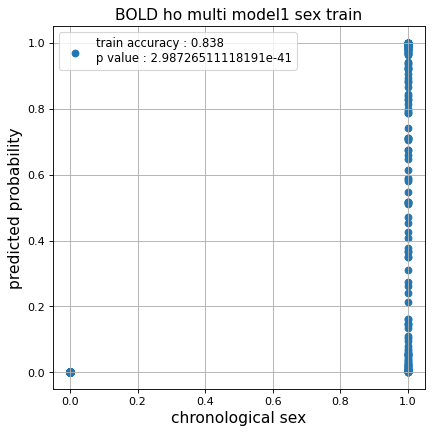

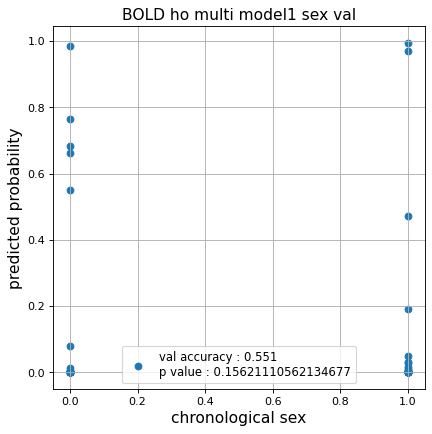

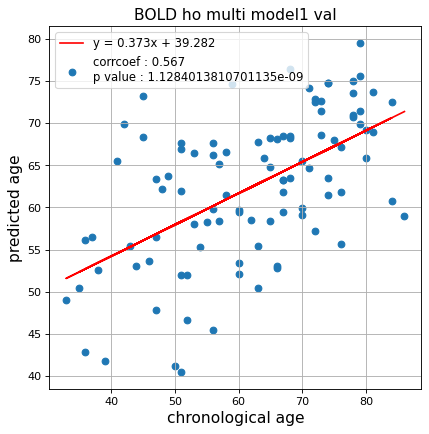

切片: 39.28200625176065
傾き: 0.37307364225299816
Kfold: 5 ::: epoch: 100, loss: 0.034508356681236856, val loss: 0.7699762433767319
Kfold: 5 ::: epoch: 200, loss: 0.01871763141109393, val loss: 0.7679775431752205
Kfold: 5 ::: epoch: 300, loss: 0.012527192011475563, val loss: 0.7573792785406113
Kfold: 5 ::: epoch: 400, loss: 0.009486038488550829, val loss: 0.7506161257624626
Kfold: 5 ::: epoch: 500, loss: 0.00898623620518125, val loss: 0.7535644769668579
Kfold: 5 ::: epoch: 600, loss: 0.006658169530475369, val loss: 0.751117080450058
Kfold: 5 ::: epoch: 700, loss: 0.00653866443854685, val loss: 0.7285584956407547
Kfold: 5 ::: epoch: 800, loss: 0.005701700440393045, val loss: 0.7199867069721222
Kfold: 5 ::: epoch: 900, loss: 0.005568522512196348, val loss: 0.7162608131766319
Kfold: 5 ::: epoch: 1000, loss: 0.005311185476155235, val loss: 0.7061515897512436
save_epochs:997
best val loss:0.6988539770245552


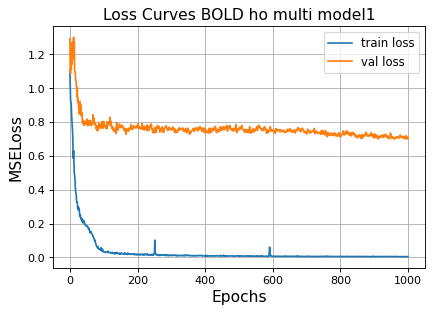

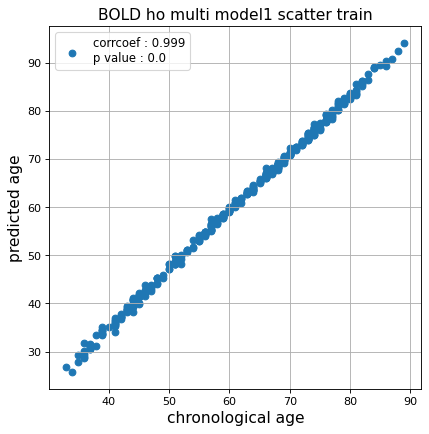

r^2 train data:  0.9560111618837488


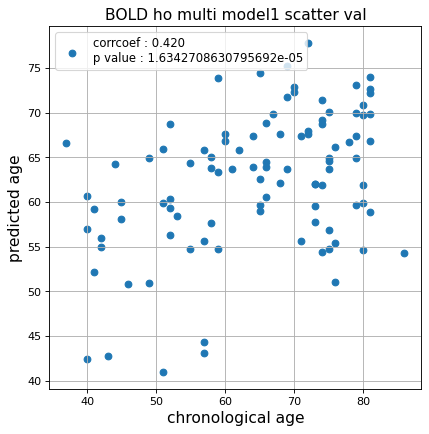

r^2 val data:  0.1149484671672173


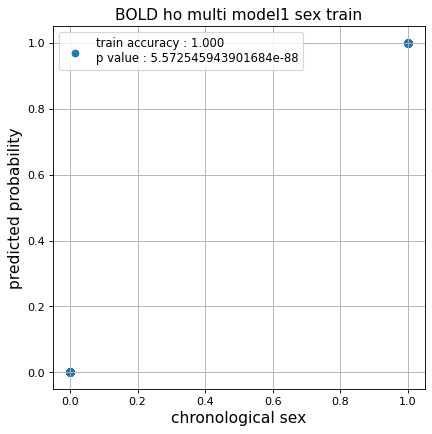

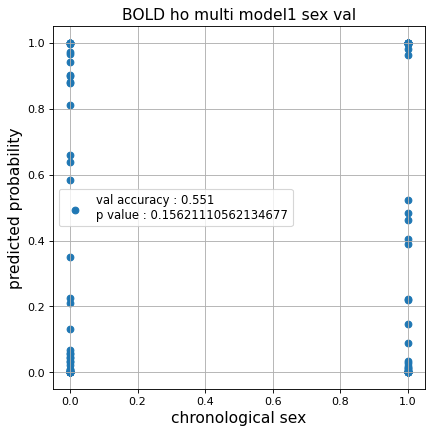

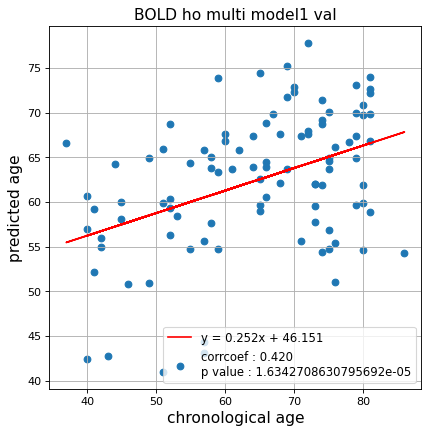

切片: 46.150583395436286
傾き: 0.25223678033732105
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.04519939164702709, val loss: 0.6240658387541771
Kfold: 1 ::: epoch: 200, loss: 0.021794861970612638, val loss: 0.562473401427269
Kfold: 1 ::: epoch: 300, loss: 0.0170887174228063, val loss: 0.5418360307812691
Kfold: 1 ::: epoch: 400, loss: 0.013960297183635144, val loss: 0.5211006328463554
Kfold: 1 ::: epoch: 500, loss: 0.009785620710597588, val loss: 0.5250677466392517
Kfold: 1 ::: epoch: 600, loss: 0.007312366703095345, val loss: 0.5137019380927086
Kfold: 1 ::: epoch: 700, loss: 0.006343977812391061, val loss: 0.5032046437263489
Kfold: 1 ::: epoch: 800, loss: 0.006474785461950188, val loss: 0.48829031735658646
Kfold: 1 ::: epoch: 900, loss: 0.006428916275931092, val loss: 0.48273542150855064
Kfold: 1 ::: epoch: 1000, loss: 0.005980852955522446, val loss: 0.49283407628536224
save_epochs:940
best val loss:0.47446881979703903


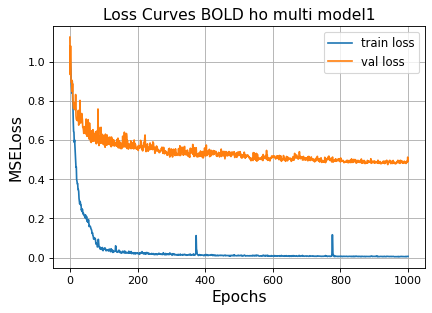

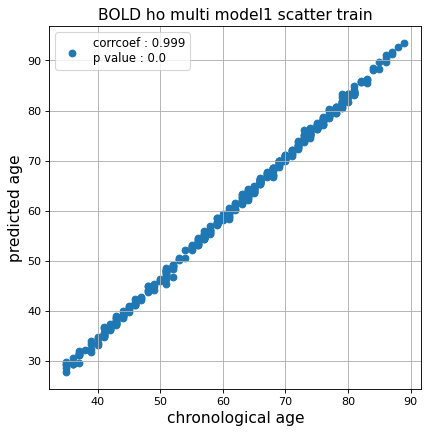

r^2 train data:  0.9497246423747349


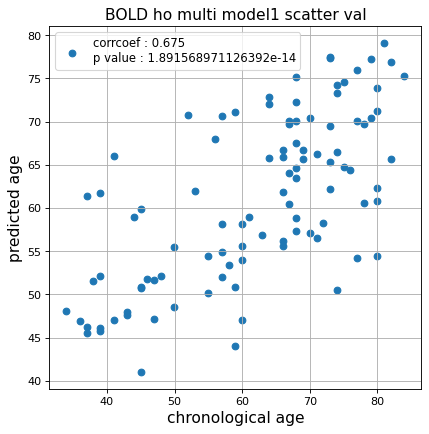

r^2 val data:  0.4494835786580139


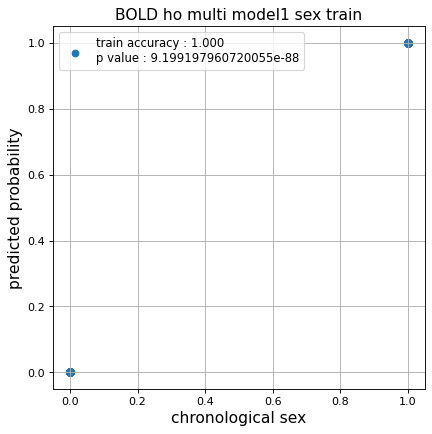

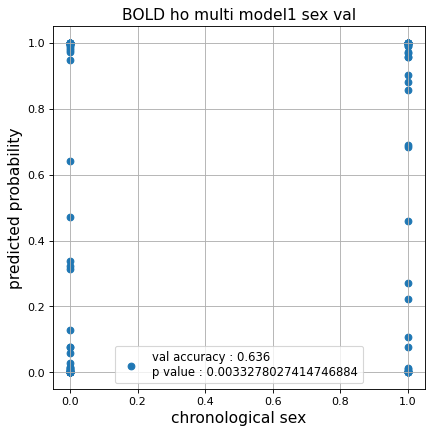

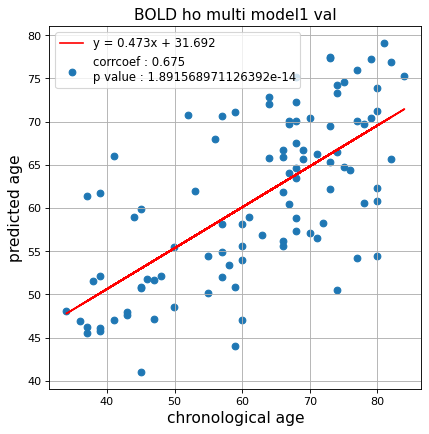

切片: 31.691694682752924
傾き: 0.47324448888037973
Kfold: 2 ::: epoch: 100, loss: 0.05581566662742542, val loss: 0.7065518721938133
Kfold: 2 ::: epoch: 200, loss: 0.023011113588626567, val loss: 0.6626113653182983
Kfold: 2 ::: epoch: 300, loss: 0.014947474289398927, val loss: 0.6155401393771172
Kfold: 2 ::: epoch: 400, loss: 0.00891152647538827, val loss: 0.6089426502585411
Kfold: 2 ::: epoch: 500, loss: 0.008080533168350276, val loss: 0.5788139551877975
Kfold: 2 ::: epoch: 600, loss: 0.0076351107742923955, val loss: 0.5910023078322411
Kfold: 2 ::: epoch: 700, loss: 0.006907555238845257, val loss: 0.5855752974748611
Kfold: 2 ::: epoch: 800, loss: 0.0058565761249225875, val loss: 0.5665857493877411
Kfold: 2 ::: epoch: 900, loss: 0.00538688710031028, val loss: 0.5608187019824982
Kfold: 2 ::: epoch: 1000, loss: 0.004506377951027109, val loss: 0.5519327595829964
save_epochs:953
best val loss:0.5472863167524338


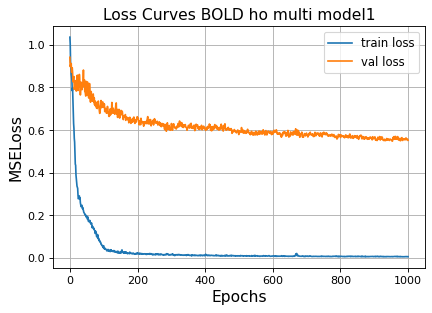

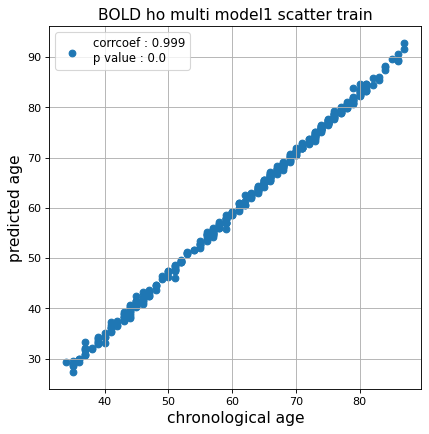

r^2 train data:  0.9544286071598608


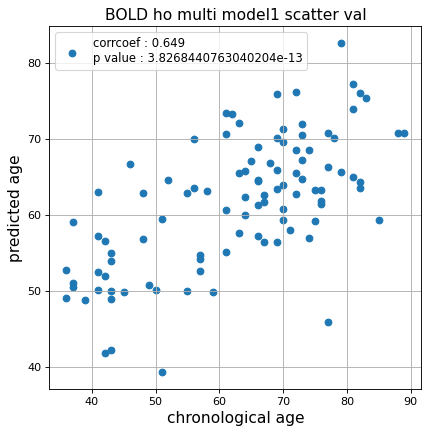

r^2 val data:  0.41447999420646287


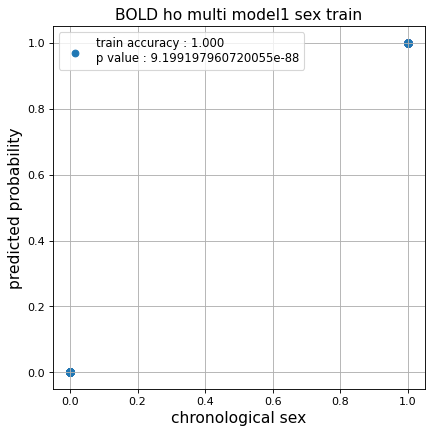

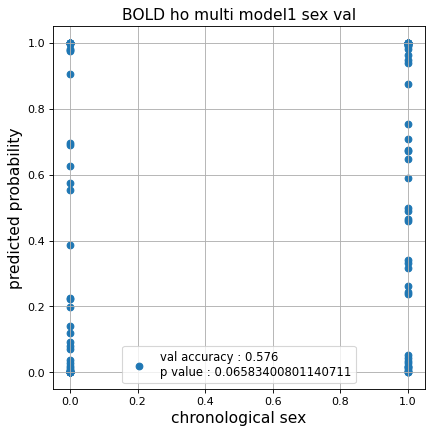

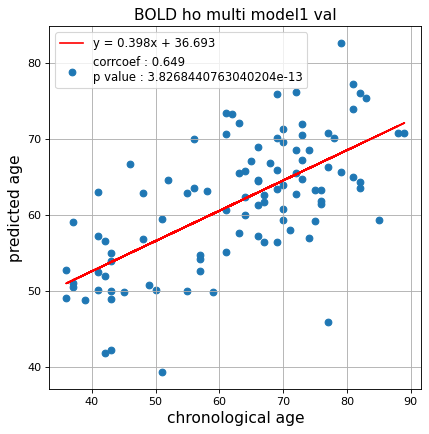

切片: 36.693290438883245
傾き: 0.39805020895725557
Kfold: 3 ::: epoch: 100, loss: 0.037022870607101, val loss: 0.6526521816849709
Kfold: 3 ::: epoch: 200, loss: 0.015276042099755544, val loss: 0.6557113826274872
Kfold: 3 ::: epoch: 300, loss: 0.012347207225572605, val loss: 0.65982286632061
Kfold: 3 ::: epoch: 400, loss: 0.0107376234820829, val loss: 0.6422701627016068
Kfold: 3 ::: epoch: 500, loss: 0.007350336885652863, val loss: 0.6376815736293793
Kfold: 3 ::: epoch: 600, loss: 0.006853292015596078, val loss: 0.6225280910730362
Kfold: 3 ::: epoch: 700, loss: 0.006009536472937236, val loss: 0.6150618642568588
Kfold: 3 ::: epoch: 800, loss: 0.03324158855069142, val loss: 0.5787922590970993
Kfold: 3 ::: epoch: 900, loss: 0.004234346543223812, val loss: 0.5955282002687454
Kfold: 3 ::: epoch: 1000, loss: 0.005254718098932734, val loss: 0.593309611082077
save_epochs:803
best val loss:0.5787278637290001


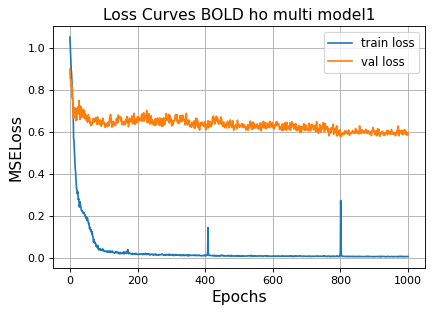

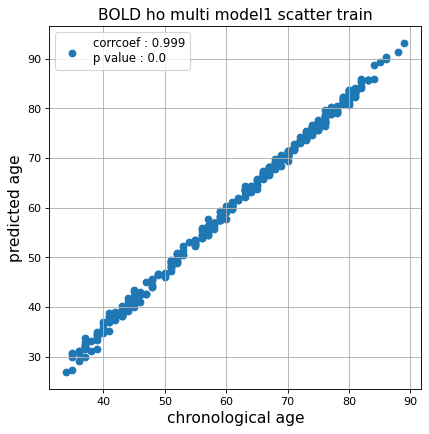

r^2 train data:  0.9653367191435709


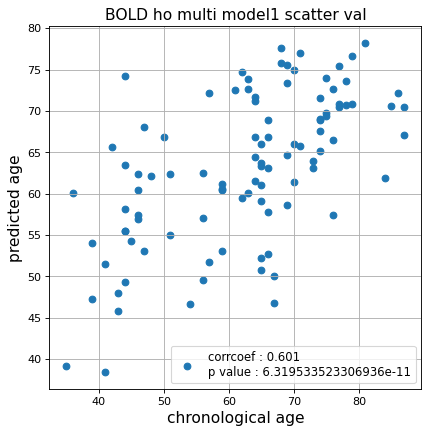

r^2 val data:  0.3499296313657456


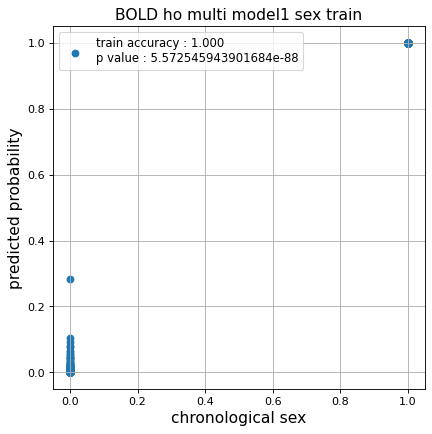

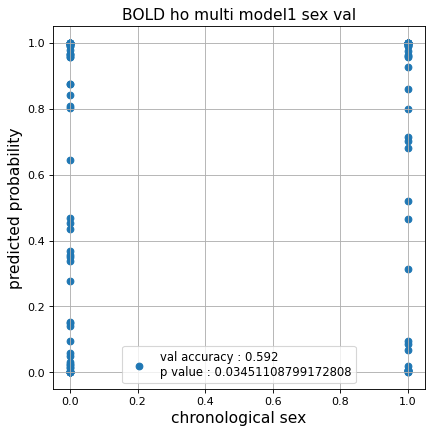

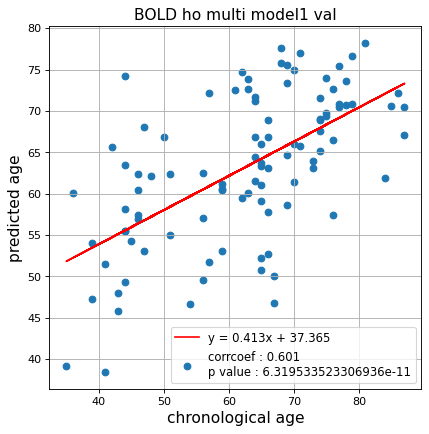

切片: 37.36514006606646
傾き: 0.41312515025705243
Kfold: 4 ::: epoch: 100, loss: 0.039172240604574866, val loss: 1.3215882182121277
Kfold: 4 ::: epoch: 200, loss: 0.020507081125218134, val loss: 1.3252404481172562
Kfold: 4 ::: epoch: 300, loss: 0.01382235151070815, val loss: 1.2664391994476318
Kfold: 4 ::: epoch: 400, loss: 0.01111934448664005, val loss: 1.2578002959489822
Kfold: 4 ::: epoch: 500, loss: 0.008344630298849482, val loss: 1.2066203132271767
Kfold: 4 ::: epoch: 600, loss: 0.006785762030631304, val loss: 1.2651972770690918
Kfold: 4 ::: epoch: 700, loss: 0.00655643161959373, val loss: 1.2301210016012192
Kfold: 4 ::: epoch: 800, loss: 0.00532422662497713, val loss: 1.1960175037384033
Kfold: 4 ::: epoch: 900, loss: 0.004507695879930487, val loss: 1.2004114389419556
Kfold: 4 ::: epoch: 1000, loss: 0.0038941897756348434, val loss: 1.1884738057851791
save_epochs:980
best val loss:1.1548156216740608


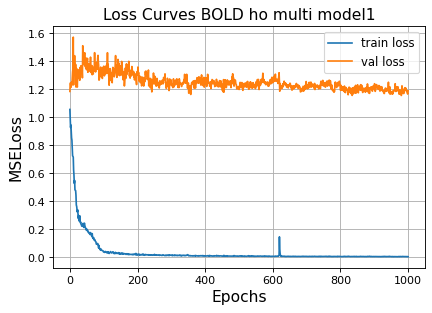

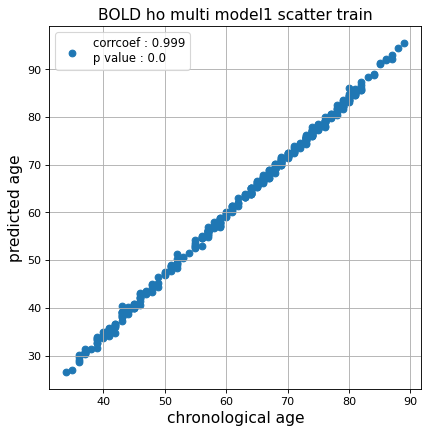

r^2 train data:  0.938877443127788


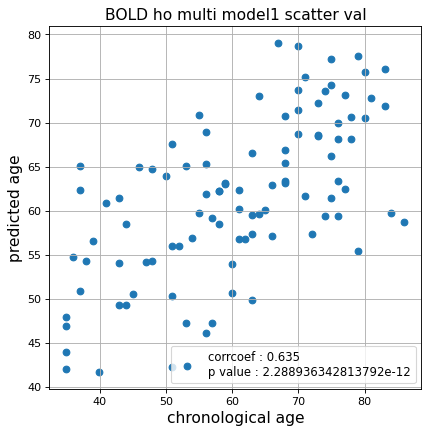

r^2 val data:  0.39921699331875893


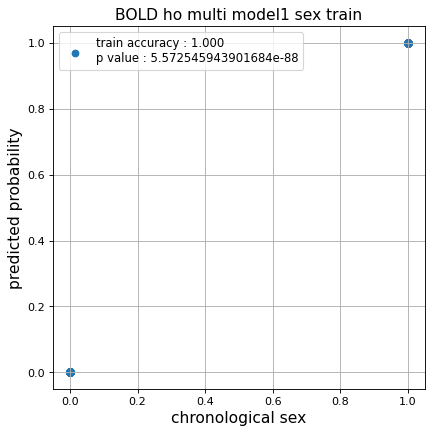

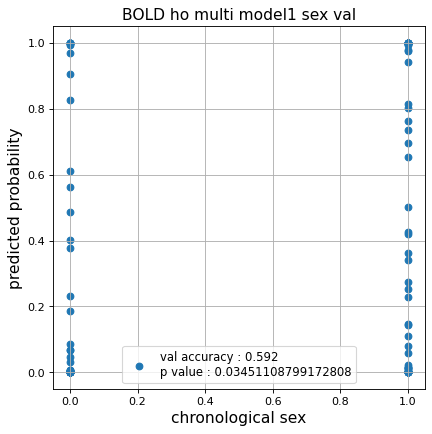

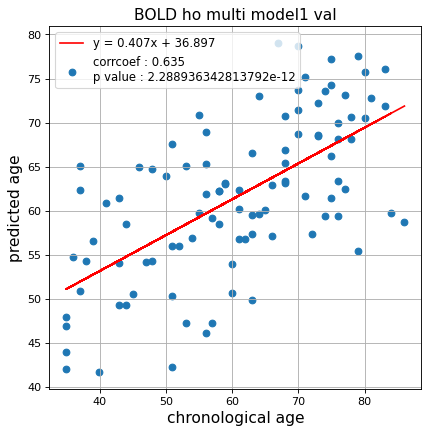

切片: 36.896944345750796
傾き: 0.40673344605073963
Kfold: 5 ::: epoch: 100, loss: 0.03963074747186441, val loss: 0.7353847995400429
Kfold: 5 ::: epoch: 200, loss: 0.01872586874434581, val loss: 0.7107532303780317
Kfold: 5 ::: epoch: 300, loss: 0.013220462303322095, val loss: 0.6565422844141722
Kfold: 5 ::: epoch: 400, loss: 0.00918867876036809, val loss: 0.6609658384695649
Kfold: 5 ::: epoch: 500, loss: 0.007830195093097595, val loss: 0.641995694488287
Kfold: 5 ::: epoch: 600, loss: 0.007421990999808678, val loss: 0.6486192233860493
Kfold: 5 ::: epoch: 700, loss: 0.005179734703583213, val loss: 0.6239577904343605
Kfold: 5 ::: epoch: 800, loss: 0.00513575913814398, val loss: 0.6289347521960735
Kfold: 5 ::: epoch: 900, loss: 0.005288011716822019, val loss: 0.6187167223542929
Kfold: 5 ::: epoch: 1000, loss: 0.006883232209544916, val loss: 0.6354387924075127
save_epochs:742
best val loss:0.6070435289293528


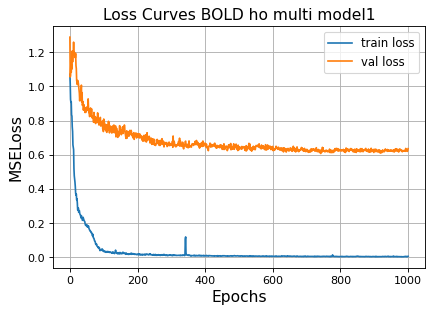

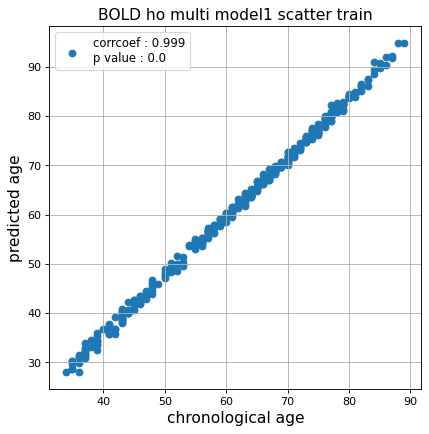

r^2 train data:  0.956914805226042


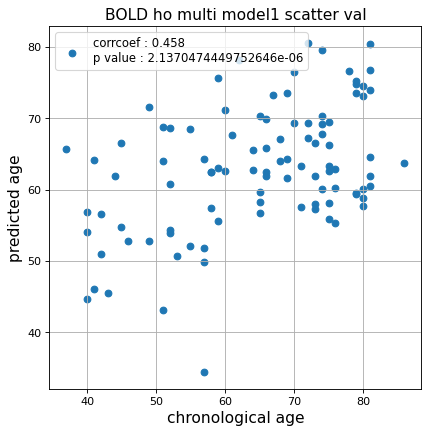

r^2 val data:  0.1421144688155983


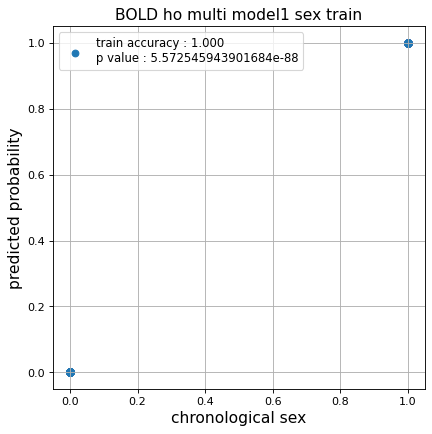

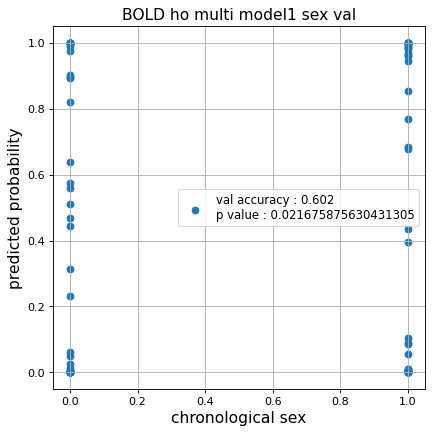

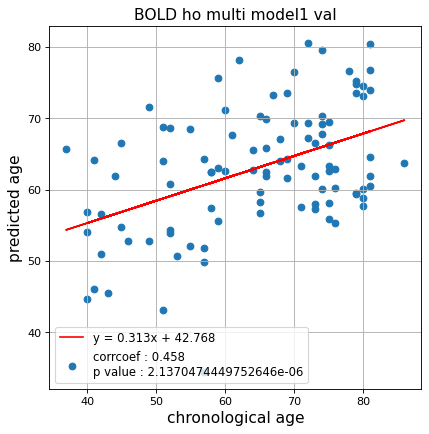

切片: 42.7681317310352
傾き: 0.3134082977847784
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.03968067868397786, val loss: 0.5842161439359188
Kfold: 1 ::: epoch: 200, loss: 0.024617454323631067, val loss: 0.563440527766943
Kfold: 1 ::: epoch: 300, loss: 0.01396096211213332, val loss: 0.555379644036293
Kfold: 1 ::: epoch: 400, loss: 0.010955443319219809, val loss: 0.564542330801487
Kfold: 1 ::: epoch: 500, loss: 0.009034906693089467, val loss: 0.5716939866542816
Kfold: 1 ::: epoch: 600, loss: 0.007719031875379956, val loss: 0.5736013352870941
Kfold: 1 ::: epoch: 700, loss: 0.007137795981879418, val loss: 0.5658491812646389
Kfold: 1 ::: epoch: 800, loss: 0.007185937693485847, val loss: 0.5520420148968697
Kfold: 1 ::: epoch: 900, loss: 0.004864841645870071, val loss: 0.5981891378760338
Kfold: 1 ::: epoch: 1000, loss: 0.0041590879599635415, val loss: 0.5691431015729904
save_epochs:608
best val loss:0.5327852889895439


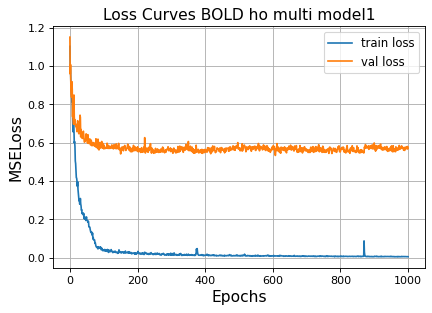

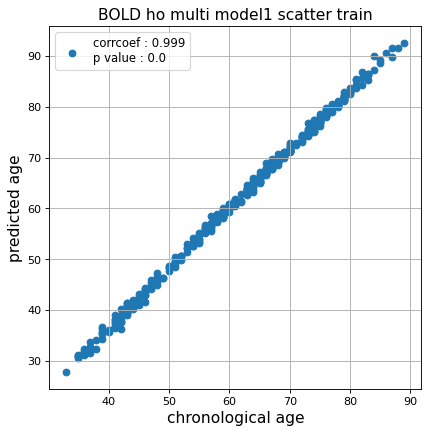

r^2 train data:  0.9682894270473761


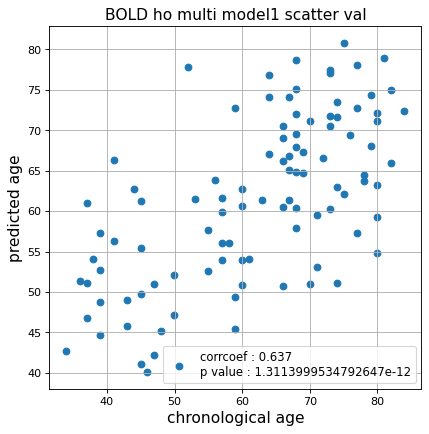

r^2 val data:  0.39432588727523354


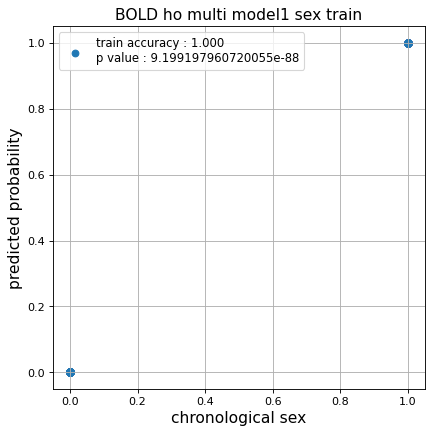

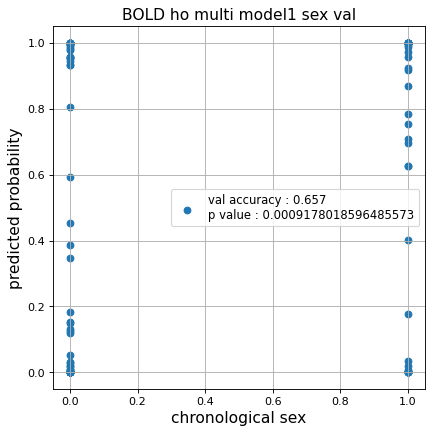

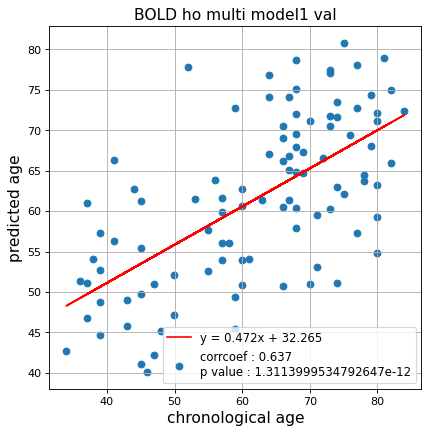

切片: 32.26516223609943
傾き: 0.47156406568677495
Kfold: 2 ::: epoch: 100, loss: 0.046638801120794736, val loss: 0.6919684559106827
Kfold: 2 ::: epoch: 200, loss: 0.021067991351278927, val loss: 0.6730025559663773
Kfold: 2 ::: epoch: 300, loss: 0.012131091852027636, val loss: 0.6051678955554962
Kfold: 2 ::: epoch: 400, loss: 0.00979103259025858, val loss: 0.6036260724067688
Kfold: 2 ::: epoch: 500, loss: 0.007114057500775044, val loss: 0.5967107824981213
Kfold: 2 ::: epoch: 600, loss: 0.00748227472202136, val loss: 0.589216735213995
Kfold: 2 ::: epoch: 700, loss: 0.007393497705029754, val loss: 0.5862999483942986
Kfold: 2 ::: epoch: 800, loss: 0.0053490680069304426, val loss: 0.5745282620191574
Kfold: 2 ::: epoch: 900, loss: 0.00452973129442678, val loss: 0.5842999666929245
Kfold: 2 ::: epoch: 1000, loss: 0.0041552412753494885, val loss: 0.5596444644033909
save_epochs:1000
best val loss:0.5596444644033909


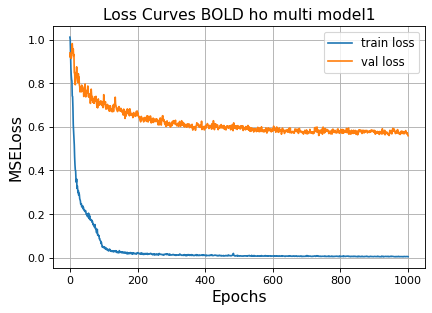

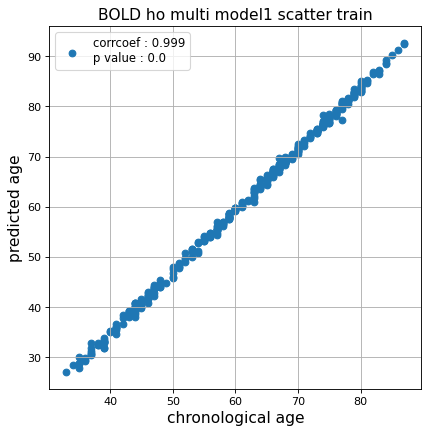

r^2 train data:  0.9483805781126892


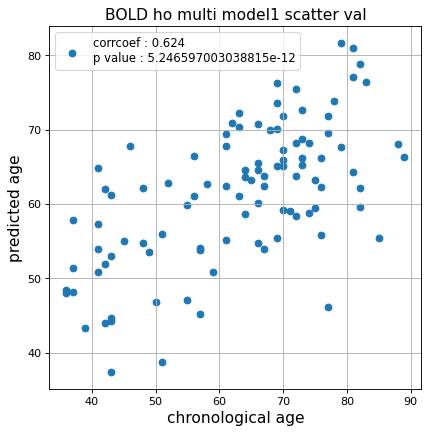

r^2 val data:  0.37825303693141377


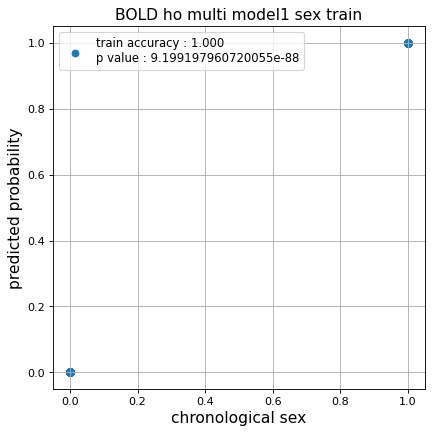

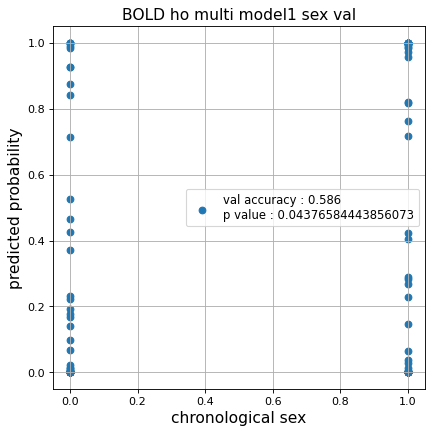

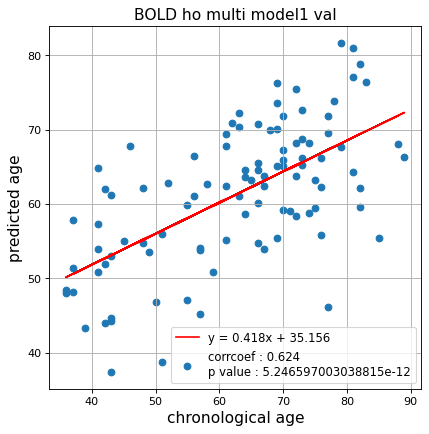

切片: 35.15593933137422
傾き: 0.41753121081577177
Kfold: 3 ::: epoch: 100, loss: 0.03232717958207314, val loss: 0.5860470831394196
Kfold: 3 ::: epoch: 200, loss: 0.018329621364290897, val loss: 0.5647437274456024
Kfold: 3 ::: epoch: 300, loss: 0.011645608151761385, val loss: 0.5652980133891106
Kfold: 3 ::: epoch: 400, loss: 0.010534998781692523, val loss: 0.585635781288147
Kfold: 3 ::: epoch: 500, loss: 0.008365631604997011, val loss: 0.5625799000263214
Kfold: 3 ::: epoch: 600, loss: 0.007557982041572149, val loss: 0.5447722151875496
Kfold: 3 ::: epoch: 700, loss: 0.005990010954869481, val loss: 0.543268233537674
Kfold: 3 ::: epoch: 800, loss: 0.00504177907266869, val loss: 0.5634588003158569
Kfold: 3 ::: epoch: 900, loss: 0.004284814806081927, val loss: 0.5439185202121735
Kfold: 3 ::: epoch: 1000, loss: 0.0052954464828452235, val loss: 0.549529679119587
save_epochs:890
best val loss:0.5285520404577255


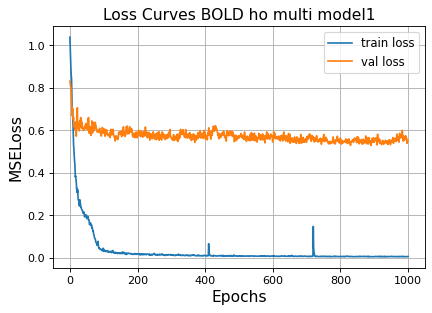

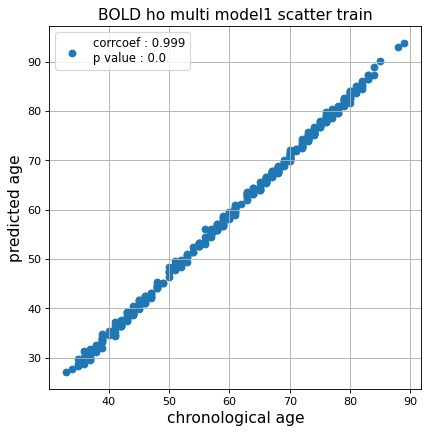

r^2 train data:  0.9504105229871973


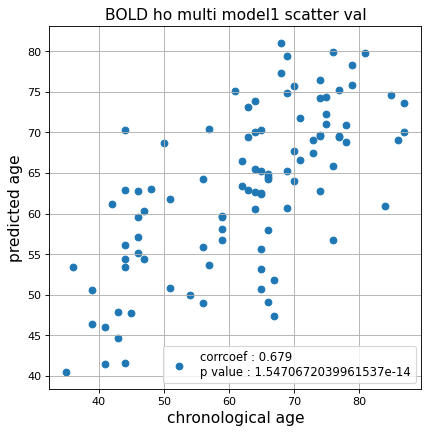

r^2 val data:  0.453933439188574


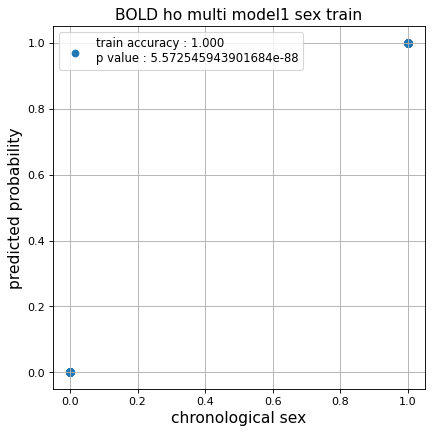

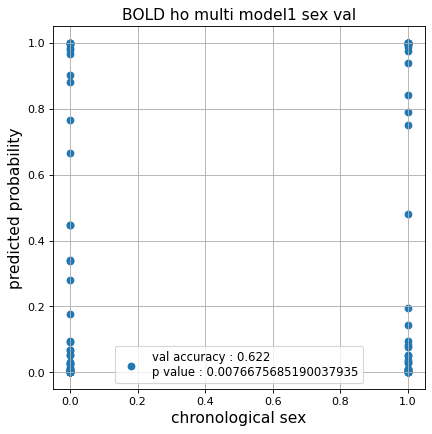

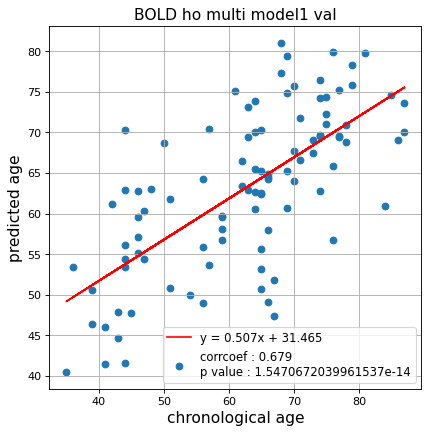

切片: 31.46523338067947
傾き: 0.5066431487152344
Kfold: 4 ::: epoch: 100, loss: 0.04032286227895664, val loss: 0.5787349194288254
Kfold: 4 ::: epoch: 200, loss: 0.023277073740386046, val loss: 0.5394375622272491
Kfold: 4 ::: epoch: 300, loss: 0.014175603739344157, val loss: 0.5198496133089066
Kfold: 4 ::: epoch: 400, loss: 0.009534221464911332, val loss: 0.5069601386785507
Kfold: 4 ::: epoch: 500, loss: 0.01004540347135984, val loss: 0.5022579953074455
Kfold: 4 ::: epoch: 600, loss: 0.008072842987110982, val loss: 0.5020314007997513
Kfold: 4 ::: epoch: 700, loss: 0.0067936532342663175, val loss: 0.5000737905502319
Kfold: 4 ::: epoch: 800, loss: 0.005296139565941233, val loss: 0.4978775233030319
Kfold: 4 ::: epoch: 900, loss: 0.004483740508126525, val loss: 0.47656475007534027
Kfold: 4 ::: epoch: 1000, loss: 0.004357290149738009, val loss: 0.4653049483895302
save_epochs:1000
best val loss:0.4653049483895302


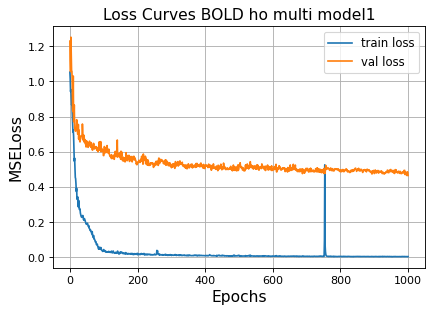

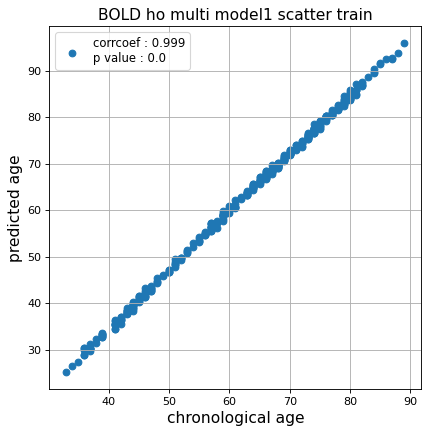

r^2 train data:  0.9322276394815101


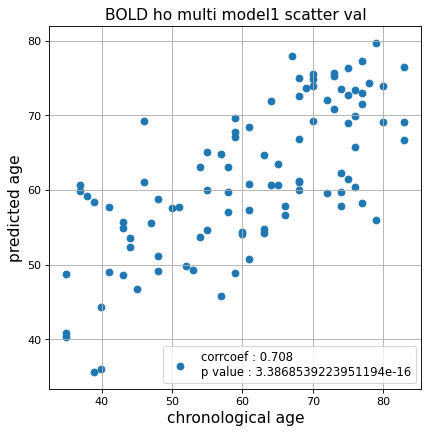

r^2 val data:  0.4998822867753915


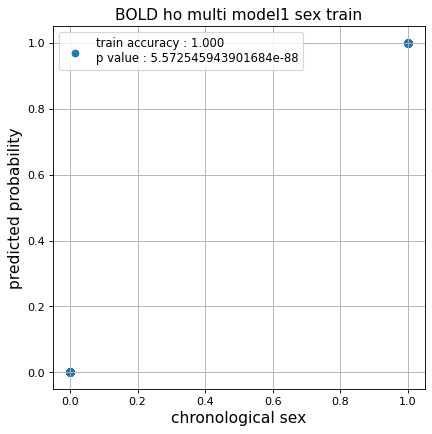

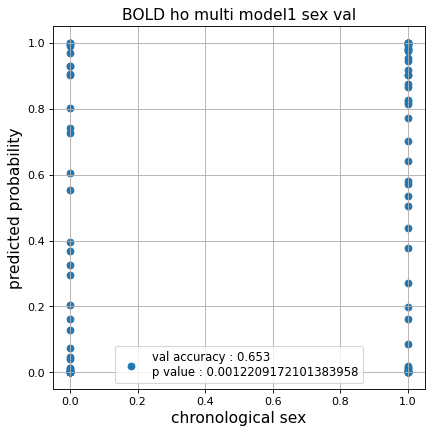

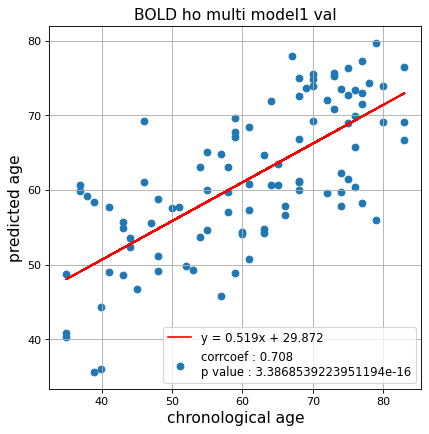

切片: 29.87243996487867
傾き: 0.5191925978752415
Kfold: 5 ::: epoch: 100, loss: 0.0353087609490523, val loss: 0.8211299926042557
Kfold: 5 ::: epoch: 200, loss: 0.020222334047922723, val loss: 0.8320198655128479
Kfold: 5 ::: epoch: 300, loss: 0.015539680034495316, val loss: 0.7890795767307281
Kfold: 5 ::: epoch: 400, loss: 0.009336076390284758, val loss: 0.8087780177593231
Kfold: 5 ::: epoch: 500, loss: 0.007676391432491632, val loss: 0.792530283331871
Kfold: 5 ::: epoch: 600, loss: 0.008617834832805853, val loss: 0.8067655935883522
Kfold: 5 ::: epoch: 700, loss: 0.005344420062521329, val loss: 0.7768756672739983
Kfold: 5 ::: epoch: 800, loss: 0.005772024715462556, val loss: 0.7956787794828415
Kfold: 5 ::: epoch: 900, loss: 0.004632806065134131, val loss: 0.8042835667729378
Kfold: 5 ::: epoch: 1000, loss: 0.006523919327614399, val loss: 0.7494729161262512
save_epochs:571
best val loss:0.7354119271039963


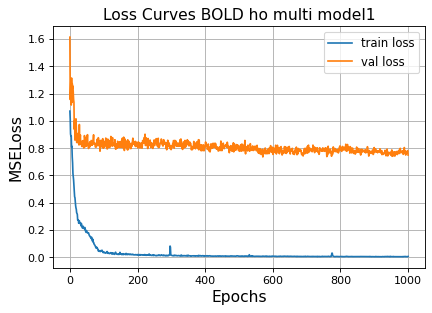

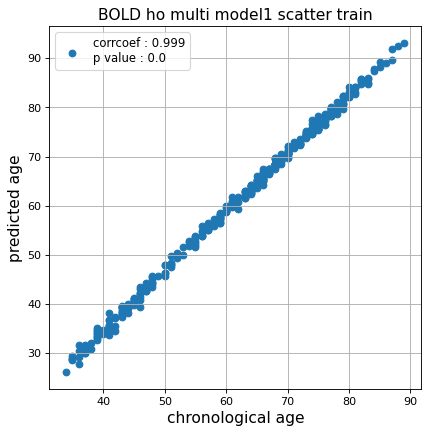

r^2 train data:  0.9548538801433482


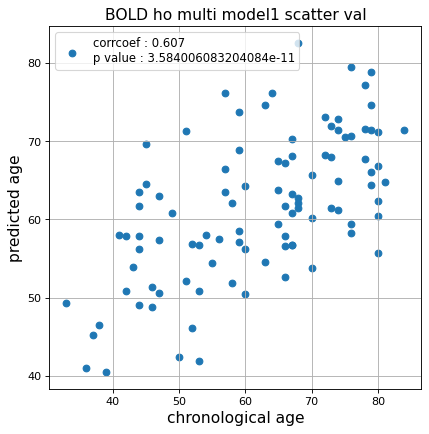

r^2 val data:  0.359588344203719


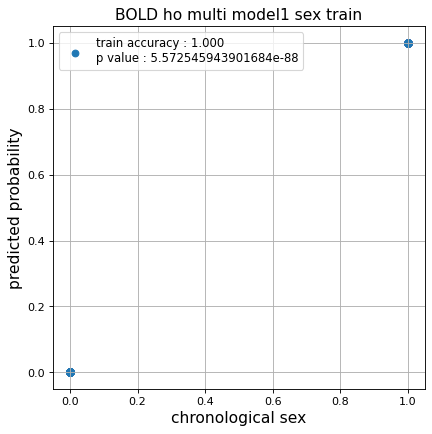

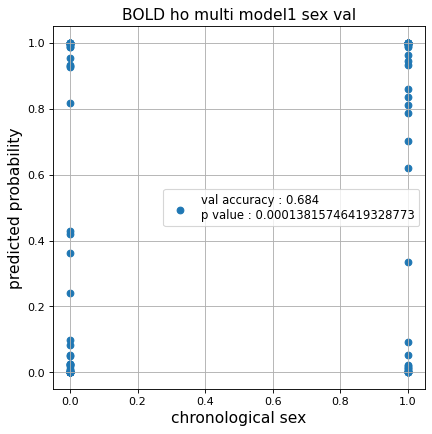

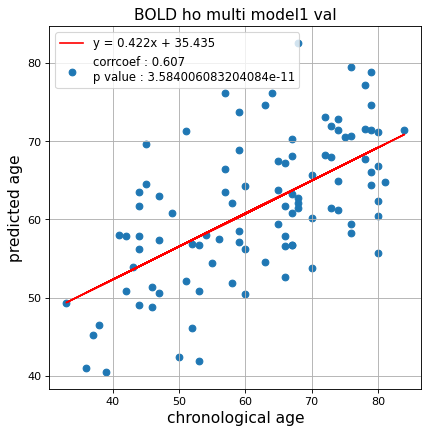

切片: 35.43496895963116
傾き: 0.4218221948272473
CPU times: user 2h 10min 47s, sys: 18min 35s, total: 2h 29min 22s
Wall time: 2h 29min 34s


In [21]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_all_1  = []
test_pred_ho_all_inverse_1  = []
test_label_ho_all_1 = []

test_idx_ho_all_1   = []
train_idx_ho_all_1  = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_inverse,test_label = train_model(data_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 256,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 1024,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.2,
                                                           fc_drop = 0.1,
                                                           title = 'BOLD ho multi model1'
                                                          )
    
    test_pred_ho_all_1.append(test_pred)
    test_pred_ho_all_inverse_1.append(test_pred_inverse)
    test_label_ho_all_1.append(test_label)

    test_idx_ho_all_1.append(test_idx)
    train_idx_ho_all_1.append(train_idx)

### Bold 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.16397798175995165, val loss: 0.7522033601999283
Kfold: 1 ::: epoch: 200, loss: 0.03820926323533058, val loss: 0.6761488616466522
Kfold: 1 ::: epoch: 300, loss: 0.020924251025112774, val loss: 0.6552929654717445
Kfold: 1 ::: epoch: 400, loss: 0.016558964951680258, val loss: 0.6169401407241821
Kfold: 1 ::: epoch: 500, loss: 0.013832764270213934, val loss: 0.6179729476571083
Kfold: 1 ::: epoch: 600, loss: 0.011694034274954062, val loss: 0.5969951897859573
Kfold: 1 ::: epoch: 700, loss: 0.009094060971759833, val loss: 0.593502577394247
Kfold: 1 ::: epoch: 800, loss: 0.009089779502783831, val loss: 0.5793191269040108
Kfold: 1 ::: epoch: 900, loss: 0.008778780268935056, val loss: 0.5752276182174683
Kfold: 1 ::: epoch: 1000, loss: 0.006526569728381359, val loss: 0.5526934191584587
save_epochs:994
best val loss:0.5441655479371548


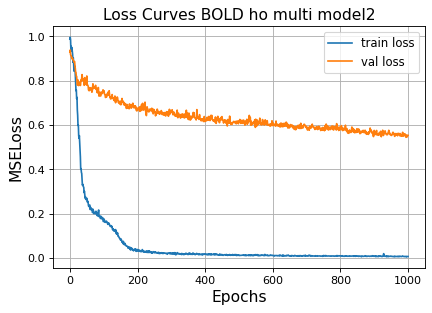

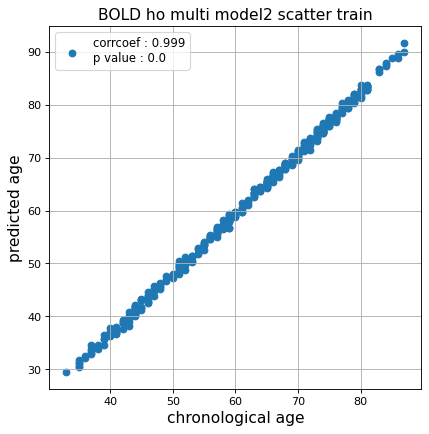

r^2 train data:  0.9771828655457672


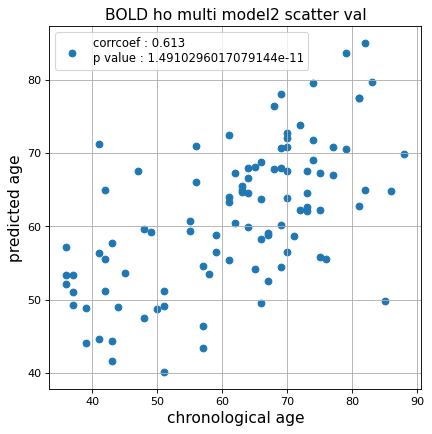

r^2 val data:  0.3663726323979918


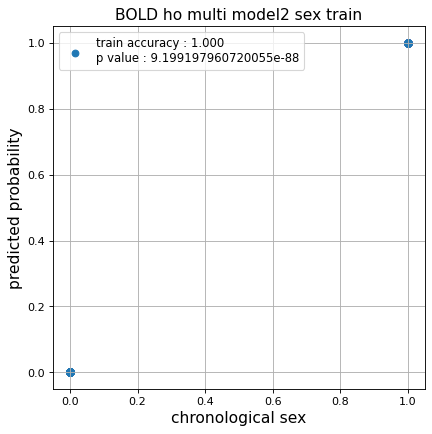

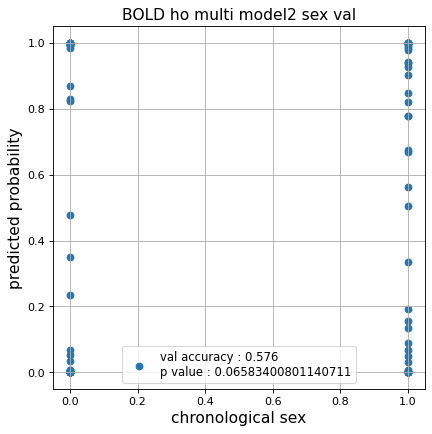

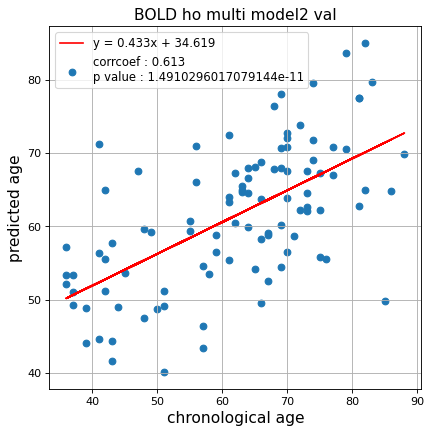

切片: 34.61885063073335
傾き: 0.4328311577272442
Kfold: 2 ::: epoch: 100, loss: 0.18325195748072404, val loss: 0.6640387028455734
Kfold: 2 ::: epoch: 200, loss: 0.0315808981943589, val loss: 0.7123754620552063
Kfold: 2 ::: epoch: 300, loss: 0.02124164977039282, val loss: 0.7313650995492935
Kfold: 2 ::: epoch: 400, loss: 0.014986095376885854, val loss: 0.7051699608564377
Kfold: 2 ::: epoch: 500, loss: 0.013586512480217677, val loss: 0.6776964515447617
Kfold: 2 ::: epoch: 600, loss: 0.01002957893965336, val loss: 0.705644890666008
Kfold: 2 ::: epoch: 700, loss: 0.010029191187081428, val loss: 0.6598640978336334
Kfold: 2 ::: epoch: 800, loss: 0.0076919895632622335, val loss: 0.6858792304992676
Kfold: 2 ::: epoch: 900, loss: 0.007456421099889737, val loss: 0.6697085648775101
Kfold: 2 ::: epoch: 1000, loss: 0.00995364341025169, val loss: 0.6658619493246078
save_epochs:907
best val loss:0.6207309067249298


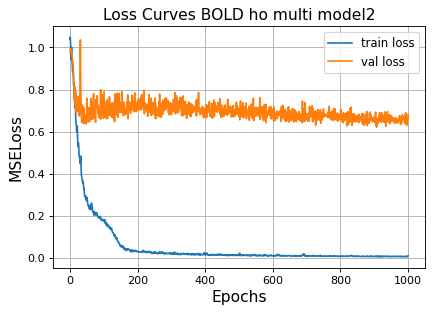

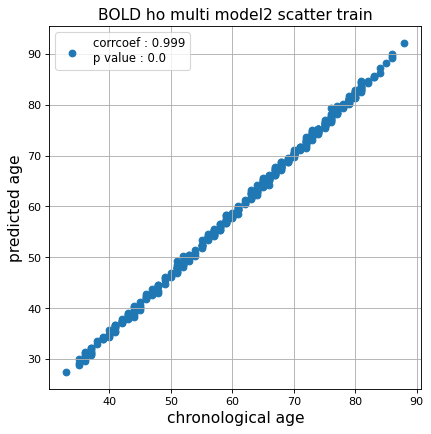

r^2 train data:  0.9604791718484208


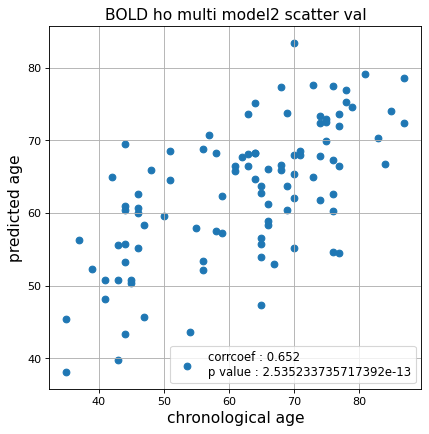

r^2 val data:  0.4197364310373931


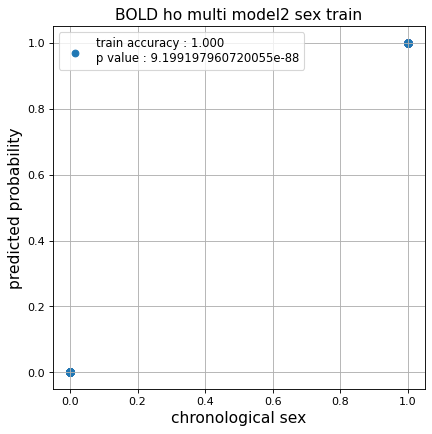

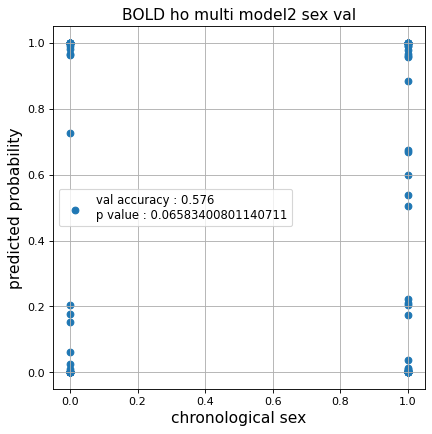

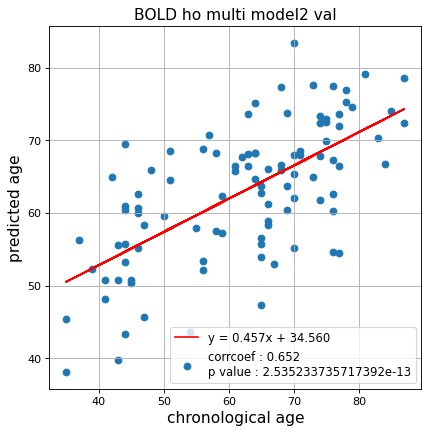

切片: 34.55968698911196
傾き: 0.45679307135330216
Kfold: 3 ::: epoch: 100, loss: 0.19493809227760023, val loss: 0.7764469683170319
Kfold: 3 ::: epoch: 200, loss: 0.03379090975683469, val loss: 0.7010442763566971
Kfold: 3 ::: epoch: 300, loss: 0.019057448093707744, val loss: 0.6854567974805832
Kfold: 3 ::: epoch: 400, loss: 0.016524977910404023, val loss: 0.6415082514286041
Kfold: 3 ::: epoch: 500, loss: 0.014617589302361012, val loss: 0.6234580278396606
Kfold: 3 ::: epoch: 600, loss: 0.012261579744517803, val loss: 0.6057888865470886
Kfold: 3 ::: epoch: 700, loss: 0.009621747142563645, val loss: 0.619496077299118
Kfold: 3 ::: epoch: 800, loss: 0.007724242320714088, val loss: 0.624398872256279
Kfold: 3 ::: epoch: 900, loss: 0.008630094010956012, val loss: 0.5672128051519394
Kfold: 3 ::: epoch: 1000, loss: 0.0060834243463782165, val loss: 0.5972721576690674
save_epochs:814
best val loss:0.5623764544725418


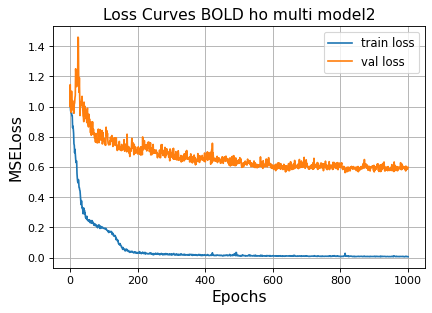

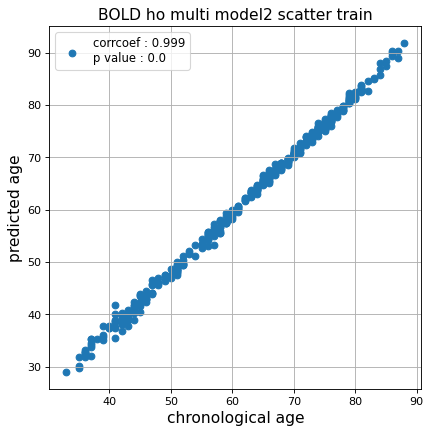

r^2 train data:  0.9790209741696045


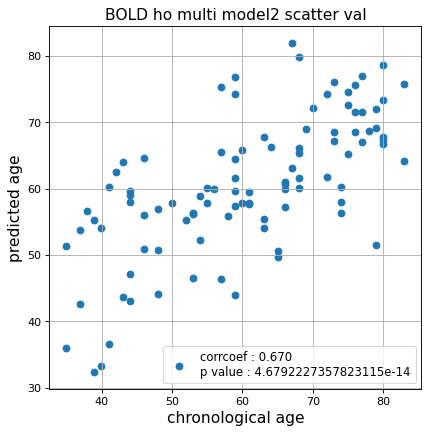

r^2 val data:  0.43804991915041647


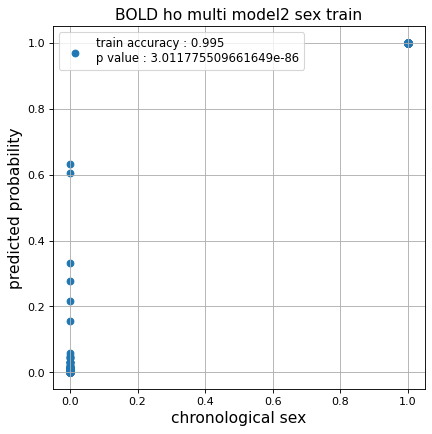

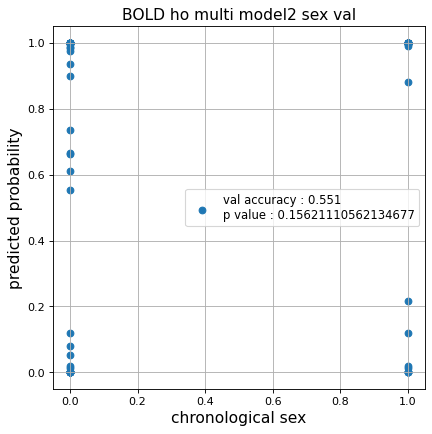

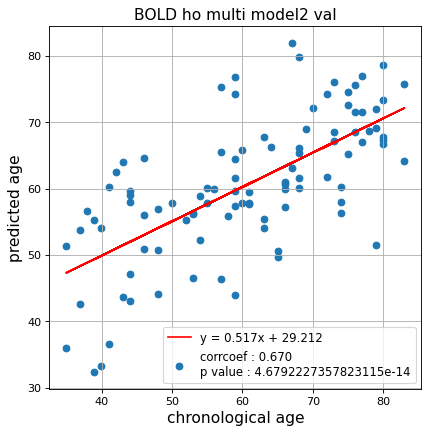

切片: 29.211947659172505
傾き: 0.5171766194274562
Kfold: 4 ::: epoch: 100, loss: 0.18801193168530098, val loss: 1.4524769932031631
Kfold: 4 ::: epoch: 200, loss: 0.036618500804671876, val loss: 1.400949478149414
Kfold: 4 ::: epoch: 300, loss: 0.026953822145095237, val loss: 1.358881190419197
Kfold: 4 ::: epoch: 400, loss: 0.014796731115963597, val loss: 1.4048240929841995
Kfold: 4 ::: epoch: 500, loss: 0.013915304954235371, val loss: 1.3094919994473457
Kfold: 4 ::: epoch: 600, loss: 0.011476477894645471, val loss: 1.3720778673887253
Kfold: 4 ::: epoch: 700, loss: 0.009934337558941199, val loss: 1.285038061439991
Kfold: 4 ::: epoch: 800, loss: 0.0077309742784843994, val loss: 1.2742381542921066
Kfold: 4 ::: epoch: 900, loss: 0.007797091375463284, val loss: 1.2548405304551125
Kfold: 4 ::: epoch: 1000, loss: 0.00747253315953108, val loss: 1.285752035677433
save_epochs:934
best val loss:1.2089166268706322


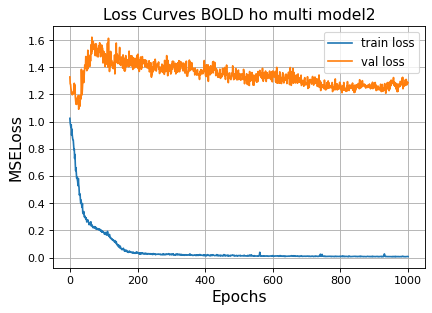

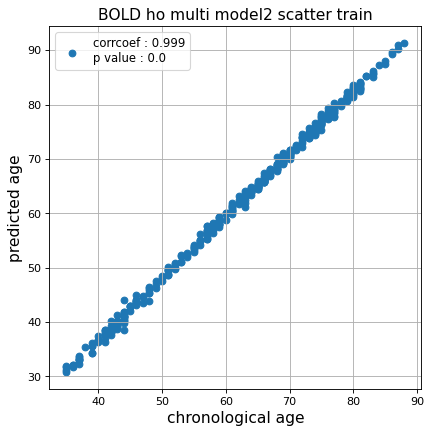

r^2 train data:  0.976710266548199


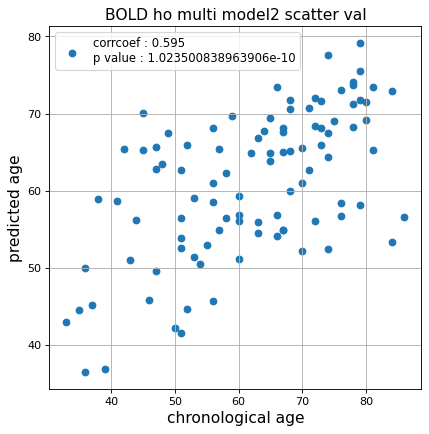

r^2 val data:  0.3349956055799559


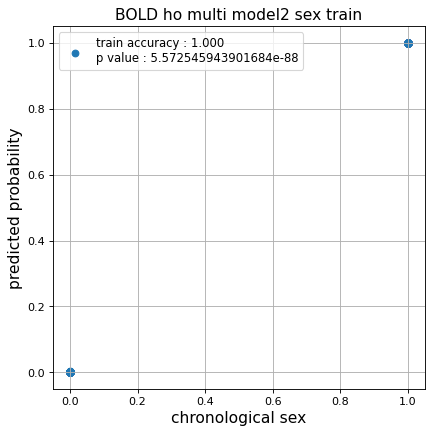

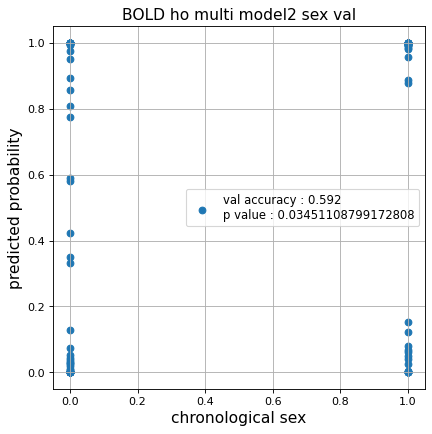

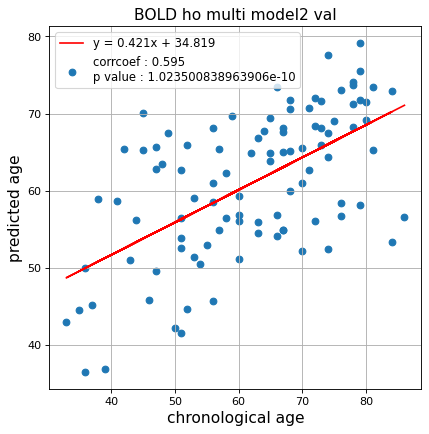

切片: 34.81861391259226
傾き: 0.4214706201185947
Kfold: 5 ::: epoch: 100, loss: 0.18147049156519082, val loss: 0.8185351639986038
Kfold: 5 ::: epoch: 200, loss: 0.028019130803071536, val loss: 0.8080382347106934
Kfold: 5 ::: epoch: 300, loss: 0.01963296740387495, val loss: 0.7687565684318542
Kfold: 5 ::: epoch: 400, loss: 0.013462309295741411, val loss: 0.7602669075131416
Kfold: 5 ::: epoch: 500, loss: 0.012762239883438898, val loss: 0.7452929392457008
Kfold: 5 ::: epoch: 600, loss: 0.009955000311422806, val loss: 0.737373448908329
Kfold: 5 ::: epoch: 700, loss: 0.009430982924711246, val loss: 0.7409712448716164
Kfold: 5 ::: epoch: 800, loss: 0.008255851723683568, val loss: 0.7091249078512192
Kfold: 5 ::: epoch: 900, loss: 0.007124374029584802, val loss: 0.7184936106204987
Kfold: 5 ::: epoch: 1000, loss: 0.007527893803154047, val loss: 0.7038058042526245
save_epochs:867
best val loss:0.6849993020296097


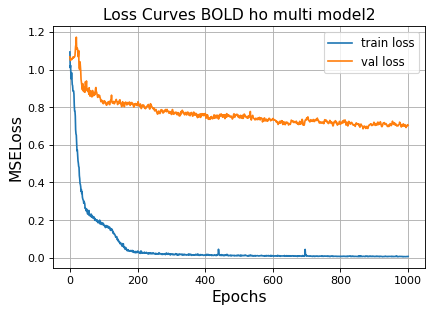

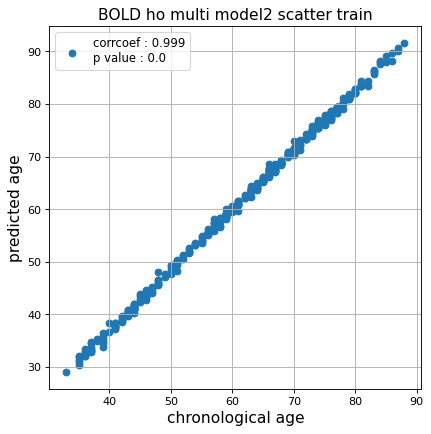

r^2 train data:  0.9785330592149887


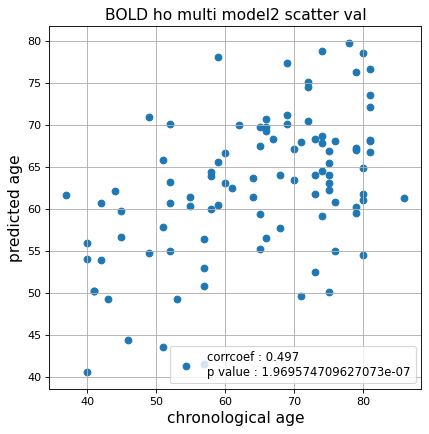

r^2 val data:  0.1984692804678898


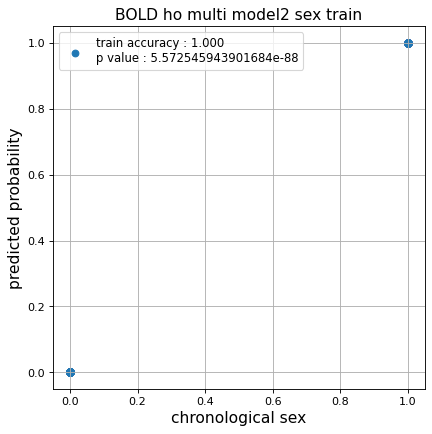

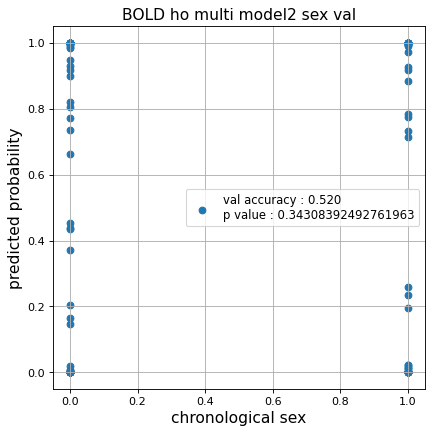

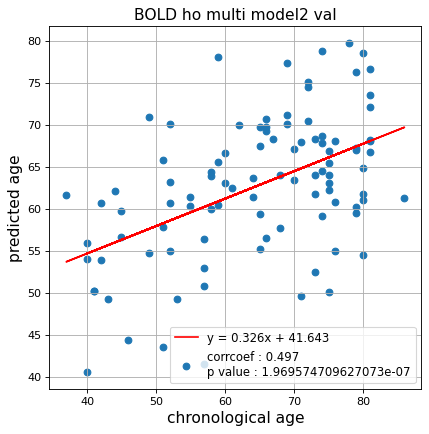

切片: 41.642874012984606
傾き: 0.3261190933679482
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.16355232092050406, val loss: 0.7664699777960777
Kfold: 1 ::: epoch: 200, loss: 0.035753595714385696, val loss: 0.712766058743
Kfold: 1 ::: epoch: 300, loss: 0.021841477889281053, val loss: 0.6501031741499901
Kfold: 1 ::: epoch: 400, loss: 0.01729140129800026, val loss: 0.5827651554718614
Kfold: 1 ::: epoch: 500, loss: 0.012519952339621691, val loss: 0.5833650082349777
Kfold: 1 ::: epoch: 600, loss: 0.017638231090341624, val loss: 0.5499911638908088
Kfold: 1 ::: epoch: 700, loss: 0.010392210840319212, val loss: 0.5456924168393016
Kfold: 1 ::: epoch: 800, loss: 0.009732617065310478, val loss: 0.5262010870501399
Kfold: 1 ::: epoch: 900, loss: 0.00792325116120852, val loss: 0.5175265055149794
Kfold: 1 ::: epoch: 1000, loss: 0.006344031273888854, val loss: 0.5015930812805891
save_epochs:979
best val loss:0.49236042564734817


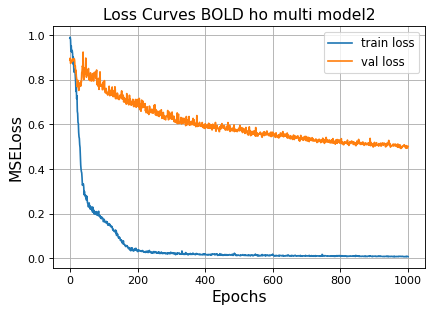

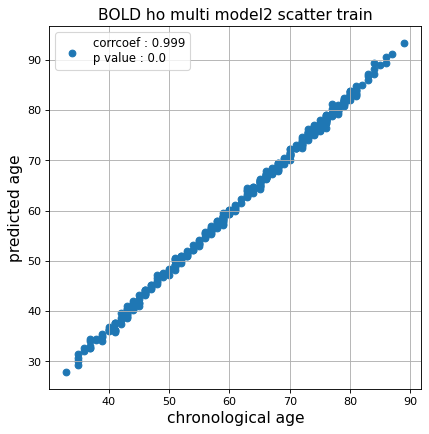

r^2 train data:  0.9717417255657405


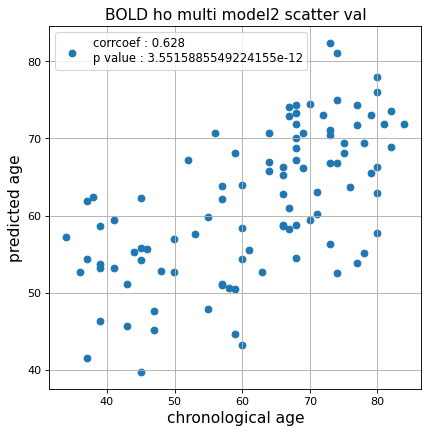

r^2 val data:  0.38984497513404603


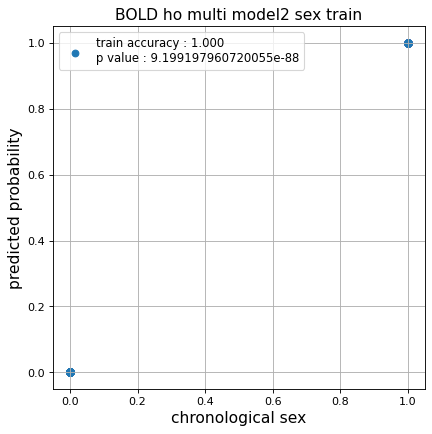

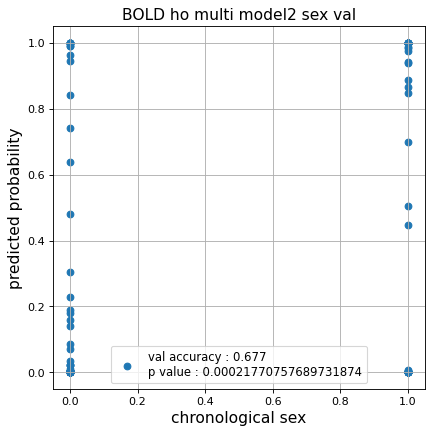

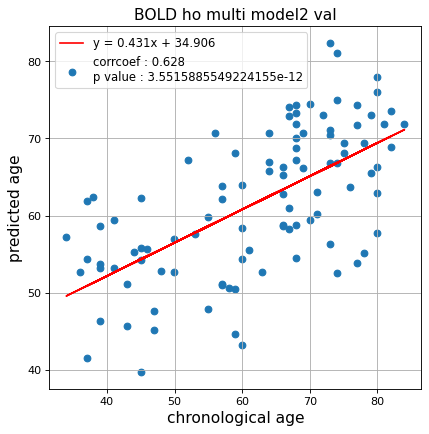

切片: 34.90615597435026
傾き: 0.4312209778132104
Kfold: 2 ::: epoch: 100, loss: 0.18114909071188706, val loss: 0.9271314889192581
Kfold: 2 ::: epoch: 200, loss: 0.028107108906484567, val loss: 0.9714547544717789
Kfold: 2 ::: epoch: 300, loss: 0.020559521678548593, val loss: 1.010668396949768
Kfold: 2 ::: epoch: 400, loss: 0.015375925013079094, val loss: 0.9059231728315353
Kfold: 2 ::: epoch: 500, loss: 0.01395434567418236, val loss: 0.9258352816104889
Kfold: 2 ::: epoch: 600, loss: 0.016987132051816352, val loss: 0.9624451994895935
Kfold: 2 ::: epoch: 700, loss: 0.010205627669795202, val loss: 0.8760744333267212
Kfold: 2 ::: epoch: 800, loss: 0.007247410213144926, val loss: 0.8935839235782623
Kfold: 2 ::: epoch: 900, loss: 0.00812015370824016, val loss: 0.9050856828689575
Kfold: 2 ::: epoch: 1000, loss: 0.007255701384005638, val loss: 0.8727277666330338
save_epochs:962
best val loss:0.8174381256103516


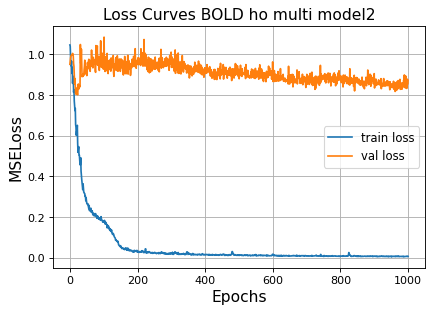

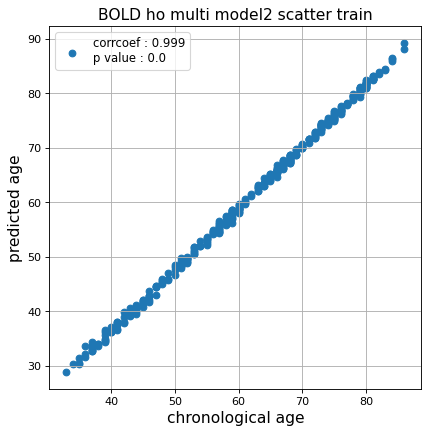

r^2 train data:  0.9781327813831883


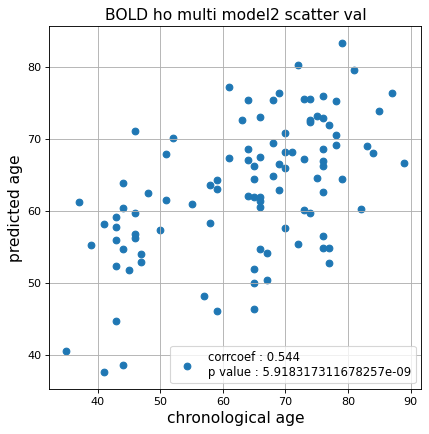

r^2 val data:  0.26807575261634276


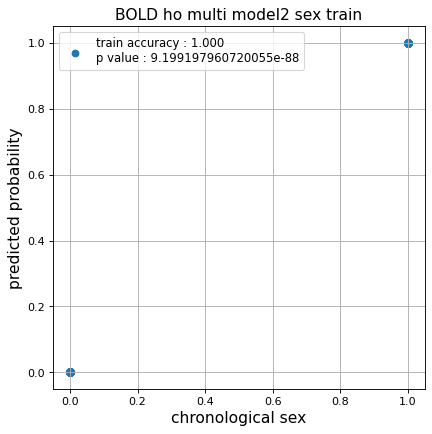

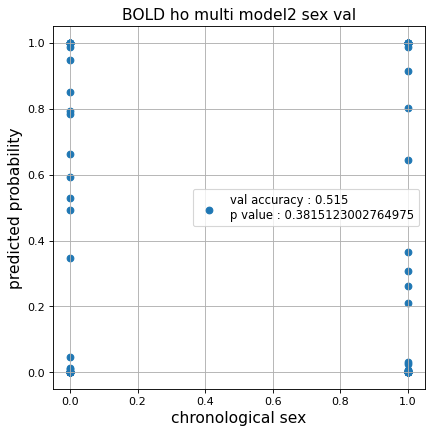

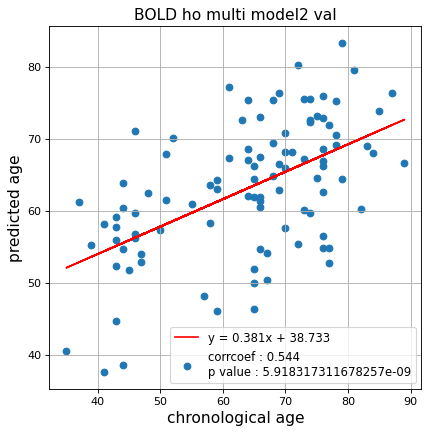

切片: 38.733401398631884
傾き: 0.3812964949172409
Kfold: 3 ::: epoch: 100, loss: 0.18256847445781416, val loss: 0.9812849760055542
Kfold: 3 ::: epoch: 200, loss: 0.03344770005116096, val loss: 0.8829904198646545
Kfold: 3 ::: epoch: 300, loss: 0.025881347819589652, val loss: 0.9056744277477264
Kfold: 3 ::: epoch: 400, loss: 0.018293312965677336, val loss: 0.867490217089653
Kfold: 3 ::: epoch: 500, loss: 0.012667393813339563, val loss: 0.8222239315509796
Kfold: 3 ::: epoch: 600, loss: 0.011776563460723711, val loss: 0.8093122690916061
Kfold: 3 ::: epoch: 700, loss: 0.008118361700326204, val loss: 0.8184056878089905
Kfold: 3 ::: epoch: 800, loss: 0.007855228363321377, val loss: 0.7828845828771591
Kfold: 3 ::: epoch: 900, loss: 0.009823216949231349, val loss: 0.7806351780891418
Kfold: 3 ::: epoch: 1000, loss: 0.006659632083028555, val loss: 0.8022944927215576
save_epochs:766
best val loss:0.7647597193717957


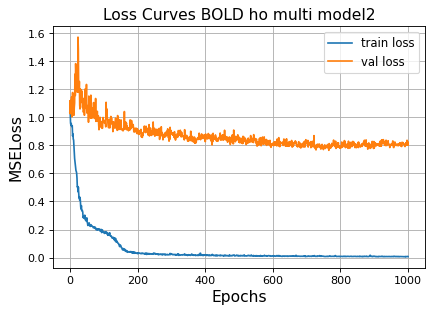

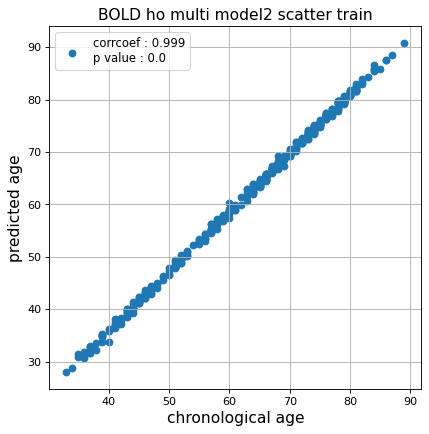

r^2 train data:  0.9748506898658881


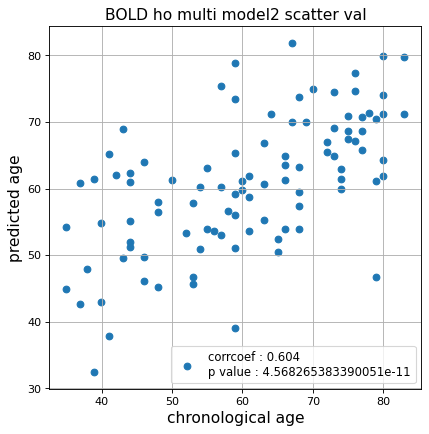

r^2 val data:  0.3452797933141669


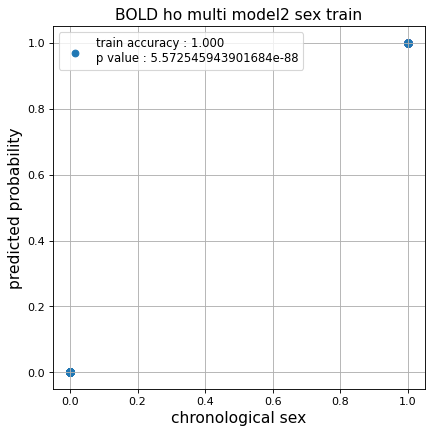

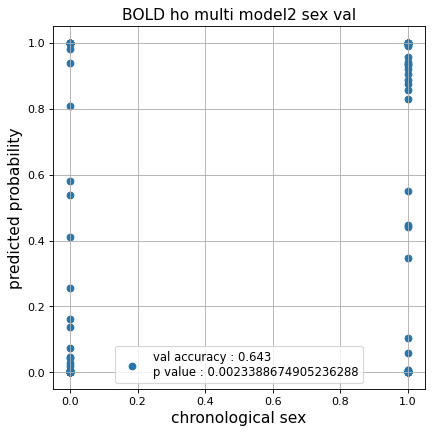

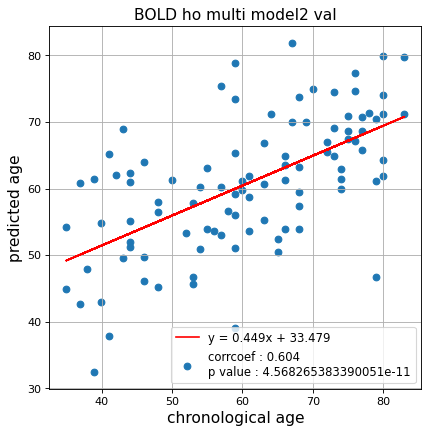

切片: 33.478994007169106
傾き: 0.4492183149294876
Kfold: 4 ::: epoch: 100, loss: 0.1913825640311608, val loss: 1.6001602411270142
Kfold: 4 ::: epoch: 200, loss: 0.03867018609665907, val loss: 1.5272934287786484
Kfold: 4 ::: epoch: 300, loss: 0.02277775896856418, val loss: 1.5048430263996124
Kfold: 4 ::: epoch: 400, loss: 0.016089865794548623, val loss: 1.4457982033491135
Kfold: 4 ::: epoch: 500, loss: 0.01436672961482635, val loss: 1.3978307247161865
Kfold: 4 ::: epoch: 600, loss: 0.01250212539273959, val loss: 1.437053106725216
Kfold: 4 ::: epoch: 700, loss: 0.009837467832347522, val loss: 1.3601033985614777
Kfold: 4 ::: epoch: 800, loss: 0.007346362806856632, val loss: 1.370547503232956
Kfold: 4 ::: epoch: 900, loss: 0.00703043333039834, val loss: 1.3913298696279526
Kfold: 4 ::: epoch: 1000, loss: 0.00727135122108918, val loss: 1.364665225148201
save_epochs:704
best val loss:1.3198250830173492


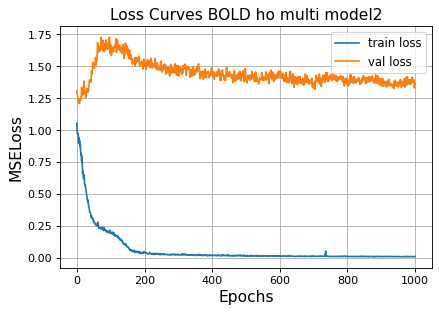

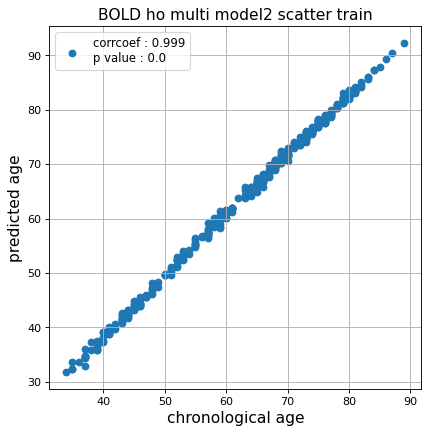

r^2 train data:  0.9789306294914456


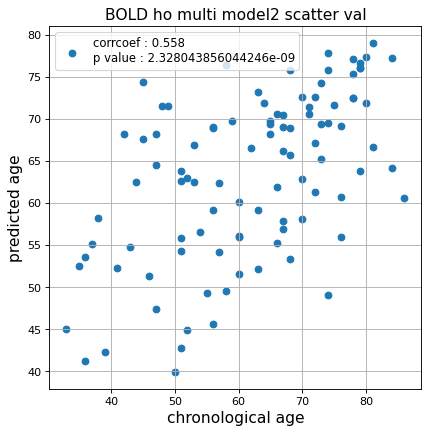

r^2 val data:  0.27178965231972263


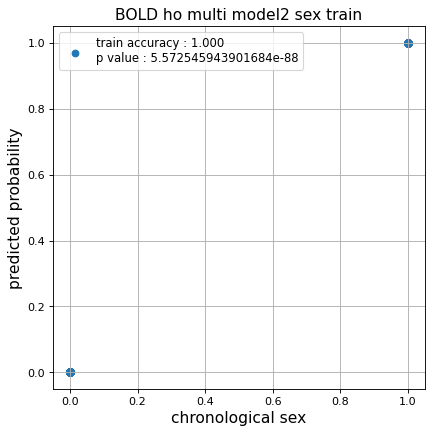

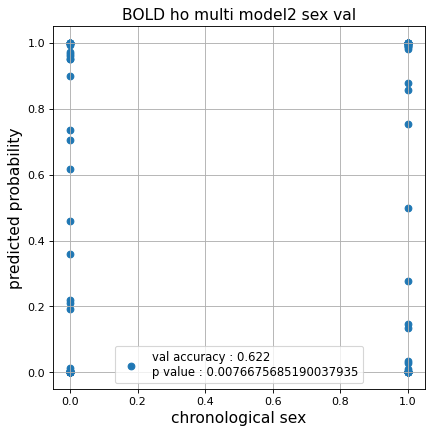

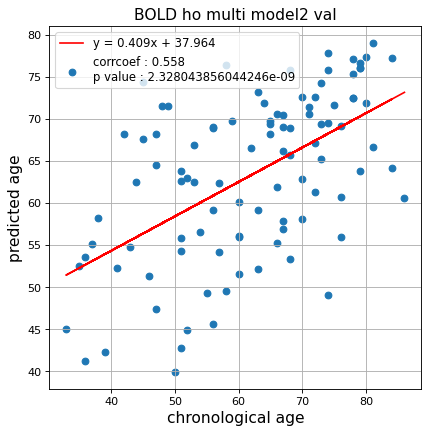

切片: 37.96418237523663
傾き: 0.4090058918795791
Kfold: 5 ::: epoch: 100, loss: 0.1799923055447065, val loss: 0.684015765786171
Kfold: 5 ::: epoch: 200, loss: 0.027717377847203843, val loss: 0.7134536355733871
Kfold: 5 ::: epoch: 300, loss: 0.01905427135240573, val loss: 0.6816265434026718
Kfold: 5 ::: epoch: 400, loss: 0.015387355994719725, val loss: 0.7045048698782921
Kfold: 5 ::: epoch: 500, loss: 0.011132003023074223, val loss: 0.682171180844307
Kfold: 5 ::: epoch: 600, loss: 0.008989439274256047, val loss: 0.6866388618946075
Kfold: 5 ::: epoch: 700, loss: 0.0094836327032401, val loss: 0.6979667991399765
Kfold: 5 ::: epoch: 800, loss: 0.007808007264079956, val loss: 0.6791057735681534
Kfold: 5 ::: epoch: 900, loss: 0.0070627842886516684, val loss: 0.6926026344299316
Kfold: 5 ::: epoch: 1000, loss: 0.006299285898701503, val loss: 0.7098310738801956
save_epochs:353
best val loss:0.6670566648244858


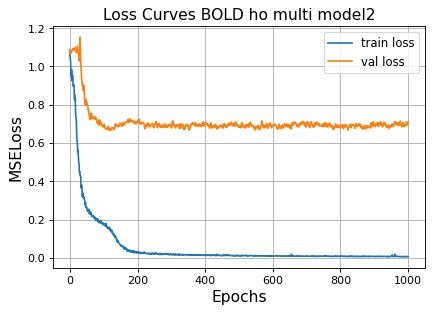

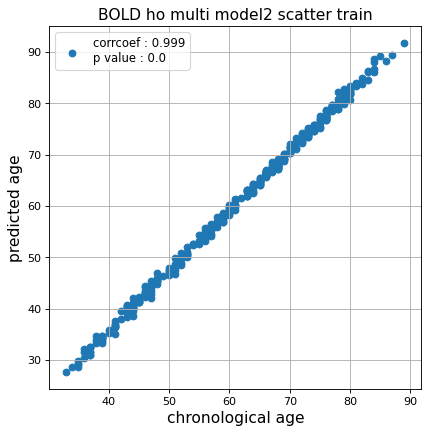

r^2 train data:  0.9689001439116076


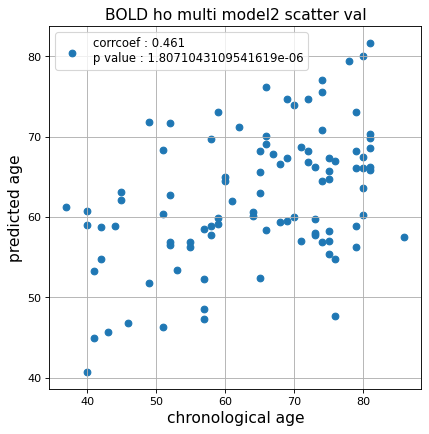

r^2 val data:  0.1486238419872825


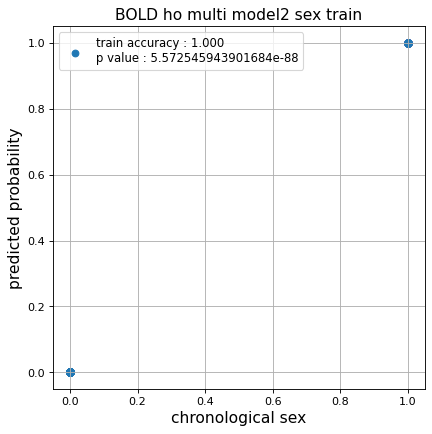

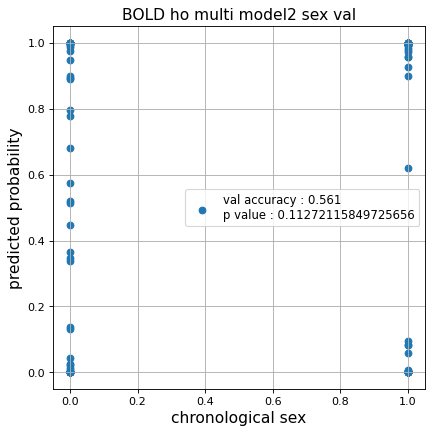

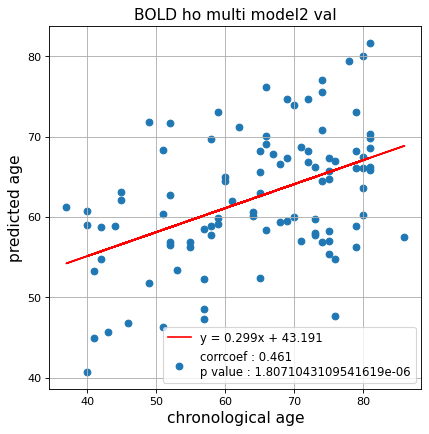

切片: 43.191249357676234
傾き: 0.29855986761778575
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.17131990996690896, val loss: 0.7692525684833527
Kfold: 1 ::: epoch: 200, loss: 0.04112329076115902, val loss: 0.6672903746366501
Kfold: 1 ::: epoch: 300, loss: 0.019430518651810978, val loss: 0.6266250386834145
Kfold: 1 ::: epoch: 400, loss: 0.019966253007833775, val loss: 0.6057103648781776
Kfold: 1 ::: epoch: 500, loss: 0.013658199387674149, val loss: 0.5744089297950268
Kfold: 1 ::: epoch: 600, loss: 0.011364054687034626, val loss: 0.5558979101479053
Kfold: 1 ::: epoch: 700, loss: 0.013143844150293332, val loss: 0.5492175184190273
Kfold: 1 ::: epoch: 800, loss: 0.009465511207683729, val loss: 0.5411914996802807
Kfold: 1 ::: epoch: 900, loss: 0.0076445282723468086, val loss: 0.5298749040812254
Kfold: 1 ::: epoch: 1000, loss: 0.007692296917621906, val loss: 0.5301516409963369
save_epochs:992
best val loss:0.5148635357618332


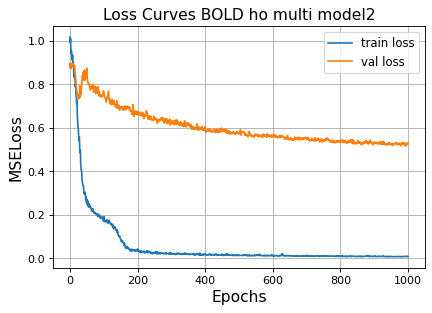

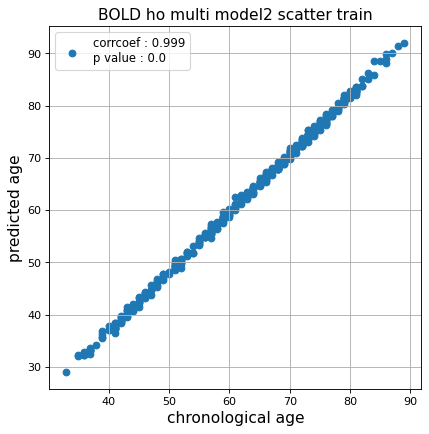

r^2 train data:  0.9817725021866062


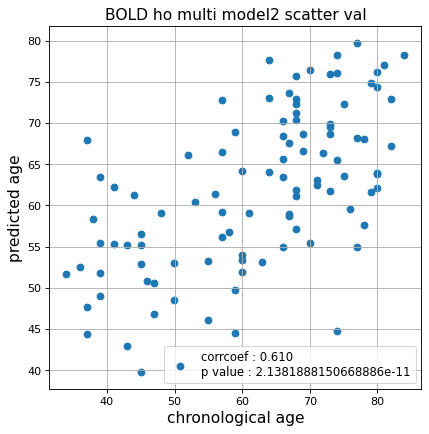

r^2 val data:  0.3648077775709768


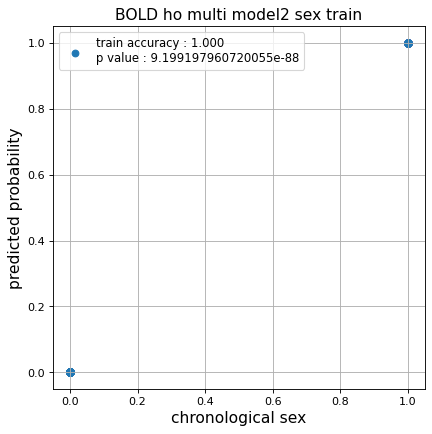

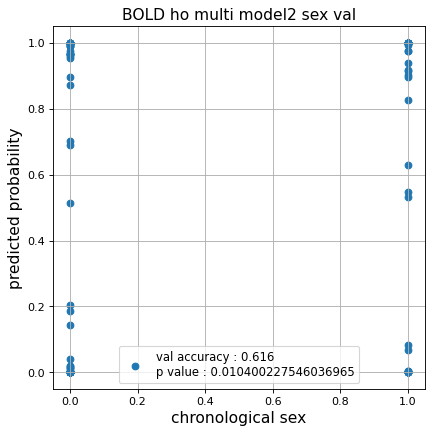

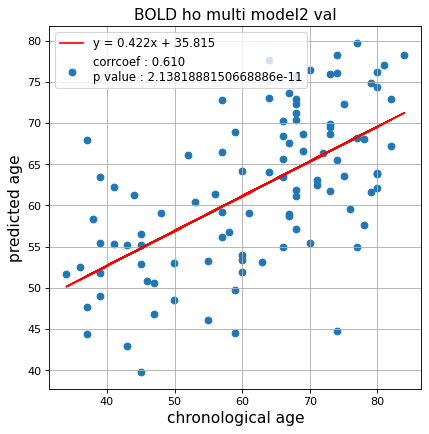

切片: 35.814880528687176
傾き: 0.4217475756168832
Kfold: 2 ::: epoch: 100, loss: 0.18182535469532013, val loss: 1.0972184538841248
Kfold: 2 ::: epoch: 200, loss: 0.028214735408815052, val loss: 0.9608954936265945
Kfold: 2 ::: epoch: 300, loss: 0.020556151150510862, val loss: 0.8793683648109436
Kfold: 2 ::: epoch: 400, loss: 0.014587980157767352, val loss: 0.816500723361969
Kfold: 2 ::: epoch: 500, loss: 0.01532406431551163, val loss: 0.7823331356048584
Kfold: 2 ::: epoch: 600, loss: 0.01239927807966104, val loss: 0.7248365208506584
Kfold: 2 ::: epoch: 700, loss: 0.009342595755767364, val loss: 0.7155250608921051
Kfold: 2 ::: epoch: 800, loss: 0.010061693109142093, val loss: 0.6957942694425583
Kfold: 2 ::: epoch: 900, loss: 0.008047324784386616, val loss: 0.6813997477293015
Kfold: 2 ::: epoch: 1000, loss: 0.0064467012237470886, val loss: 0.6720165610313416
save_epochs:997
best val loss:0.6591140851378441


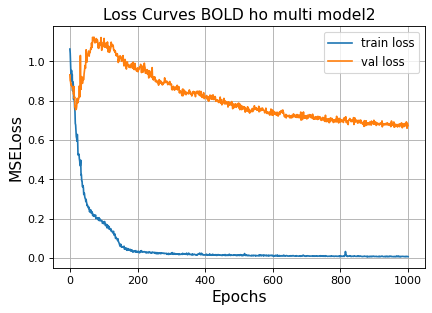

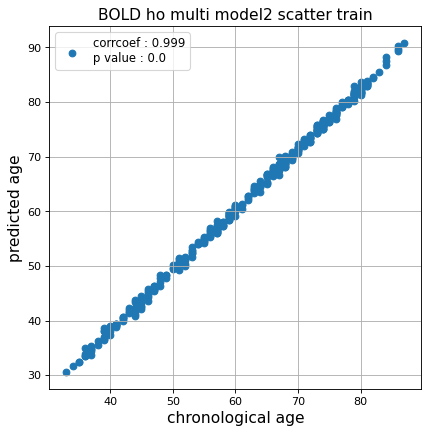

r^2 train data:  0.9843134123228972


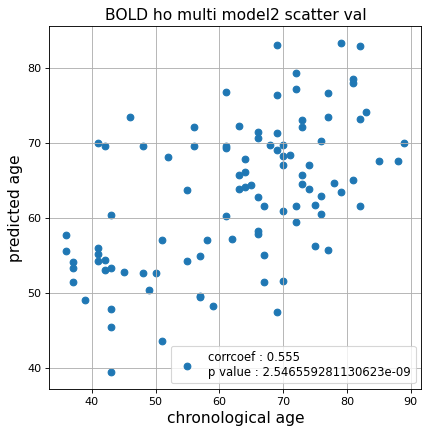

r^2 val data:  0.29166132435978187


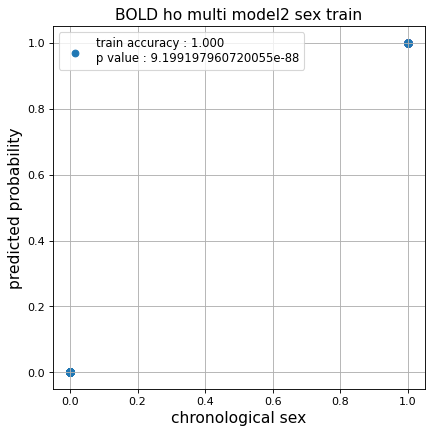

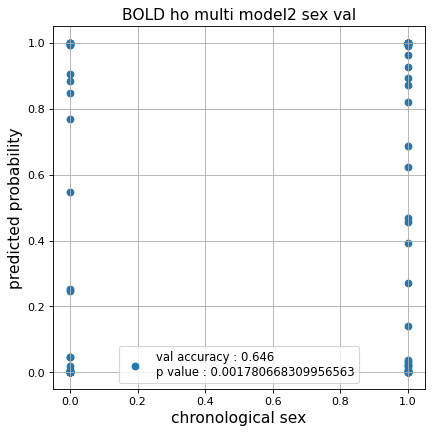

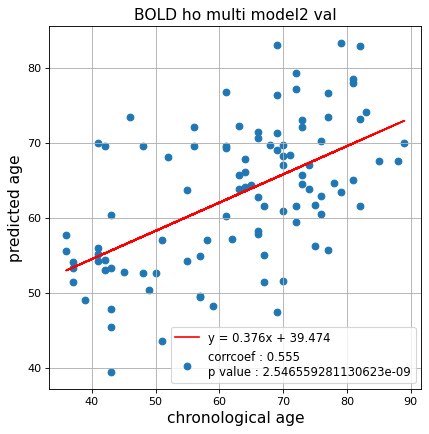

切片: 39.47447003892796
傾き: 0.3763159465529309
Kfold: 3 ::: epoch: 100, loss: 0.17586697408786187, val loss: 1.1317636966705322
Kfold: 3 ::: epoch: 200, loss: 0.03519207425415516, val loss: 1.0123876258730888
Kfold: 3 ::: epoch: 300, loss: 0.021775435799589522, val loss: 1.0512068569660187
Kfold: 3 ::: epoch: 400, loss: 0.01666309698843039, val loss: 0.9681258797645569
Kfold: 3 ::: epoch: 500, loss: 0.012861502249366961, val loss: 0.9628901332616806
Kfold: 3 ::: epoch: 600, loss: 0.014822171177141942, val loss: 0.9953031092882156
Kfold: 3 ::: epoch: 700, loss: 0.008467870012212258, val loss: 0.9669635146856308
Kfold: 3 ::: epoch: 800, loss: 0.00934136683981006, val loss: 0.8910593241453171
Kfold: 3 ::: epoch: 900, loss: 0.008465498435096098, val loss: 0.9466020315885544
Kfold: 3 ::: epoch: 1000, loss: 0.006956575904041529, val loss: 0.9601785242557526
save_epochs:826
best val loss:0.871254600584507


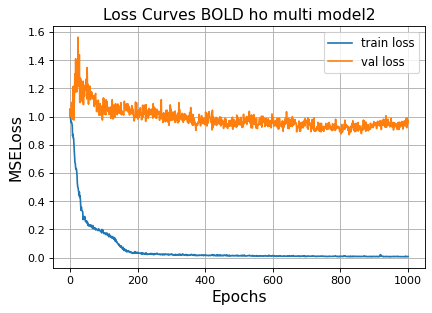

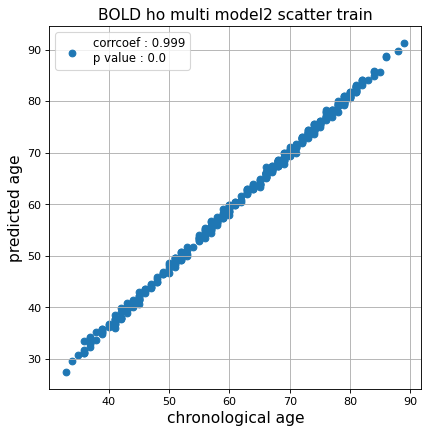

r^2 train data:  0.9805522215804112


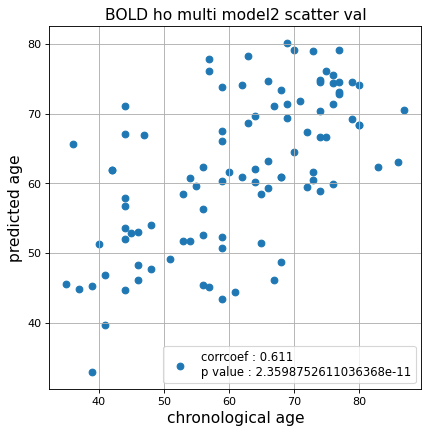

r^2 val data:  0.3271915350822894


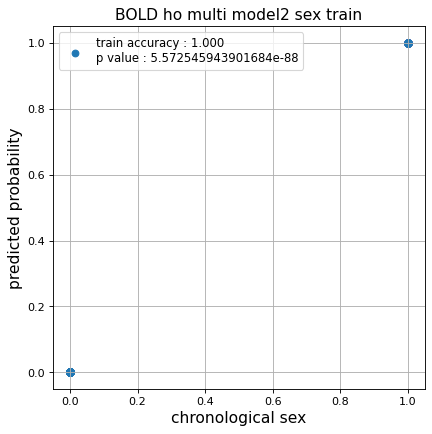

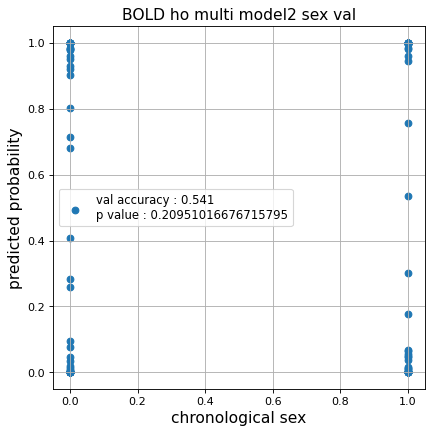

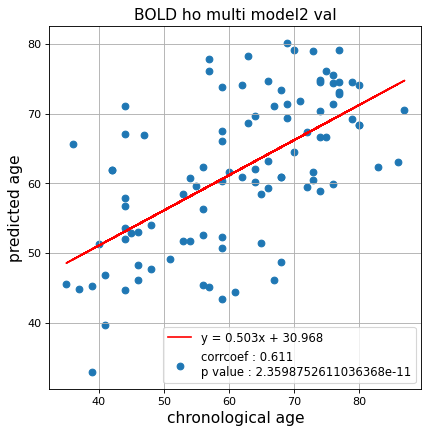

切片: 30.96757403818598
傾き: 0.503024241236622
Kfold: 4 ::: epoch: 100, loss: 0.18164014013913962, val loss: 1.6059775203466415
Kfold: 4 ::: epoch: 200, loss: 0.03884521413307924, val loss: 1.592990592122078
Kfold: 4 ::: epoch: 300, loss: 0.029309113509953022, val loss: 1.533392295241356
Kfold: 4 ::: epoch: 400, loss: 0.018309293529735163, val loss: 1.4034741073846817
Kfold: 4 ::: epoch: 500, loss: 0.011994552297087816, val loss: 1.3734509199857712
Kfold: 4 ::: epoch: 600, loss: 0.010886258051659051, val loss: 1.361675277352333
Kfold: 4 ::: epoch: 700, loss: 0.009514368819789244, val loss: 1.3739901036024094
Kfold: 4 ::: epoch: 800, loss: 0.009079795993434695, val loss: 1.3463801443576813
Kfold: 4 ::: epoch: 900, loss: 0.00765998145708671, val loss: 1.3190145790576935
Kfold: 4 ::: epoch: 1000, loss: 0.007621650190020983, val loss: 1.304098904132843
save_epochs:918
best val loss:1.2683503478765488


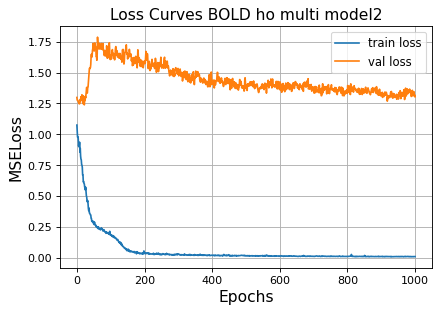

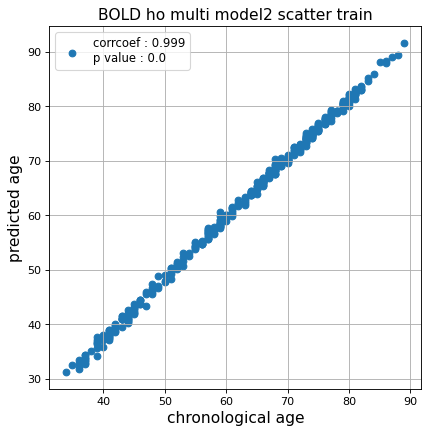

r^2 train data:  0.9865093687847498


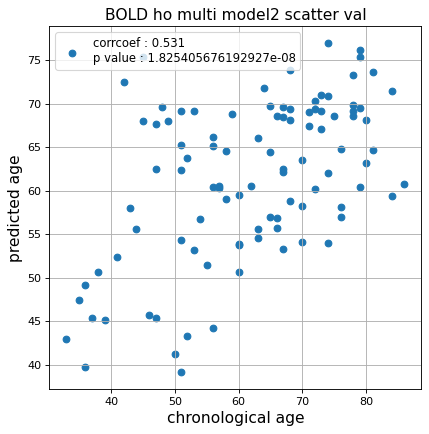

r^2 val data:  0.25630682196633825


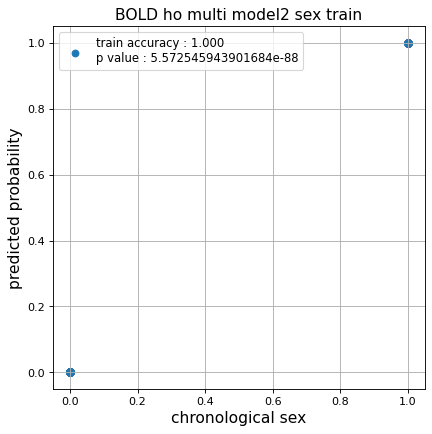

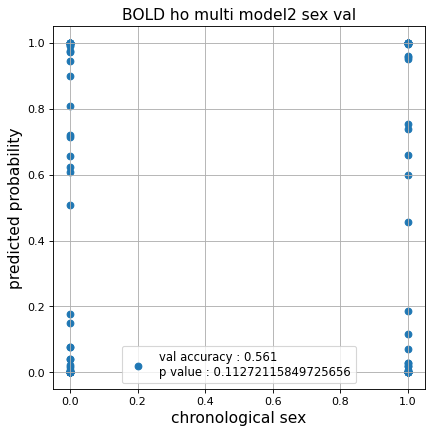

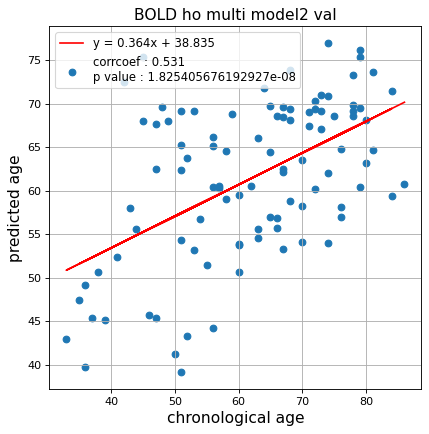

切片: 38.834581062638236
傾き: 0.3641386736228573
Kfold: 5 ::: epoch: 100, loss: 0.1833728586251919, val loss: 0.762859970331192
Kfold: 5 ::: epoch: 200, loss: 0.025852800991672736, val loss: 0.7346693277359009
Kfold: 5 ::: epoch: 300, loss: 0.017279589691987403, val loss: 0.7049432322382927
Kfold: 5 ::: epoch: 400, loss: 0.022153547320228357, val loss: 0.6841152012348175
Kfold: 5 ::: epoch: 500, loss: 0.012383262626826763, val loss: 0.663199707865715
Kfold: 5 ::: epoch: 600, loss: 0.0077116436754854824, val loss: 0.669351726770401
Kfold: 5 ::: epoch: 700, loss: 0.008778195398358198, val loss: 0.65493094176054
Kfold: 5 ::: epoch: 800, loss: 0.0076538315042853355, val loss: 0.647252518683672
Kfold: 5 ::: epoch: 900, loss: 0.0071351213129953696, val loss: 0.656768187880516
Kfold: 5 ::: epoch: 1000, loss: 0.006426473685468619, val loss: 0.6592322066426277
save_epochs:946
best val loss:0.6414967104792595


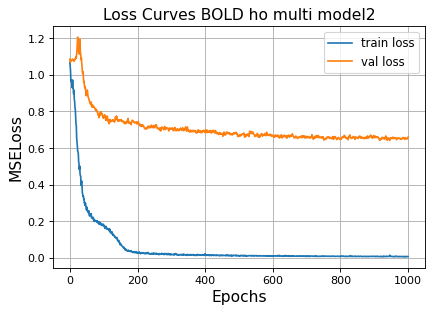

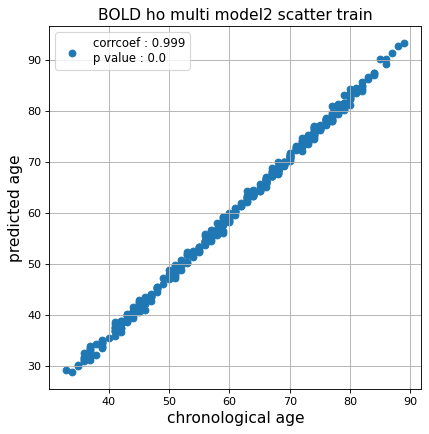

r^2 train data:  0.9674860669926252


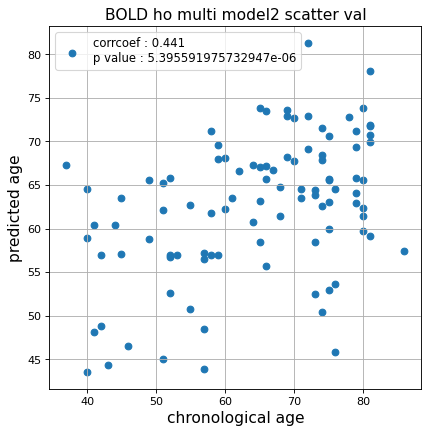

r^2 val data:  0.1340679980802546


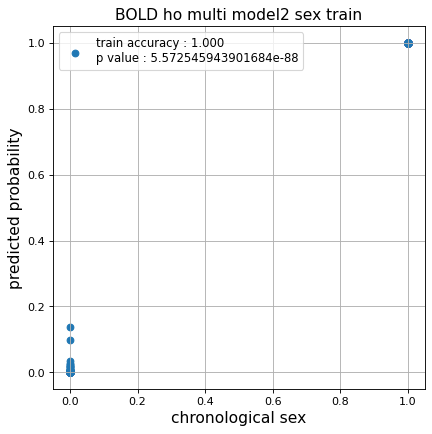

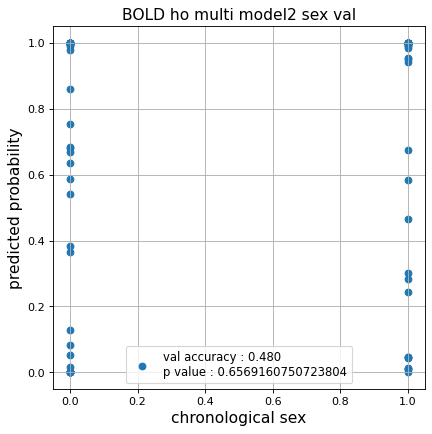

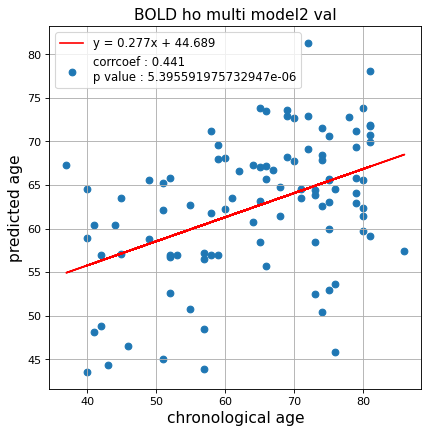

切片: 44.689359720769914
傾き: 0.27683883954141403
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.17521502879949716, val loss: 0.8125681281089783
Kfold: 1 ::: epoch: 200, loss: 0.048488038090559155, val loss: 0.7118568867444992
Kfold: 1 ::: epoch: 300, loss: 0.021733308640810158, val loss: 0.6993662640452385
Kfold: 1 ::: epoch: 400, loss: 0.018620664110550515, val loss: 0.6801519095897675
Kfold: 1 ::: epoch: 500, loss: 0.012777880120735902, val loss: 0.6599106788635254
Kfold: 1 ::: epoch: 600, loss: 0.01073515615784205, val loss: 0.6224824339151382
Kfold: 1 ::: epoch: 700, loss: 0.010548523340660792, val loss: 0.60487424954772
Kfold: 1 ::: epoch: 800, loss: 0.008554448015414752, val loss: 0.5932206586003304
Kfold: 1 ::: epoch: 900, loss: 0.007915881372844944, val loss: 0.5632079765200615
Kfold: 1 ::: epoch: 1000, loss: 0.00658606501439443, val loss: 0.5626606494188309
save_epochs:996
best val loss:0.5512126870453358


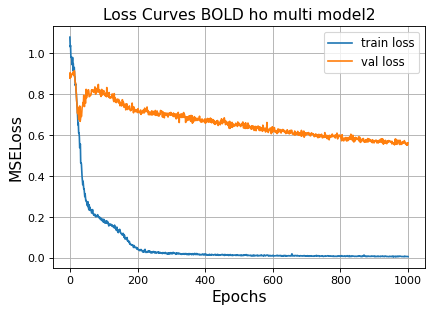

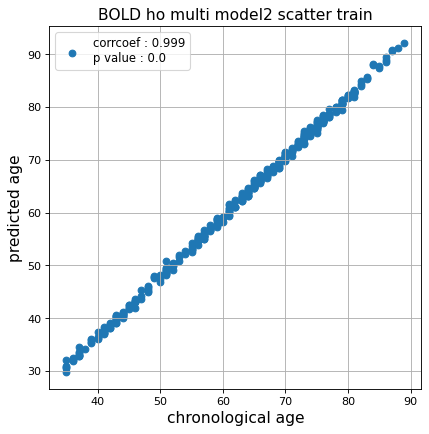

r^2 train data:  0.978634958673674


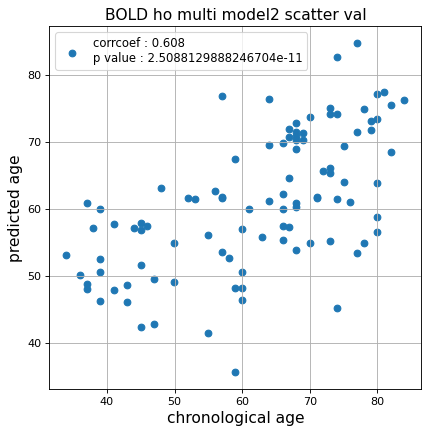

r^2 val data:  0.34522328013167314


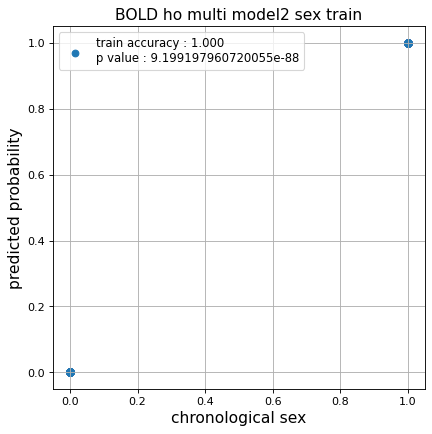

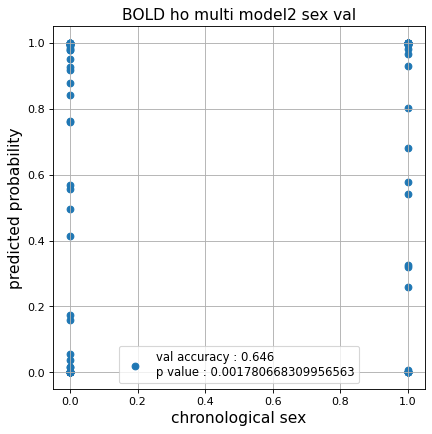

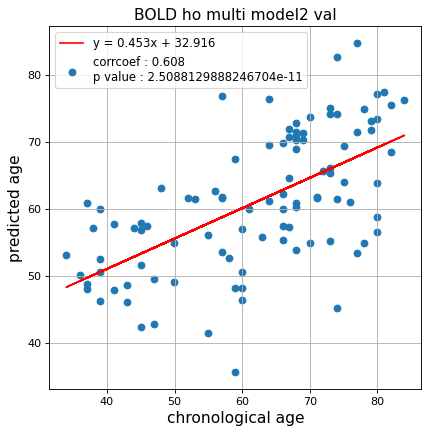

切片: 32.916329897041194
傾き: 0.45279804198384505
Kfold: 2 ::: epoch: 100, loss: 0.19003748893737793, val loss: 0.8726714178919792
Kfold: 2 ::: epoch: 200, loss: 0.03302109929231497, val loss: 0.7392403483390808
Kfold: 2 ::: epoch: 300, loss: 0.01994184046410597, val loss: 0.709464855492115
Kfold: 2 ::: epoch: 400, loss: 0.016778209389975436, val loss: 0.679543174803257
Kfold: 2 ::: epoch: 500, loss: 0.012974775038086452, val loss: 0.6653028801083565
Kfold: 2 ::: epoch: 600, loss: 0.013415619229468016, val loss: 0.6531890630722046
Kfold: 2 ::: epoch: 700, loss: 0.009538856191703906, val loss: 0.6357287988066673
Kfold: 2 ::: epoch: 800, loss: 0.007242381698093736, val loss: 0.6467068493366241
Kfold: 2 ::: epoch: 900, loss: 0.0077339354902505875, val loss: 0.6363244205713272
Kfold: 2 ::: epoch: 1000, loss: 0.007992849201680375, val loss: 0.6311132907867432
save_epochs:844
best val loss:0.6268110647797585


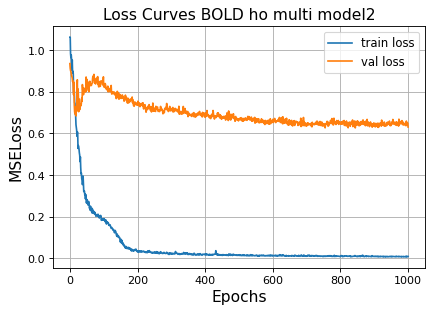

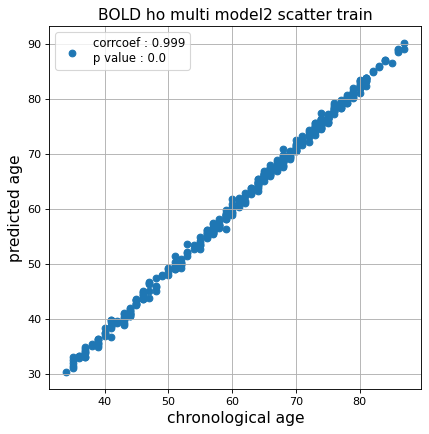

r^2 train data:  0.9809943169101901


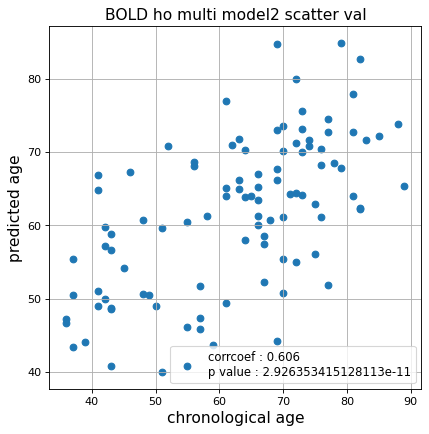

r^2 val data:  0.3481302173361459


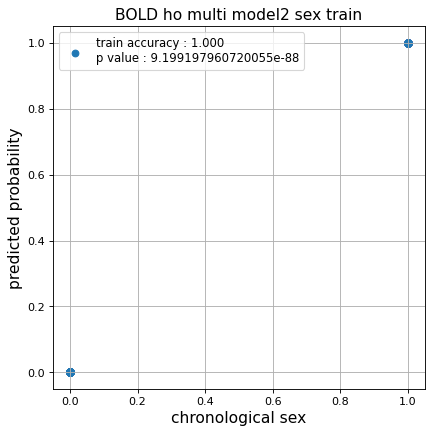

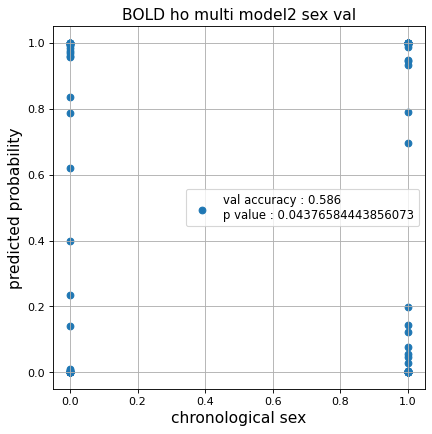

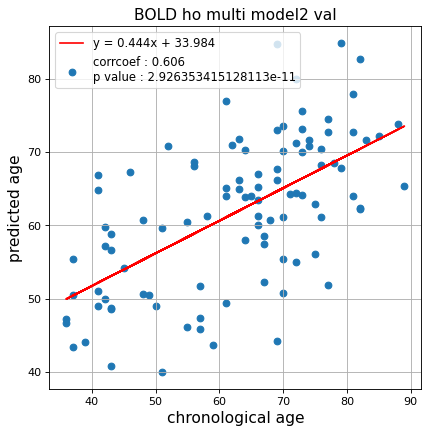

切片: 33.98440272248963
傾き: 0.44429995455342375
Kfold: 3 ::: epoch: 100, loss: 0.18630769161077645, val loss: 0.572869561612606
Kfold: 3 ::: epoch: 200, loss: 0.03732173517346382, val loss: 0.5274989455938339
Kfold: 3 ::: epoch: 300, loss: 0.022723902804920308, val loss: 0.5076855346560478
Kfold: 3 ::: epoch: 400, loss: 0.017199280922516033, val loss: 0.4957740418612957
Kfold: 3 ::: epoch: 500, loss: 0.010373348298554238, val loss: 0.48699985444545746
Kfold: 3 ::: epoch: 600, loss: 0.011976875257320128, val loss: 0.4802830331027508
Kfold: 3 ::: epoch: 700, loss: 0.00990520202769683, val loss: 0.46783027797937393
Kfold: 3 ::: epoch: 800, loss: 0.008483744441316677, val loss: 0.4797239378094673
Kfold: 3 ::: epoch: 900, loss: 0.008682305852954205, val loss: 0.46258776262402534
Kfold: 3 ::: epoch: 1000, loss: 0.007822979456530167, val loss: 0.4456760510802269
save_epochs:934
best val loss:0.44356439262628555


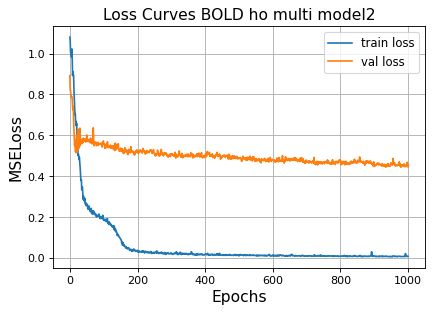

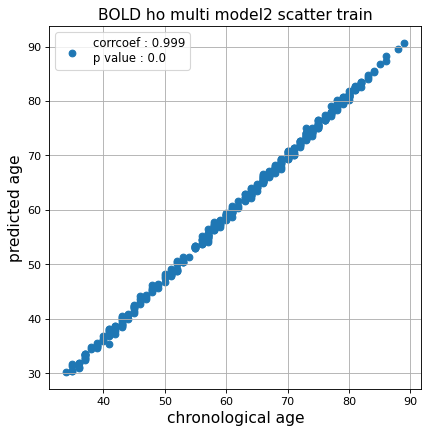

r^2 train data:  0.979107659703942


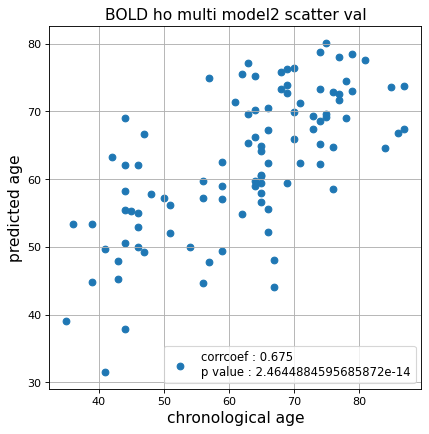

r^2 val data:  0.441348615850501


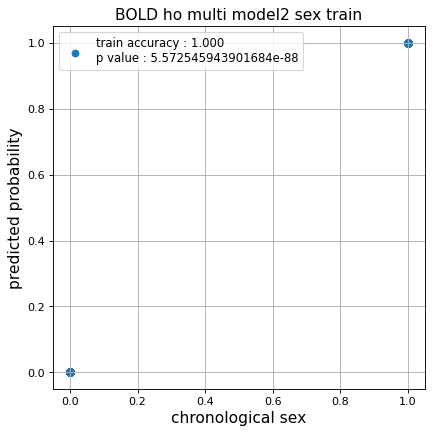

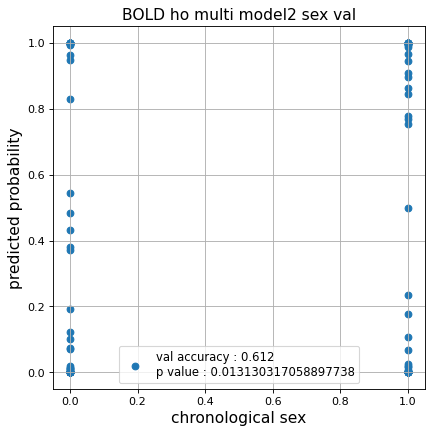

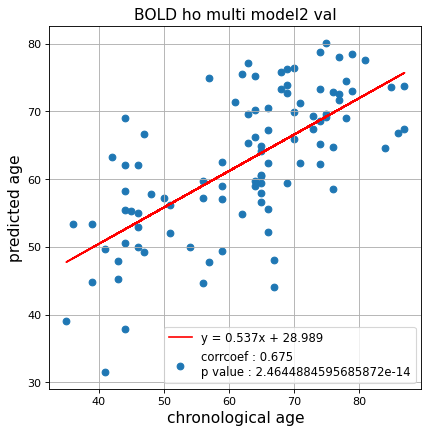

切片: 28.9888035694102
傾き: 0.5368605418799924
Kfold: 4 ::: epoch: 100, loss: 0.18158914148807526, val loss: 1.4292944371700287
Kfold: 4 ::: epoch: 200, loss: 0.04941920506266447, val loss: 1.2990618348121643
Kfold: 4 ::: epoch: 300, loss: 0.023608807044533584, val loss: 1.284390240907669
Kfold: 4 ::: epoch: 400, loss: 0.014054638978380423, val loss: 1.228612631559372
Kfold: 4 ::: epoch: 500, loss: 0.011111167581895223, val loss: 1.1840774714946747


In [ ]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_all_2  = []
test_pred_ho_all_inverse_2  = []
test_label_ho_all_2 = []

test_idx_ho_all_2   = []
train_idx_ho_all_2  = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_inverse,test_label = train_model(data_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 128,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 128,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.1,
                                                           fc_drop = 0.1,
                                                           title = 'BOLD ho multi model2'
                                                          )
    
    test_pred_ho_all_2.append(test_pred)
    test_pred_ho_all_inverse_2.append(test_pred_inverse)
    test_label_ho_all_2.append(test_label)

    test_idx_ho_all_2.append(test_idx)
    train_idx_ho_all_2.append(train_idx)

### データ保存

In [ ]:
np.savez('../02_data_analysis/temp/all_multi_ho_1',
         test_pred_ho_all_1,
         test_pred_ho_all_inverse_1,
         test_label_ho_all_1,
         test_idx_ho_all_1,
         train_idx_ho_all_1)
np.savez('../02_data_analysis/temp/all_multi_ho_2',
         test_pred_ho_all_2,
         test_pred_ho_all_inverse_2,
         test_label_ho_all_2,
         test_idx_ho_all_2,
         train_idx_ho_all_2)

### Data定義(dynamic FC)

In [16]:
%%time
df_dynamic_ho = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_ho.csv')
data_dynamic_ho = make_data(df_dynamic_ho)
print(data_dynamic_ho.shape)

(615, 123, 5995)
CPU times: user 2min 49s, sys: 2min 15s, total: 5min 5s
Wall time: 5min 9s


### Dynamic FC 1

In [ ]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_all_dynamic_1  = []
test_pred_ho_all_dynamic_inverse_1  = []
test_label_ho_all_dynamic_1 = []

test_idx_ho_all_dynamic_1   = []
train_idx_ho_all_dynamic_1  = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_inverse,test_label = train_model(data_dynamic_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop    = 0.3,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC ho multi model1'
                                                          )
    
    test_pred_ho_all_dynamic_1.append(test_pred)
    test_pred_ho_all_dynamic_inverse_1.append(test_pred_inverse)
    test_label_ho_all_dynamic_1.append(test_label)

    test_idx_ho_all_dynamic_1.append(test_idx)
    train_idx_ho_all_dynamic_1.append(train_idx)

### Dynamic FC 2

In [ ]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_all_dynamic_2  = []
test_pred_ho_all_dynamic_inverse_2  = []
test_label_ho_all_dynamic_2 = []

test_idx_ho_all_dynamic_2   = []
train_idx_ho_all_dynamic_2  = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_inverse,test_label = train_model(data_dynamic_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop    = 0.5,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC ho multi model2'
                                                          )
    
    test_pred_ho_all_dynamic_2.append(test_pred)
    test_pred_ho_all_dynamic_inverse_2.append(test_pred_inverse)
    test_label_ho_all_dynamic_2.append(test_label)

    test_idx_ho_all_dynamic_2.append(test_idx)
    train_idx_ho_all_dynamic_2.append(train_idx)

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.05181624310520979, val loss: 0.5465867519378662
Kfold: 1 ::: epoch: 200, loss: 0.024868347108937226, val loss: 0.48303205519914627
Kfold: 1 ::: epoch: 300, loss: 0.013451327927983724, val loss: 0.4857841581106186
Kfold: 1 ::: epoch: 400, loss: 0.00957467077443233, val loss: 0.46861811727285385
Kfold: 1 ::: epoch: 500, loss: 0.007810543953942565, val loss: 0.4834460821002722
Kfold: 1 ::: epoch: 600, loss: 0.00643702048378495, val loss: 0.5012312792241573


### データ保存

In [ ]:
np.savez('../02_data_analysis/temp/all_multi_dynamic_ho_1',
         test_pred_ho_all_dynamic_1,
         test_pred_ho_all_dynamic_inverse_1,
         test_label_ho_all_dynamic_1,
         test_idx_ho_all_dynamic_1,
         train_idx_ho_all_dynamic_1)

In [ ]:
np.savez('../02_data_analysis/temp/all_multi_dynamic_ho_2',
         test_pred_ho_all_dynamic_2,
         test_pred_ho_all_dynamic_inverse_2,
         test_label_ho_all_dynamic_2,
         test_idx_ho_all_dynamic_2,
         train_idx_ho_all_dynamic_2)